# World Bank Official Boundaries Import
Source: https://datacatalog.worldbank.org/dataset/world-bank-official-boundaries

Import of world Bank-approved administrative level 0 boundaries (ignoring disputed areas, coastlines and lakes). We also include simplified boundary GeoJSON's for application building.

Simplifed maps are also generated using the scales used for [geojsons_low_res](https://github.com/datacommonsorg/data/blob/master/scripts/us_census/geojsons_low_res/generate_mcf.py#L40) import. There are also additional levels of simplification added here if required.

**Notebook setup**
---

In [1]:
project_id = 'datcom-data'
import_name = 'WorldBankBoundaries'

In [2]:
from google.colab import auth

auth.authenticate_user()


!gcloud config set project {project_id}

Updated property [core/project].


In [3]:
#@title
!pip install datacommons
import pandas as pd
import numpy as np
!pip install git+git://github.com/geopandas/geopandas.git
import geopandas as gpd
import matplotlib.pyplot as plt
%matplotlib inline

     |████████████████████████████████| 51kB 2.2MB/s 
  Cloning git://github.com/geopandas/geopandas.git to /tmp/pip-req-build-90f1q15l
  Running command git clone -q git://github.com/geopandas/geopandas.git /tmp/pip-req-build-90f1q15l
     |████████████████████████████████| 15.4MB 48.2MB/s 
     |████████████████████████████████| 6.6MB 27.0MB/s 
  Created wheel for geopandas: filename=geopandas-0.9.0+36.gcb88dd4-py2.py3-none-any.whl size=996489 sha256=5017ab2dbf21883661f7cd48b9982d3ea9f8bcd4417ce6695a281ab84842e593
  Stored in directory: /tmp/pip-ephem-wheel-cache-s18mt11c/wheels/91/24/71/376c9c67192694168352afcccc2d264248f7e2cc6192997186
Successfully built geopandas


In [4]:
#@title Download data from source

import io
import zipfile
import requests

DOWNLOAD_URI = 'https://development-data-hub-s3-public.s3.amazonaws.com/ddhfiles/779551/wb_boundaries_geojson_highres.zip'
TMP_PATH = '/tmp/wb_boundaries_geojson_highres'
GCS_BUCKET = f'gs://unresolved_mcf/template_mcf_imports/{import_name}'

r = requests.get(DOWNLOAD_URI, stream=True)
z = zipfile.ZipFile(io.BytesIO(r.content))
z.extractall(TMP_PATH)

!gsutil -m cp -r {TMP_PATH} {GCS_BUCKET}

Copying file:///tmp/wb_boundaries_geojson_highres/WB_Boundaries_GeoJSON_highres/WB_countries_Admin0.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/wb_boundaries_geojson_highres/WB_Boundaries_GeoJSON_highres/WB_Coastlines.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/wb_boundaries_geojson_highres/WB_Boundaries_GeoJSON_highres/WB_Land.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/wb_boundaries_geojson_highres/WB_Boundaries_GeoJSON_highres/WB_Admin0_disputed_areas.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/wb_boundaries_geojson_highres/WB_Boundaries_GeoJSON_highres/WB_Admin0_disputed_areas_boundary_lines.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/wb_boundaries_geojson_highres/WB_Boundaries_GeoJSON_highres/WB_Admin0_boundary_lines.geojson [Content-Type=application/octet-stream]...
|
Operation completed over 6 objects/100.6 MiB.                                   

In [5]:
GEO_JSON_PATH = f'{TMP_PATH}/WB_Boundaries_GeoJSON_highres/WB_countries_Admin0.geojson'

all_countries = gpd.read_file(GEO_JSON_PATH)

**Data validation**
---

In [6]:
#@title
import json

# aa0_boundary_geojson_gcs = 'gs://unresolved_mcf/template_mcf_imports/WorldBankBoundaries/wb_boundaries_geojson_highres/WB_Boundaries_GeoJSON_highres/WB_Admin0_boundary_lines.geojson'

GEO_JSON_PATH = f'{TMP_PATH}/WB_Boundaries_GeoJSON_highres/WB_countries_Admin0.geojson'
with open(GEO_JSON_PATH) as fp:
  geo_json = json.load(fp)
  print(geo_json["crs"]["properties"].get("name", "-n/a"))

  areas = {}
  for feature in geo_json["features"]:
    props = feature.get("properties", {})
    areas.setdefault(props['TYPE'], []).append(props)

WB_ISO_PROP = 'ISO_A3'
wb_a3 = set()

wb_code_to_props = {}
wb_unknowns = []
for (t, features) in areas.items():
  print(f'\n\n{t}\n')
  for f in features:
  # for f in sorted(features):
    code = f[WB_ISO_PROP]
    print(f'{f["ISO_A3"]}\t{f["WB_A3"] if f["WB_A3"] != code else "==="}\t{f["WB_NAME"]}')
    wb_a3.add(code)
    # wb_a3.add(f["WB_NAME"])
    wb_code_to_props[code] = f
    if code == "-99":
      wb_unknowns.append(f)
    # print(f)
    # print(f.get('FORMAL_EN'))
print("Unknowns")
for f in wb_unknowns:
  print(f'{f["ISO_A3"]}\t{f["WB_A3"]}\t{f["WB_NAME"]}\t{f}')

EPSG:4326


Sovereign country

IDN	===	Indonesia
MYS	===	Malaysia
CHL	===	Chile
BOL	===	Bolivia
PER	===	Peru
ARG	===	Argentina
CYP	===	Cyprus
IND	===	India
LBN	===	Lebanon
ETH	===	Ethiopia
SSD	===	South Sudan
SOM	===	Somalia
KEN	===	Kenya
PAK	===	Pakistan
MWI	===	Malawi
TZA	===	Tanzania
SYR	===	Syrian Arab Republic
SUR	===	Suriname
GUY	===	Guyana
KOR	===	Korea, Republic of
PRK	===	Korea, Democratic People's Republic of
MAR	===	Morocco
CRI	===	Costa Rica
NIC	===	Nicaragua
COG	===	Congo, Rep. of
COD	ZAR	Congo, Democratic Republic of
BTN	===	Bhutan
UKR	===	Ukraine
BLR	===	Belarus
NAM	===	Namibia
ZAF	===	South Africa
OMN	===	Oman
UZB	===	Uzbekistan
KAZ	===	Kazakhstan
TJK	===	Tajikistan
LTU	===	Lithuania
BRA	===	Brazil
URY	===	Uruguay
MNG	===	Mongolia
RUS	===	Russian Federation
CZE	===	Czech Republic
DEU	===	Germany
EST	===	Estonia
LVA	===	Latvia
-99	NOR	Norway
SWE	===	Sweden
VNM	===	Vietnam
KHM	===	Cambodia
LUX	===	Luxembourg
ARE	===	United Arab Emirates
BEL	===	Belgium
GEO	===	Georgia
MKD

In [7]:
%load_ext google.colab.data_table

all_countries.head()

,FID,OBJECTID,featurecla,LEVEL,TYPE,FORMAL_EN,FORMAL_FR,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,LASTCENSUS,GDP_YEAR,ECONOMY,INCOME_GRP,FIPS_10_,ISO_A2,ISO_A3,ISO_A3_EH,ISO_N3,UN_A3,WB_A2,WB_A3,CONTINENT,REGION_UN,SUBREGION,REGION_WB,NAME_AR,NAME_BN,NAME_DE,NAME_EN,NAME_ES,NAME_FR,NAME_EL,NAME_HI,NAME_HU,NAME_ID,NAME_IT,NAME_JA,NAME_KO,NAME_NL,NAME_PL,NAME_PT,NAME_RU,NAME_SV,NAME_TR,NAME_VI,NAME_ZH,WB_NAME,WB_RULES,WB_REGION,Shape_Leng,Shape_Area,geometry
0,0,1,Admin-0 country,2,Sovereign country,Republic of Indonesia,,260580739,17,3028000.0,2017,2010,2016,4. Emerging region: MIKT,4. Lower middle income,ID,ID,IDN,IDN,360,360,ID,IDN,Asia,Asia,South-Eastern Asia,East Asia & Pacific,إندونيسيا,ইন্দোনেশিয়া,Indonesien,Indonesia,Indonesia,Indonésie,Ινδονησία,इंडोनेशिया,Indonézia,Indonesia,Indonesia,インドネシア,인도네시아,Indonesië,Indonezja,Indonésia,Индонезия,Indonesien,Endonezya,Indonesia,印度尼西亚,Indonesia,None,EAP,495.029918,153.078608,"MULTIPOLYGON (((117.70361 4.16341, 117.73943 4..."
1,1,2,Admin-0 country,2,Sovereign country,Malaysia,,31381992,15,863000.0,2017,2010,2016,6. Developing region,3. Upper middle income,MY,MY,MYS,MYS,458,458,MY,MYS,Asia,Asia,South-Eastern Asia,East Asia & Pacific,ماليزيا,মালয়েশিয়া,Malaysia,Malaysia,Malasia,Malaisie,Μαλαισία,मलेशिया,Malajzia,Malaysia,Malesia,マレーシア,말레이시아,Maleisië,Malezja,Malásia,Малайзия,Malaysia,Malezya,Malaysia,马来西亚,Malaysia,None,EAP,68.456913,26.703172,"MULTIPOLYGON (((117.70361 4.16341, 117.70361 4..."
2,2,3,Admin-0 country,2,Sovereign country,Republic of Chile,,17789267,14,436100.0,2017,2002,2016,5. Emerging region: G20,3. Upper middle income,CI,CL,CHL,CHL,152,152,CL,CHL,South America,Americas,South America,Latin America & Caribbean,تشيلي,চিলি,Chile,Chile,Chile,Chili,Χιλή,चिली,Chile,Chili,Cile,チリ,칠레,Chili,Chile,Chile,Чили,Chile,Şili,Chile,智利,Chile,None,LCR,416.997272,76.761813,"MULTIPOLYGON (((-69.51009 -17.50659, -69.63832..."
3,3,4,Admin-0 country,2,Sovereign country,Plurinational State of Bolivia,,11138234,14,78350.0,2017,2001,2016,5. Emerging region: G20,4. Lower middle income,BL,BO,BOL,BOL,068,068,BO,BOL,South America,Americas,South America,Latin America & Caribbean,بوليفيا,বলিভিয়া,Bolivien,Bolivia,Bolivia,Bolivie,Βολιβία,बोलिविया,Bolívia,Bolivia,Bolivia,ボリビア,볼리비아,Bolivia,Boliwia,Bolívia,Боливия,Bolivia,Bolivya,Bolivia,玻利維亞,Bolivia,None,LCR,54.345991,92.203587,"POLYGON ((-69.51009 -17.50659, -69.50611 -17.5..."
4,4,5,Admin-0 country,2,Sovereign country,Republic of Peru,,31036656,15,410400.0,2017,2007,2016,5. Emerging region: G20,3. Upper middle income,PE,PE,PER,PER,604,604,PE,PER,South America,Americas,South America,Latin America & Caribbean,بيرو,পেরু,Peru,Peru,Perú,Pérou,Περού,पेरू,Peru,Peru,Perù,ペルー,페루,Peru,Peru,Peru,Перу,Peru,Peru,Peru,秘鲁,Peru,None,LCR,73.262192,106.417089,"MULTIPOLYGON (((-69.51009 -17.50659, -69.51009..."


Investigate which column to build dcid country codes with.

In [8]:
import datacommons as dc

dc_all_countries = dc.query('''
SELECT ?place ?name WHERE {
  ?place typeOf Country .
  ?place name ?name
}
''', select=None)

for f in filter(lambda x: not x['?place'].startswith('country/'), dc_all_countries):
  print(f)

{'?place': 'wikidataId/Q40362', '?name': 'Sahrawi Arab Democratic Republic'}
{'?place': 'wikidataId/Q756617', '?name': 'Kingdom of Denmark'}
{'?place': 'wikidataId/Q244165', '?name': 'Artsakh'}
{'?place': 'wikidataId/Q29999', '?name': 'Kingdom of the Netherlands'}
{'?place': 'wikidataId/Q23681', '?name': 'Turkish Republic of Northern Cyprus'}
{'?place': 'wikidataId/Q31354462', '?name': 'Republic of Abkhazia'}
{'?place': 'wikidataId/Q27304761', '?name': 'Asgardia'}


In [9]:
def is_dc_country(iso):
  dcid = f'country/{iso}'
  matches = filter(lambda x: x['?place'] == dcid, dc_all_countries)
  return len(list(matches)) > 0

print(is_dc_country('USA'))
print(is_dc_country('ZAR'))

True
False


In [10]:
code_names = all_countries[['ISO_A3', 'WB_A3', 'WB_NAME']]

In [11]:
code_names['ISO_IN_DC'] = code_names['ISO_A3'].apply(is_dc_country)
code_names['WB_IN_DC'] = code_names['WB_A3'].apply(is_dc_country)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [12]:
code_names[code_names['ISO_IN_DC'] == False]

,ISO_A3,WB_A3,WB_NAME,ISO_IN_DC,WB_IN_DC
20,-99,FRA,France,False,True
50,-99,NOR,Norway,False,True
62,-99,KSV,Kosovo,False,False
129,-99,USA,Guantanamo Bay (US),False,True
232,-99,FRA,Clipperton Island (Fr.),False,True
238,-99,CCK,Cocos (Keeling) Islands (Aus.),False,True
239,-99,CXR,Christmas Island (Aus.),False,True


In [13]:
code_names[code_names['ISO_A3'] != code_names['WB_A3']]

,ISO_A3,WB_A3,WB_NAME,ISO_IN_DC,WB_IN_DC
20,-99,FRA,France,False,True
29,COD,ZAR,"Congo, Democratic Republic of",True,False
50,-99,NOR,Norway,False,True
62,-99,KSV,Kosovo,False,False
71,ROU,ROM,Romania,True,False
114,TLS,TMP,Timor-Leste,True,False
124,AND,ADO,Andorra,True,False
129,-99,USA,Guantanamo Bay (US),False,True
209,IMN,IMY,Isle of Man (UK),True,False
232,-99,FRA,Clipperton Island (Fr.),False,True


In [14]:
#@markdown Conclusion - use ISO_A3 for country codes, with fallback to WB_A3 where unavailable.
#@markdown Possibly revisit removing BES from NLD

WB_A3_CODES_TO_IMPORT = ['BES', 'TKL', 'FRA', 'CCK', 'CXR', 'NOR']

In [15]:
import datacommons as dc

dc_countries = dc.get_places_in(['Earth'], 'Country').get('Earth', [])
print(dc_countries)
print(len(dc_countries))

dict(filter(lambda item: len(item[1]) > 0, dc.get_property_values(dc_countries, 'dissolutionDate').items()))

['country/ABW', 'country/AFG', 'country/AGO', 'country/AIA', 'country/ALB', 'country/AND', 'country/ANT', 'country/ARE', 'country/ARG', 'country/ARM', 'country/ASM', 'country/ATA', 'country/ATF', 'country/ATG', 'country/ATN', 'country/AUS', 'country/AUT', 'country/AZE', 'country/BDI', 'country/BEL', 'country/BEN', 'country/BES', 'country/BFA', 'country/BGD', 'country/BGR', 'country/BHR', 'country/BHS', 'country/BIH', 'country/BLM', 'country/BLR', 'country/BLZ', 'country/BMU', 'country/BOL', 'country/BRA', 'country/BRB', 'country/BRN', 'country/BTN', 'country/BVT', 'country/BWA', 'country/CAF', 'country/CAN', 'country/CCK', 'country/CHE', 'country/CHL', 'country/CHN', 'country/CIV', 'country/CMR', 'country/COD', 'country/COG', 'country/COK', 'country/COL', 'country/COM', 'country/CPV', 'country/CRI', 'country/CTE', 'country/CUB', 'country/CUW', 'country/CXR', 'country/CYM', 'country/CYP', 'country/CZE', 'country/DEU', 'country/DJI', 'country/DMA', 'country/DNK', 'country/DOM', 'country/

{'country/YUG': ['1992-04-26']}

In [16]:
#@title DC countries without maps
dc_country_codes = set(map(lambda x: x[-3:], dc_countries))
dc_country_codes.discard('YUG')
dc_country_codes.add('SSD')

dc_countries_not_in_wb = dc_country_codes - set(all_countries['ISO_A3']).union(set(WB_A3_CODES_TO_IMPORT))
dc.get_property_values(map(lambda x: f'country/{x}', list(dc_countries_not_in_wb)), 'name')


{'country/ANT': ['Netherlands Antilles'],
 'country/ATA': ['Antarctica'],
 'country/ATN': ['Dronning Maud Land'],
 'country/BVT': ['Bouvet Island'],
 'country/CTE': ['Canton and Enderbury Islands'],
 'country/ESH': ['Western Sahara'],
 'country/FXX': ['Metropolitan France'],
 'country/GLP': ['Guadeloupe'],
 'country/GUF': ['French Guiana'],
 'country/MTQ': ['Martinique'],
 'country/MYT': ['Mayotte'],
 'country/REU': ['Réunion'],
 'country/SJM': ['Svalbard and Jan Mayen'],
 'country/TWN': ['Taiwan']}

In [17]:
#@title
for col in ['featurecla', 'LEVEL', 'TYPE', 'ECONOMY', 'INCOME_GRP', 'CONTINENT', 'REGION_UN', 'SUBREGION', 'REGION_WB']:
  print(f'{col}:\t{sorted(all_countries[col].unique())}')

featurecla:	['Admin-0 country']
LEVEL:	[2]
TYPE:	['Country', 'Dependency', 'Disputed', 'Lease', 'Sovereign country']
ECONOMY:	['1. Developed region: G7', '2. Developed region: nonG7', '3. Emerging region: BRIC', '4. Emerging region: MIKT', '5. Emerging region: G20', '6. Developing region', '7. Least developed region']
INCOME_GRP:	['1. High income: OECD', '2. High income: nonOECD', '3. Upper middle income', '4. Lower middle income', '5. Low income']
CONTINENT:	['Africa', 'Asia', 'Europe', 'North America', 'Oceania', 'Seven seas (open ocean)', 'South America']
REGION_UN:	['Africa', 'Americas', 'Asia', 'Europe', 'Oceania', 'Seven seas (open ocean)']
SUBREGION:	['Australia and New Zealand', 'Caribbean', 'Central America', 'Central Asia', 'Eastern Africa', 'Eastern Asia', 'Eastern Europe', 'Melanesia', 'Micronesia', 'Middle Africa', 'Northern Africa', 'Northern America', 'Northern Europe', 'Polynesia', 'Seven seas (open ocean)', 'South America', 'South-Eastern Asia', 'Southern Africa', 'Sou

**Verifying this visually**
---

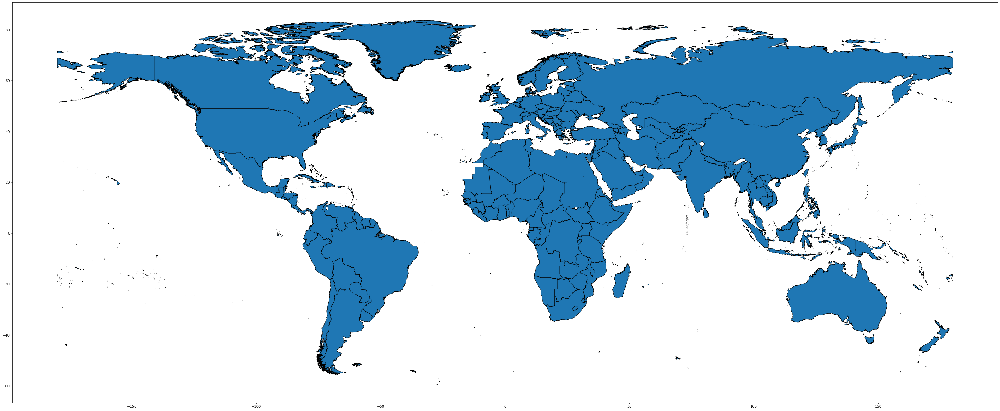

In [58]:
all_countries.plot(figsize=(50,50), color=None, linewidth=1, edgecolor='k')

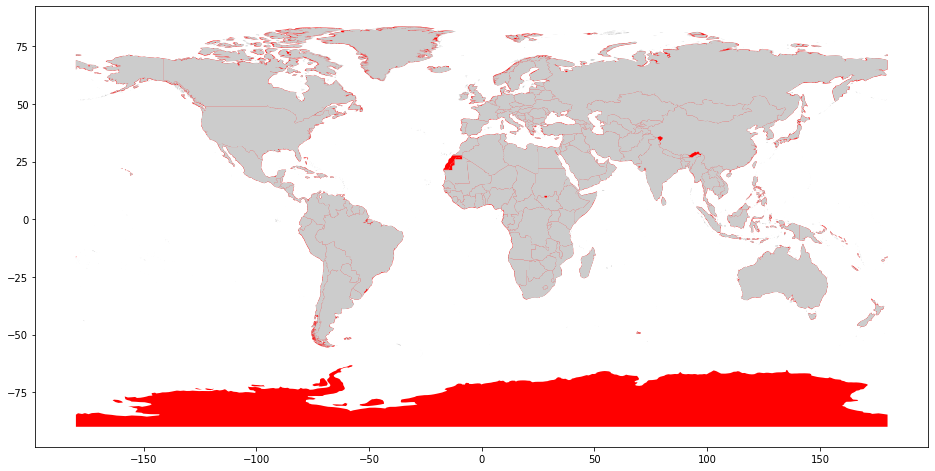

In [19]:
#@title Comparing World Bank's boundaries with another data source
df = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
fig, ax = plt.subplots(figsize=(16, 16))
df.plot(ax=ax, color='red')
all_countries.plot(ax=ax, color="#cccccc")
plt.show()

Using ISO_A3


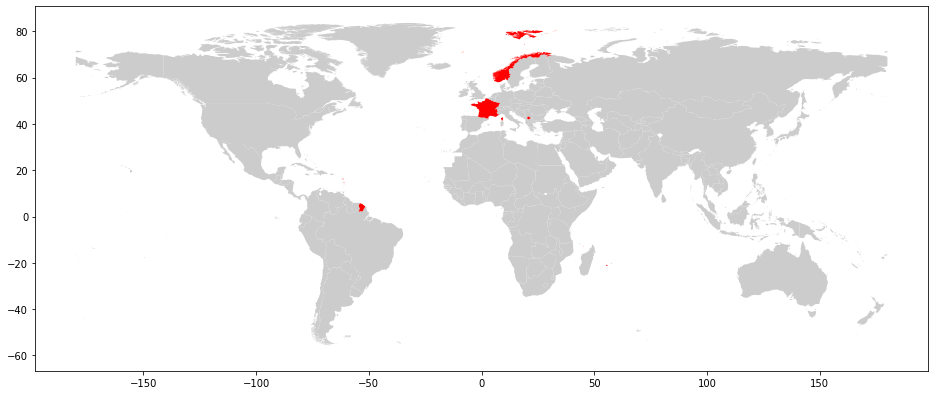

{'-99'}
Using WB_A3


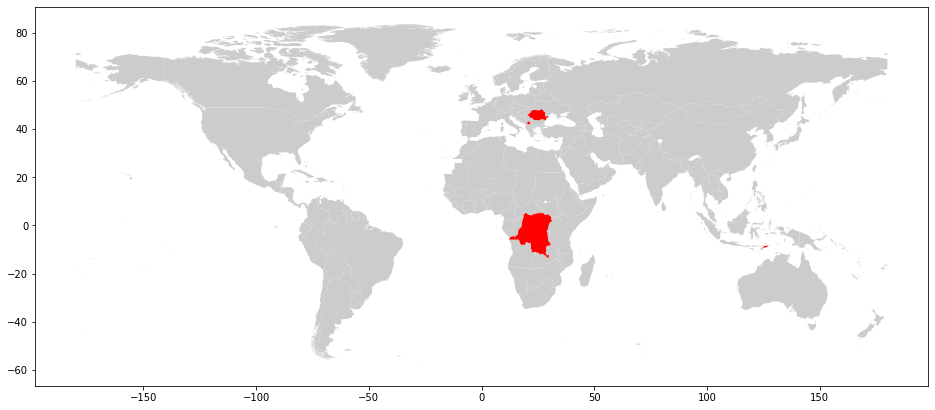

{'ZAR', 'ADO', 'IMY', 'TMP', 'ROM', 'KSV'}


In [20]:
#@title Verifying coverage between country codes in the dataset
for code in ['ISO_A3', 'WB_A3']:
  print(f'Using {code}')
  fig, ax = plt.subplots(figsize=(16, 16))
  all_countries[all_countries[code].isin(dc_country_codes)].plot(ax=ax, color='#cccccc')
  all_countries[all_countries[code].isin(set(all_countries[code]) - dc_country_codes)].plot(ax=ax, color='red')
  plt.show()

  print(set(all_countries[code]) - dc_country_codes)

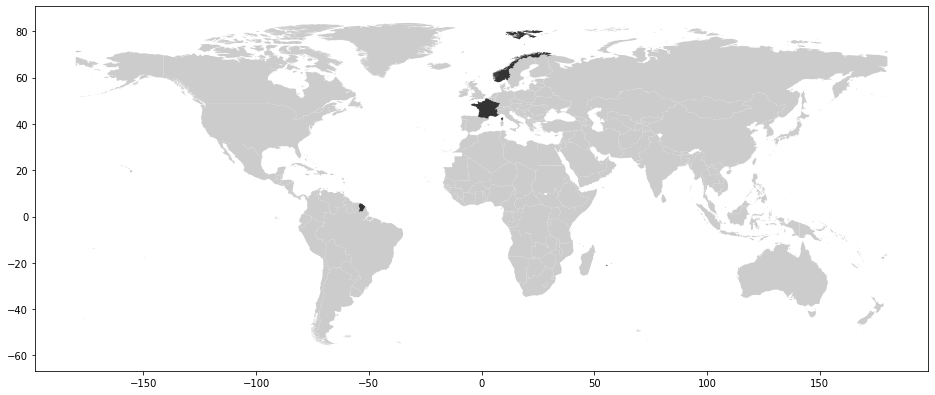

In [21]:
#@title Testing coverage with import codes
fig, ax = plt.subplots(figsize=(16, 16))
all_countries[all_countries['ISO_A3'].isin(dc_country_codes)].plot(ax=ax, color="#cccccc")
all_countries[all_countries['WB_A3'].isin(WB_A3_CODES_TO_IMPORT)].plot(ax=ax, color='#333333')
plt.show()

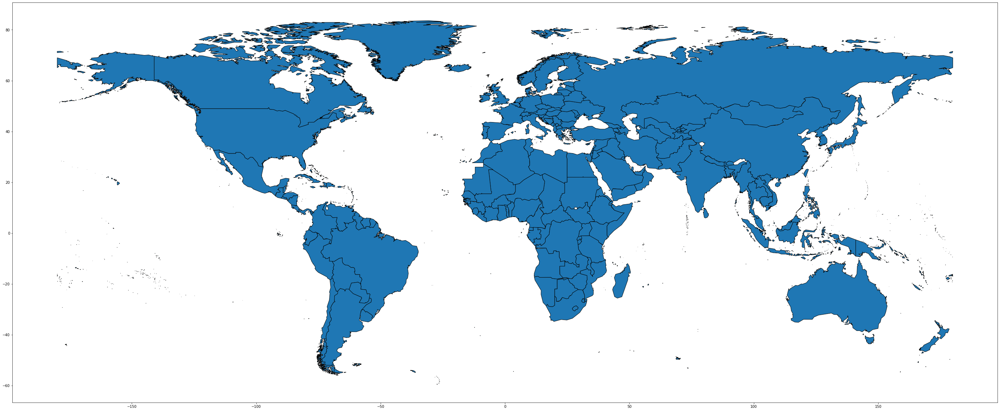

In [65]:
#@title Testing for acceptable thresholds
all_countries.simplify(0.2).plot(figsize=(50,50), color=None, linewidth=1, edgecolor='k')

Copying file:///tmp/USA.geojson [Content-Type=application/octet-stream]...
/ [1/1 files][  1.6 MiB/  1.6 MiB] 100% Done                                    
Operation completed over 1 objects/1.6 MiB.                                      


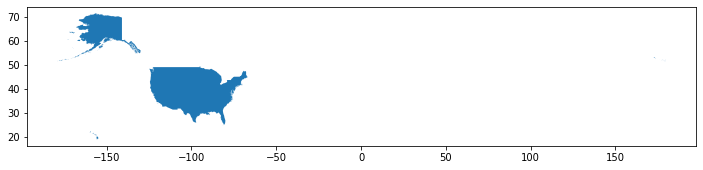

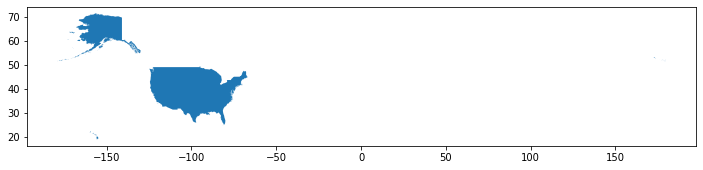

In [22]:
#@title
all_countries[all_countries['ISO_A3'] == 'USA'].plot(figsize=(12,12))
!rm -rf '/tmp/USA.geojson'
all_countries[all_countries['ISO_A3'] == 'USA'].to_file('/tmp/USA.geojson', driver='GeoJSON')
gpd.read_file('/tmp/USA.geojson').plot(figsize=(12,12))
!gsutil -m cp -r {'/tmp/USA.geojson'} {GCS_BUCKET}/countries

**Generating individual country geo jsons + MCF**
---

In [23]:
EXPORT_PATH = '/tmp/exports'
!mkdir -p {EXPORT_PATH}

def export_country_feature(country_code, country_data, dp_level):
  print(f'= Importing {country_code} {dp_level} =')
  fname = f'{EXPORT_PATH}/{country_code}_{dp_level}.geojson'
  country_data.to_file(fname, driver='GeoJSON')
  gpd.read_file(fname).plot(figsize=(5,5))
  plt.show()
  print()

= Importing -99 0 =


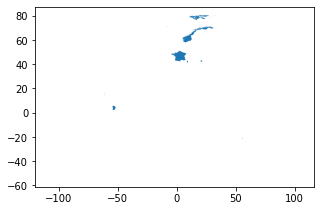


= Importing ABW 0 =


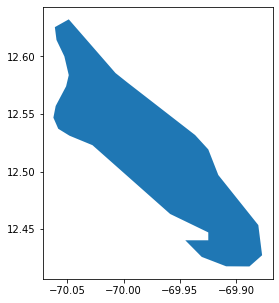


= Importing AFG 0 =


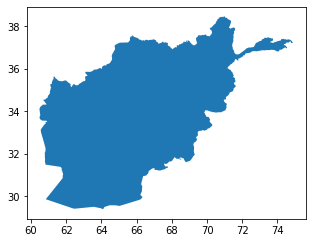


= Importing AGO 0 =


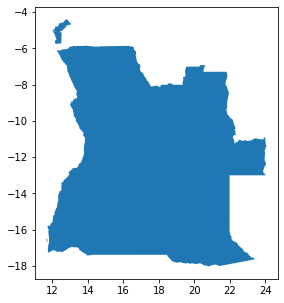


= Importing AIA 0 =


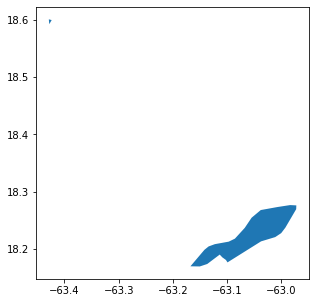


= Importing ALB 0 =


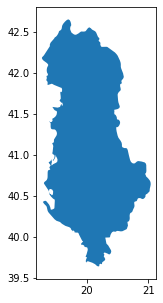


= Importing AND 0 =


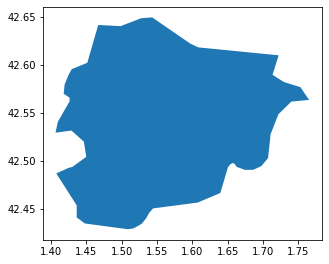


= Importing ARE 0 =


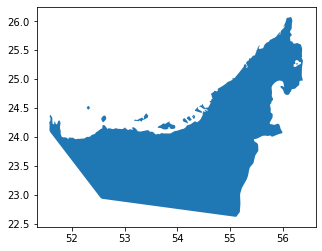


= Importing ARG 0 =


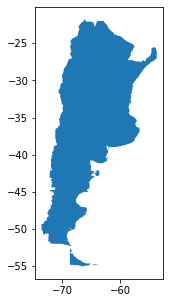


= Importing ARM 0 =


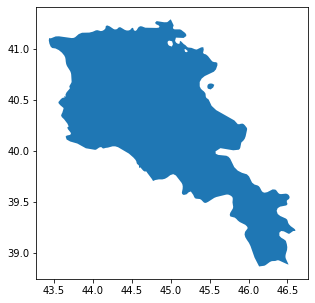


= Importing ASM 0 =


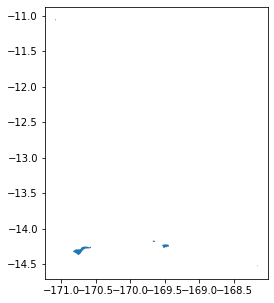


= Importing ATF 0 =


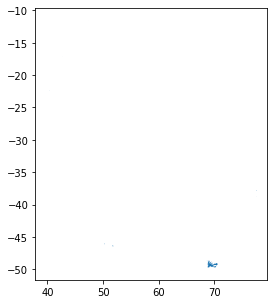


= Importing ATG 0 =


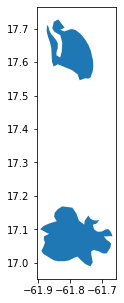


= Importing AUS 0 =


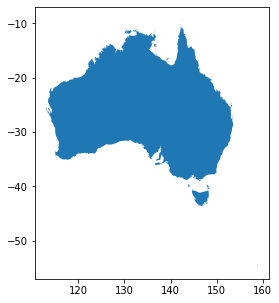


= Importing AUT 0 =


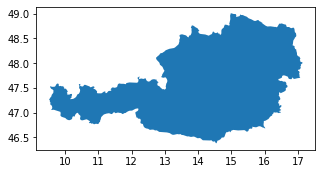


= Importing AZE 0 =


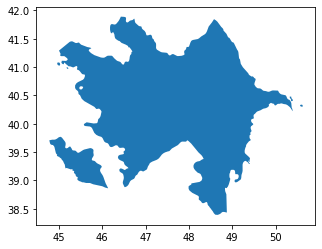


= Importing BDI 0 =


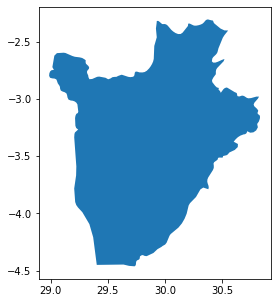


= Importing BEL 0 =


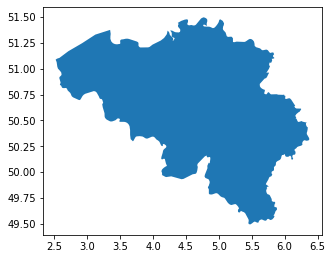


= Importing BEN 0 =


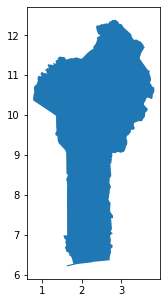


= Importing BFA 0 =


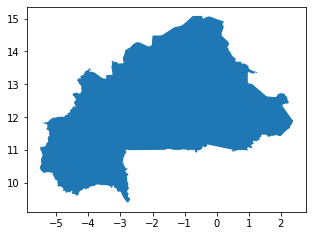


= Importing BGD 0 =


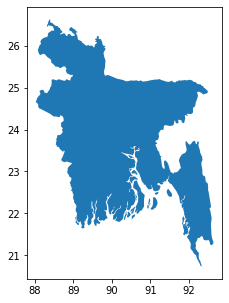


= Importing BGR 0 =


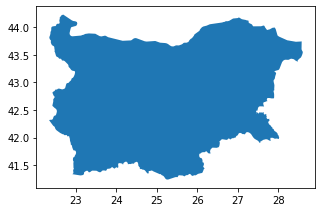


= Importing BHR 0 =


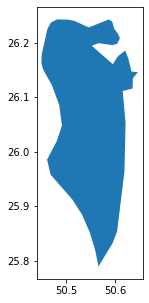


= Importing BHS 0 =


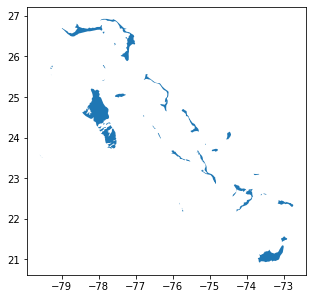


= Importing BIH 0 =


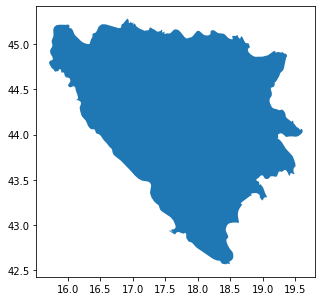


= Importing BLM 0 =


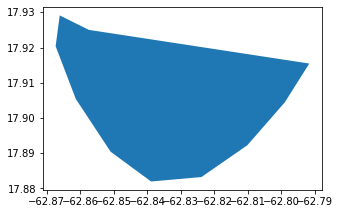


= Importing BLR 0 =


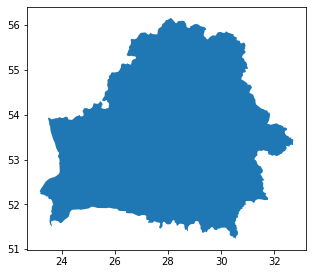


= Importing BLZ 0 =


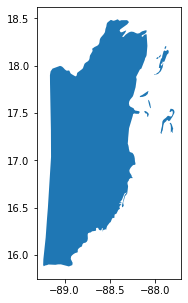


= Importing BMU 0 =


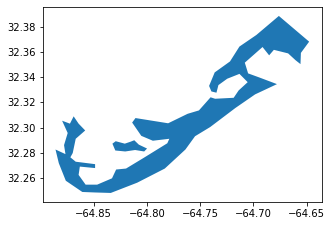


= Importing BOL 0 =


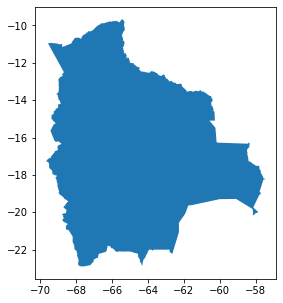


= Importing BRA 0 =


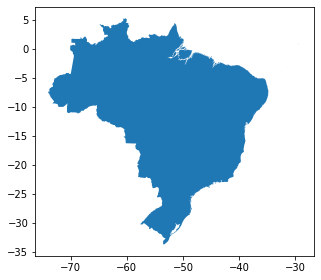


= Importing BRB 0 =


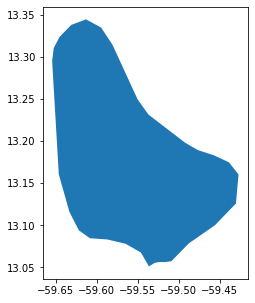


= Importing BRN 0 =


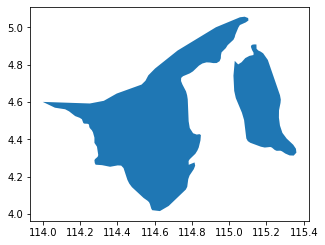


= Importing BTN 0 =


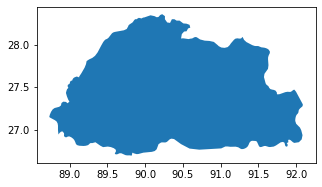


= Importing BWA 0 =


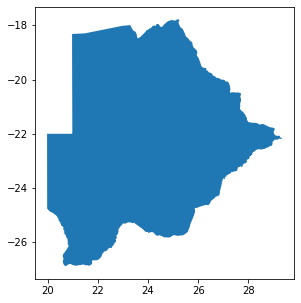


= Importing CAF 0 =


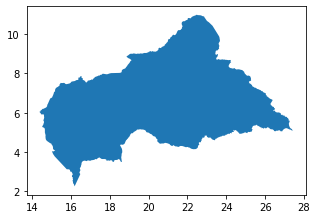


= Importing CAN 0 =


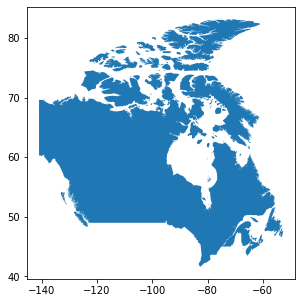


= Importing CHE 0 =


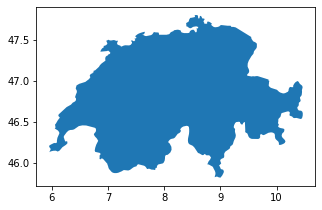


= Importing CHL 0 =


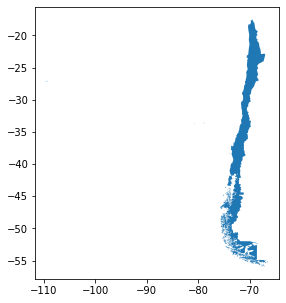


= Importing CHN 0 =


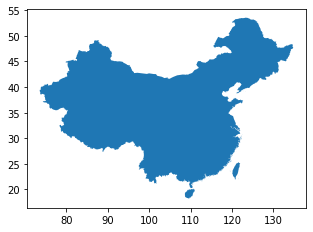


= Importing CIV 0 =


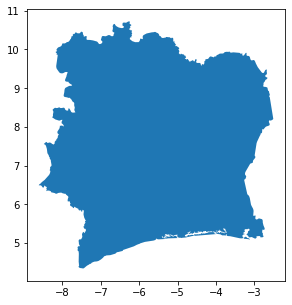


= Importing CMR 0 =


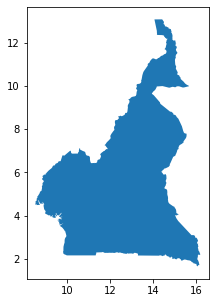


= Importing COD 0 =


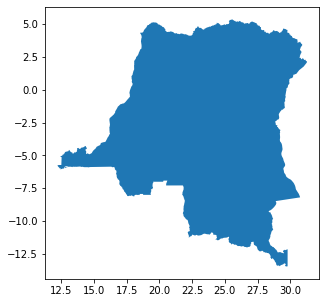


= Importing COG 0 =


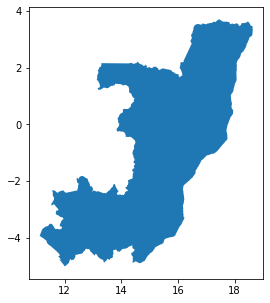


= Importing COK 0 =


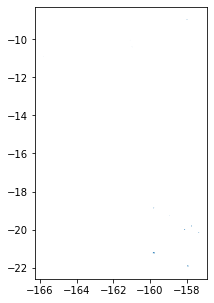


= Importing COL 0 =


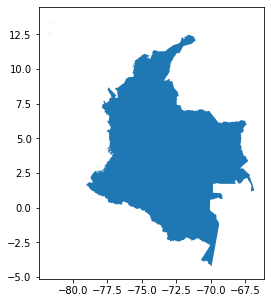


= Importing COM 0 =


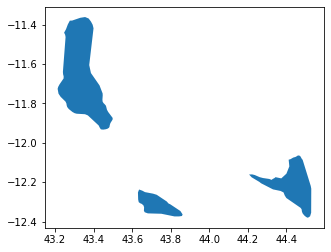


= Importing CPV 0 =


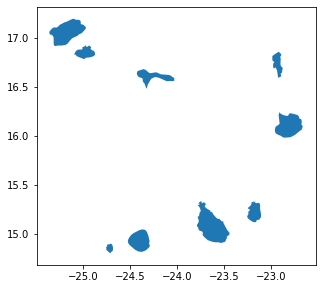


= Importing CRI 0 =


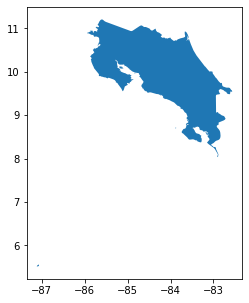


= Importing CUB 0 =


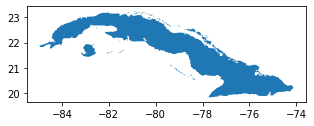


= Importing CUW 0 =


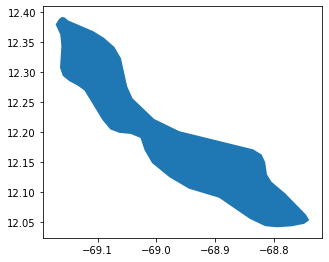


= Importing CYM 0 =


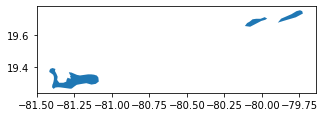


= Importing CYP 0 =


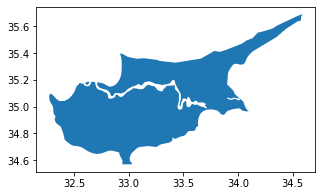


= Importing CZE 0 =


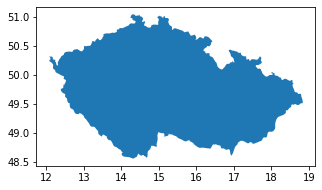


= Importing DEU 0 =


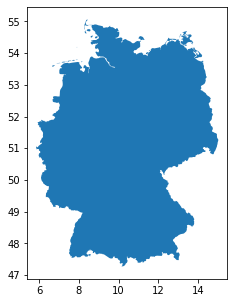


= Importing DJI 0 =


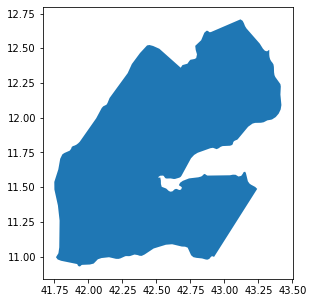


= Importing DMA 0 =


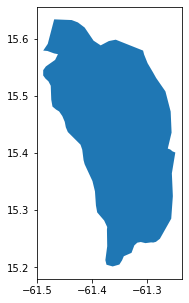


= Importing DNK 0 =


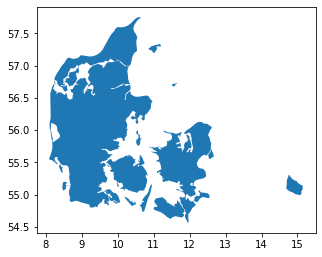


= Importing DOM 0 =


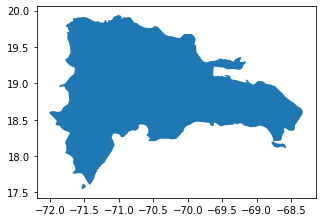


= Importing DZA 0 =


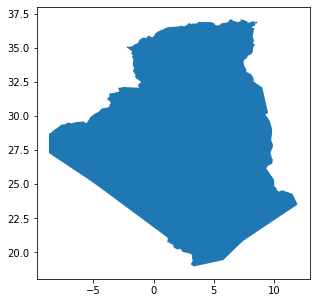


= Importing ECU 0 =


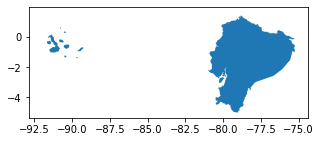


= Importing EGY 0 =


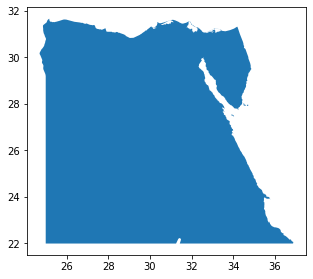


= Importing ERI 0 =


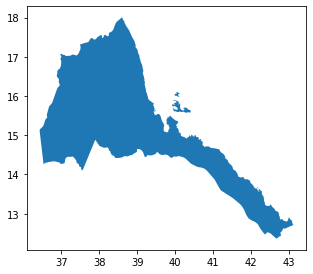


= Importing ESP 0 =


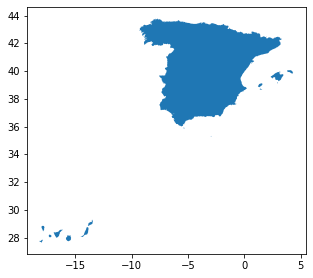


= Importing EST 0 =


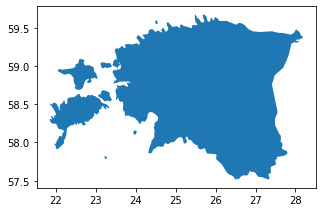


= Importing ETH 0 =


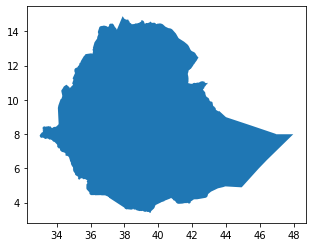


= Importing FIN 0 =


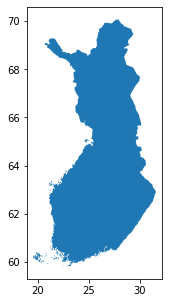


= Importing FJI 0 =


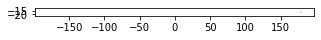


= Importing FLK 0 =


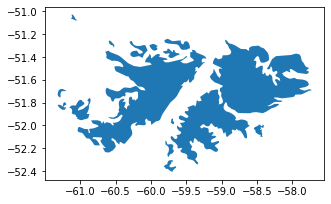


= Importing FRO 0 =


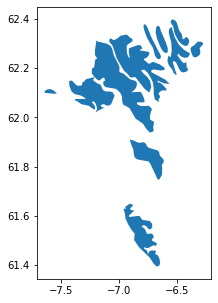


= Importing FSM 0 =


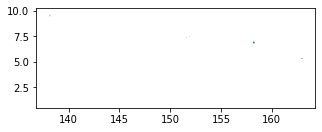


= Importing GAB 0 =


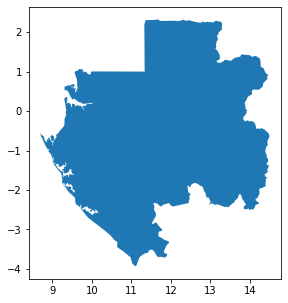


= Importing GBR 0 =


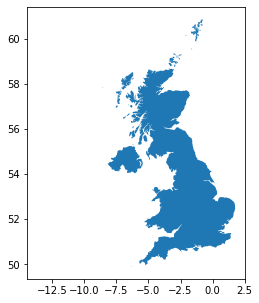


= Importing GEO 0 =


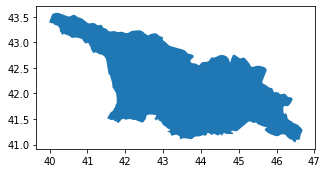


= Importing GGY 0 =


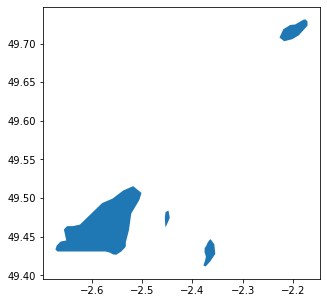


= Importing GHA 0 =


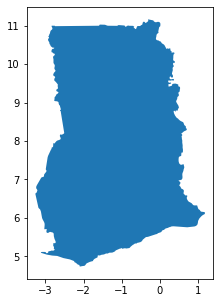


= Importing GIB 0 =


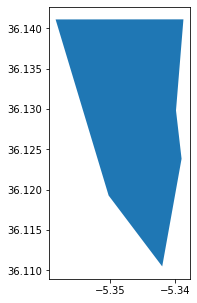


= Importing GIN 0 =


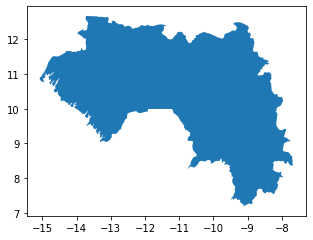


= Importing GMB 0 =


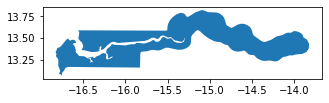


= Importing GNB 0 =


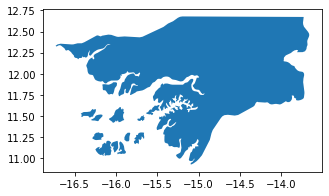


= Importing GNQ 0 =


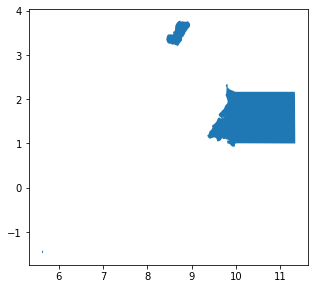


= Importing GRC 0 =


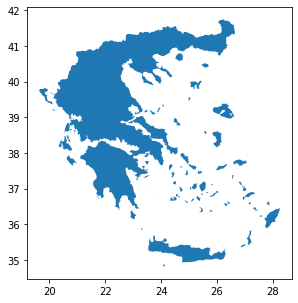


= Importing GRD 0 =


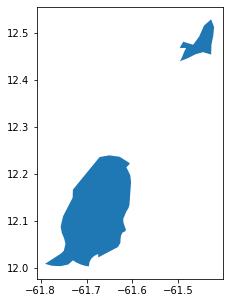


= Importing GRL 0 =


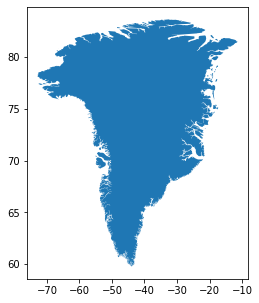


= Importing GTM 0 =


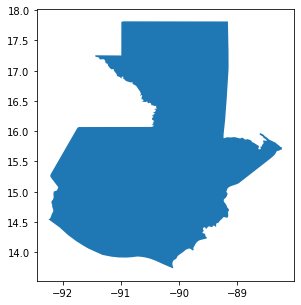


= Importing GUM 0 =


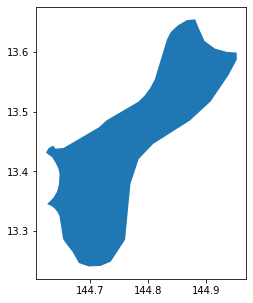


= Importing GUY 0 =


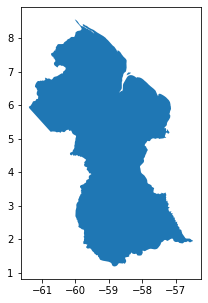


= Importing HKG 0 =


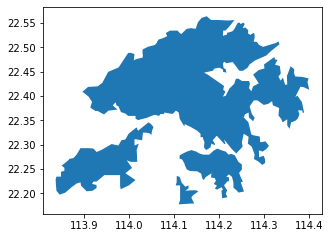


= Importing HMD 0 =


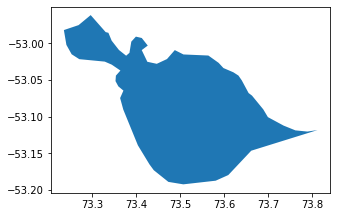


= Importing HND 0 =


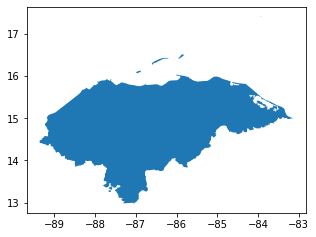


= Importing HRV 0 =


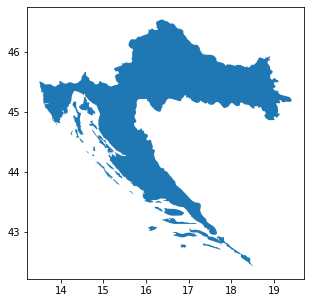


= Importing HTI 0 =


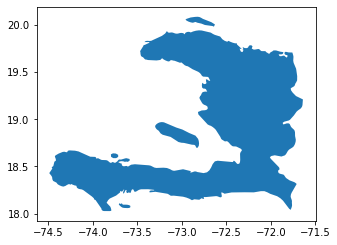


= Importing HUN 0 =


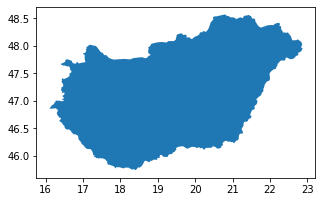


= Importing IDN 0 =


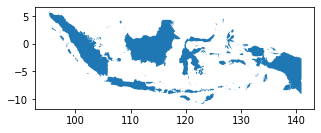


= Importing IMN 0 =


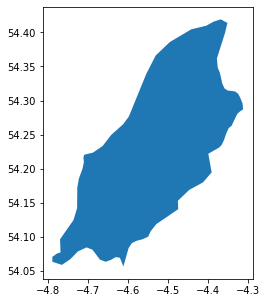


= Importing IND 0 =


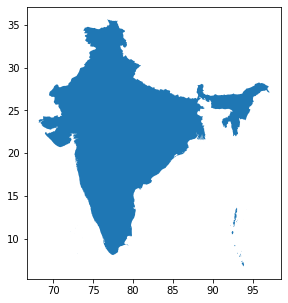


= Importing IOT 0 =


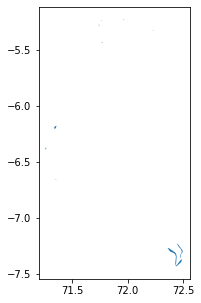


= Importing IRL 0 =


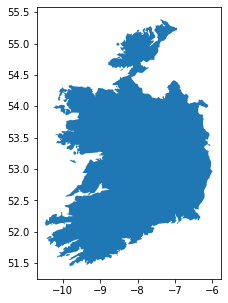


= Importing IRN 0 =


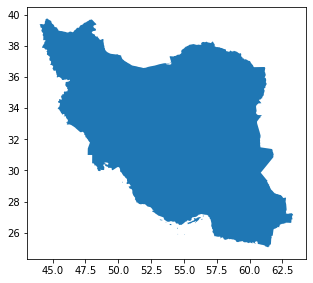


= Importing IRQ 0 =


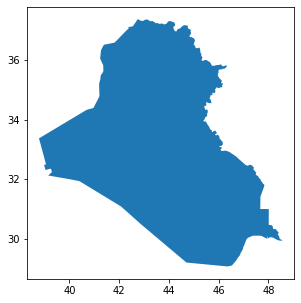


= Importing ISL 0 =


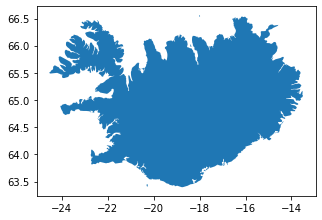


= Importing ISR 0 =


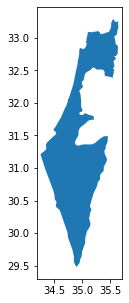


= Importing ITA 0 =


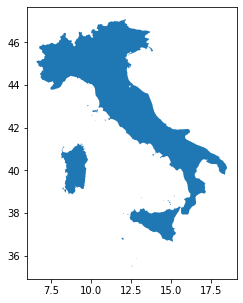


= Importing JAM 0 =


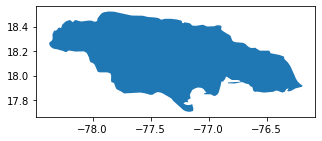


= Importing JEY 0 =


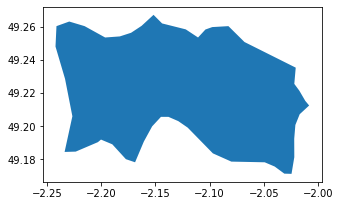


= Importing JOR 0 =


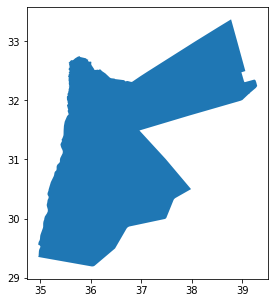


= Importing JPN 0 =


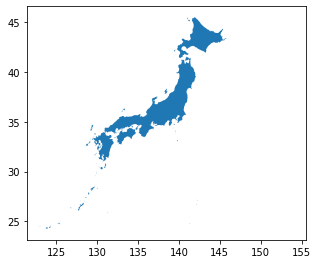


= Importing KAZ 0 =


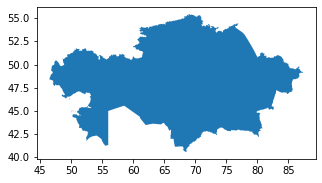


= Importing KEN 0 =


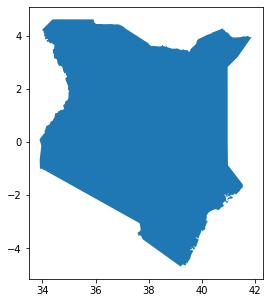


= Importing KGZ 0 =


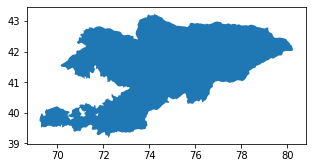


= Importing KHM 0 =


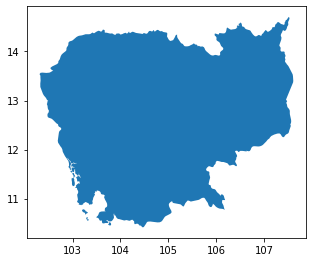


= Importing KIR 0 =


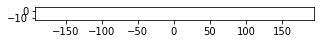


= Importing KNA 0 =


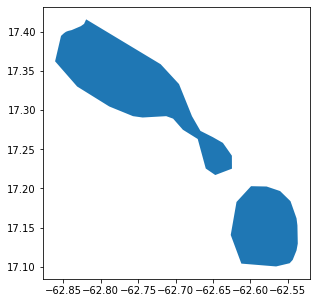


= Importing KOR 0 =


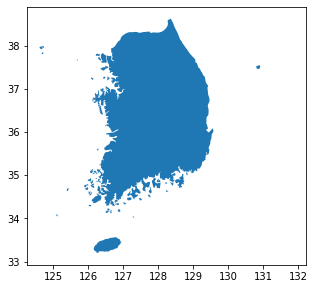


= Importing KWT 0 =


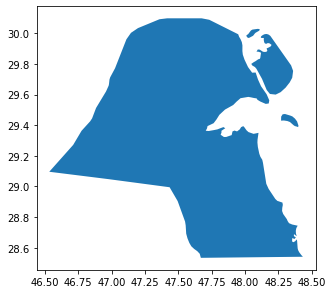


= Importing LAO 0 =


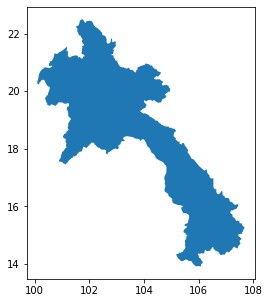


= Importing LBN 0 =


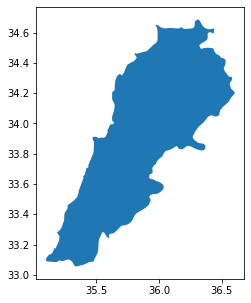


= Importing LBR 0 =


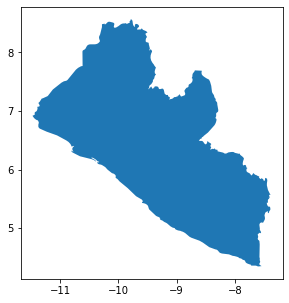


= Importing LBY 0 =


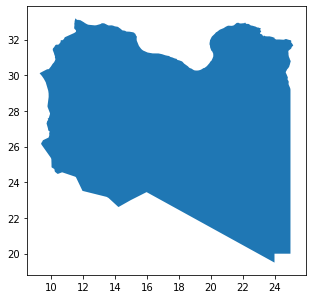


= Importing LCA 0 =


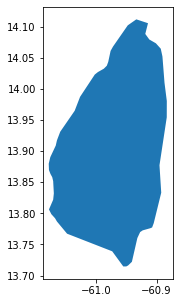


= Importing LIE 0 =


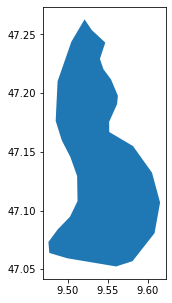


= Importing LKA 0 =


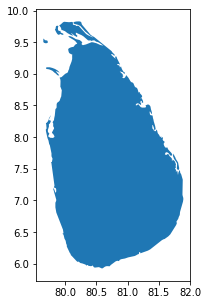


= Importing LSO 0 =


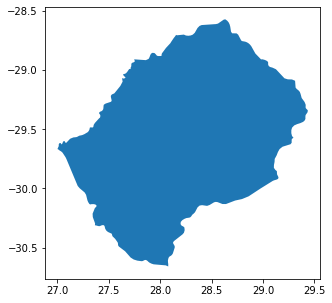


= Importing LTU 0 =


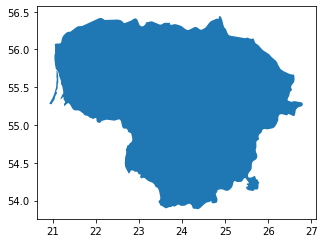


= Importing LUX 0 =


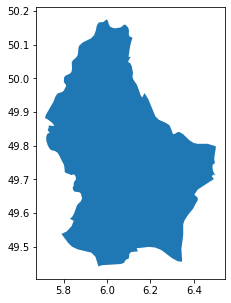


= Importing LVA 0 =


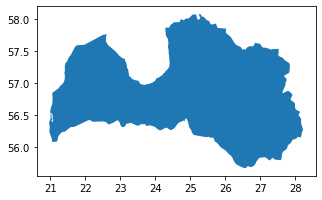


= Importing MAC 0 =


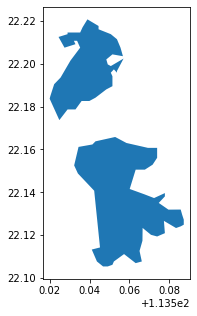


= Importing MAF 0 =


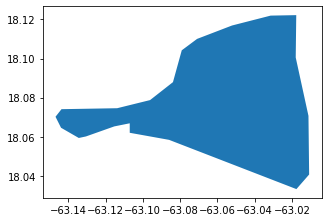


= Importing MAR 0 =


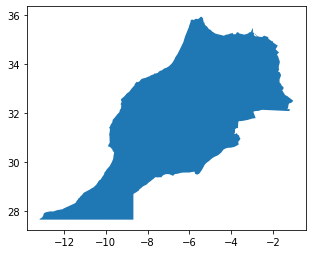


= Importing MCO 0 =


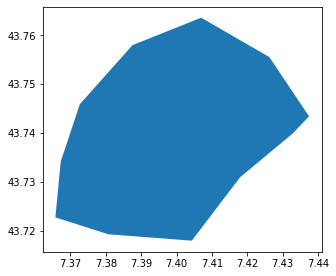


= Importing MDA 0 =


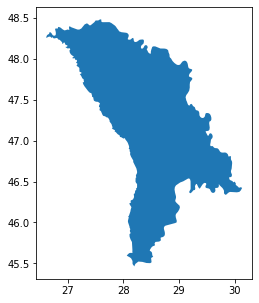


= Importing MDG 0 =


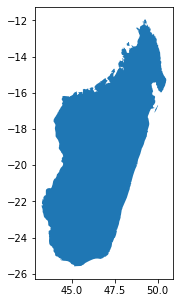


= Importing MDV 0 =


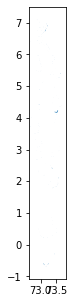


= Importing MEX 0 =


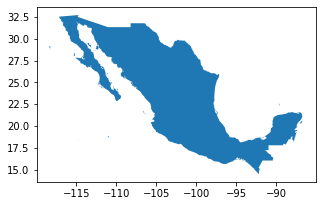


= Importing MHL 0 =


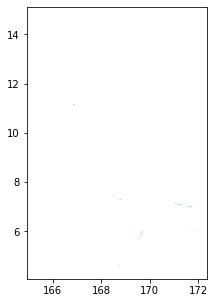


= Importing MKD 0 =


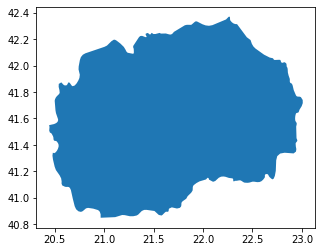


= Importing MLI 0 =


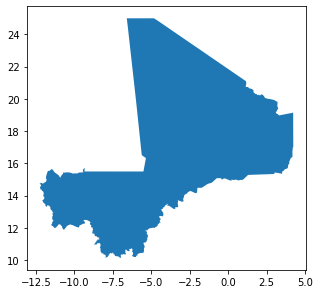


= Importing MLT 0 =


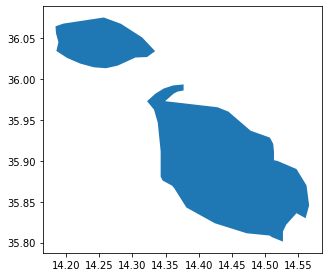


= Importing MMR 0 =


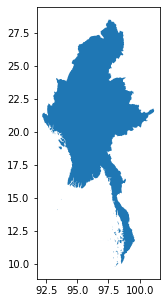


= Importing MNE 0 =


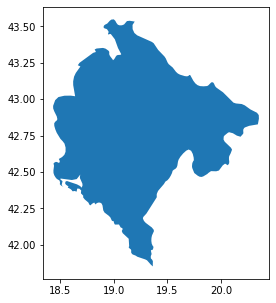


= Importing MNG 0 =


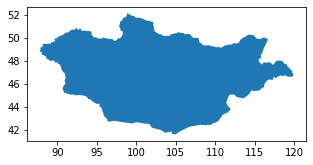


= Importing MNP 0 =


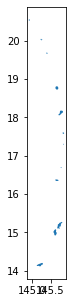


= Importing MOZ 0 =


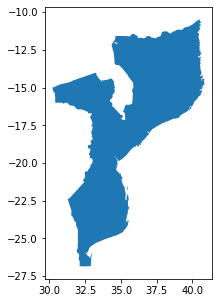


= Importing MRT 0 =


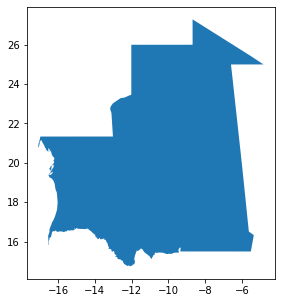


= Importing MSR 0 =


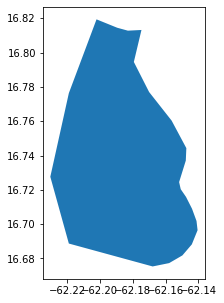


= Importing MUS 0 =


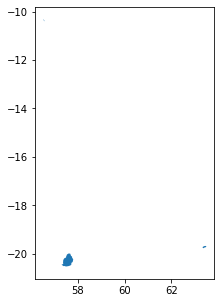


= Importing MWI 0 =


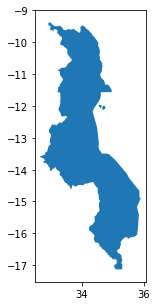


= Importing MYS 0 =


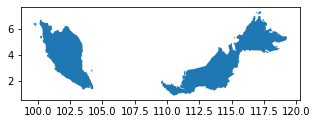


= Importing NAM 0 =


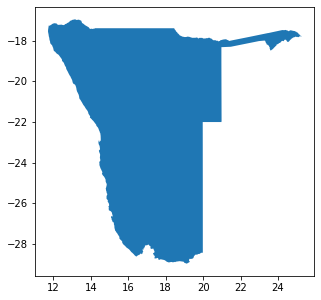


= Importing NCL 0 =


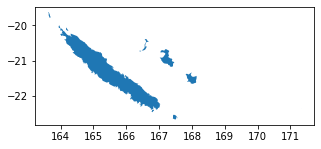


= Importing NER 0 =


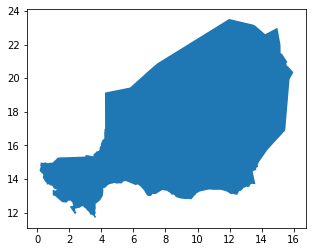


= Importing NFK 0 =


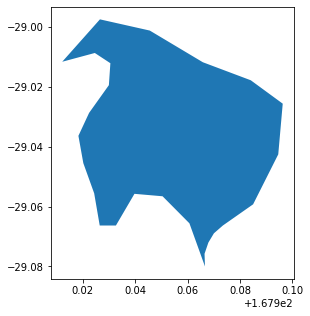


= Importing NGA 0 =


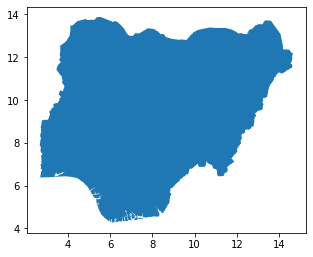


= Importing NIC 0 =


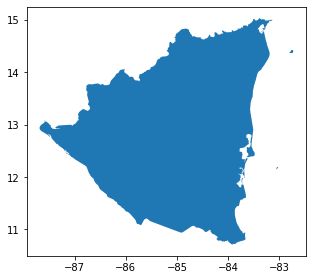


= Importing NIU 0 =


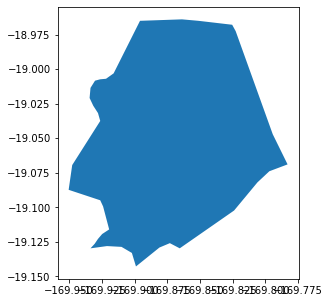


= Importing NLD 0 =


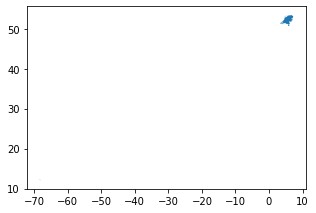


= Importing NPL 0 =


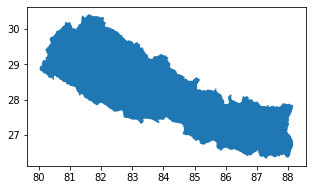


= Importing NRU 0 =


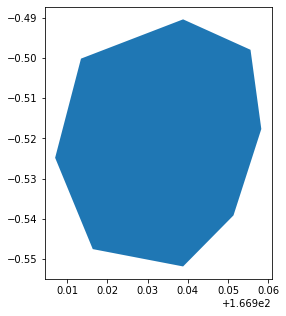


= Importing NZL 0 =


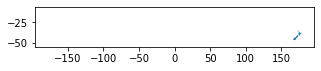


= Importing OMN 0 =


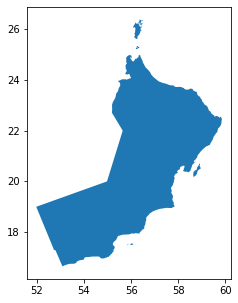


= Importing PAK 0 =


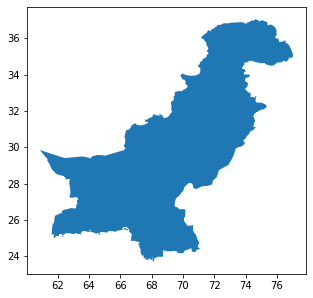


= Importing PAN 0 =


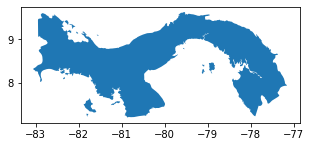


= Importing PCN 0 =


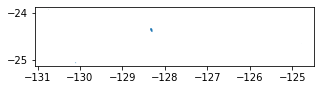


= Importing PER 0 =


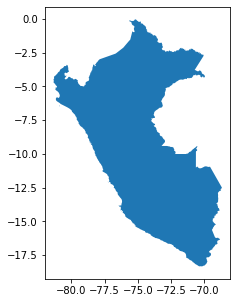


= Importing PHL 0 =


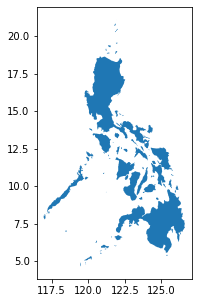


= Importing PLW 0 =


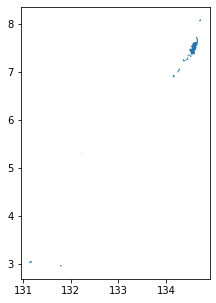


= Importing PNG 0 =


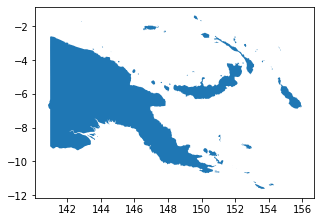


= Importing POL 0 =


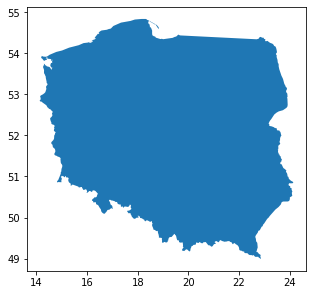


= Importing PRI 0 =


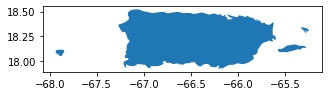


= Importing PRK 0 =


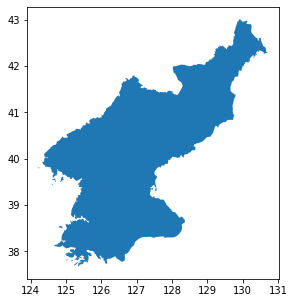


= Importing PRT 0 =


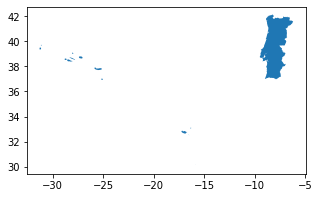


= Importing PRY 0 =


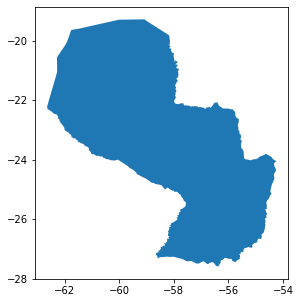


= Importing PSE 0 =


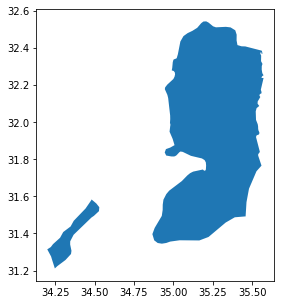


= Importing PYF 0 =


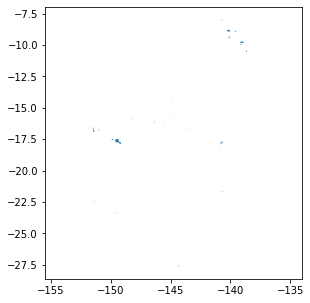


= Importing QAT 0 =


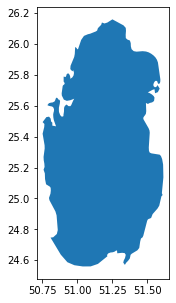


= Importing ROU 0 =


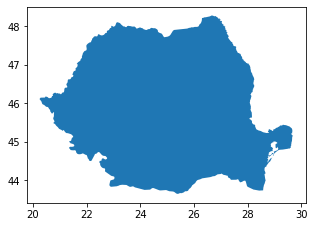


= Importing RUS 0 =


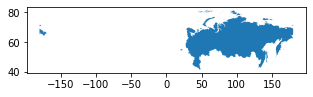


= Importing RWA 0 =


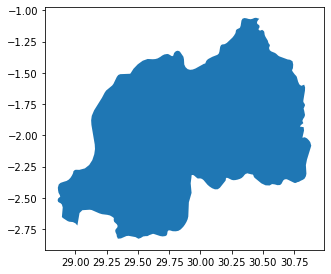


= Importing SAU 0 =


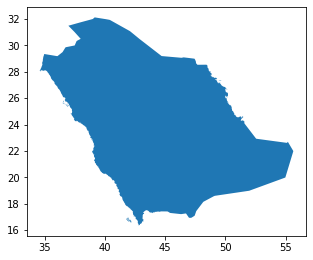


= Importing SDN 0 =


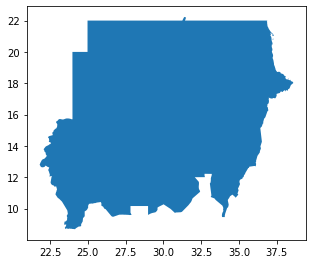


= Importing SEN 0 =


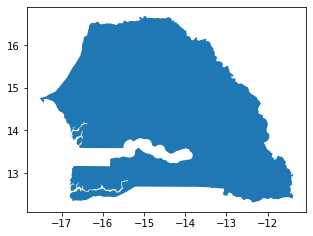


= Importing SGP 0 =


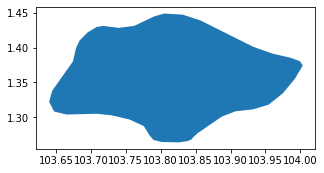


= Importing SGS 0 =


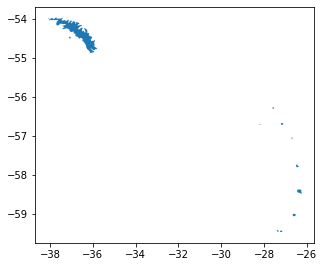


= Importing SHN 0 =


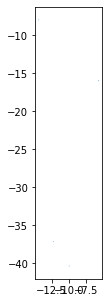


= Importing SLB 0 =


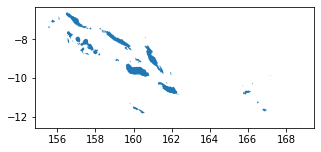


= Importing SLE 0 =


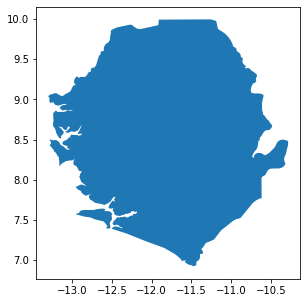


= Importing SLV 0 =


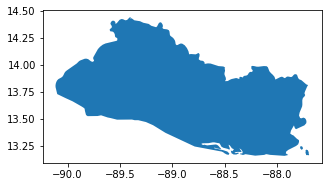


= Importing SMR 0 =


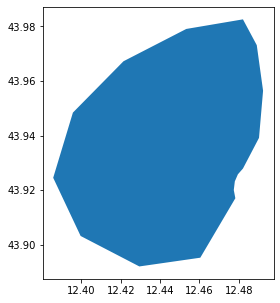


= Importing SOM 0 =


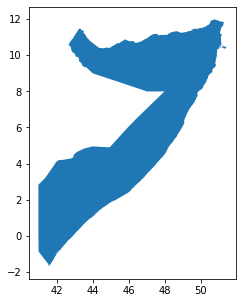


= Importing SPM 0 =


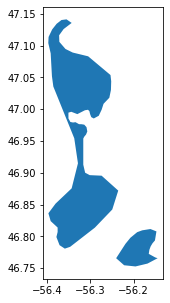


= Importing SRB 0 =


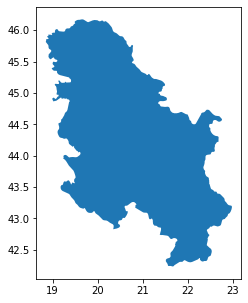


= Importing SSD 0 =


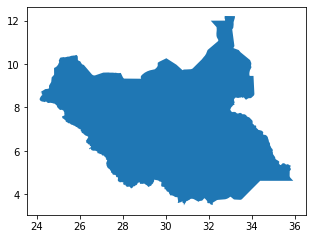


= Importing STP 0 =


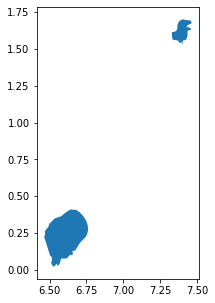


= Importing SUR 0 =


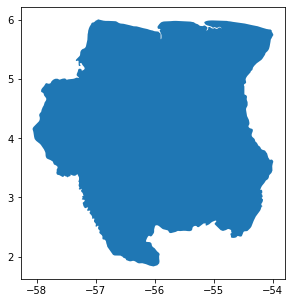


= Importing SVK 0 =


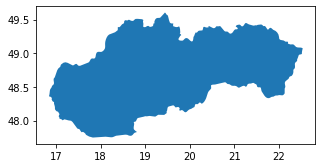


= Importing SVN 0 =


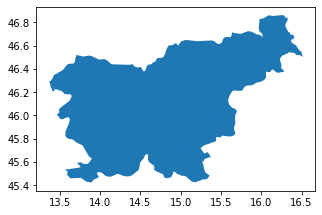


= Importing SWE 0 =


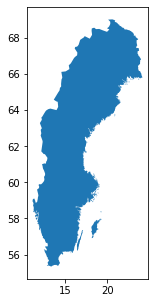


= Importing SWZ 0 =


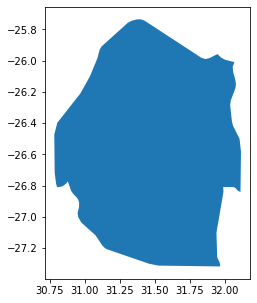


= Importing SXM 0 =


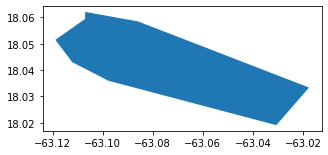


= Importing SYC 0 =


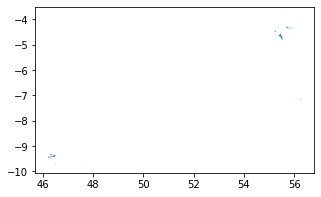


= Importing SYR 0 =


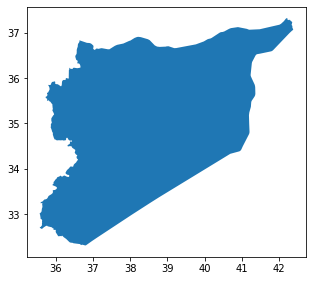


= Importing TCA 0 =


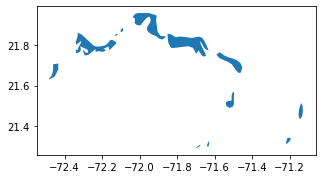


= Importing TCD 0 =


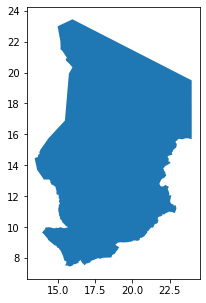


= Importing TGO 0 =


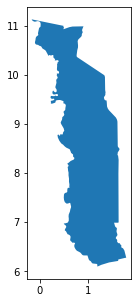


= Importing THA 0 =


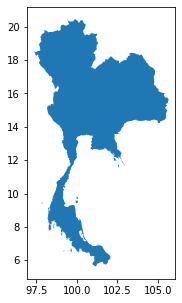


= Importing TJK 0 =


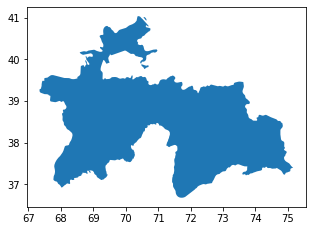


= Importing TKM 0 =


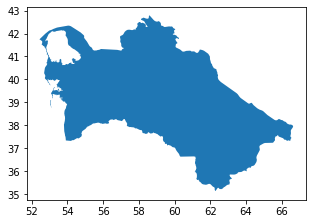


= Importing TLS 0 =


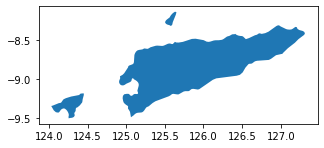


= Importing TON 0 =


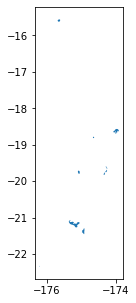


= Importing TTO 0 =


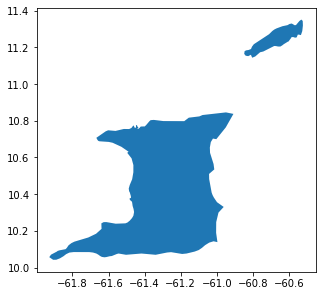


= Importing TUN 0 =


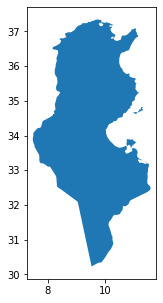


= Importing TUR 0 =


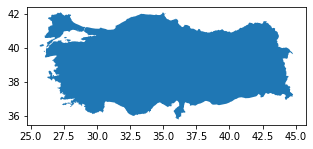


= Importing TUV 0 =


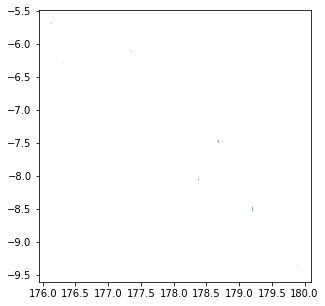


= Importing TZA 0 =


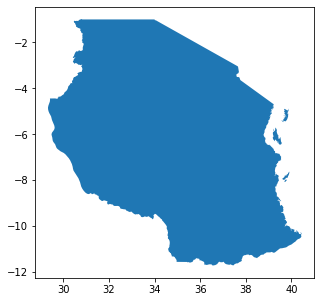


= Importing UGA 0 =


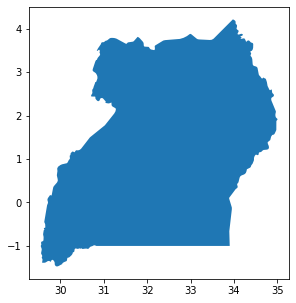


= Importing UKR 0 =


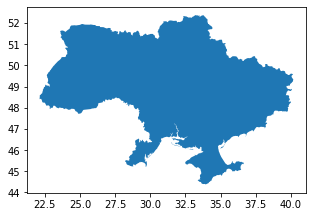


= Importing UMI 0 =


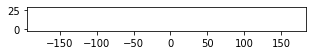


= Importing URY 0 =


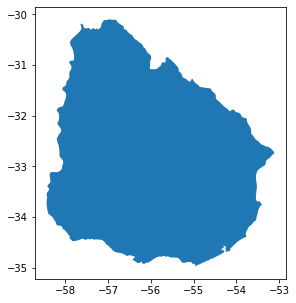


= Importing USA 0 =


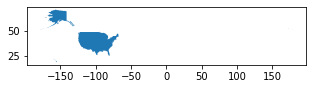


= Importing UZB 0 =


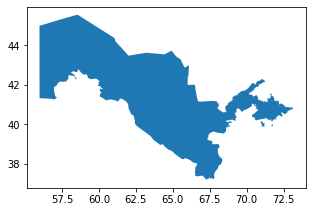


= Importing VAT 0 =


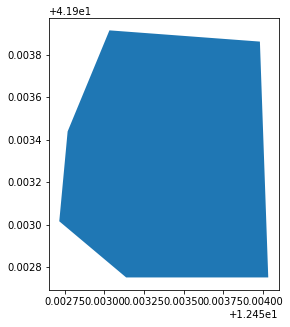


= Importing VCT 0 =


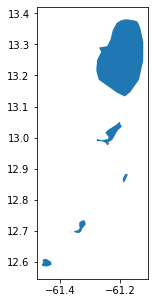


= Importing VEN 0 =


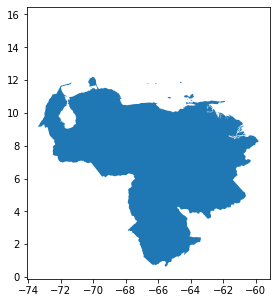


= Importing VGB 0 =


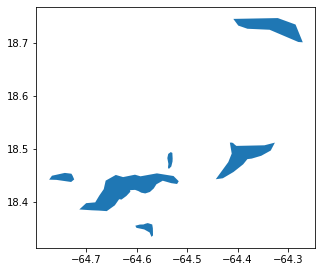


= Importing VIR 0 =


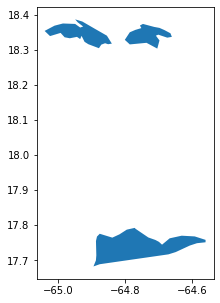


= Importing VNM 0 =


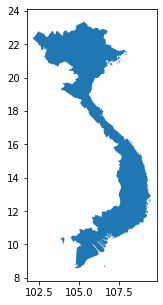


= Importing VUT 0 =


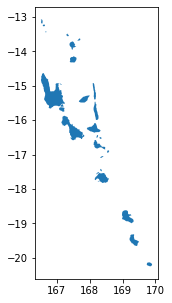


= Importing WLF 0 =


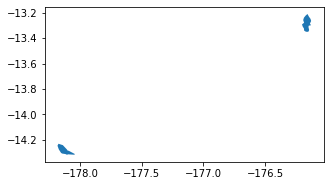


= Importing WSM 0 =


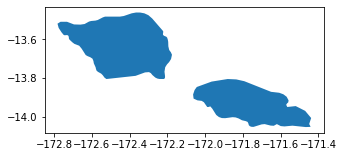


= Importing YEM 0 =


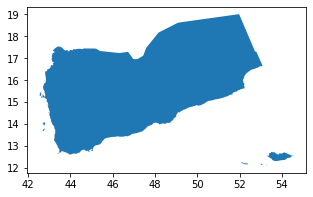


= Importing ZAF 0 =


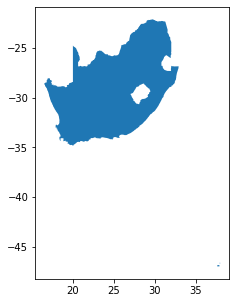


= Importing ZMB 0 =


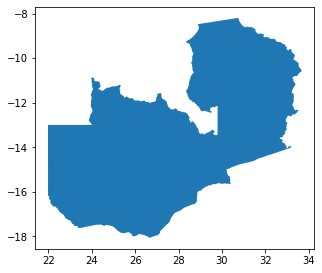


= Importing ZWE 0 =


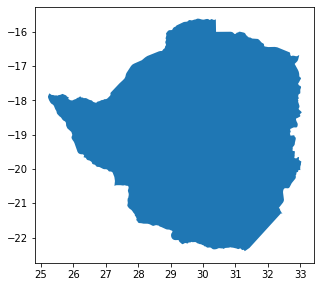


= Importing BES 0 =


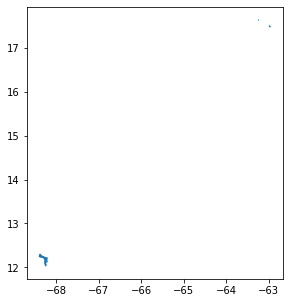


= Importing CCK 0 =


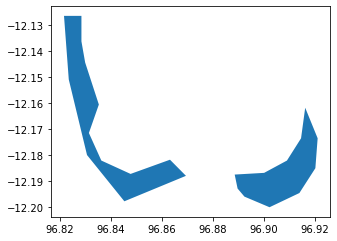


= Importing CXR 0 =


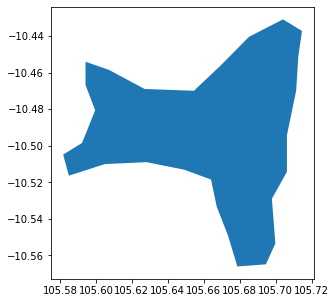


= Importing FRA 0 =


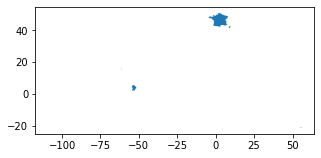


= Importing NOR 0 =


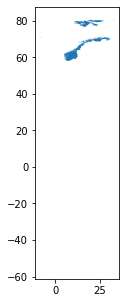


= Importing TKL 0 =


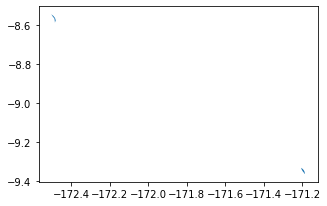

In [24]:
code = 'ISO_A3'
dp_level = '0'
for country_code in sorted(all_countries[code].unique()):
  country_data = all_countries[all_countries[code] == country_code]
  export_country_feature(country_code, country_data, dp_level)

for country_code in sorted(WB_A3_CODES_TO_IMPORT):
  country_data = all_countries[all_countries['WB_A3'] == country_code]
  export_country_feature(country_code, country_data, dp_level)

In [25]:
def country_code_from_fpath(fpath):
  return fpath[len(EXPORT_PATH)+1:-len("_0.geojson")]

-99	is_in_dc=False


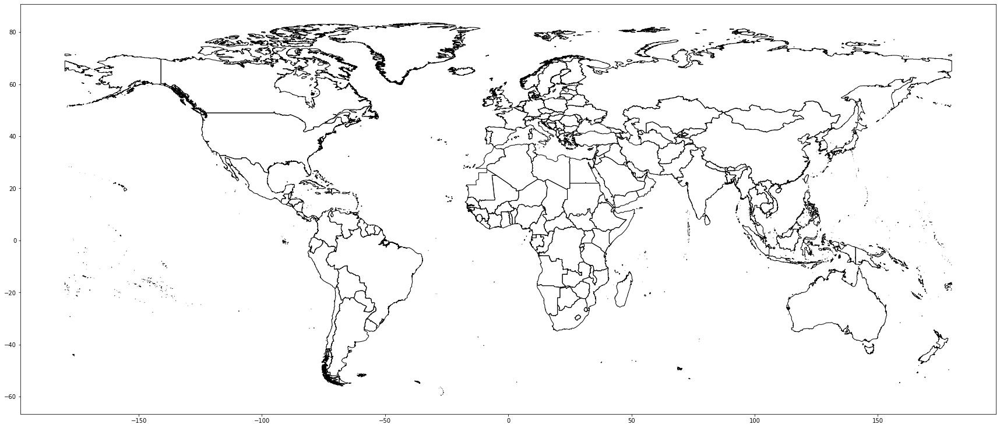

In [26]:
#@title Assembling world map from individual geojson files
import glob

exported_countries = set()

fig, ax = plt.subplots(figsize = (30,30)) 
for fpath in sorted(glob.glob(f'{EXPORT_PATH}/*.geojson')):
  country_code = country_code_from_fpath(fpath)
  exported_countries.add(country_code)
  in_dc = is_dc_country(country_code)
  if not in_dc:
    print(f'{country_code}\tis_in_dc={in_dc}')
    continue
  gpd.read_file(fpath).geometry.boundary.plot(color=None, edgecolor='k', linewidth=1, ax=ax)

In [27]:
#@title Testing the output of an individual geojson
#@markdown Note that it still includes all the features / data from the data source
with open(f'{EXPORT_PATH}/ABW_0.geojson') as f:
  # geostr = f.read()
  geostr = json.load(f)
  # Note: the double use of json.dumps automatically escapes all
  # inner quotes, and encloses the entire string in quotes.
  print(json.dumps(json.dumps(geostr)))


"{\"type\": \"FeatureCollection\", \"crs\": {\"type\": \"name\", \"properties\": {\"name\": \"urn:ogc:def:crs:OGC:1.3:CRS84\"}}, \"features\": [{\"type\": \"Feature\", \"properties\": {\"FID\": 171, \"OBJECTID\": 172, \"featurecla\": \"Admin-0 country\", \"LEVEL\": 2, \"TYPE\": \"Country\", \"FORMAL_EN\": \"Aruba\", \"FORMAL_FR\": \" \", \"POP_EST\": 115120, \"POP_RANK\": 9, \"GDP_MD_EST\": 2516.0, \"POP_YEAR\": 2017, \"LASTCENSUS\": 2010, \"GDP_YEAR\": 2009, \"ECONOMY\": \"6. Developing region\", \"INCOME_GRP\": \"2. High income: nonOECD\", \"FIPS_10_\": \"AA\", \"ISO_A2\": \"AW\", \"ISO_A3\": \"ABW\", \"ISO_A3_EH\": \"ABW\", \"ISO_N3\": \"533\", \"UN_A3\": \"533\", \"WB_A2\": \"AW\", \"WB_A3\": \"ABW\", \"CONTINENT\": \"North America\", \"REGION_UN\": \"Americas\", \"SUBREGION\": \"Caribbean\", \"REGION_WB\": \"Latin America & Caribbean\", \"NAME_AR\": \"\\u0623\\u0631\\u0648\\u0628\\u0627\", \"NAME_BN\": \"\\u0986\\u09b0\\u09c1\\u09ac\\u09be\", \"NAME_DE\": \"Aruba\", \"NAME_EN\": \

**Generate simplified geo jsons**
---

= Importing ABW 4 =


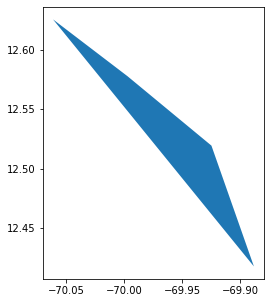


= Importing ABW 5 =


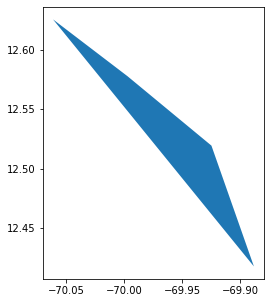


= Importing ABW 6 =


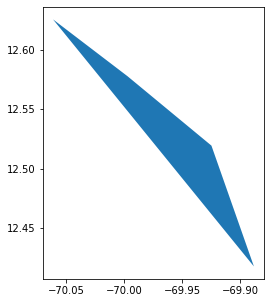


= Importing ABW 7 =


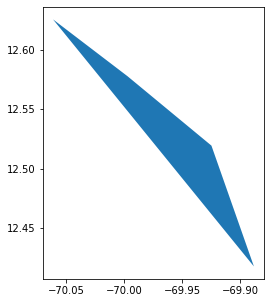


= Importing ABW 8 =


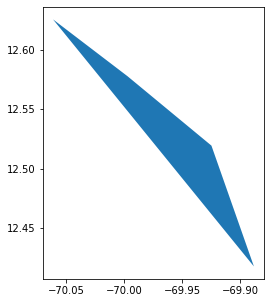


= Importing ABW 9 =


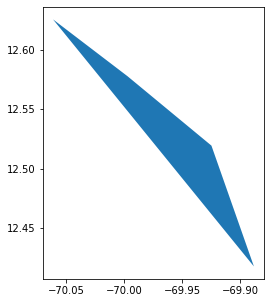


= Importing AFG 4 =


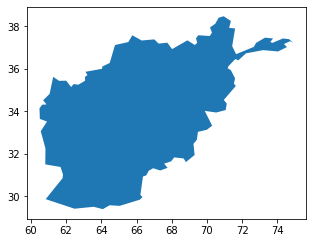


= Importing AFG 5 =


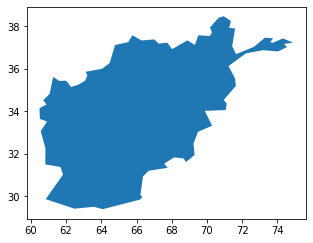


= Importing AFG 6 =


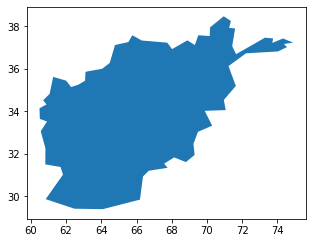


= Importing AFG 7 =


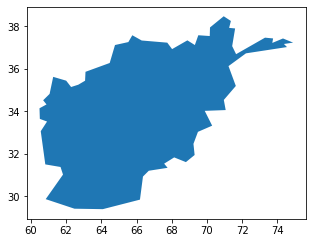


= Importing AFG 8 =


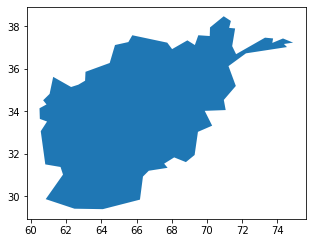


= Importing AFG 9 =


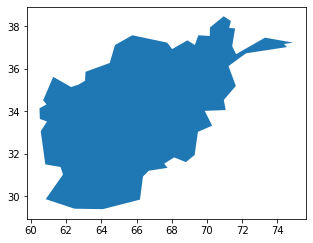


= Importing AGO 4 =


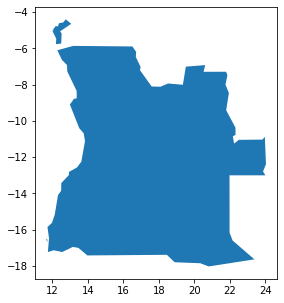


= Importing AGO 5 =


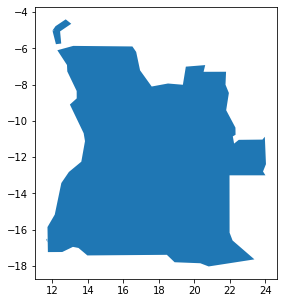


= Importing AGO 6 =


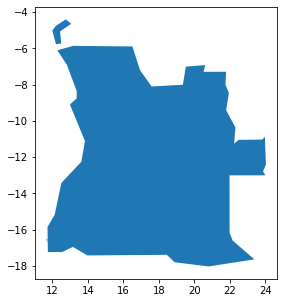


= Importing AGO 7 =


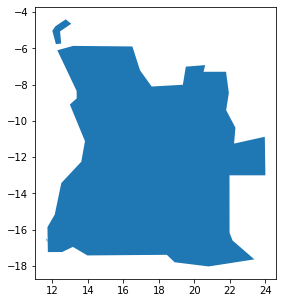


= Importing AGO 8 =


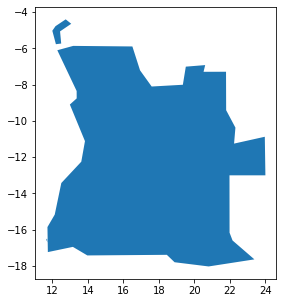


= Importing AGO 9 =


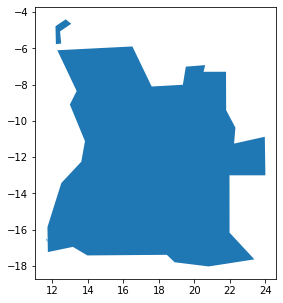


= Importing AIA 4 =


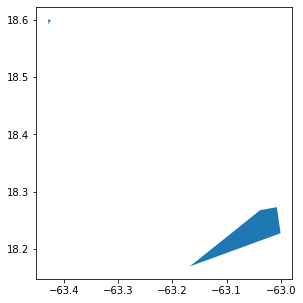


= Importing AIA 5 =


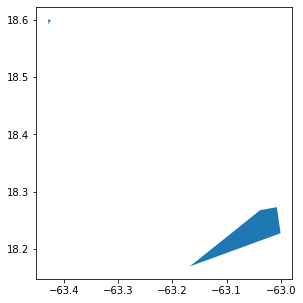


= Importing AIA 6 =


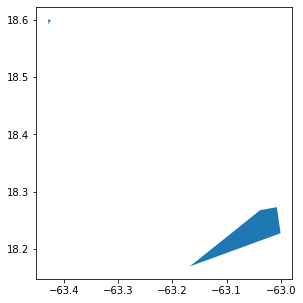


= Importing AIA 7 =


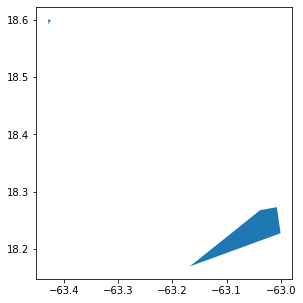


= Importing AIA 8 =


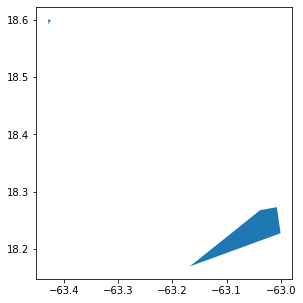


= Importing AIA 9 =


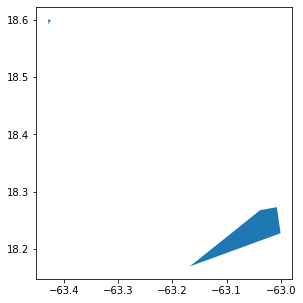


= Importing ALB 4 =


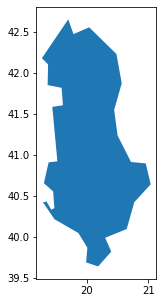


= Importing ALB 5 =


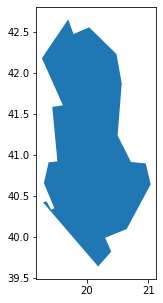


= Importing ALB 6 =


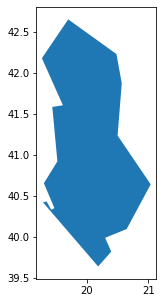


= Importing ALB 7 =


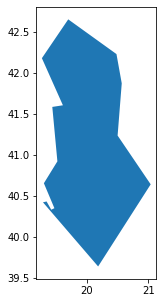


= Importing ALB 8 =


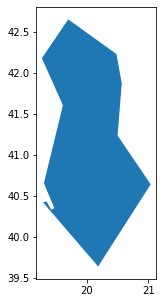


= Importing ALB 9 =


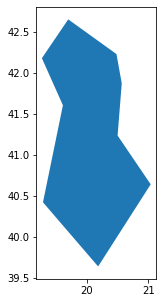


= Importing AND 4 =


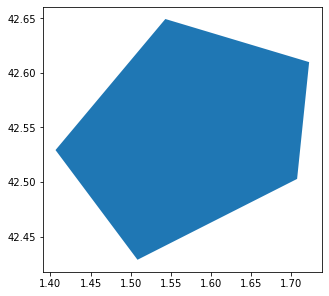


= Importing AND 5 =


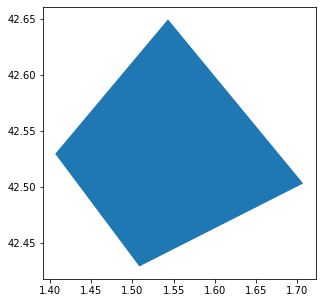


= Importing AND 6 =


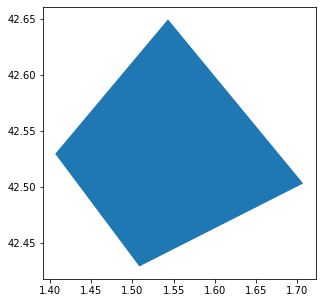


= Importing AND 7 =


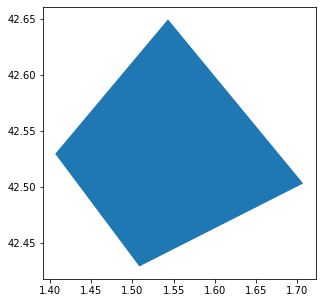


= Importing AND 8 =


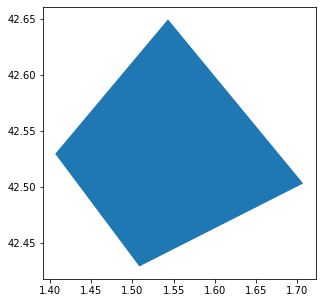


= Importing AND 9 =


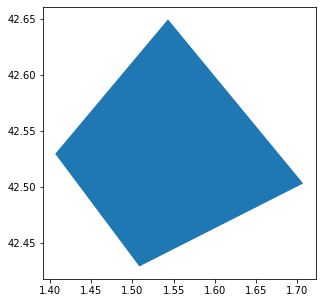


= Importing ARE 4 =


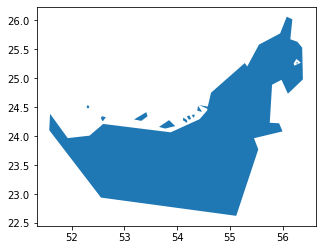


= Importing ARE 5 =


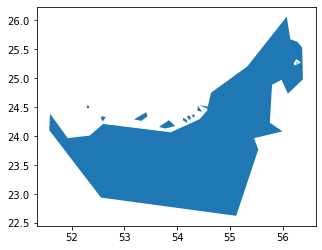


= Importing ARE 6 =


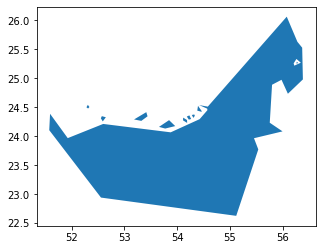


= Importing ARE 7 =


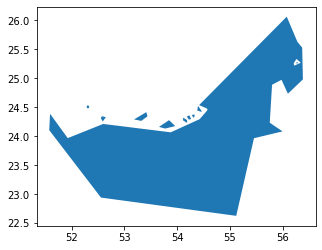


= Importing ARE 8 =


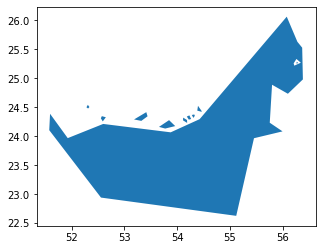


= Importing ARE 9 =


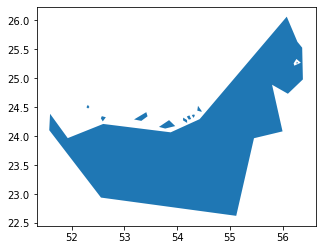


= Importing ARG 4 =


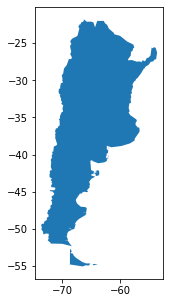


= Importing ARG 5 =


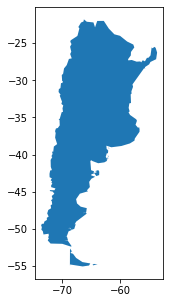


= Importing ARG 6 =


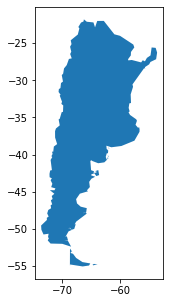


= Importing ARG 7 =


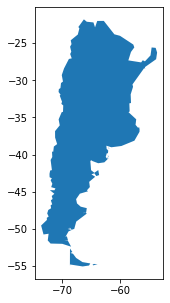


= Importing ARG 8 =


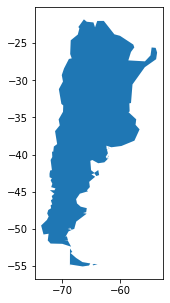


= Importing ARG 9 =


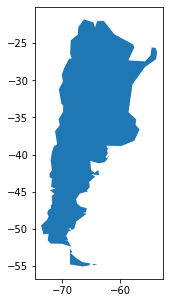


= Importing ARM 4 =


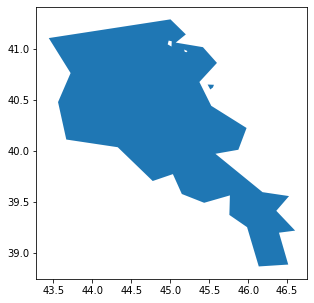


= Importing ARM 5 =


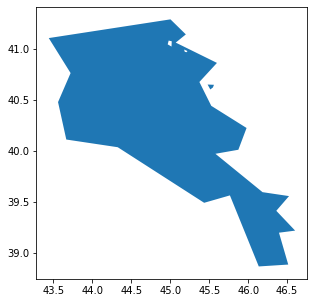


= Importing ARM 6 =


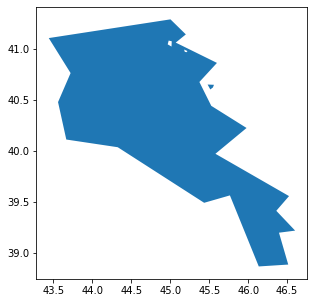


= Importing ARM 7 =


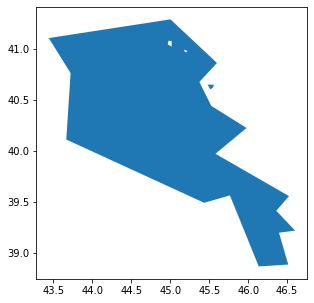


= Importing ARM 8 =


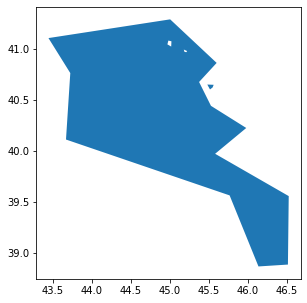


= Importing ARM 9 =


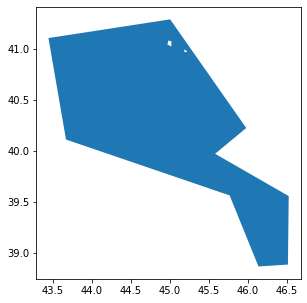


= Importing ASM 4 =


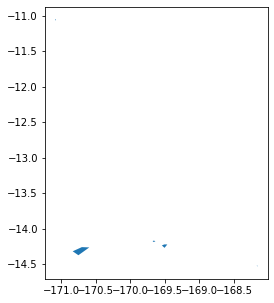


= Importing ASM 5 =


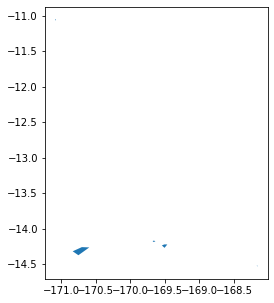


= Importing ASM 6 =


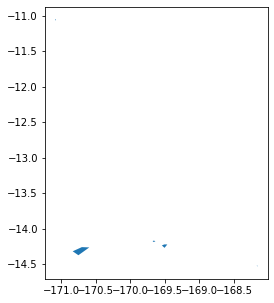


= Importing ASM 7 =


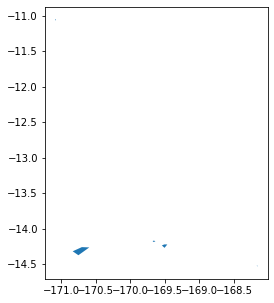


= Importing ASM 8 =


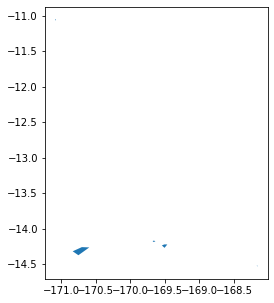


= Importing ASM 9 =


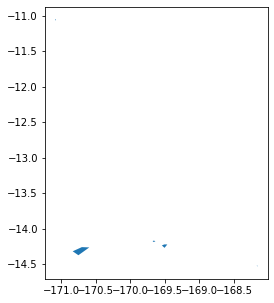


= Importing ATF 4 =


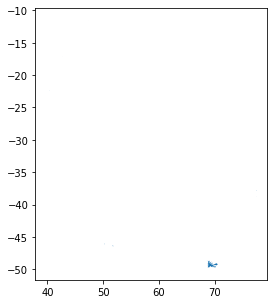


= Importing ATF 5 =


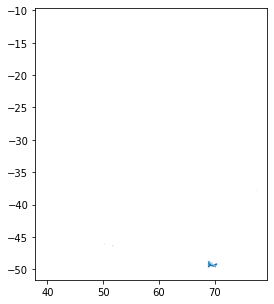


= Importing ATF 6 =


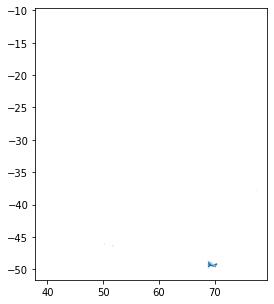


= Importing ATF 7 =


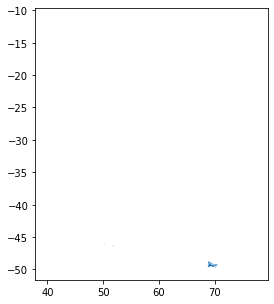


= Importing ATF 8 =


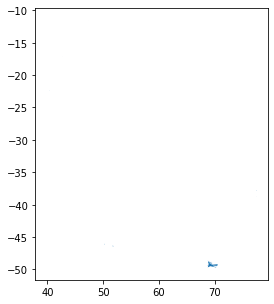


= Importing ATF 9 =


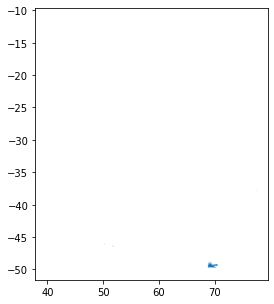


= Importing ATG 4 =


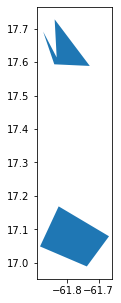


= Importing ATG 5 =


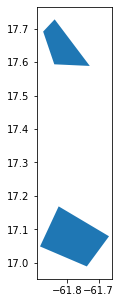


= Importing ATG 6 =


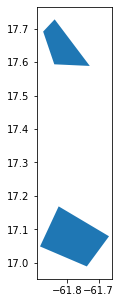


= Importing ATG 7 =


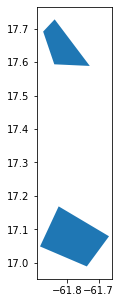


= Importing ATG 8 =


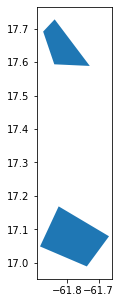


= Importing ATG 9 =


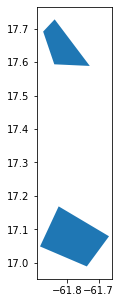


= Importing AUS 4 =


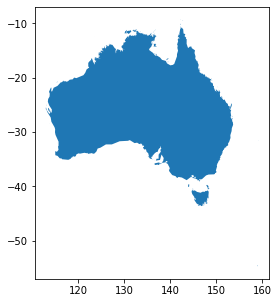


= Importing AUS 5 =


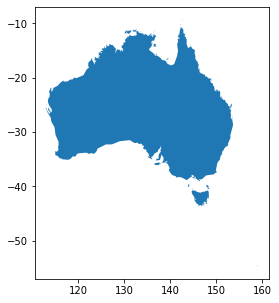


= Importing AUS 6 =


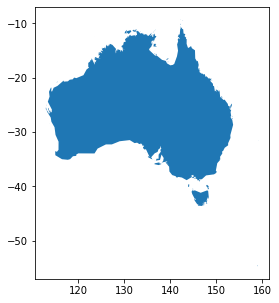


= Importing AUS 7 =


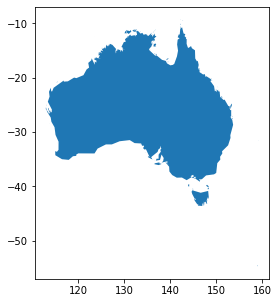


= Importing AUS 8 =


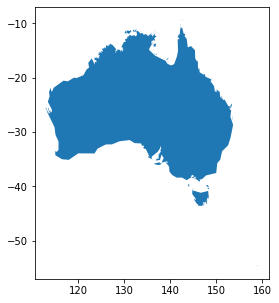


= Importing AUS 9 =


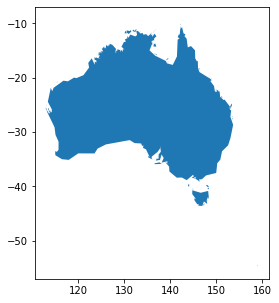


= Importing AUT 4 =


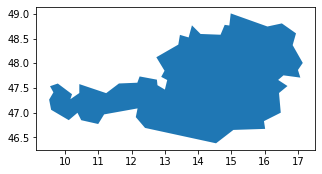


= Importing AUT 5 =


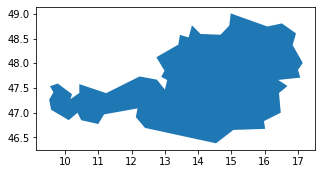


= Importing AUT 6 =


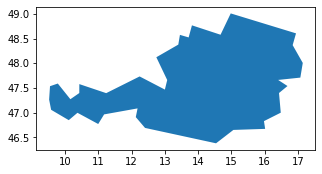


= Importing AUT 7 =


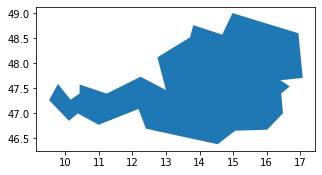


= Importing AUT 8 =


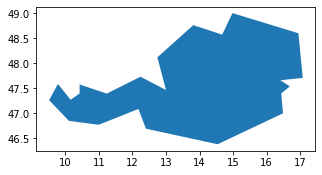


= Importing AUT 9 =


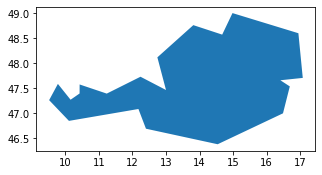


= Importing AZE 4 =


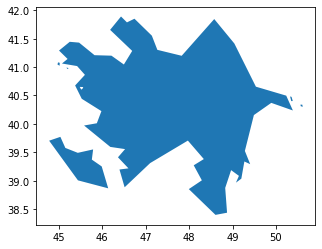


= Importing AZE 5 =


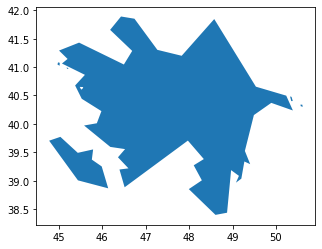


= Importing AZE 6 =


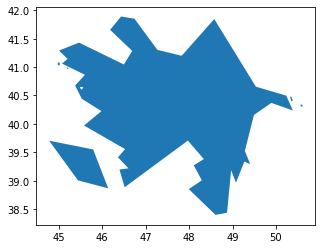


= Importing AZE 7 =


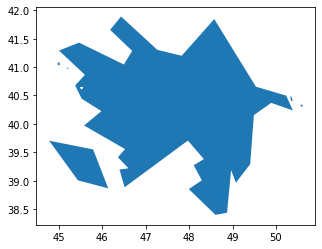


= Importing AZE 8 =


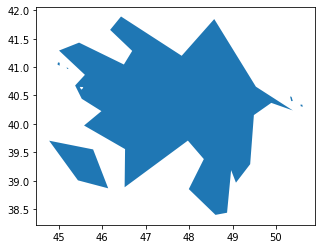


= Importing AZE 9 =


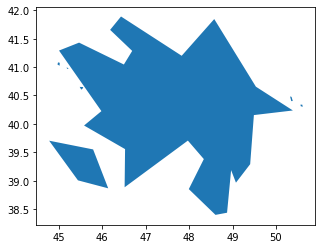


= Importing BDI 4 =


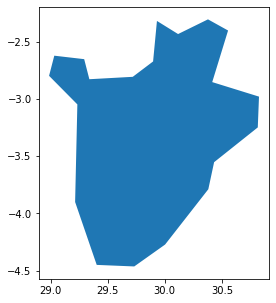


= Importing BDI 5 =


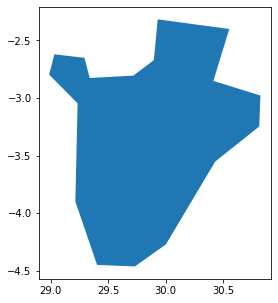


= Importing BDI 6 =


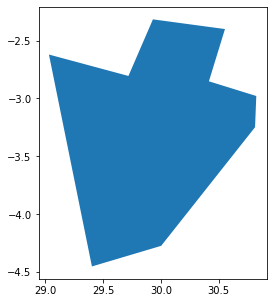


= Importing BDI 7 =


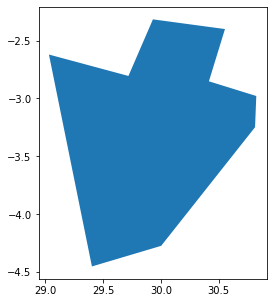


= Importing BDI 8 =


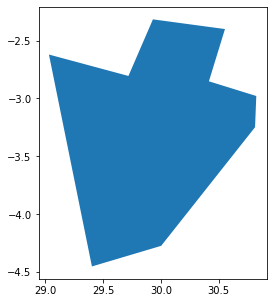


= Importing BDI 9 =


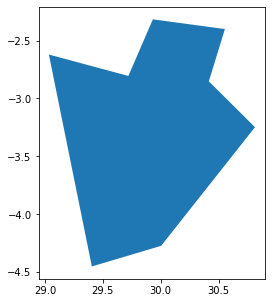


= Importing BEL 4 =


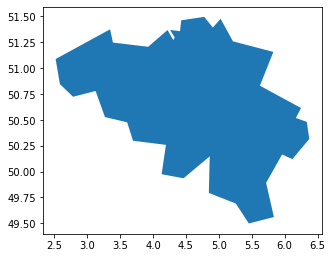


= Importing BEL 5 =


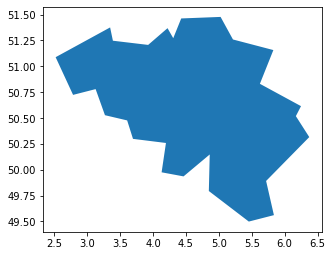


= Importing BEL 6 =


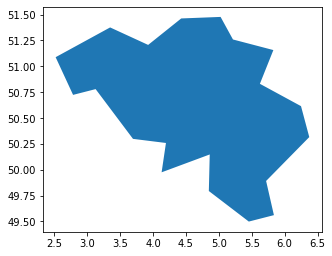


= Importing BEL 7 =


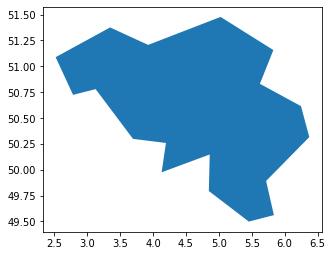


= Importing BEL 8 =


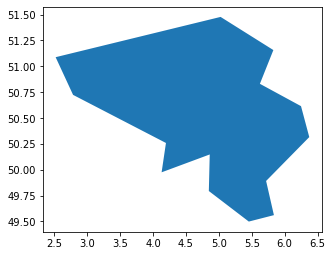


= Importing BEL 9 =


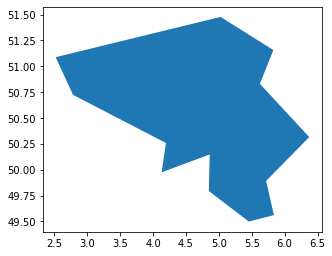


= Importing BEN 4 =


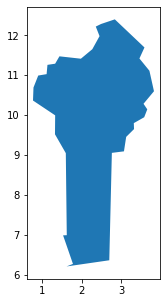


= Importing BEN 5 =


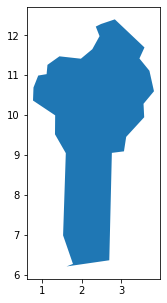


= Importing BEN 6 =


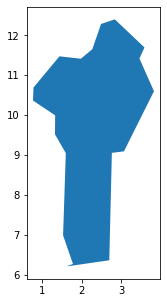


= Importing BEN 7 =


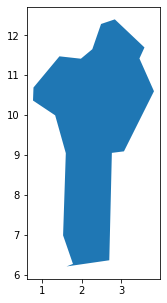


= Importing BEN 8 =


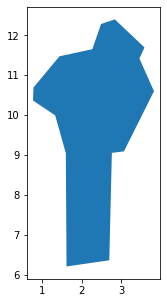


= Importing BEN 9 =


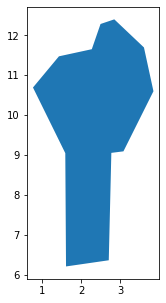


= Importing BES 4 =


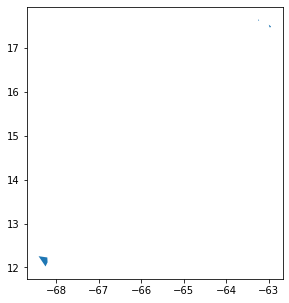


= Importing BES 5 =


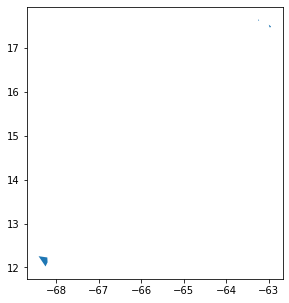


= Importing BES 6 =


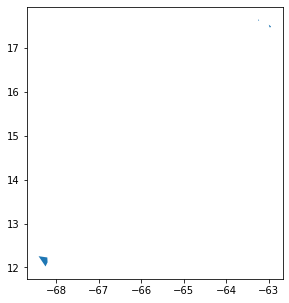


= Importing BES 7 =


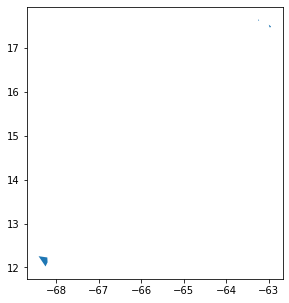


= Importing BES 8 =


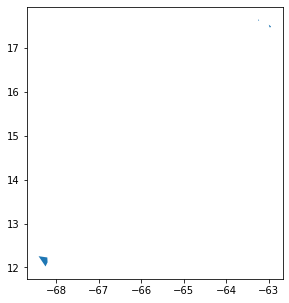


= Importing BES 9 =


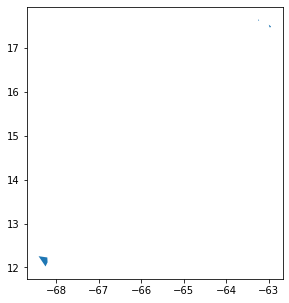


= Importing BFA 4 =


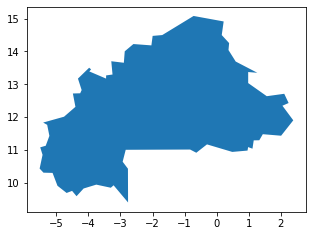


= Importing BFA 5 =


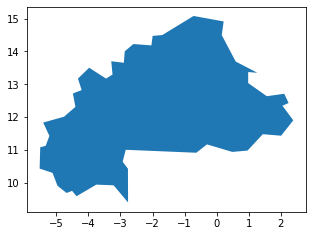


= Importing BFA 6 =


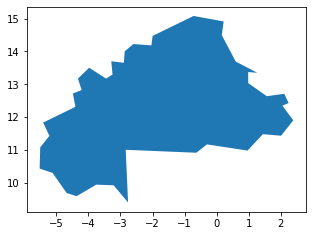


= Importing BFA 7 =


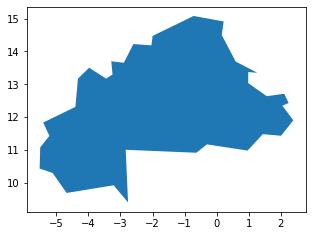


= Importing BFA 8 =


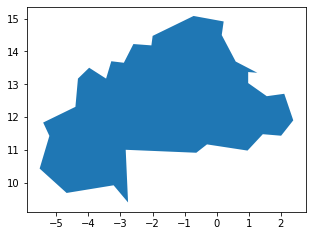


= Importing BFA 9 =


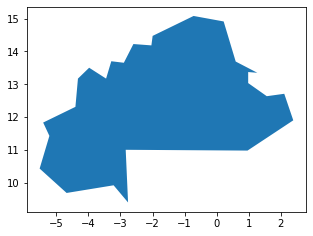


= Importing BGD 4 =


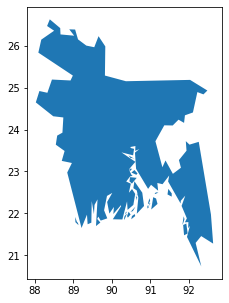


= Importing BGD 5 =


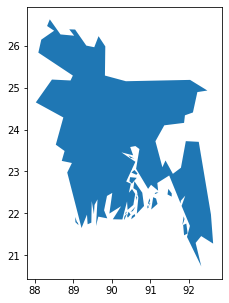


= Importing BGD 6 =


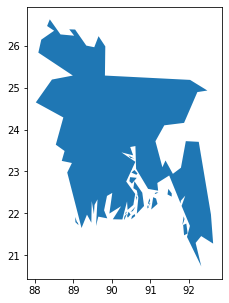


= Importing BGD 7 =


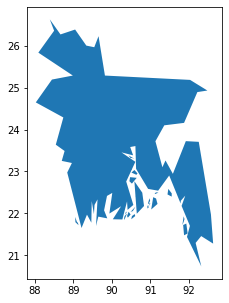


= Importing BGD 8 =


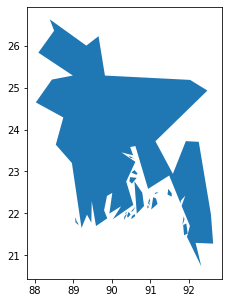


= Importing BGD 9 =


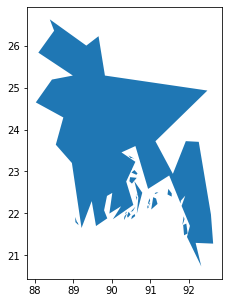


= Importing BGR 4 =


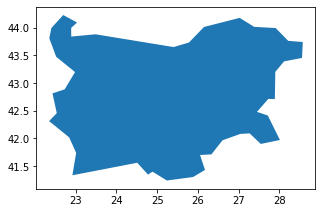


= Importing BGR 5 =


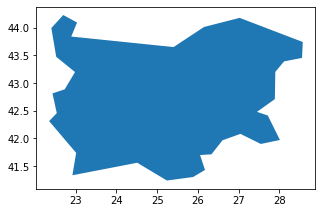


= Importing BGR 6 =


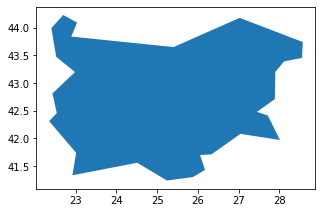


= Importing BGR 7 =


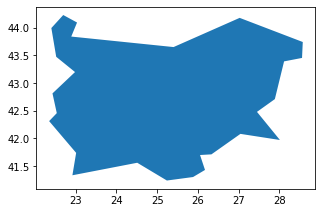


= Importing BGR 8 =


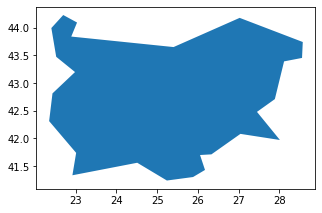


= Importing BGR 9 =


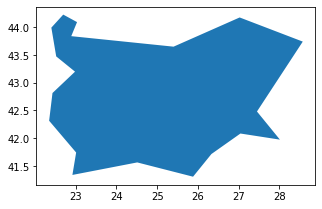


= Importing BHR 4 =


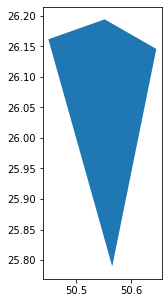


= Importing BHR 5 =


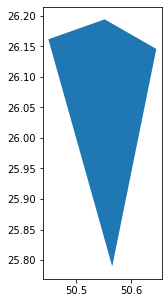


= Importing BHR 6 =


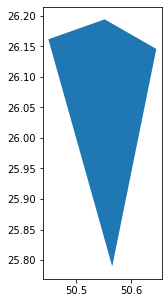


= Importing BHR 7 =


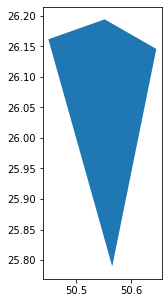


= Importing BHR 8 =


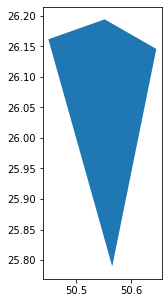


= Importing BHR 9 =


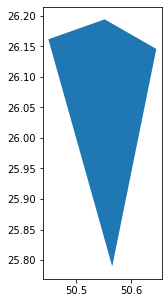


= Importing BHS 4 =


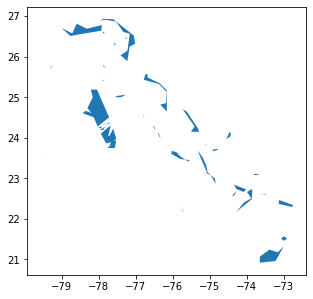


= Importing BHS 5 =


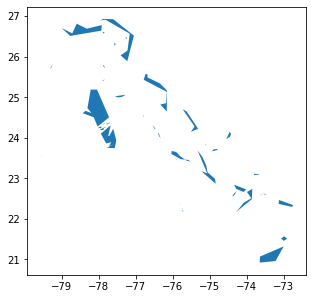


= Importing BHS 6 =


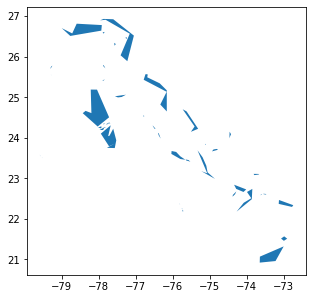


= Importing BHS 7 =


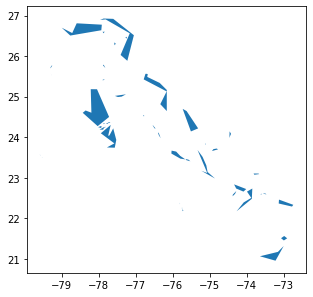


= Importing BHS 8 =


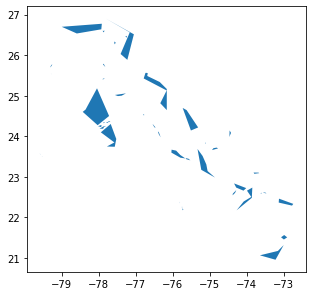


= Importing BHS 9 =


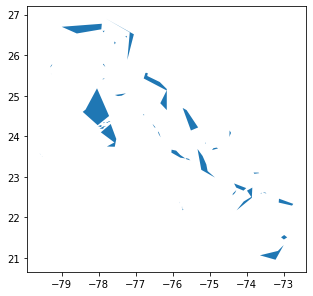


= Importing BIH 4 =


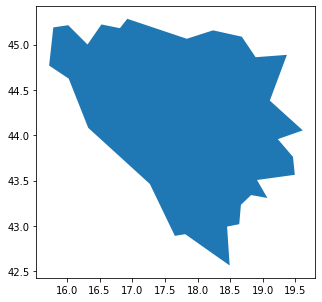


= Importing BIH 5 =


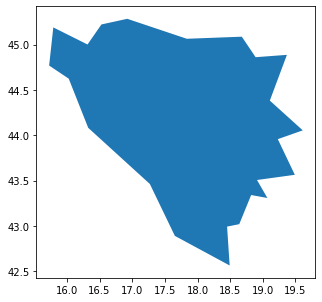


= Importing BIH 6 =


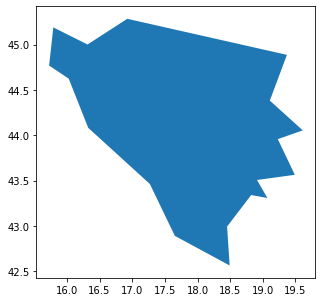


= Importing BIH 7 =


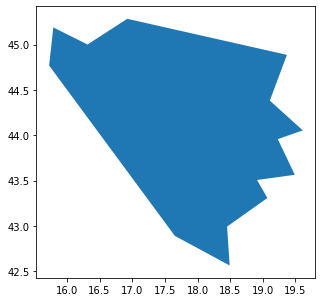


= Importing BIH 8 =


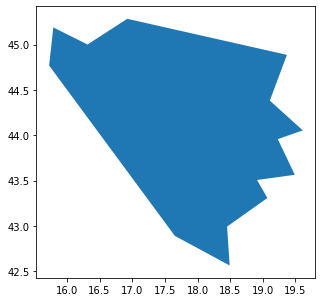


= Importing BIH 9 =


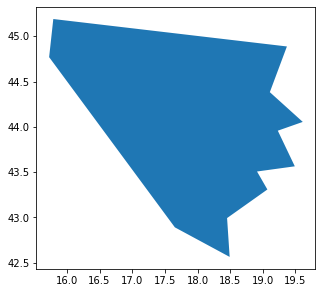


= Importing BLM 4 =


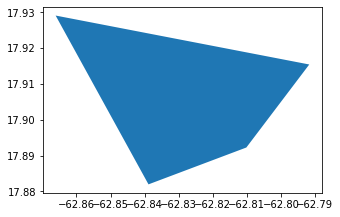


= Importing BLM 5 =


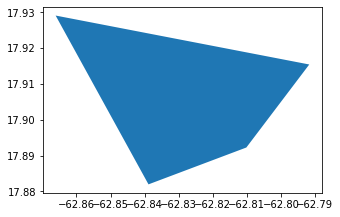


= Importing BLM 6 =


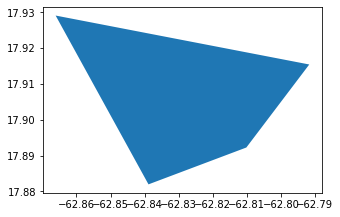


= Importing BLM 7 =


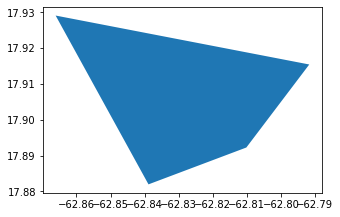


= Importing BLM 8 =


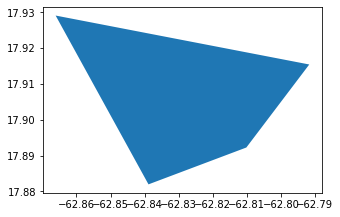


= Importing BLM 9 =


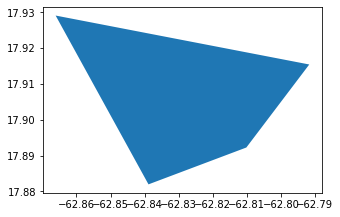


= Importing BLR 4 =


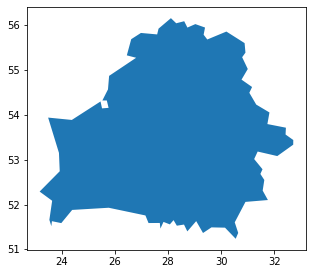


= Importing BLR 5 =


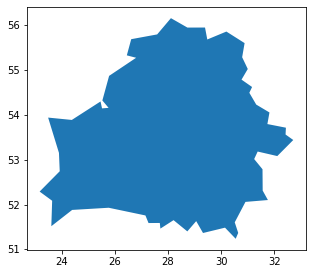


= Importing BLR 6 =


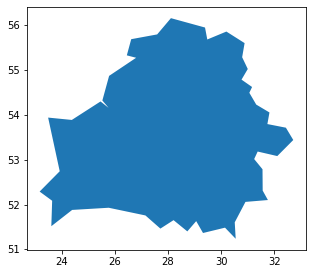


= Importing BLR 7 =


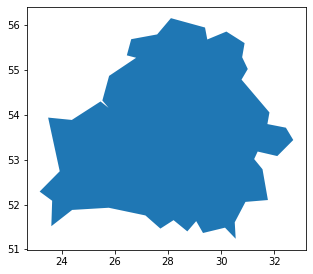


= Importing BLR 8 =


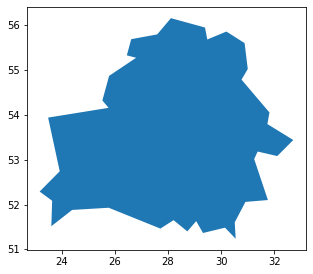


= Importing BLR 9 =


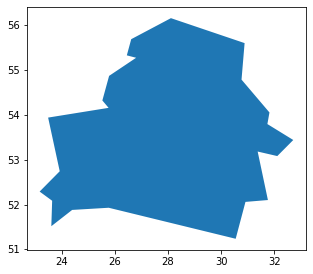


= Importing BLZ 4 =


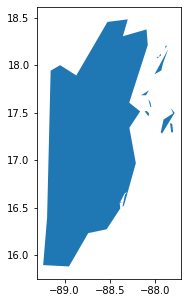


= Importing BLZ 5 =


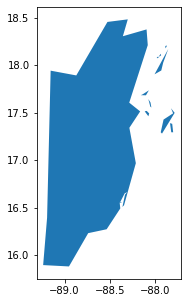


= Importing BLZ 6 =


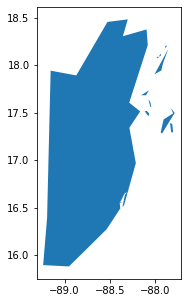


= Importing BLZ 7 =


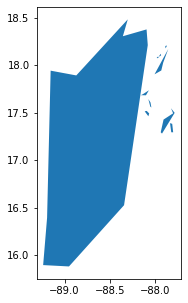


= Importing BLZ 8 =


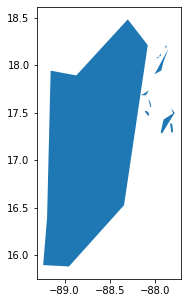


= Importing BLZ 9 =


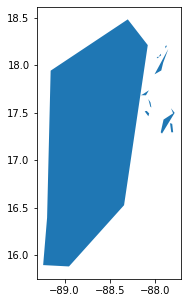


= Importing BMU 4 =


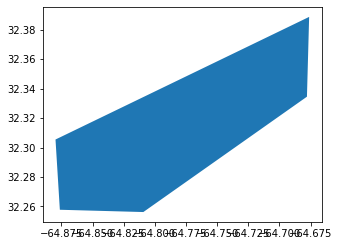


= Importing BMU 5 =


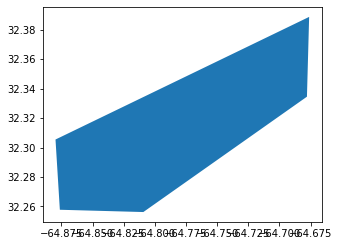


= Importing BMU 6 =


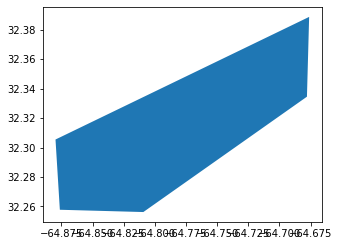


= Importing BMU 7 =


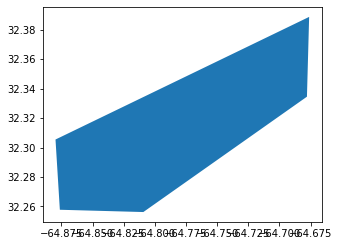


= Importing BMU 8 =


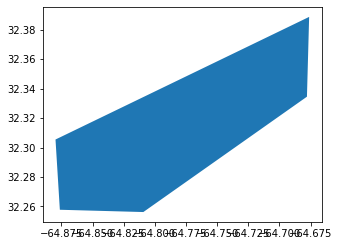


= Importing BMU 9 =


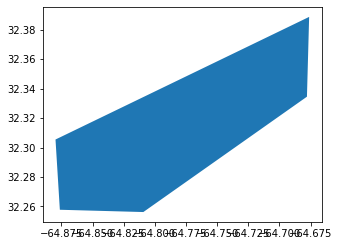


= Importing BOL 4 =


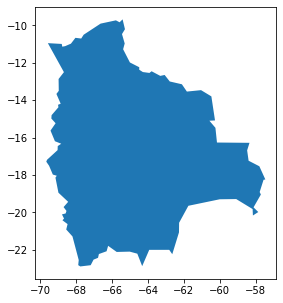


= Importing BOL 5 =


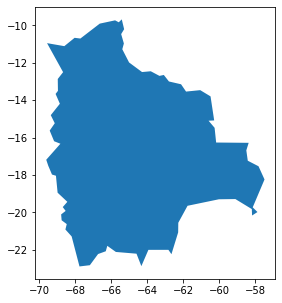


= Importing BOL 6 =


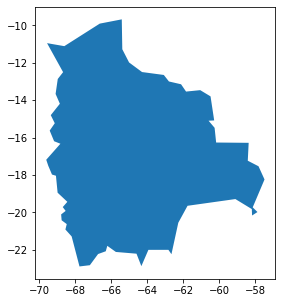


= Importing BOL 7 =


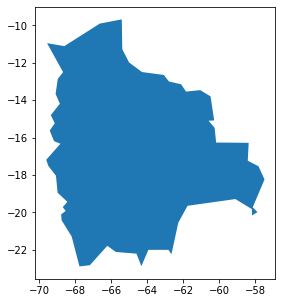


= Importing BOL 8 =


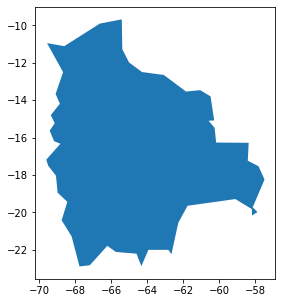


= Importing BOL 9 =


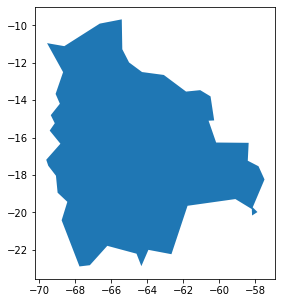


= Importing BRA 4 =


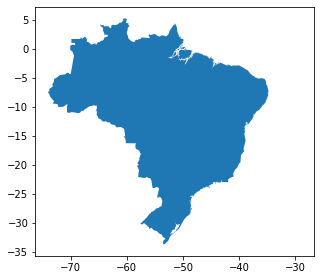


= Importing BRA 5 =


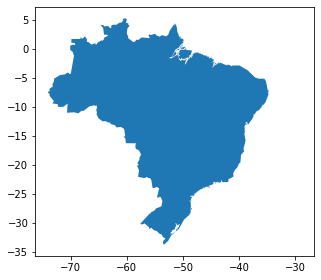


= Importing BRA 6 =


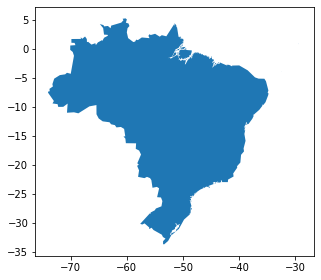


= Importing BRA 7 =


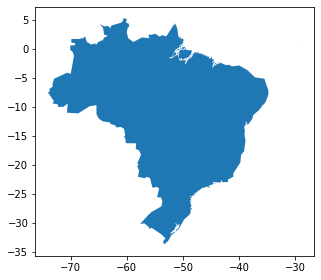


= Importing BRA 8 =


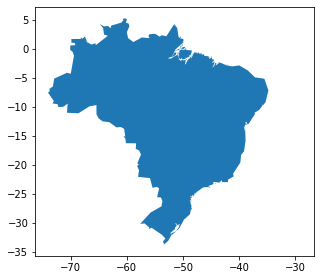


= Importing BRA 9 =


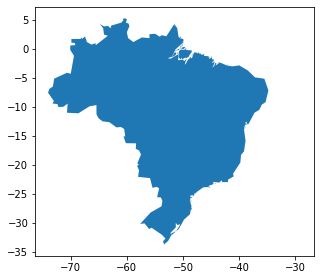


= Importing BRB 4 =


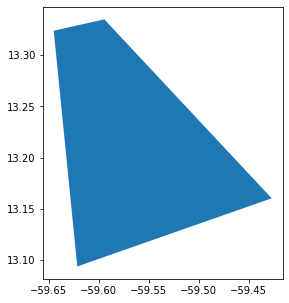


= Importing BRB 5 =


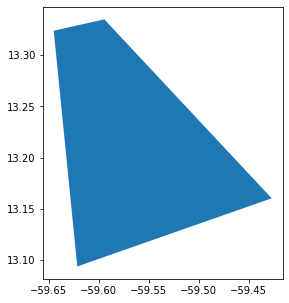


= Importing BRB 6 =


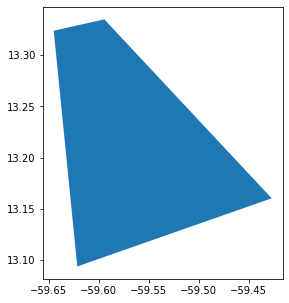


= Importing BRB 7 =


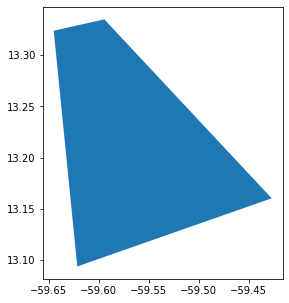


= Importing BRB 8 =


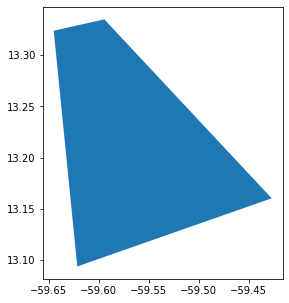


= Importing BRB 9 =


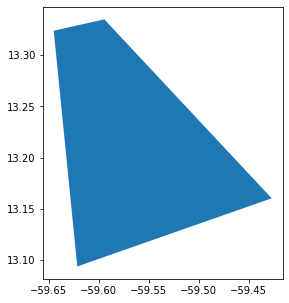


= Importing BRN 4 =


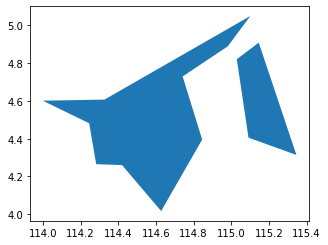


= Importing BRN 5 =


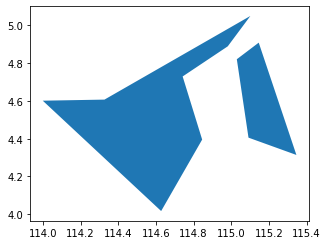


= Importing BRN 6 =


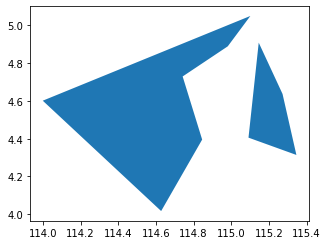


= Importing BRN 7 =


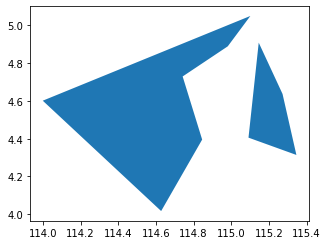


= Importing BRN 8 =


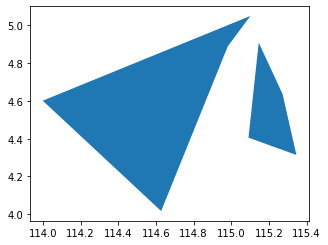


= Importing BRN 9 =


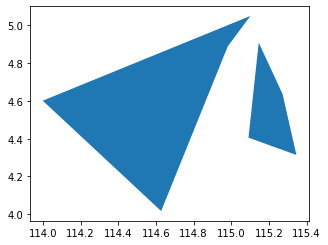


= Importing BTN 4 =


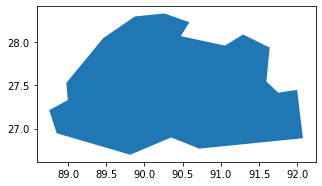


= Importing BTN 5 =


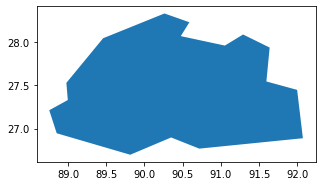


= Importing BTN 6 =


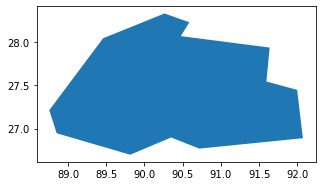


= Importing BTN 7 =


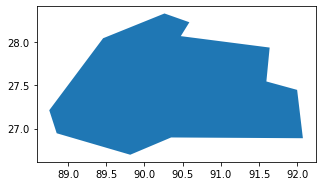


= Importing BTN 8 =


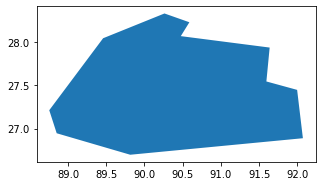


= Importing BTN 9 =


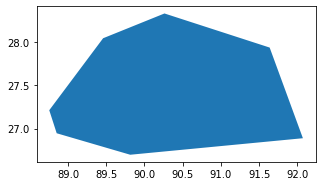


= Importing BWA 4 =


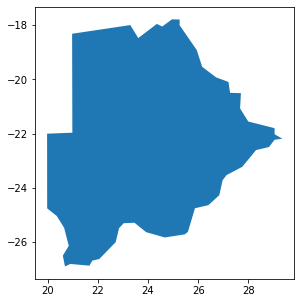


= Importing BWA 5 =


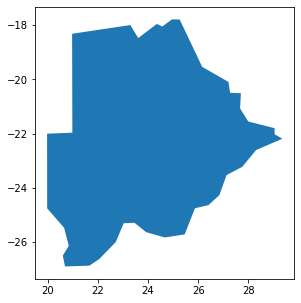


= Importing BWA 6 =


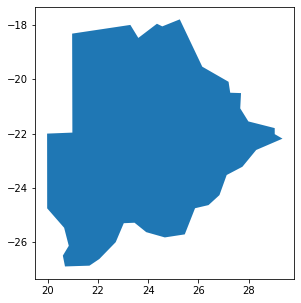


= Importing BWA 7 =


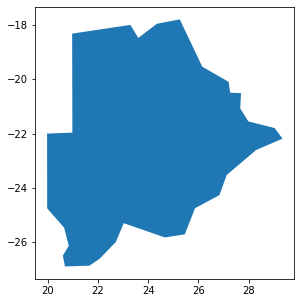


= Importing BWA 8 =


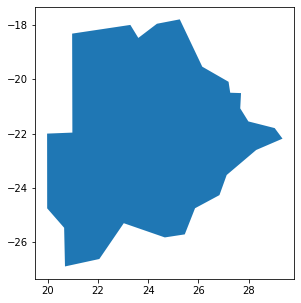


= Importing BWA 9 =


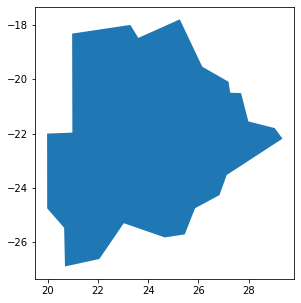


= Importing CAF 4 =


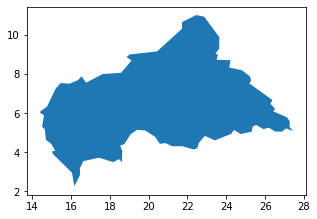


= Importing CAF 5 =


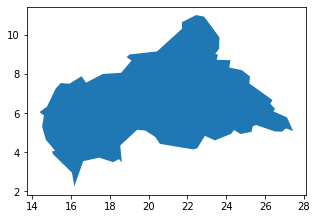


= Importing CAF 6 =


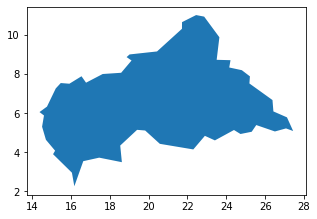


= Importing CAF 7 =


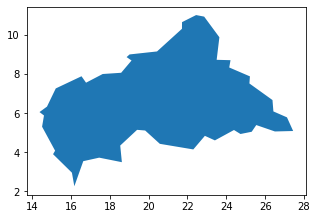


= Importing CAF 8 =


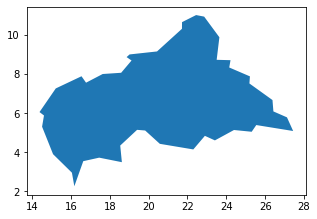


= Importing CAF 9 =


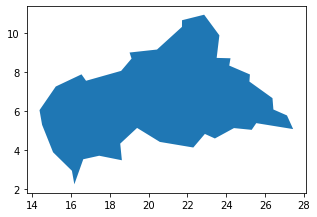


= Importing CAN 4 =


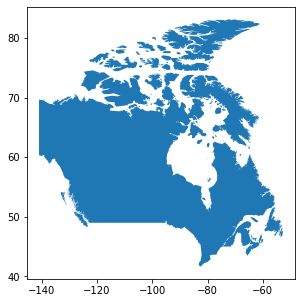


= Importing CAN 5 =


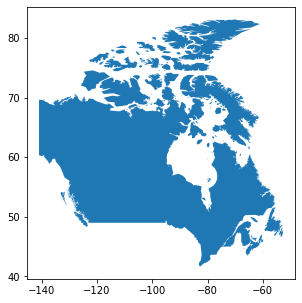


= Importing CAN 6 =


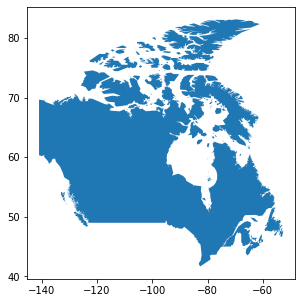


= Importing CAN 7 =


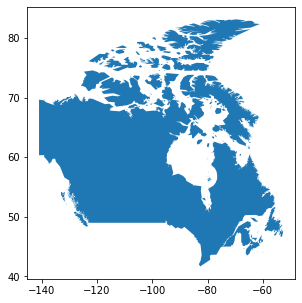


= Importing CAN 8 =


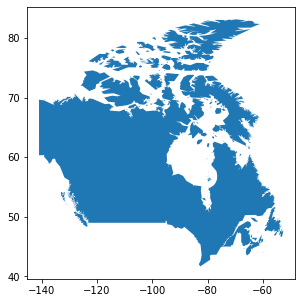


= Importing CAN 9 =


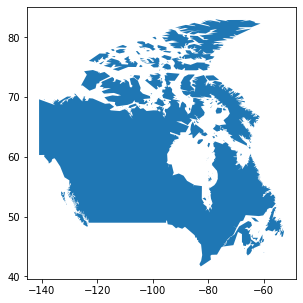


= Importing CCK 4 =


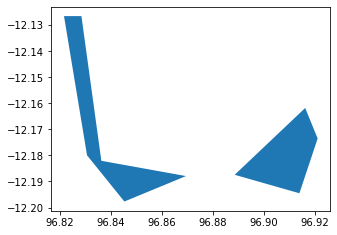


= Importing CCK 5 =


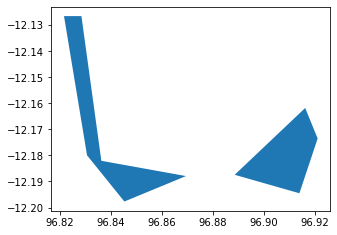


= Importing CCK 6 =


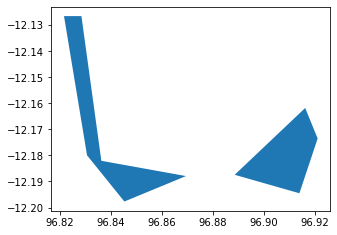


= Importing CCK 7 =


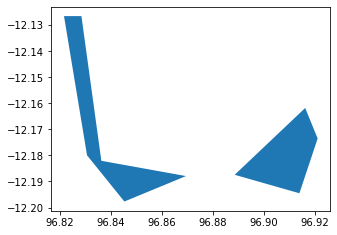


= Importing CCK 8 =


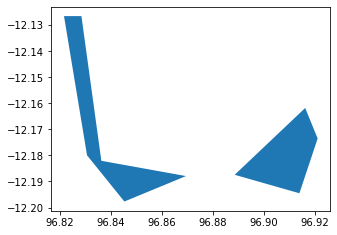


= Importing CCK 9 =


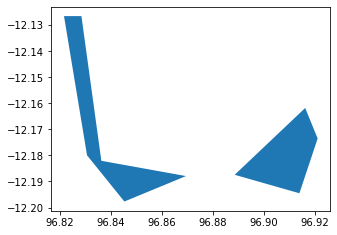


= Importing CHE 4 =


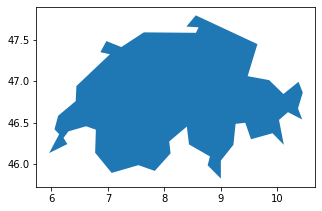


= Importing CHE 5 =


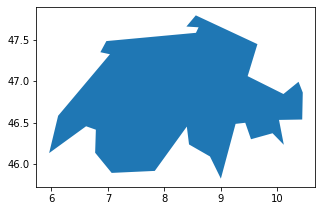


= Importing CHE 6 =


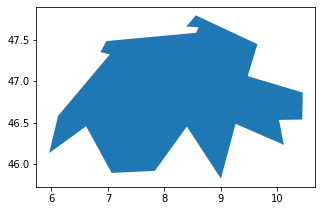


= Importing CHE 7 =


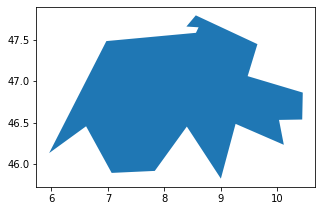


= Importing CHE 8 =


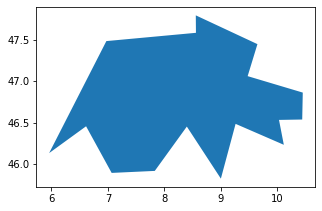


= Importing CHE 9 =


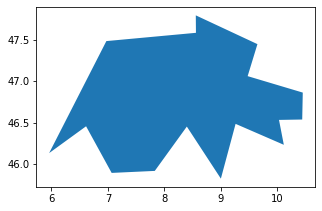


= Importing CHL 4 =


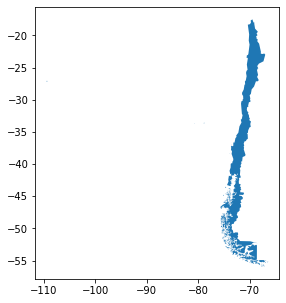


= Importing CHL 5 =


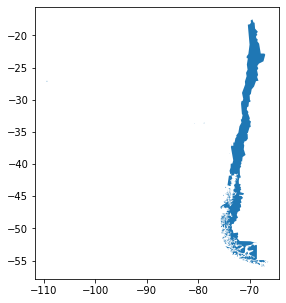


= Importing CHL 6 =


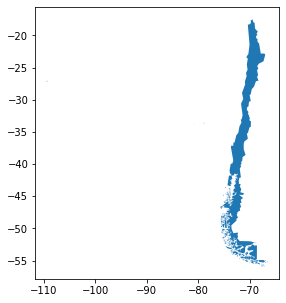


= Importing CHL 7 =


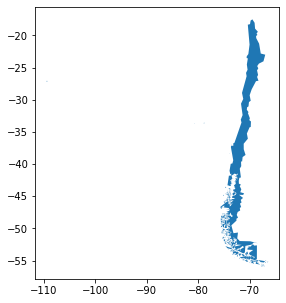


= Importing CHL 8 =


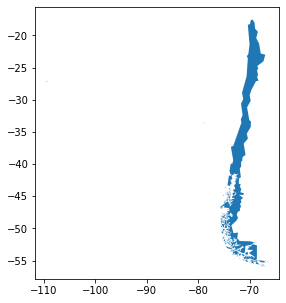


= Importing CHL 9 =


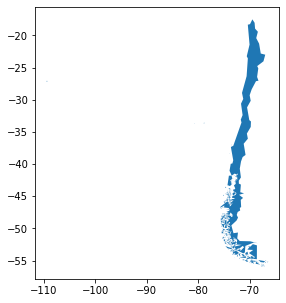


= Importing CHN 4 =


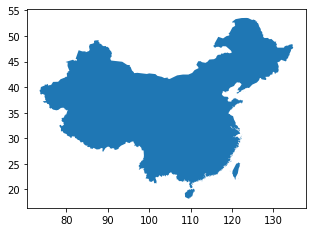


= Importing CHN 5 =


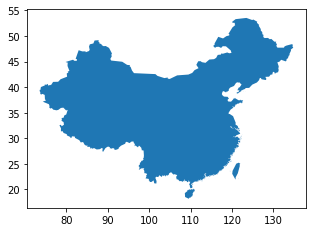


= Importing CHN 6 =


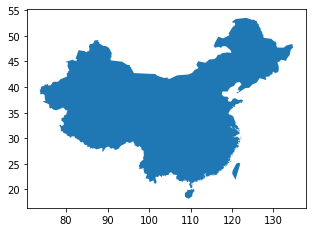


= Importing CHN 7 =


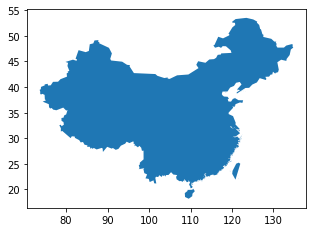


= Importing CHN 8 =


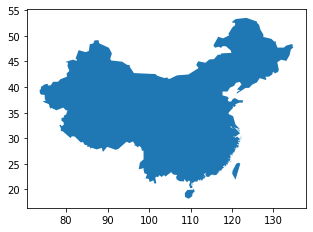


= Importing CHN 9 =


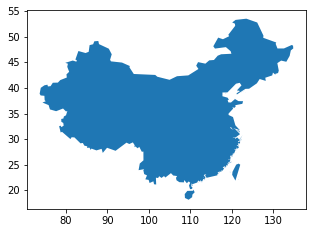


= Importing CIV 4 =


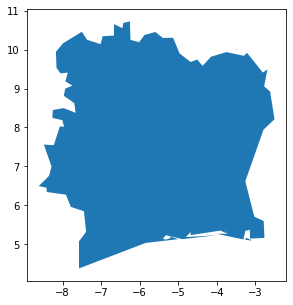


= Importing CIV 5 =


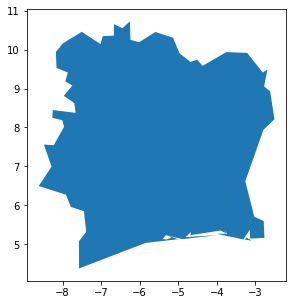


= Importing CIV 6 =


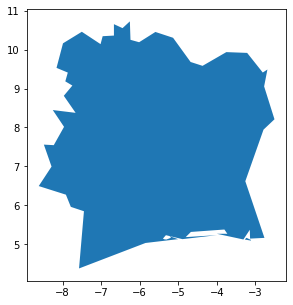


= Importing CIV 7 =


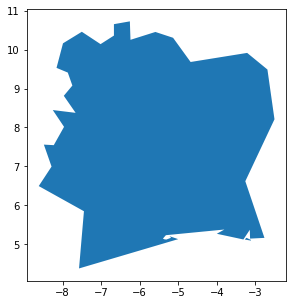


= Importing CIV 8 =


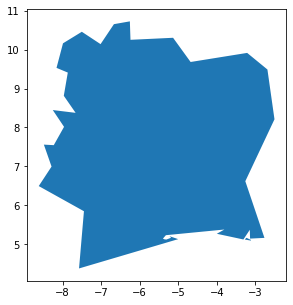


= Importing CIV 9 =


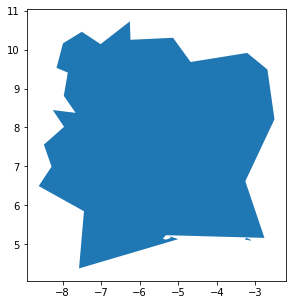


= Importing CMR 4 =


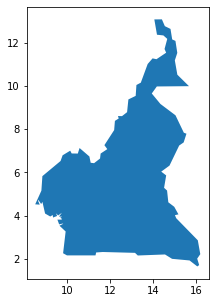


= Importing CMR 5 =


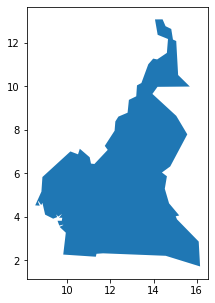


= Importing CMR 6 =


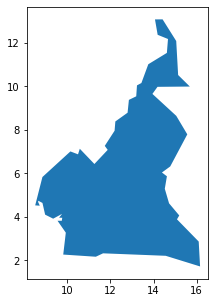


= Importing CMR 7 =


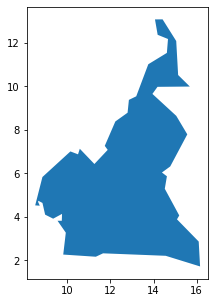


= Importing CMR 8 =


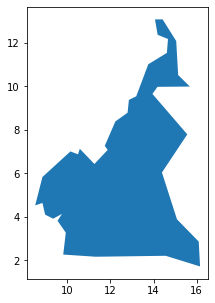


= Importing CMR 9 =


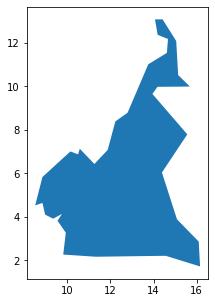


= Importing COD 4 =


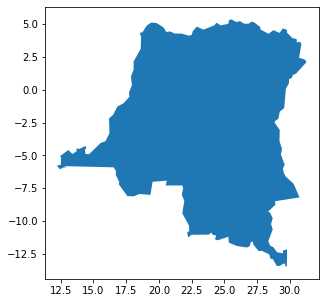


= Importing COD 5 =


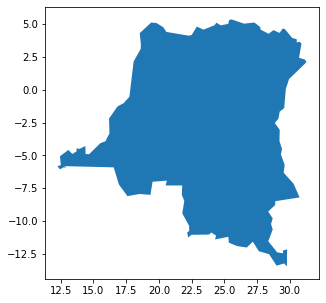


= Importing COD 6 =


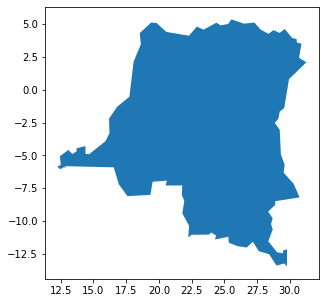


= Importing COD 7 =


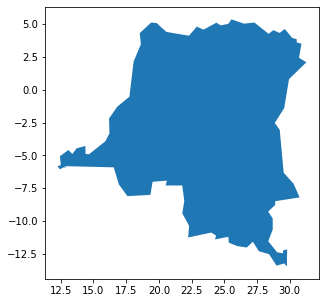


= Importing COD 8 =


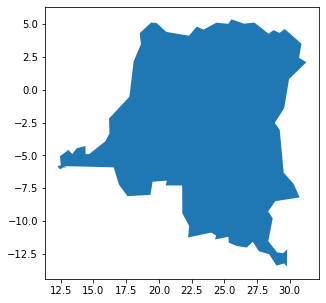


= Importing COD 9 =


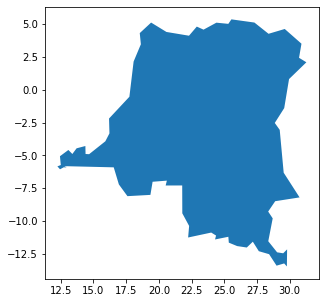


= Importing COG 4 =


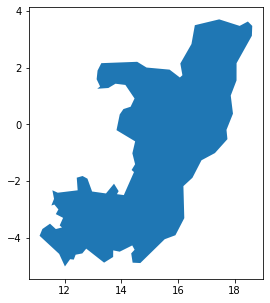


= Importing COG 5 =


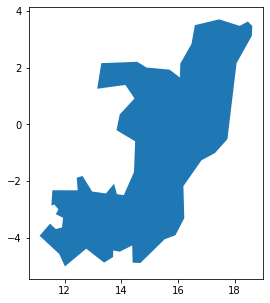


= Importing COG 6 =


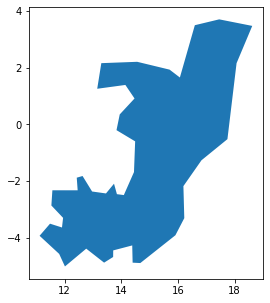


= Importing COG 7 =


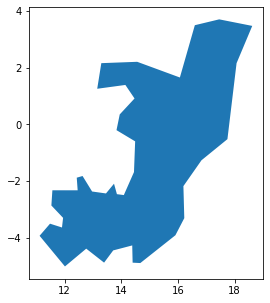


= Importing COG 8 =


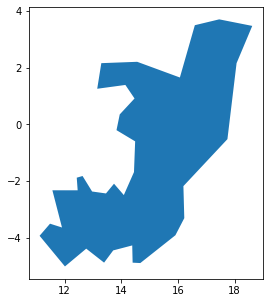


= Importing COG 9 =


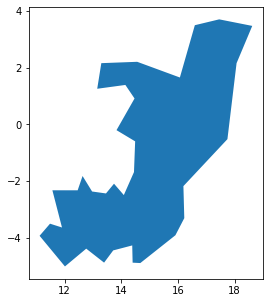


= Importing COK 4 =


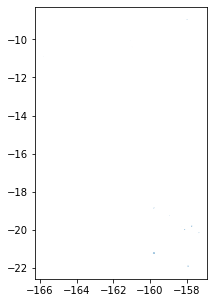


= Importing COK 5 =


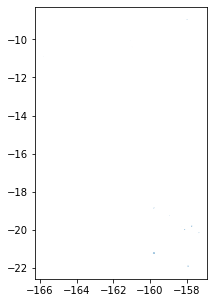


= Importing COK 6 =


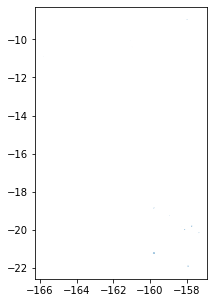


= Importing COK 7 =


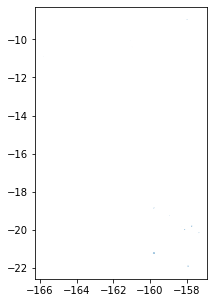


= Importing COK 8 =


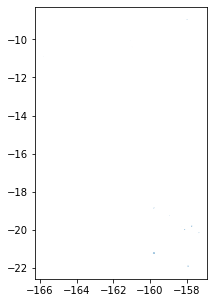


= Importing COK 9 =


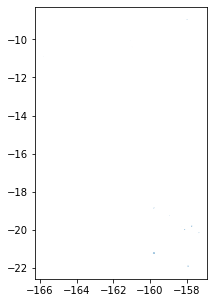


= Importing COL 4 =


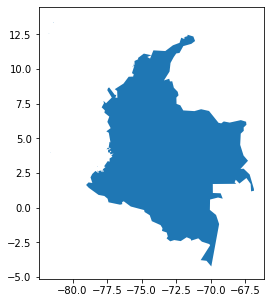


= Importing COL 5 =


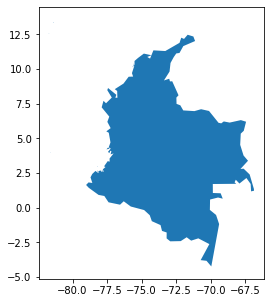


= Importing COL 6 =


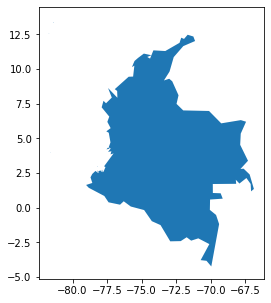


= Importing COL 7 =


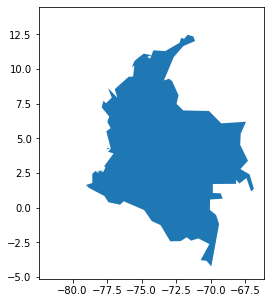


= Importing COL 8 =


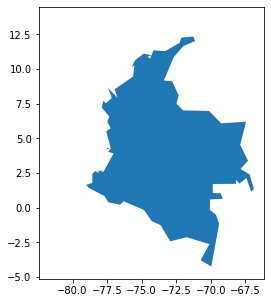


= Importing COL 9 =


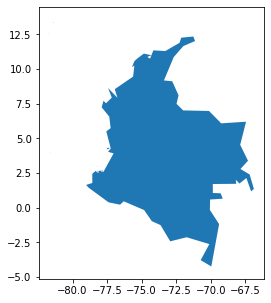


= Importing COM 4 =


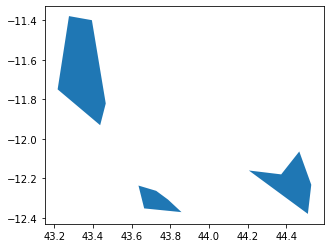


= Importing COM 5 =


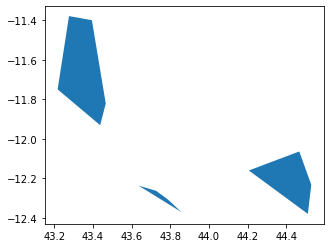


= Importing COM 6 =


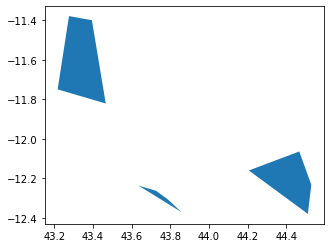


= Importing COM 7 =


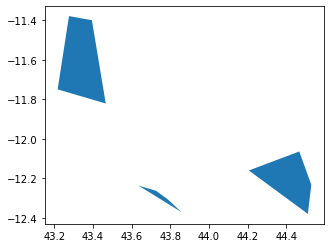


= Importing COM 8 =


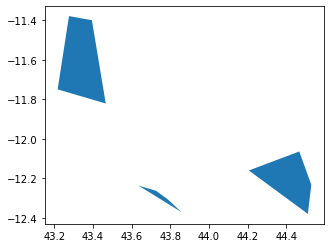


= Importing COM 9 =


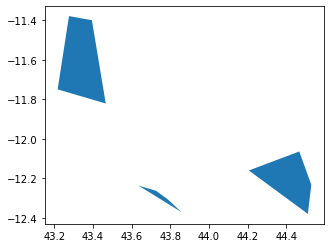


= Importing CPV 4 =


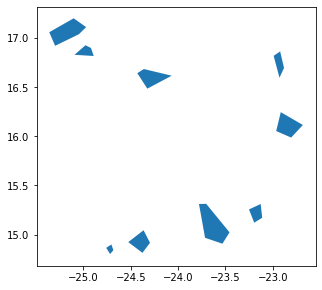


= Importing CPV 5 =


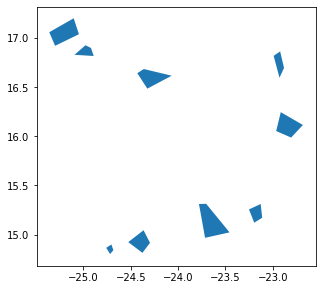


= Importing CPV 6 =


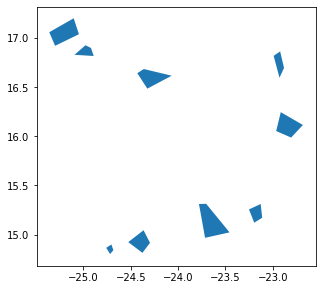


= Importing CPV 7 =


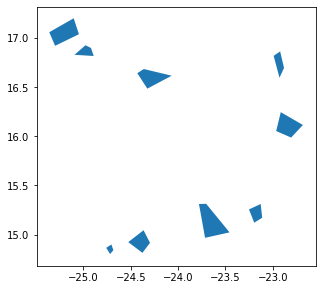


= Importing CPV 8 =


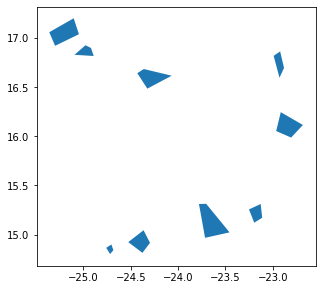


= Importing CPV 9 =


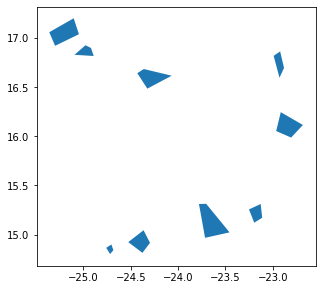


= Importing CRI 4 =


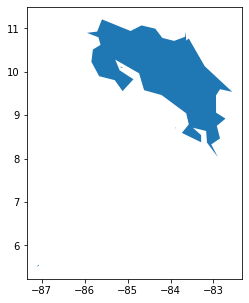


= Importing CRI 5 =


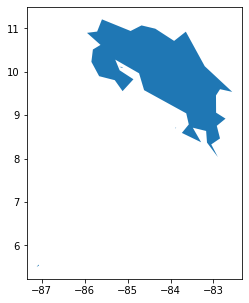


= Importing CRI 6 =


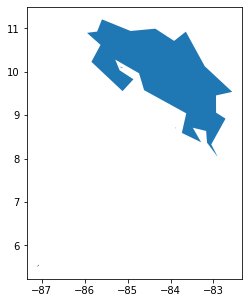


= Importing CRI 7 =


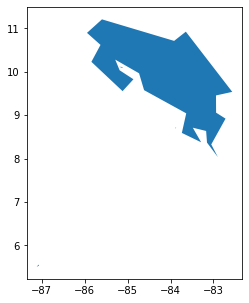


= Importing CRI 8 =


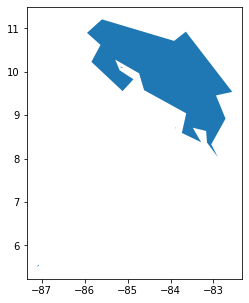


= Importing CRI 9 =


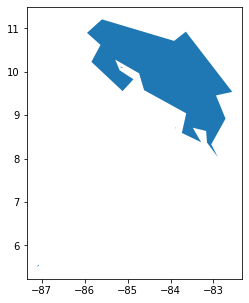


= Importing CUB 4 =


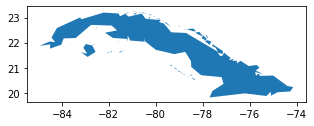


= Importing CUB 5 =


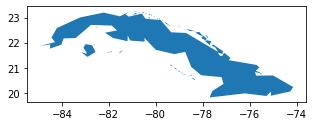


= Importing CUB 6 =


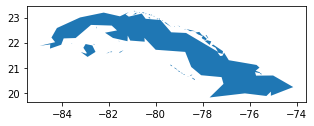


= Importing CUB 7 =


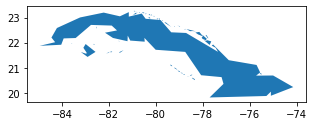


= Importing CUB 8 =


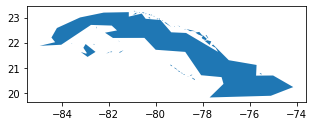


= Importing CUB 9 =


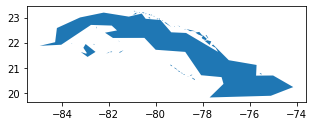


= Importing CUW 4 =


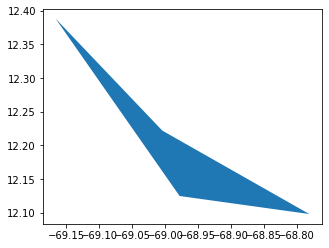


= Importing CUW 5 =


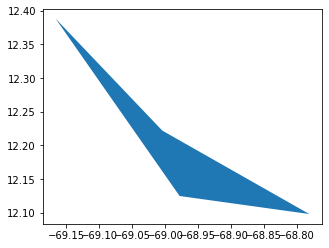


= Importing CUW 6 =


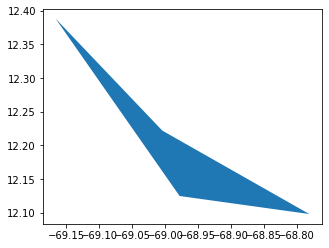


= Importing CUW 7 =


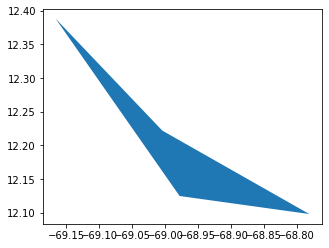


= Importing CUW 8 =


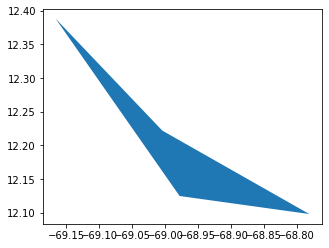


= Importing CUW 9 =


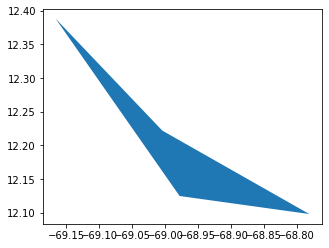


= Importing CXR 4 =


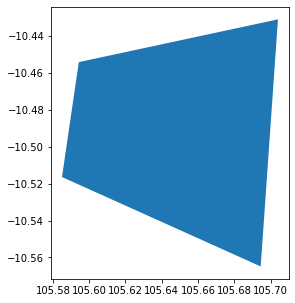


= Importing CXR 5 =


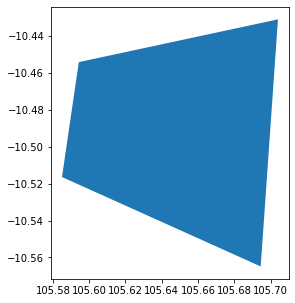


= Importing CXR 6 =


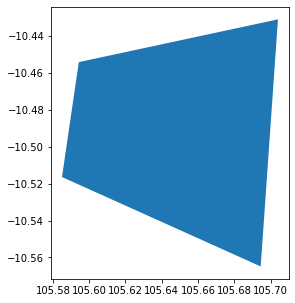


= Importing CXR 7 =


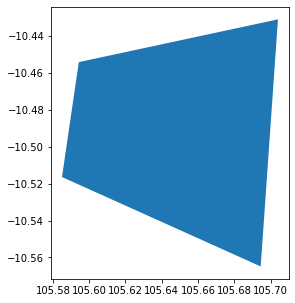


= Importing CXR 8 =


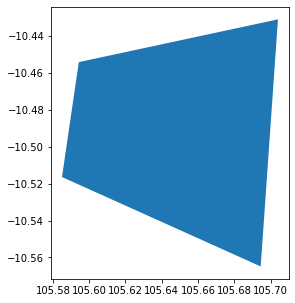


= Importing CXR 9 =


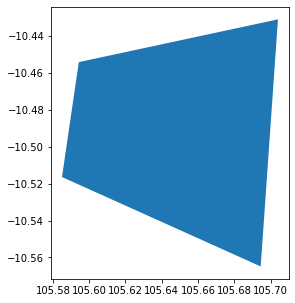


= Importing CYM 4 =


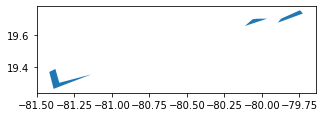


= Importing CYM 5 =


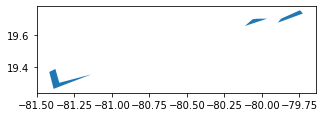


= Importing CYM 6 =


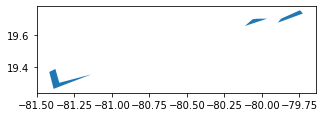


= Importing CYM 7 =


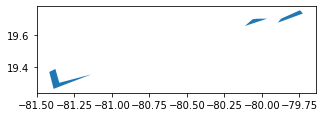


= Importing CYM 8 =


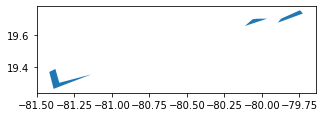


= Importing CYM 9 =


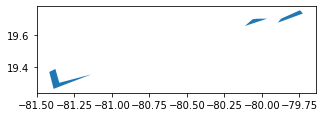


= Importing CYP 4 =


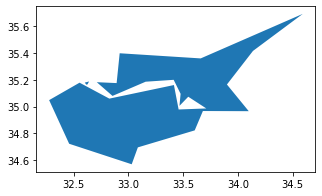


= Importing CYP 5 =


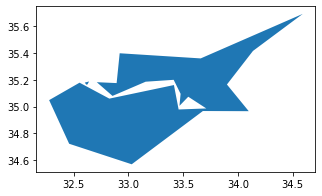


= Importing CYP 6 =


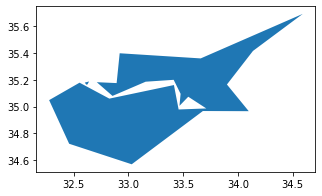


= Importing CYP 7 =


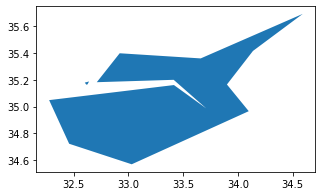


= Importing CYP 8 =


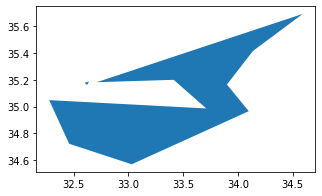


= Importing CYP 9 =


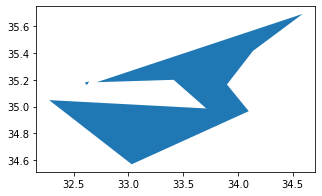


= Importing CZE 4 =


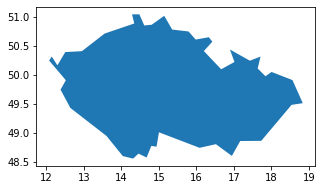


= Importing CZE 5 =


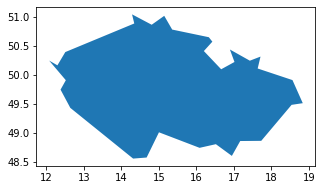


= Importing CZE 6 =


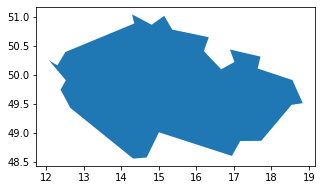


= Importing CZE 7 =


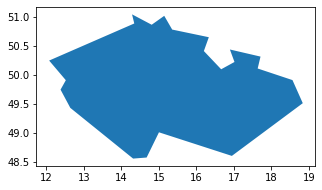


= Importing CZE 8 =


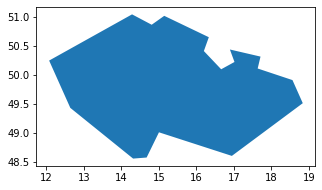


= Importing CZE 9 =


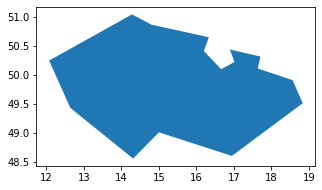


= Importing DEU 4 =


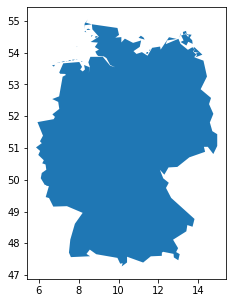


= Importing DEU 5 =


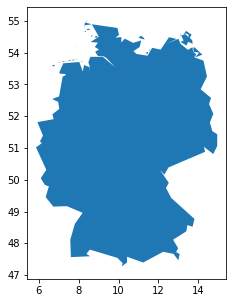


= Importing DEU 6 =


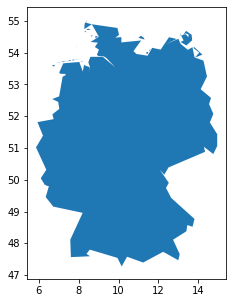


= Importing DEU 7 =


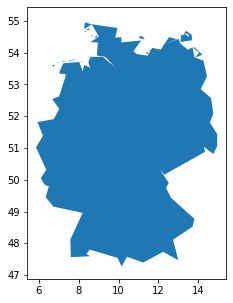


= Importing DEU 8 =


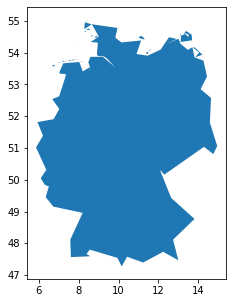


= Importing DEU 9 =


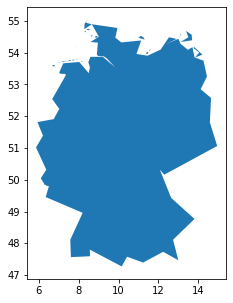


= Importing DJI 4 =


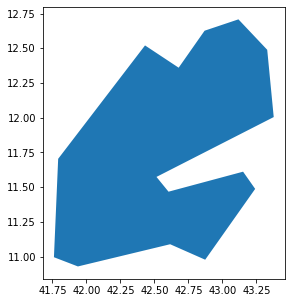


= Importing DJI 5 =


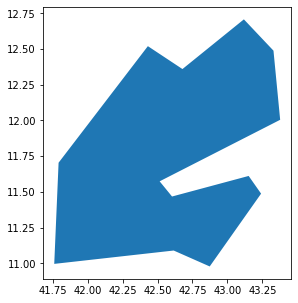


= Importing DJI 6 =


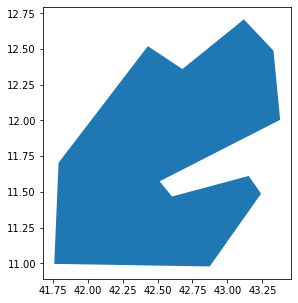


= Importing DJI 7 =


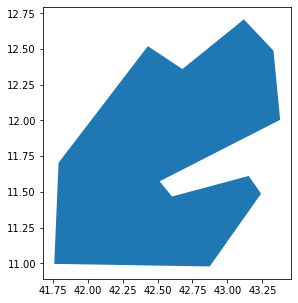


= Importing DJI 8 =


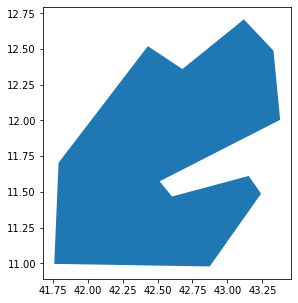


= Importing DJI 9 =


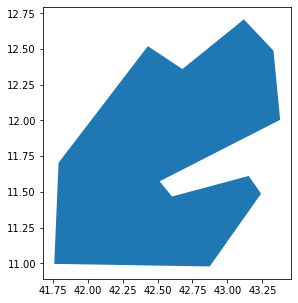


= Importing DMA 4 =


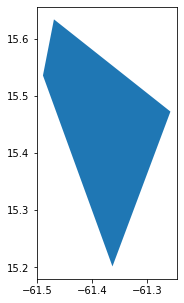


= Importing DMA 5 =


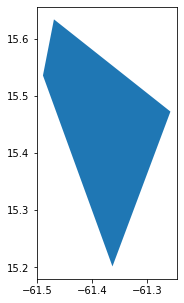


= Importing DMA 6 =


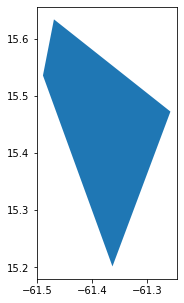


= Importing DMA 7 =


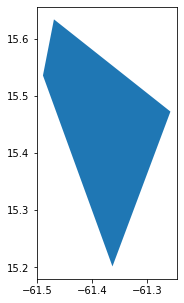


= Importing DMA 8 =


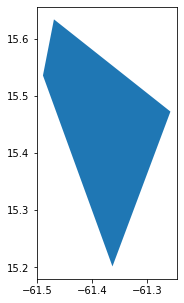


= Importing DMA 9 =


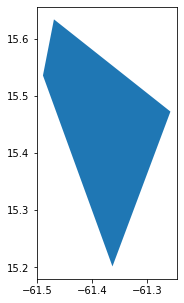


= Importing DNK 4 =


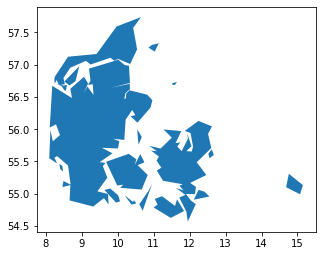


= Importing DNK 5 =


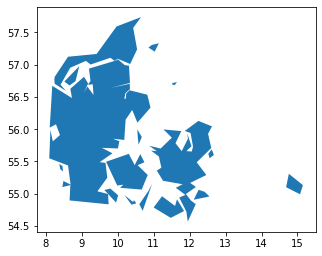


= Importing DNK 6 =


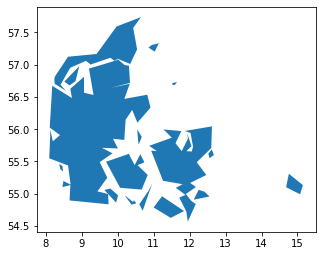


= Importing DNK 7 =


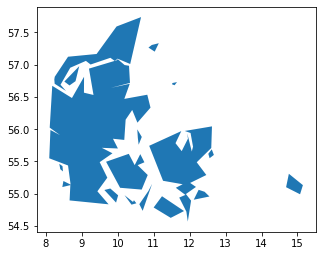


= Importing DNK 8 =


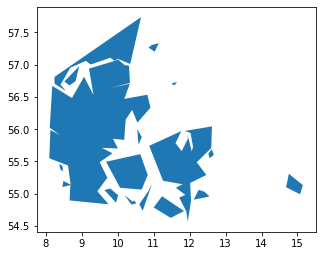


= Importing DNK 9 =


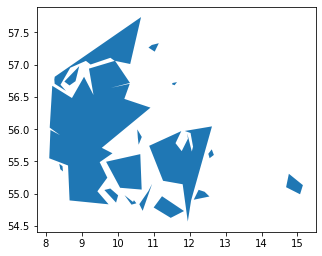


= Importing DOM 4 =


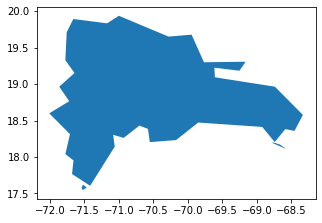


= Importing DOM 5 =


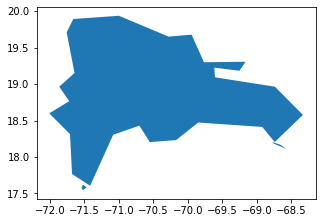


= Importing DOM 6 =


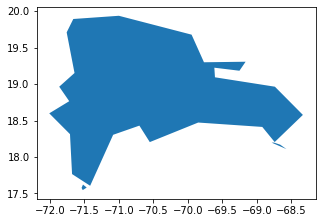


= Importing DOM 7 =


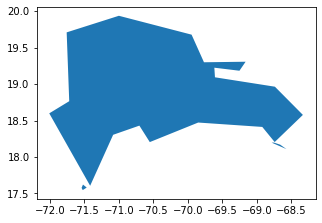


= Importing DOM 8 =


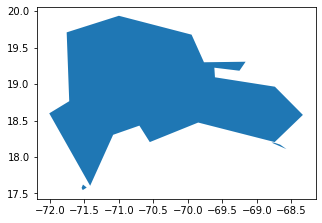


= Importing DOM 9 =


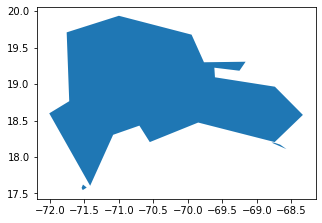


= Importing DZA 4 =


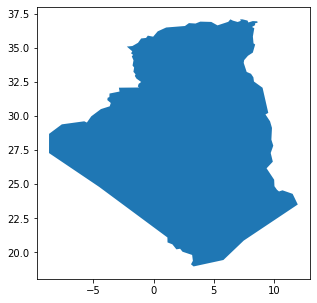


= Importing DZA 5 =


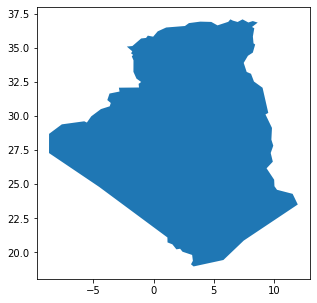


= Importing DZA 6 =


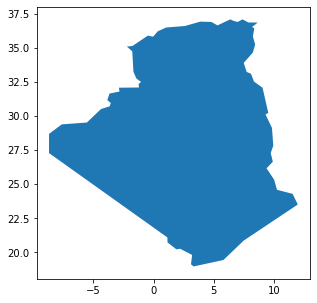


= Importing DZA 7 =


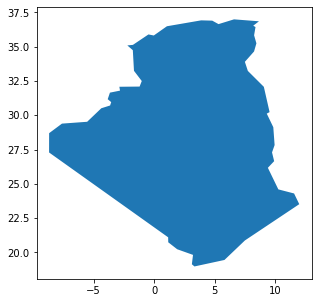


= Importing DZA 8 =


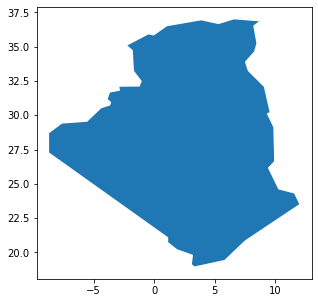


= Importing DZA 9 =


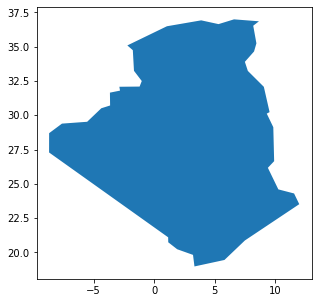


= Importing ECU 4 =


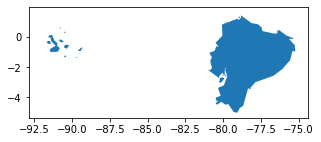


= Importing ECU 5 =


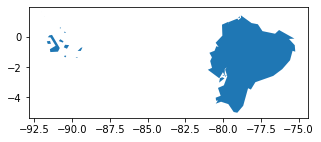


= Importing ECU 6 =


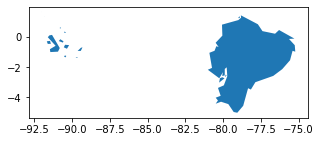


= Importing ECU 7 =


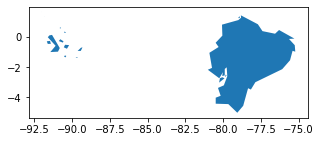


= Importing ECU 8 =


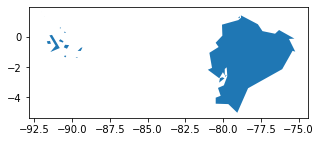


= Importing ECU 9 =


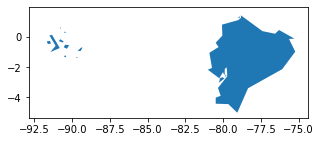


= Importing EGY 4 =


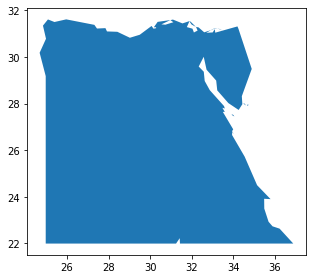


= Importing EGY 5 =


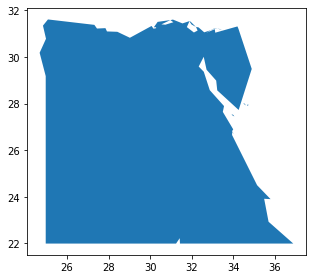


= Importing EGY 6 =


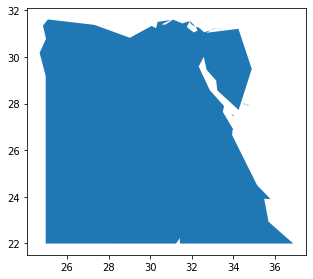


= Importing EGY 7 =


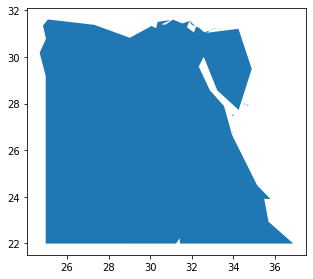


= Importing EGY 8 =


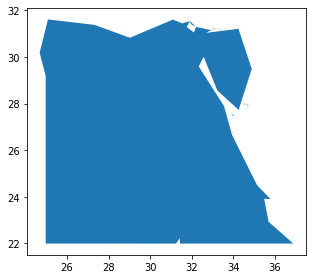


= Importing EGY 9 =


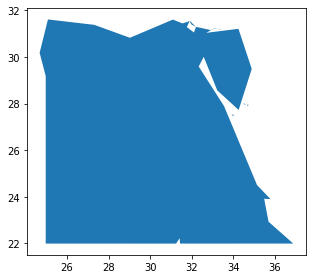


= Importing ERI 4 =


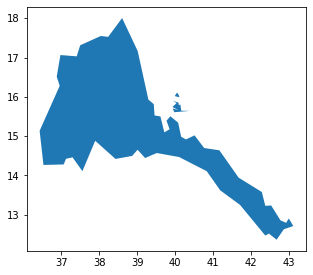


= Importing ERI 5 =


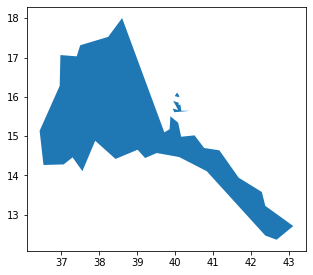


= Importing ERI 6 =


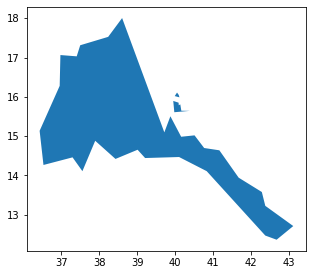


= Importing ERI 7 =


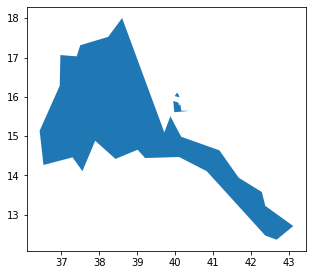


= Importing ERI 8 =


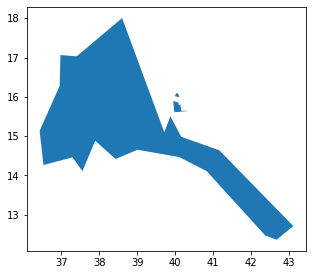


= Importing ERI 9 =


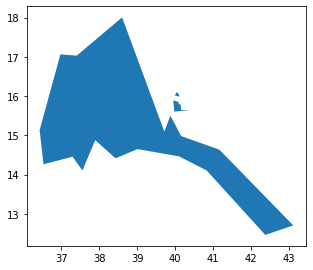


= Importing ESP 4 =


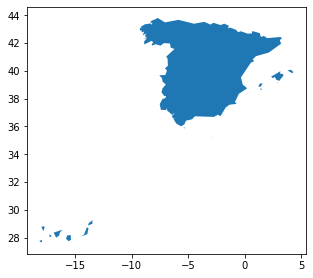


= Importing ESP 5 =


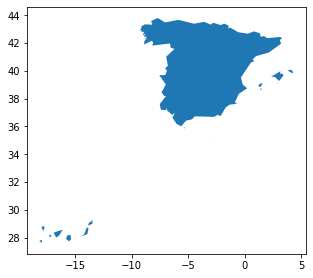


= Importing ESP 6 =


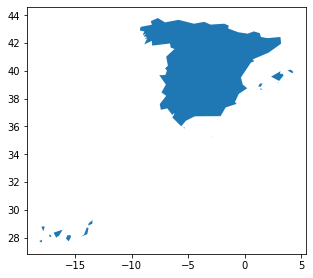


= Importing ESP 7 =


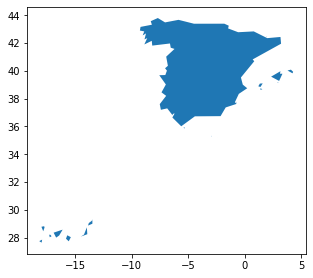


= Importing ESP 8 =


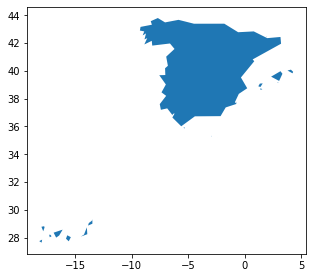


= Importing ESP 9 =


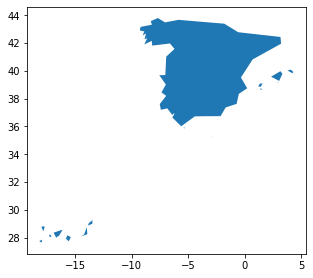


= Importing EST 4 =


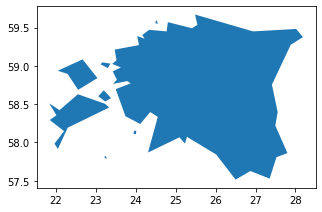


= Importing EST 5 =


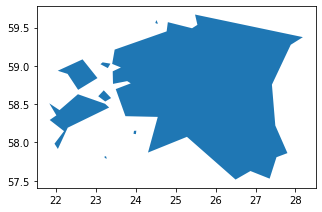


= Importing EST 6 =


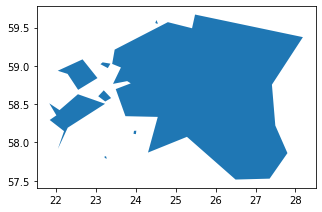


= Importing EST 7 =


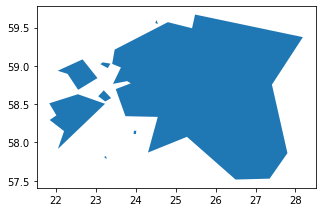


= Importing EST 8 =


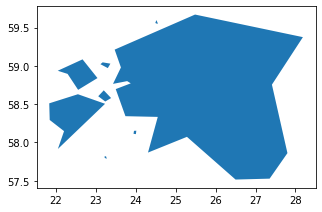


= Importing EST 9 =


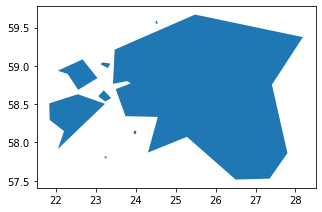


= Importing ETH 4 =


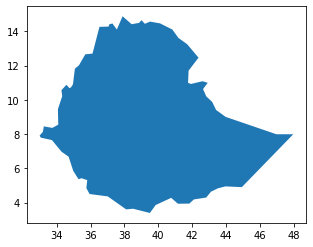


= Importing ETH 5 =


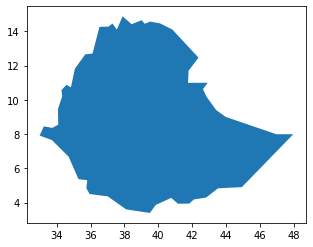


= Importing ETH 6 =


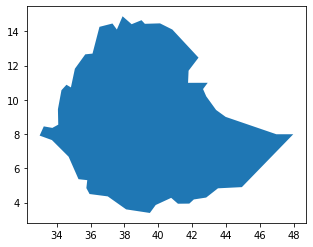


= Importing ETH 7 =


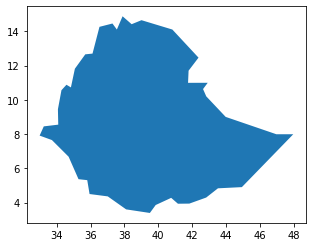


= Importing ETH 8 =


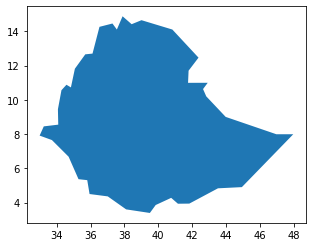


= Importing ETH 9 =


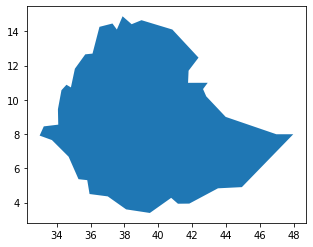


= Importing FIN 4 =


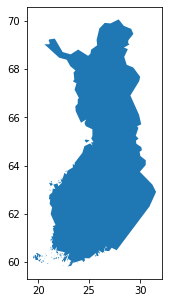


= Importing FIN 5 =


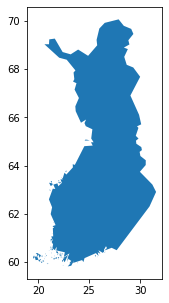


= Importing FIN 6 =


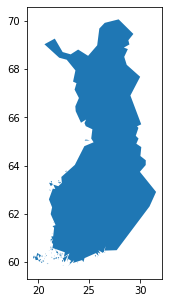


= Importing FIN 7 =


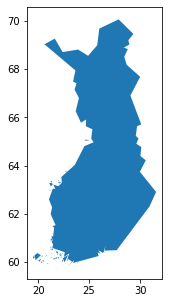


= Importing FIN 8 =


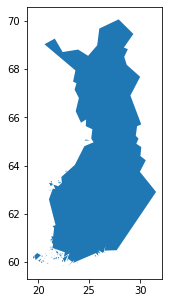


= Importing FIN 9 =


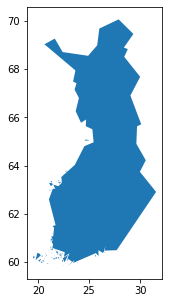


= Importing FJI 4 =


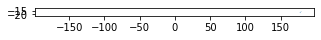


= Importing FJI 5 =


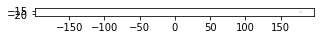


= Importing FJI 6 =


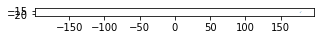


= Importing FJI 7 =


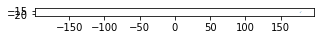


= Importing FJI 8 =


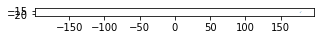


= Importing FJI 9 =


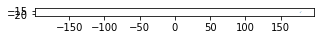


= Importing FLK 4 =


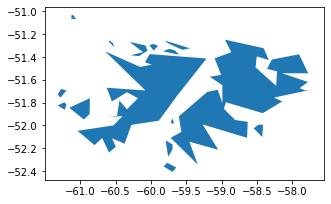


= Importing FLK 5 =


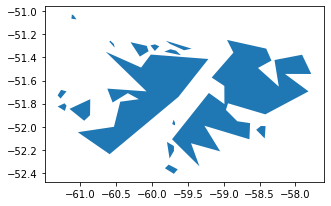


= Importing FLK 6 =


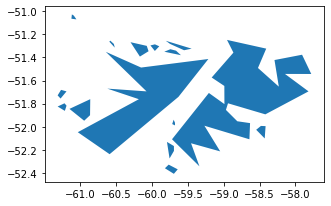


= Importing FLK 7 =


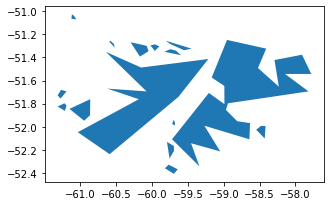


= Importing FLK 8 =


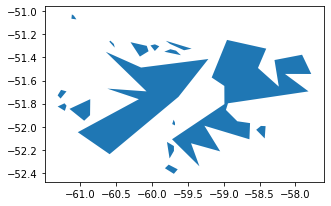


= Importing FLK 9 =


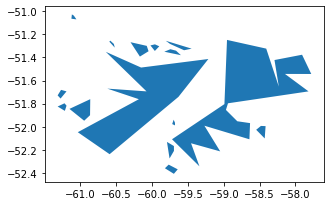


= Importing FRA 4 =


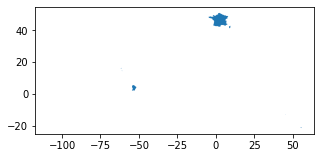


= Importing FRA 5 =


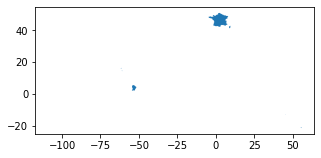


= Importing FRA 6 =


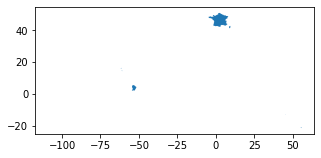


= Importing FRA 7 =


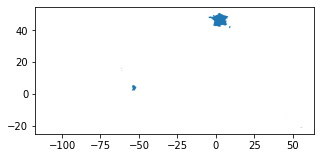


= Importing FRA 8 =


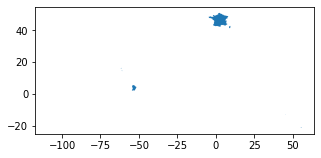


= Importing FRA 9 =


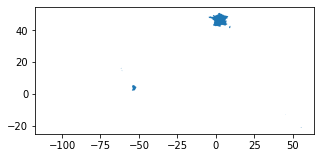


= Importing FRO 4 =


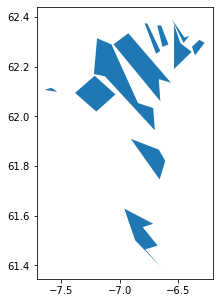


= Importing FRO 5 =


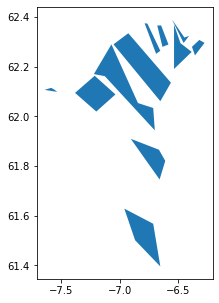


= Importing FRO 6 =


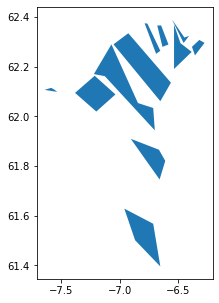


= Importing FRO 7 =


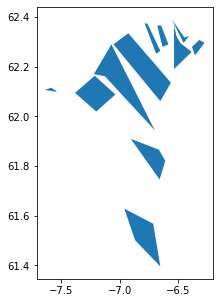


= Importing FRO 8 =


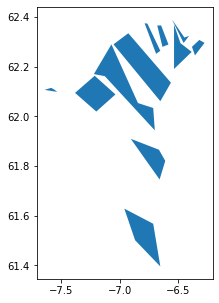


= Importing FRO 9 =


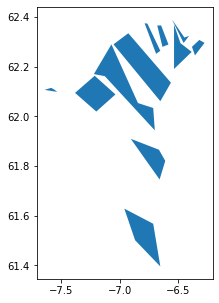


= Importing FSM 4 =


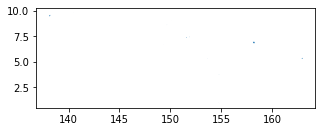


= Importing FSM 5 =


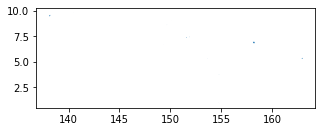


= Importing FSM 6 =


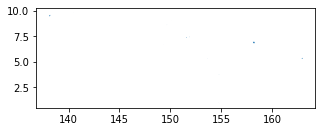


= Importing FSM 7 =


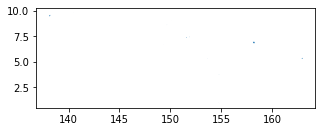


= Importing FSM 8 =


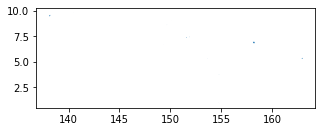


= Importing FSM 9 =


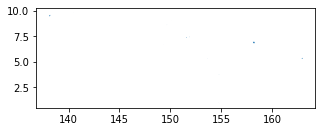


= Importing GAB 4 =


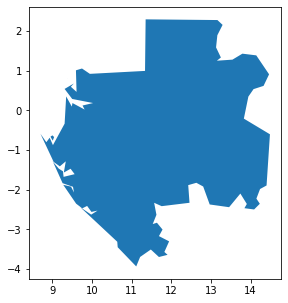


= Importing GAB 5 =


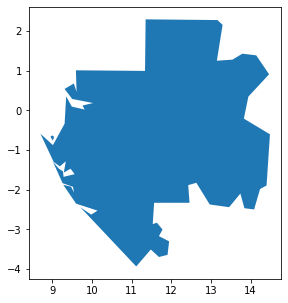


= Importing GAB 6 =


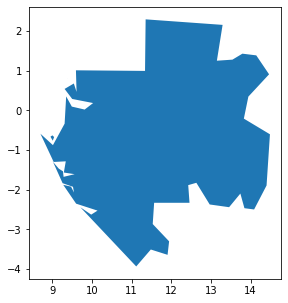


= Importing GAB 7 =


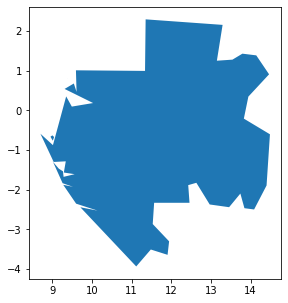


= Importing GAB 8 =


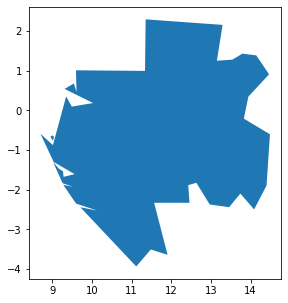


= Importing GAB 9 =


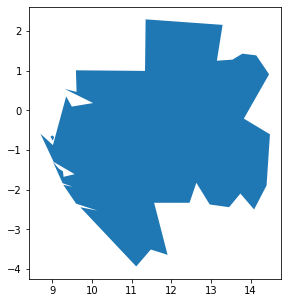


= Importing GBR 4 =


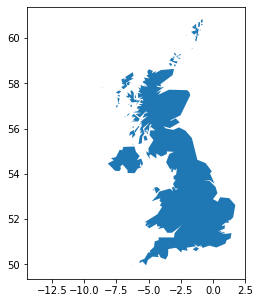


= Importing GBR 5 =


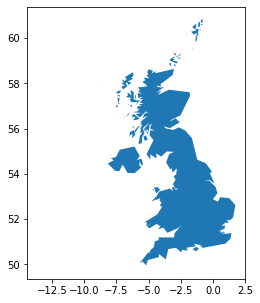


= Importing GBR 6 =


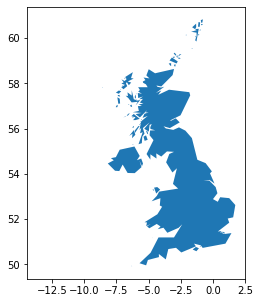


= Importing GBR 7 =


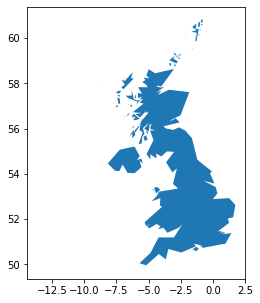


= Importing GBR 8 =


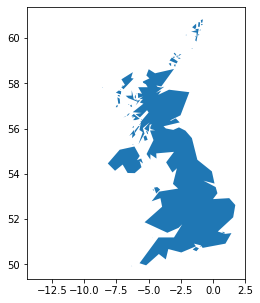


= Importing GBR 9 =


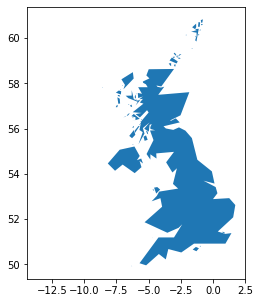


= Importing GEO 4 =


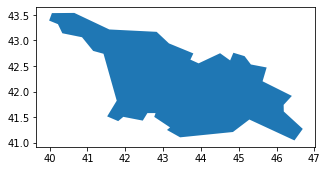


= Importing GEO 5 =


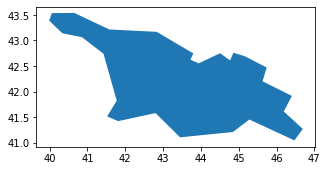


= Importing GEO 6 =


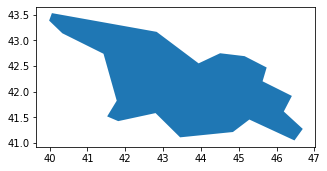


= Importing GEO 7 =


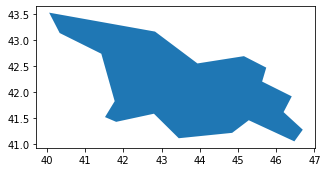


= Importing GEO 8 =


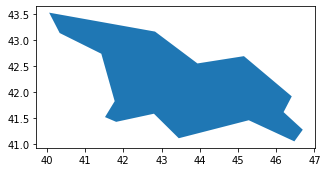


= Importing GEO 9 =


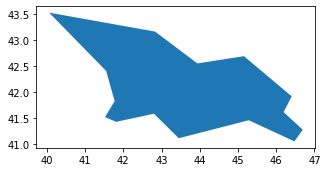


= Importing GGY 4 =


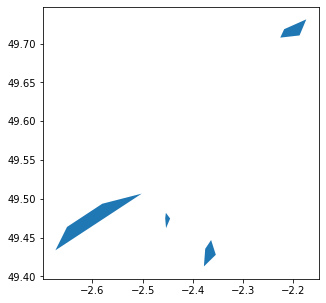


= Importing GGY 5 =


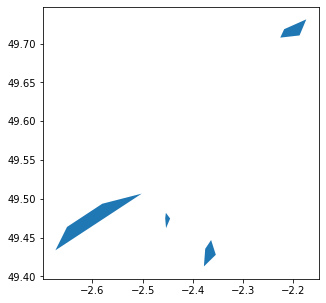


= Importing GGY 6 =


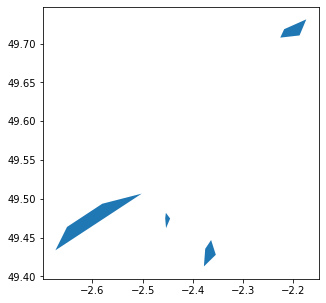


= Importing GGY 7 =


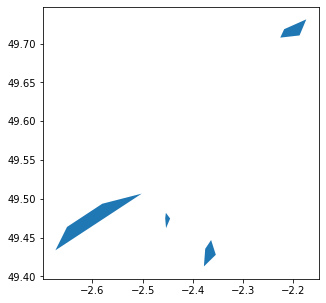


= Importing GGY 8 =


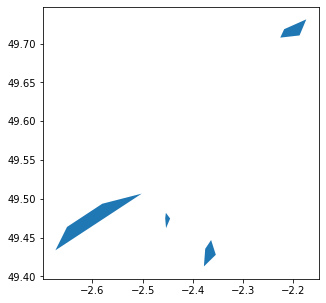


= Importing GGY 9 =


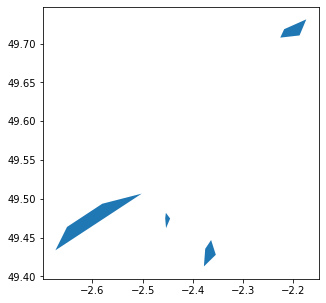


= Importing GHA 4 =


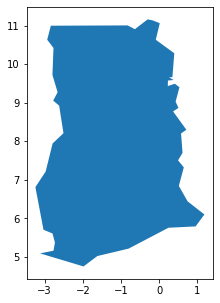


= Importing GHA 5 =


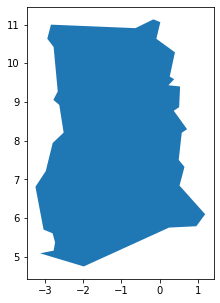


= Importing GHA 6 =


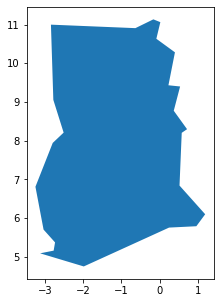


= Importing GHA 7 =


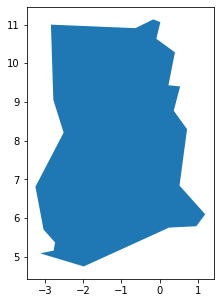


= Importing GHA 8 =


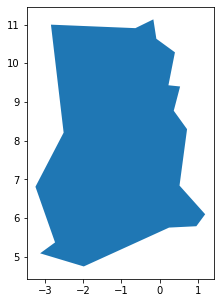


= Importing GHA 9 =


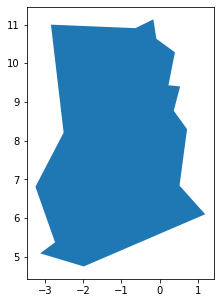


= Importing GIB 4 =


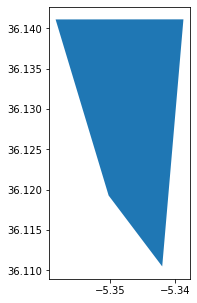


= Importing GIB 5 =


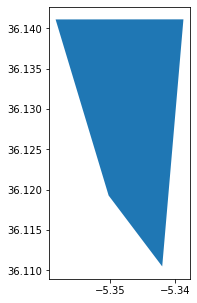


= Importing GIB 6 =


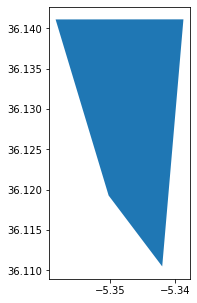


= Importing GIB 7 =


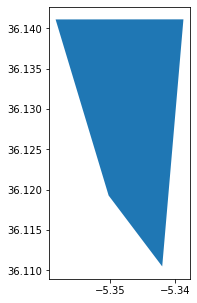


= Importing GIB 8 =


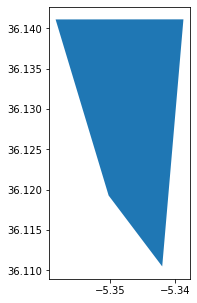


= Importing GIB 9 =


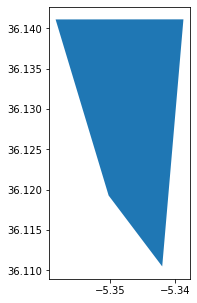


= Importing GIN 4 =


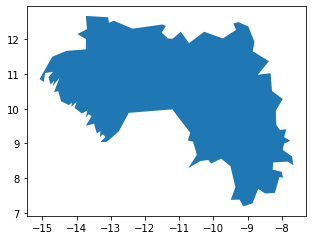


= Importing GIN 5 =


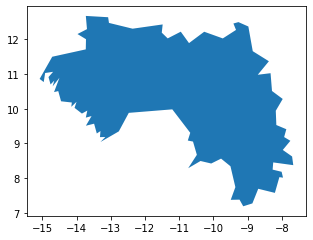


= Importing GIN 6 =


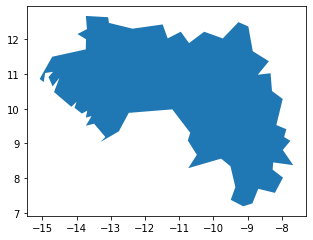


= Importing GIN 7 =


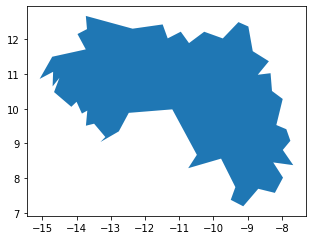


= Importing GIN 8 =


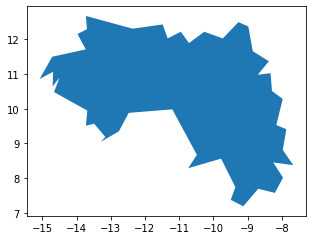


= Importing GIN 9 =


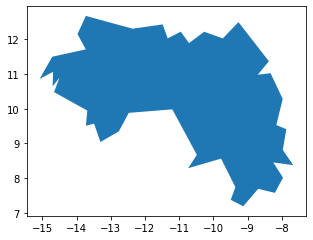


= Importing GMB 4 =


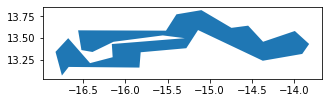


= Importing GMB 5 =


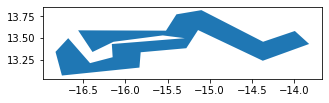


= Importing GMB 6 =


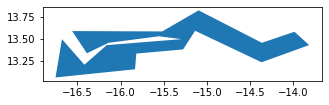


= Importing GMB 7 =


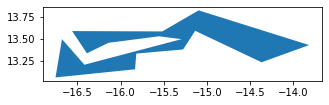


= Importing GMB 8 =


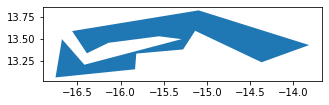


= Importing GMB 9 =


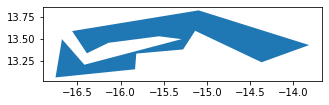


= Importing GNB 4 =


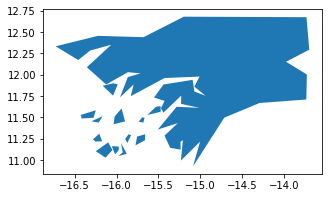


= Importing GNB 5 =


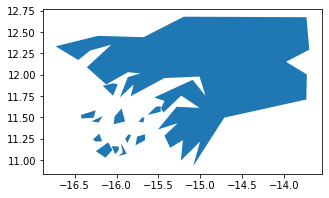


= Importing GNB 6 =


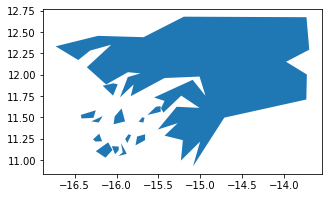


= Importing GNB 7 =


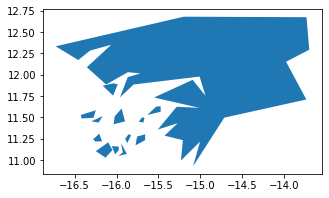


= Importing GNB 8 =


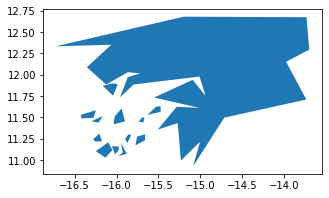


= Importing GNB 9 =


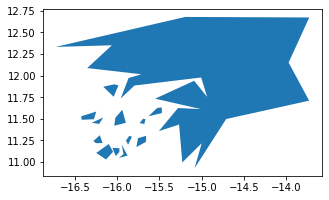


= Importing GNQ 4 =


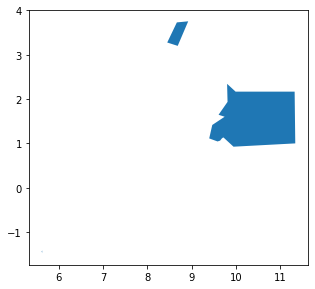


= Importing GNQ 5 =


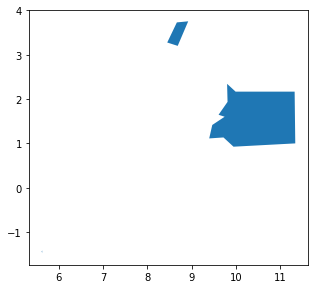


= Importing GNQ 6 =


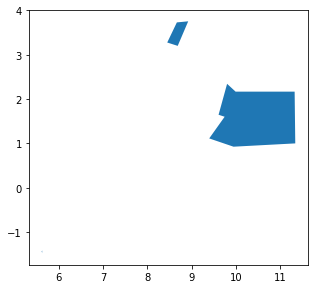


= Importing GNQ 7 =


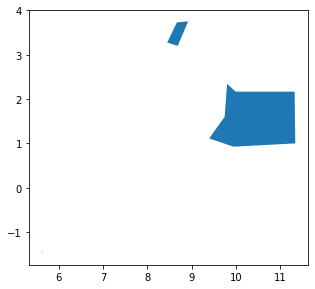


= Importing GNQ 8 =


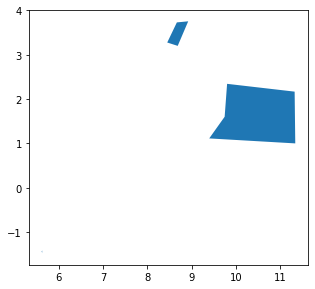


= Importing GNQ 9 =


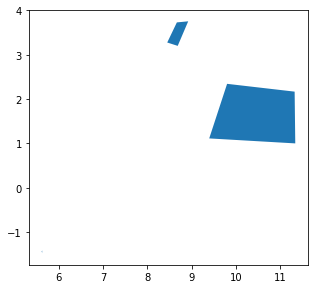


= Importing GRC 4 =


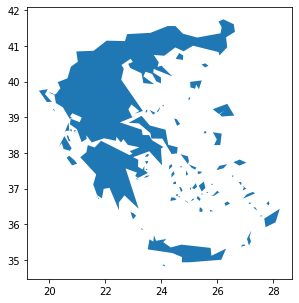


= Importing GRC 5 =


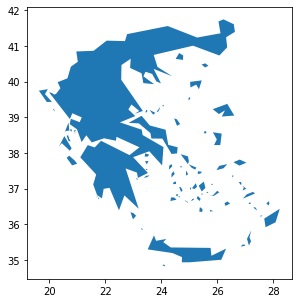


= Importing GRC 6 =


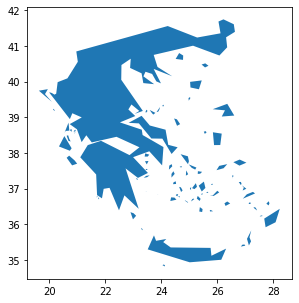


= Importing GRC 7 =


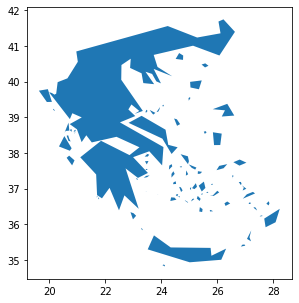


= Importing GRC 8 =


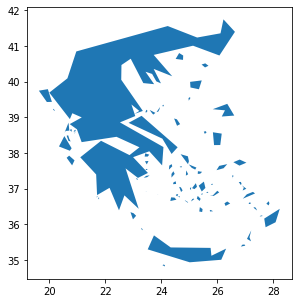


= Importing GRC 9 =


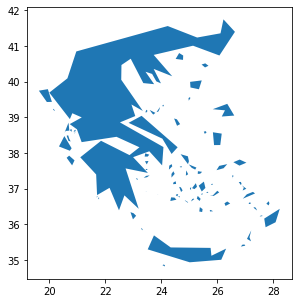


= Importing GRD 4 =


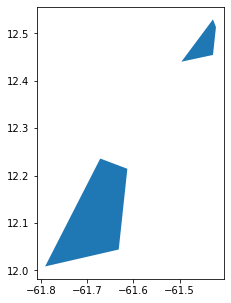


= Importing GRD 5 =


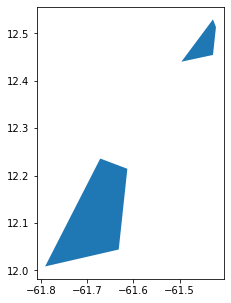


= Importing GRD 6 =


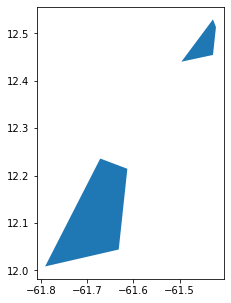


= Importing GRD 7 =


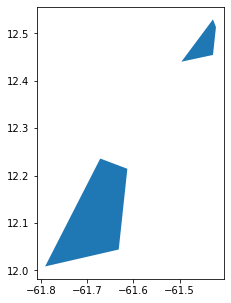


= Importing GRD 8 =


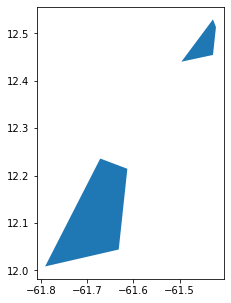


= Importing GRD 9 =


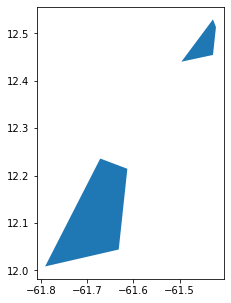


= Importing GRL 4 =


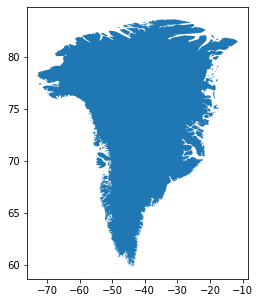


= Importing GRL 5 =


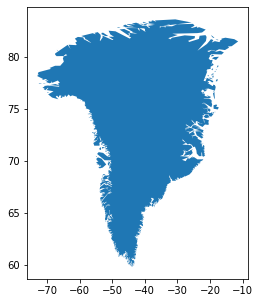


= Importing GRL 6 =


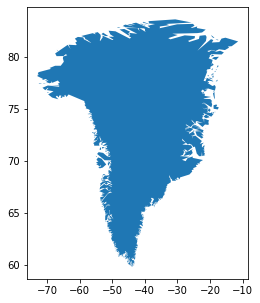


= Importing GRL 7 =


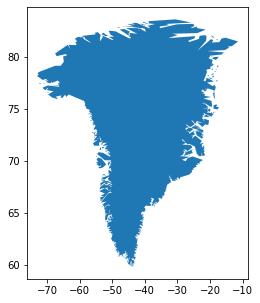


= Importing GRL 8 =


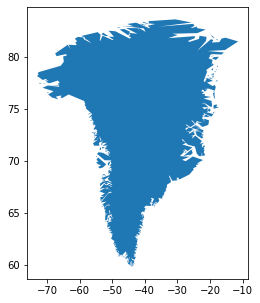


= Importing GRL 9 =


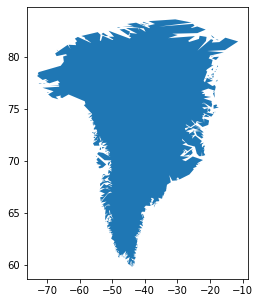


= Importing GTM 4 =


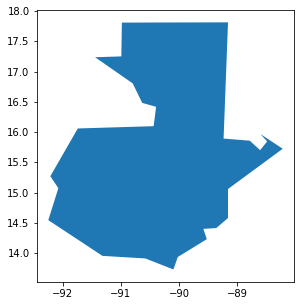


= Importing GTM 5 =


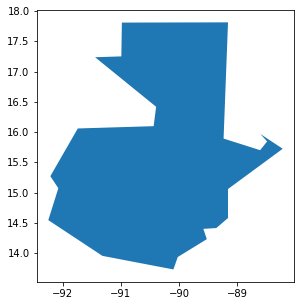


= Importing GTM 6 =


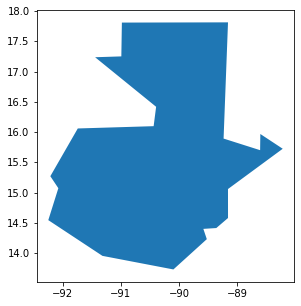


= Importing GTM 7 =


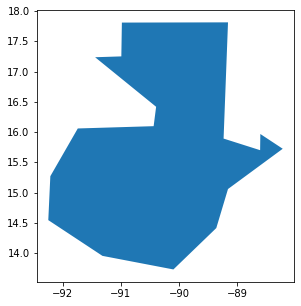


= Importing GTM 8 =


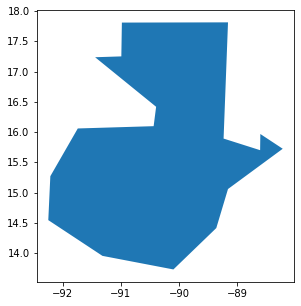


= Importing GTM 9 =


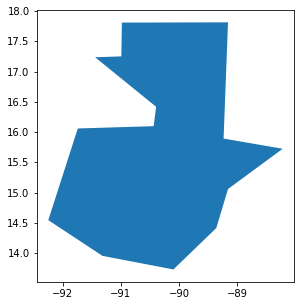


= Importing GUM 4 =


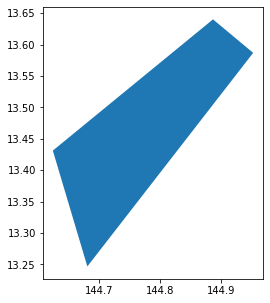


= Importing GUM 5 =


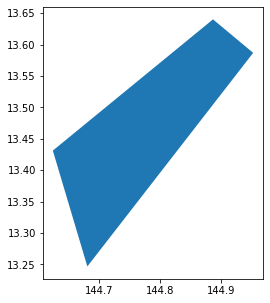


= Importing GUM 6 =


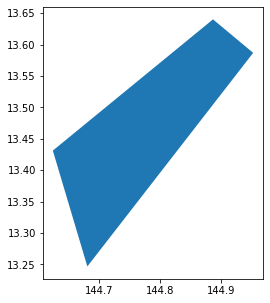


= Importing GUM 7 =


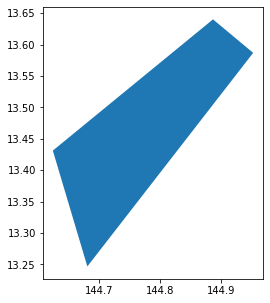


= Importing GUM 8 =


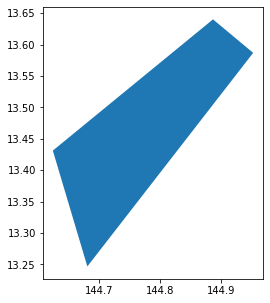


= Importing GUM 9 =


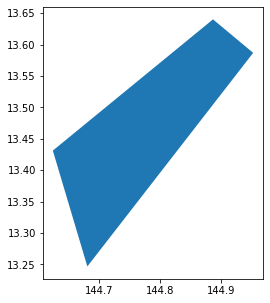


= Importing GUY 4 =


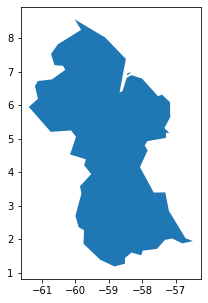


= Importing GUY 5 =


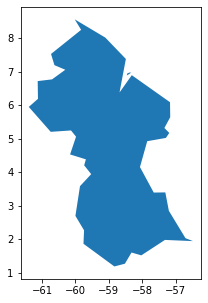


= Importing GUY 6 =


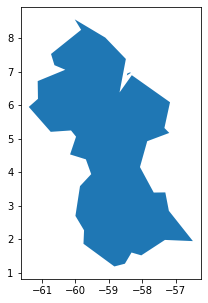


= Importing GUY 7 =


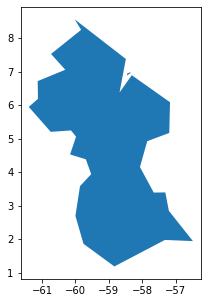


= Importing GUY 8 =


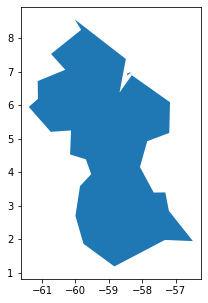


= Importing GUY 9 =


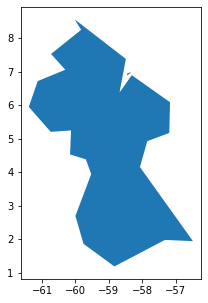


= Importing HKG 4 =


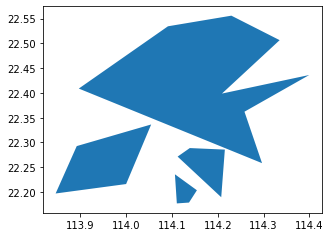


= Importing HKG 5 =


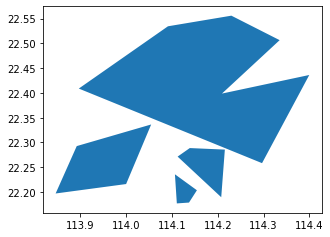


= Importing HKG 6 =


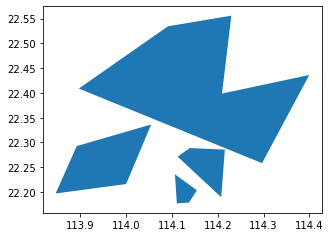


= Importing HKG 7 =


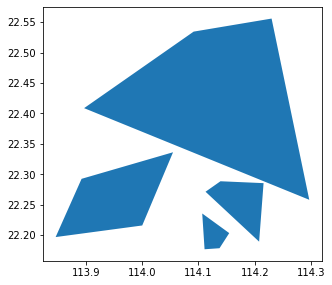


= Importing HKG 8 =


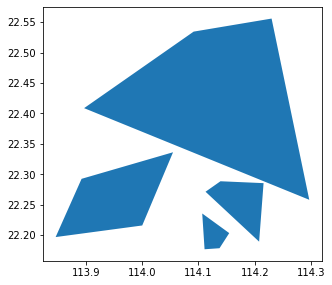


= Importing HKG 9 =


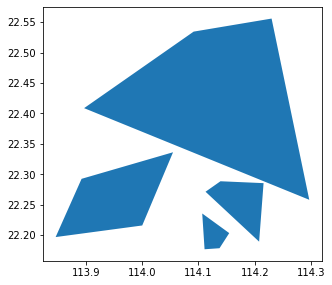


= Importing HMD 4 =


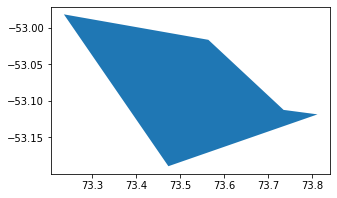


= Importing HMD 5 =


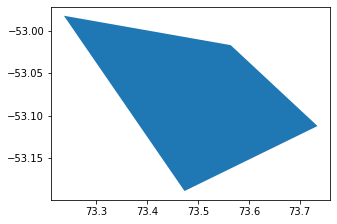


= Importing HMD 6 =


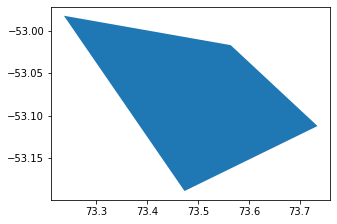


= Importing HMD 7 =


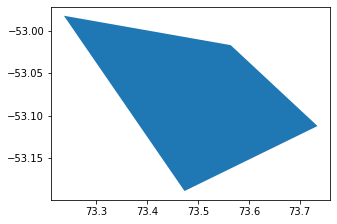


= Importing HMD 8 =


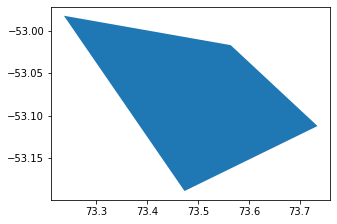


= Importing HMD 9 =


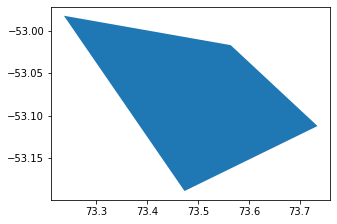


= Importing HND 4 =


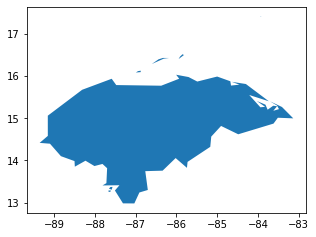


= Importing HND 5 =


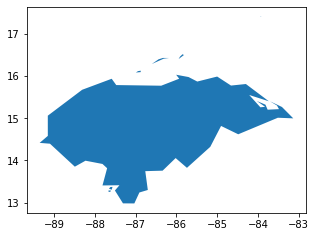


= Importing HND 6 =


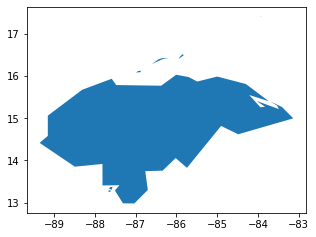


= Importing HND 7 =


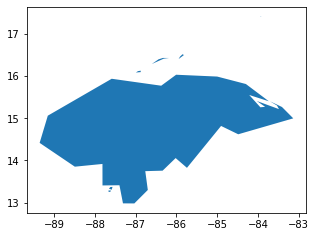


= Importing HND 8 =


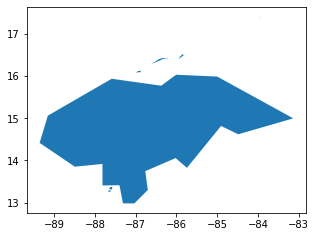


= Importing HND 9 =


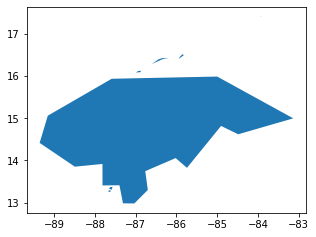


= Importing HRV 4 =


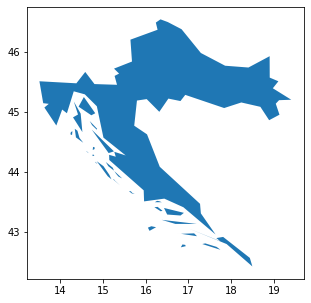


= Importing HRV 5 =


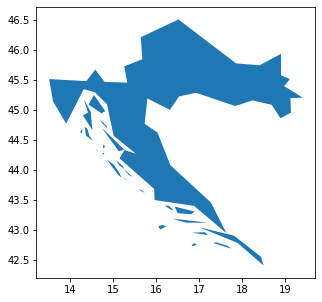


= Importing HRV 6 =


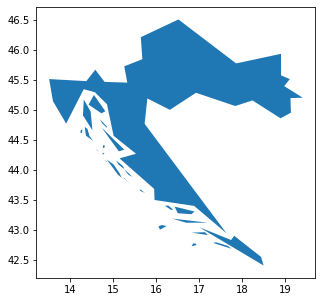


= Importing HRV 7 =


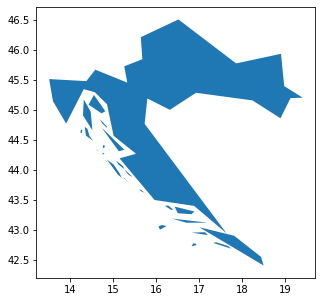


= Importing HRV 8 =


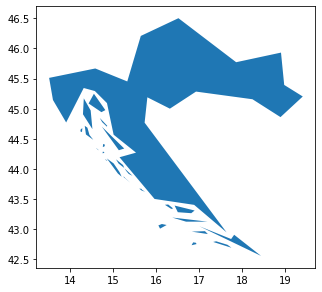


= Importing HRV 9 =


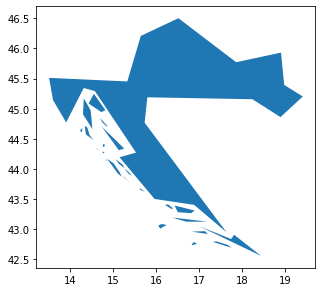


= Importing HTI 4 =


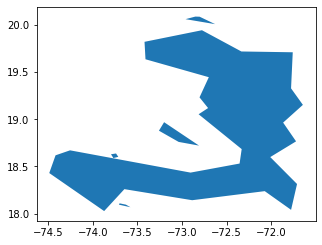


= Importing HTI 5 =


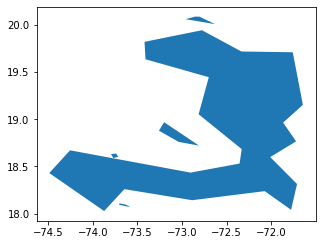


= Importing HTI 6 =


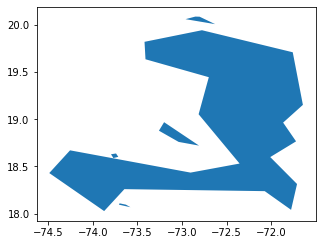


= Importing HTI 7 =


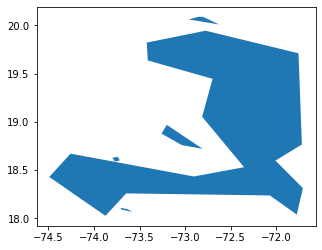


= Importing HTI 8 =


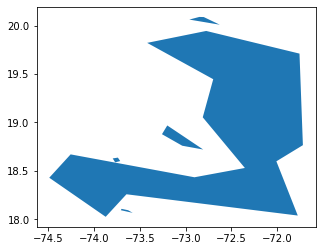


= Importing HTI 9 =


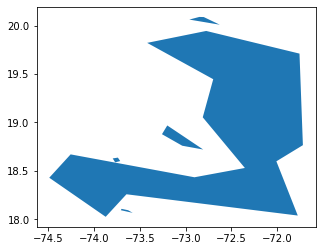


= Importing HUN 4 =


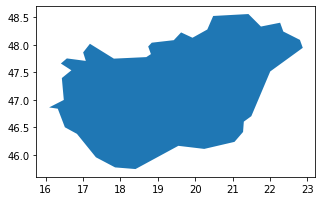


= Importing HUN 5 =


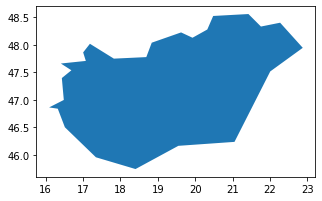


= Importing HUN 6 =


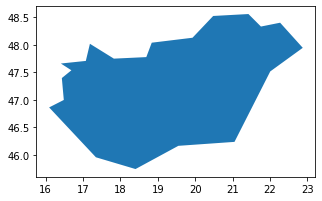


= Importing HUN 7 =


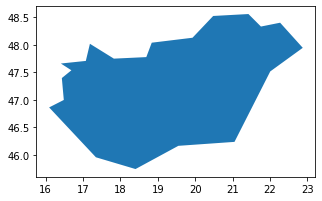


= Importing HUN 8 =


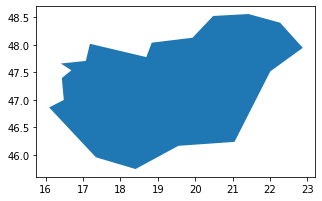


= Importing HUN 9 =


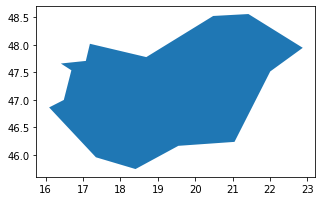


= Importing IDN 4 =


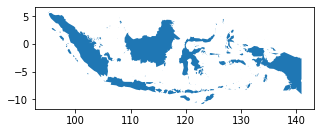


= Importing IDN 5 =


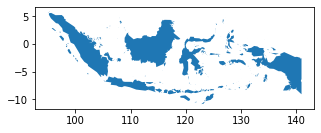


= Importing IDN 6 =


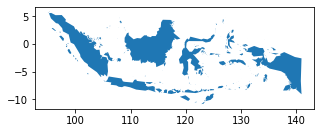


= Importing IDN 7 =


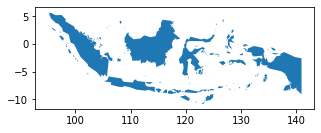


= Importing IDN 8 =


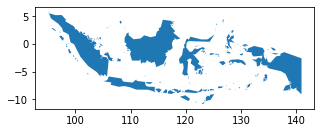


= Importing IDN 9 =


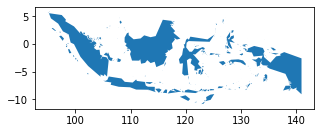


= Importing IMN 4 =


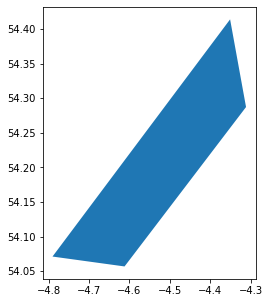


= Importing IMN 5 =


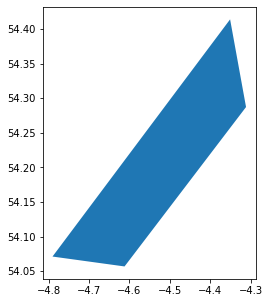


= Importing IMN 6 =


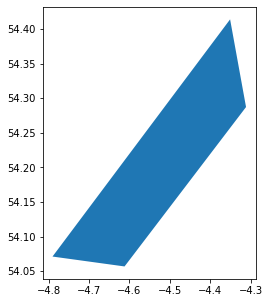


= Importing IMN 7 =


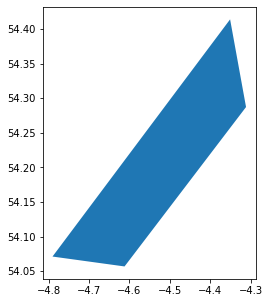


= Importing IMN 8 =


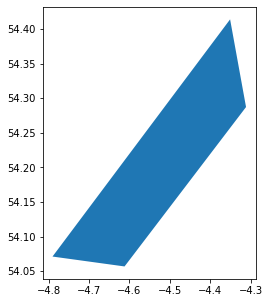


= Importing IMN 9 =


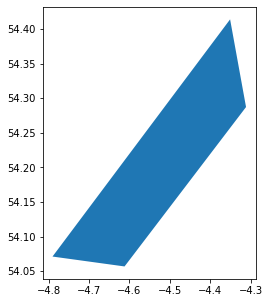


= Importing IND 4 =


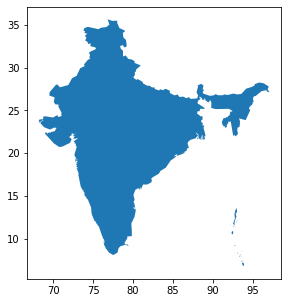


= Importing IND 5 =


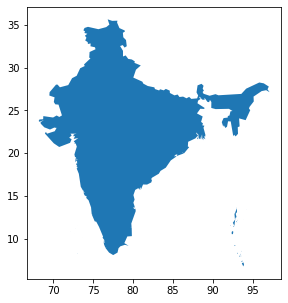


= Importing IND 6 =


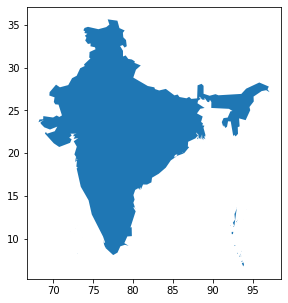


= Importing IND 7 =


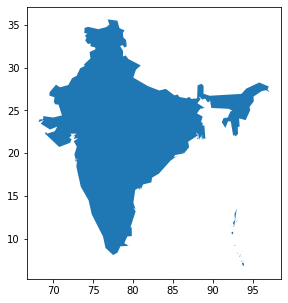


= Importing IND 8 =


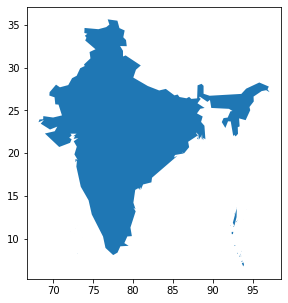


= Importing IND 9 =


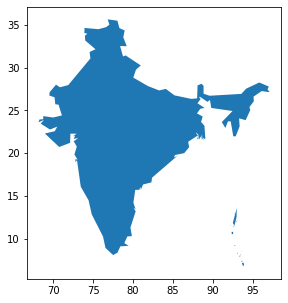


= Importing IOT 4 =


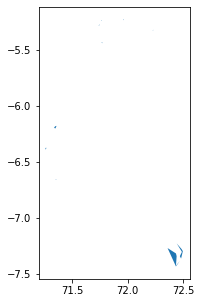


= Importing IOT 5 =


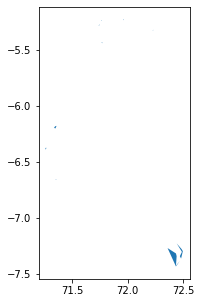


= Importing IOT 6 =


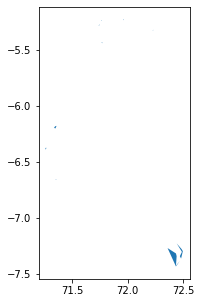


= Importing IOT 7 =


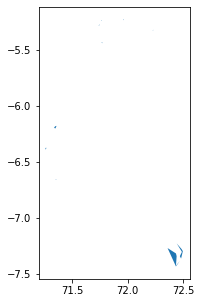


= Importing IOT 8 =


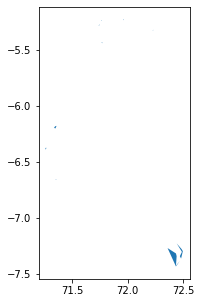


= Importing IOT 9 =


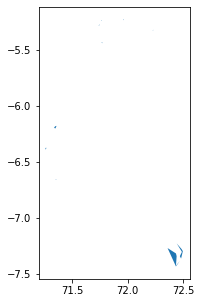


= Importing IRL 4 =


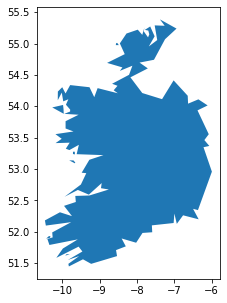


= Importing IRL 5 =


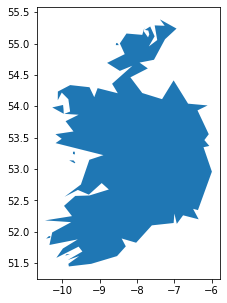


= Importing IRL 6 =


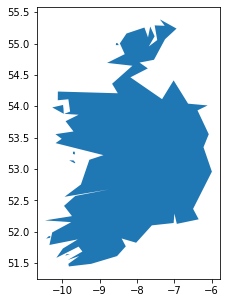


= Importing IRL 7 =


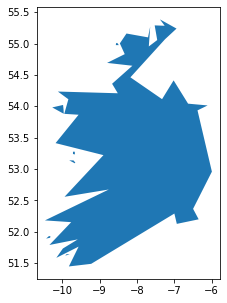


= Importing IRL 8 =


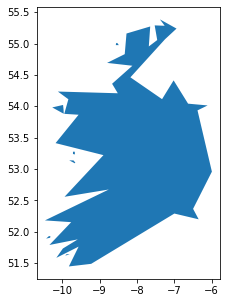


= Importing IRL 9 =


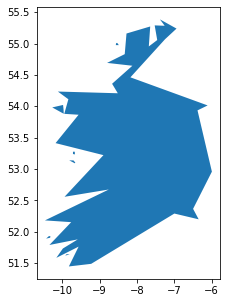


= Importing IRN 4 =


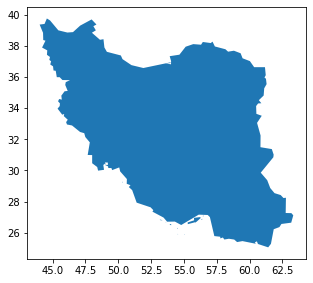


= Importing IRN 5 =


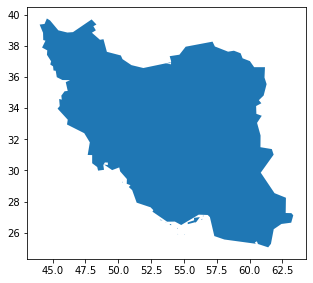


= Importing IRN 6 =


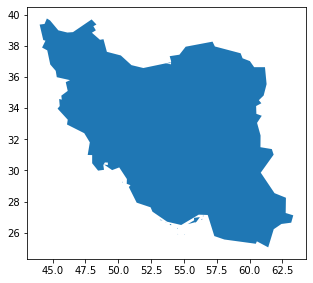


= Importing IRN 7 =


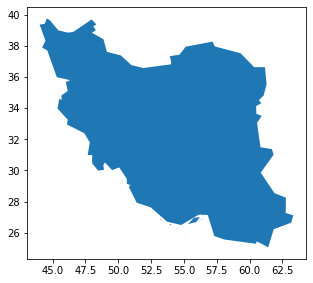


= Importing IRN 8 =


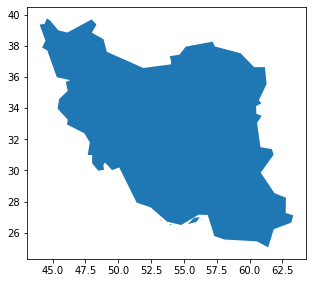


= Importing IRN 9 =


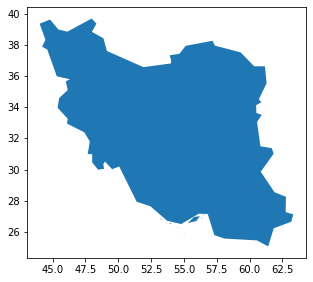


= Importing IRQ 4 =


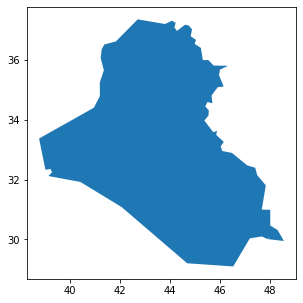


= Importing IRQ 5 =


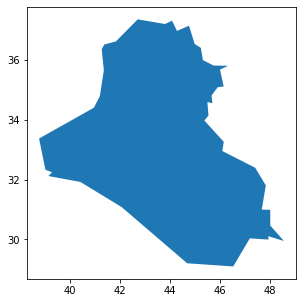


= Importing IRQ 6 =


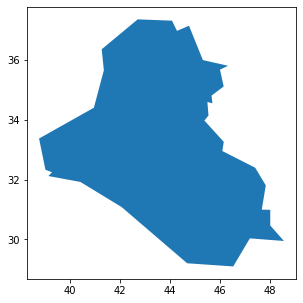


= Importing IRQ 7 =


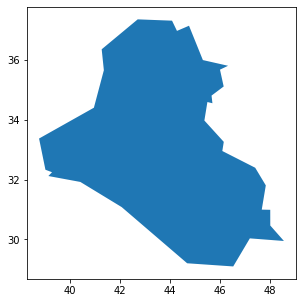


= Importing IRQ 8 =


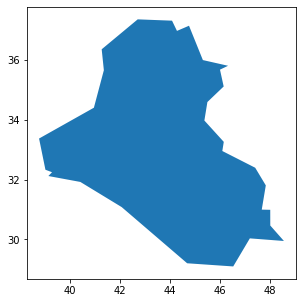


= Importing IRQ 9 =


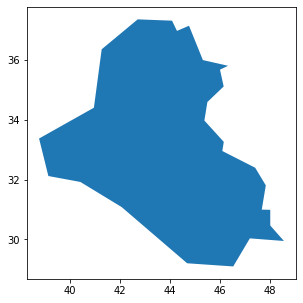


= Importing ISL 4 =


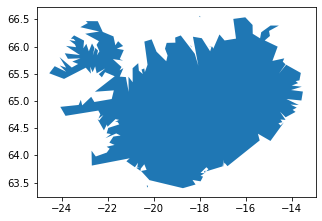


= Importing ISL 5 =


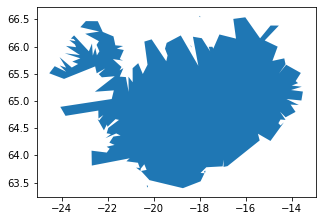


= Importing ISL 6 =


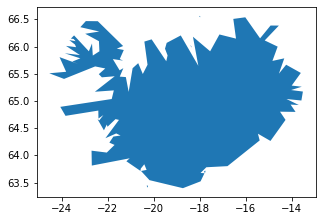


= Importing ISL 7 =


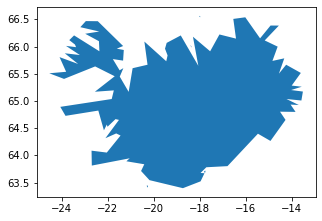


= Importing ISL 8 =


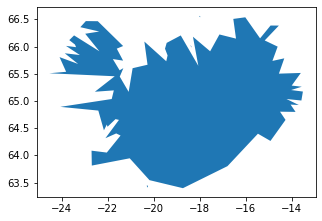


= Importing ISL 9 =


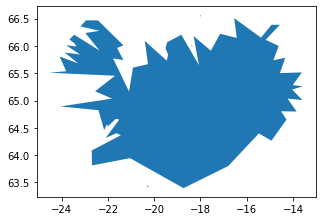


= Importing ISR 4 =


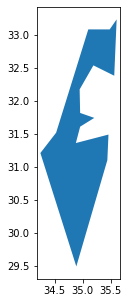


= Importing ISR 5 =


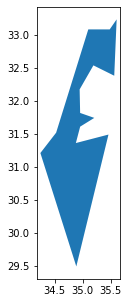


= Importing ISR 6 =


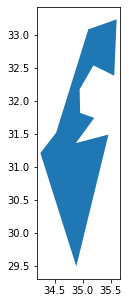


= Importing ISR 7 =


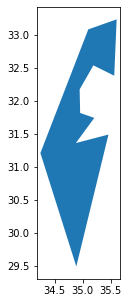


= Importing ISR 8 =


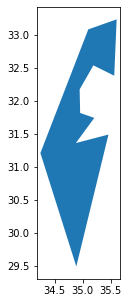


= Importing ISR 9 =


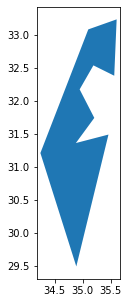


= Importing ITA 4 =


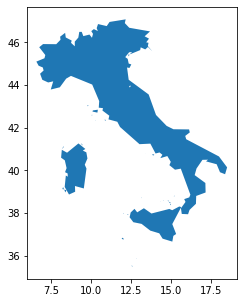


= Importing ITA 5 =


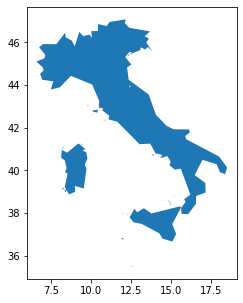


= Importing ITA 6 =


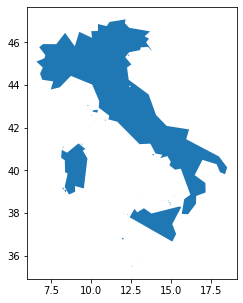


= Importing ITA 7 =


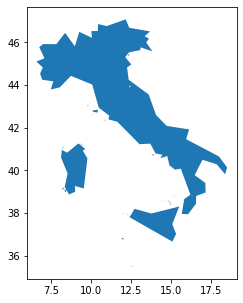


= Importing ITA 8 =


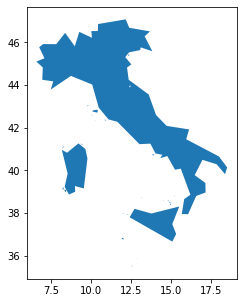


= Importing ITA 9 =


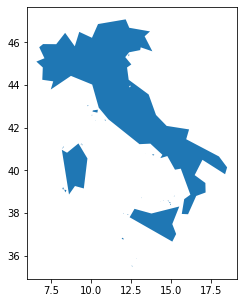


= Importing JAM 4 =


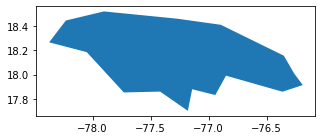


= Importing JAM 5 =


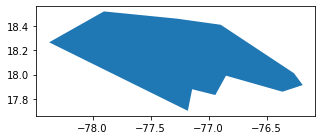


= Importing JAM 6 =


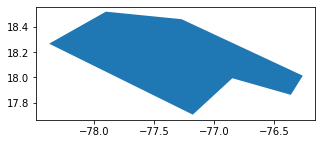


= Importing JAM 7 =


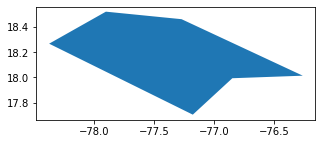


= Importing JAM 8 =


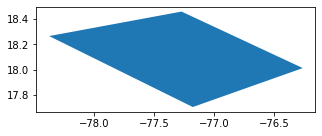


= Importing JAM 9 =


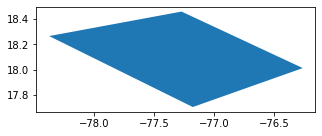


= Importing JEY 4 =


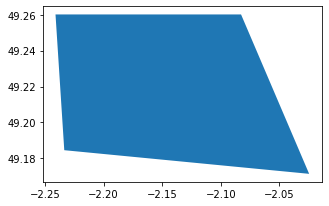


= Importing JEY 5 =


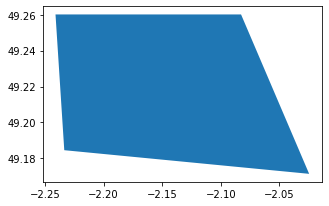


= Importing JEY 6 =


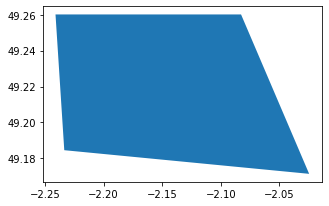


= Importing JEY 7 =


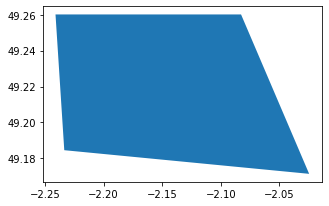


= Importing JEY 8 =


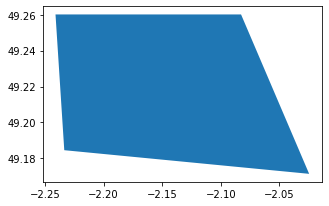


= Importing JEY 9 =


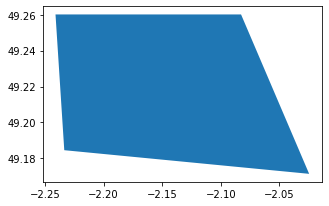


= Importing JOR 4 =


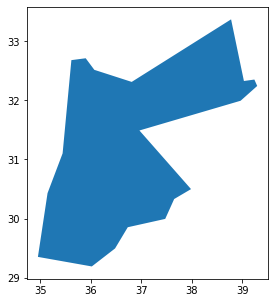


= Importing JOR 5 =


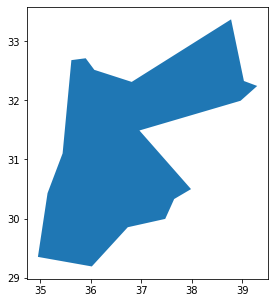


= Importing JOR 6 =


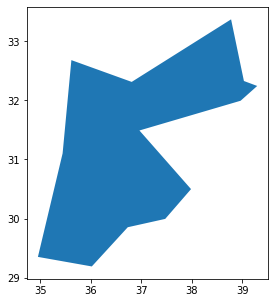


= Importing JOR 7 =


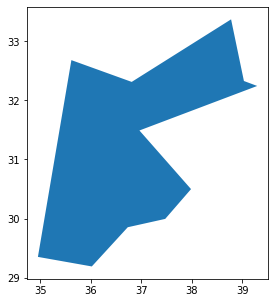


= Importing JOR 8 =


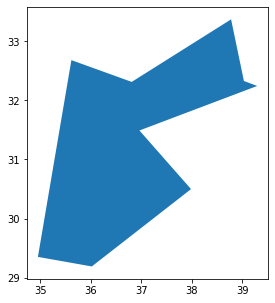


= Importing JOR 9 =


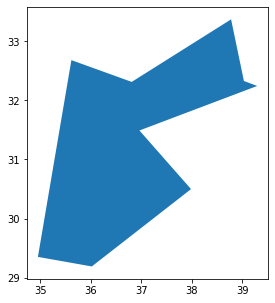


= Importing JPN 4 =


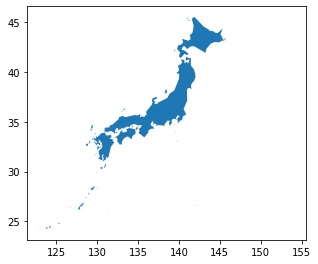


= Importing JPN 5 =


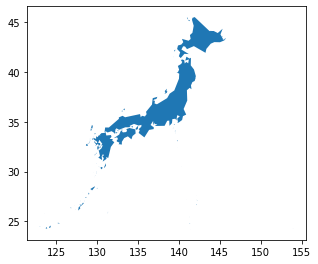


= Importing JPN 6 =


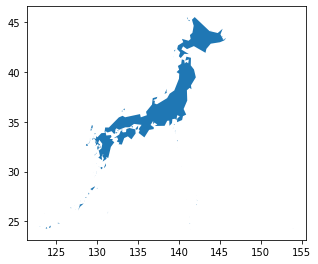


= Importing JPN 7 =


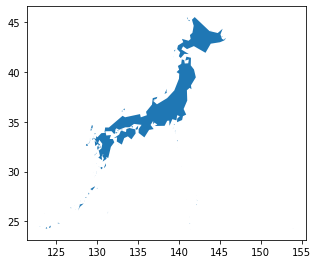


= Importing JPN 8 =


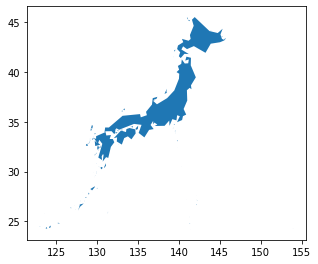


= Importing JPN 9 =


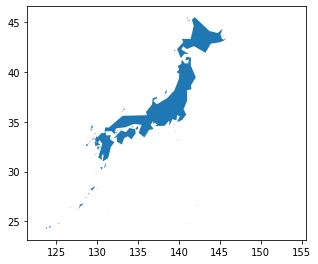


= Importing KAZ 4 =


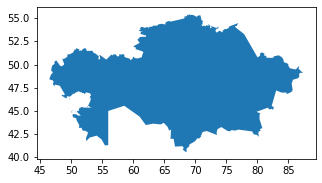


= Importing KAZ 5 =


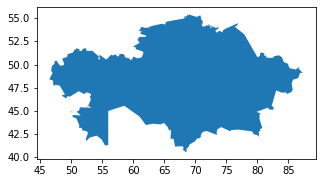


= Importing KAZ 6 =


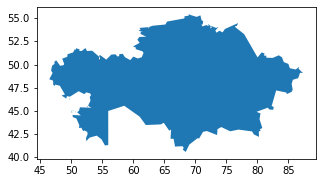


= Importing KAZ 7 =


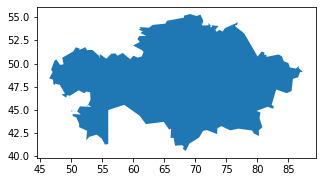


= Importing KAZ 8 =


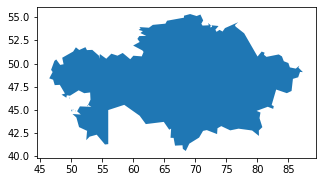


= Importing KAZ 9 =


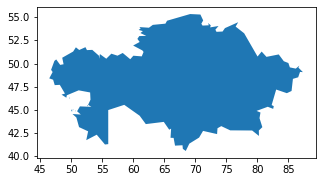


= Importing KEN 4 =


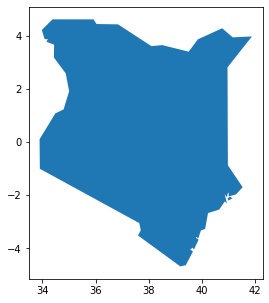


= Importing KEN 5 =


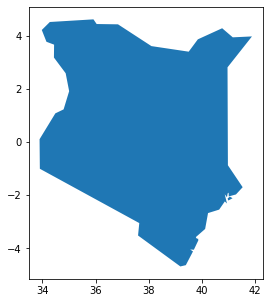


= Importing KEN 6 =


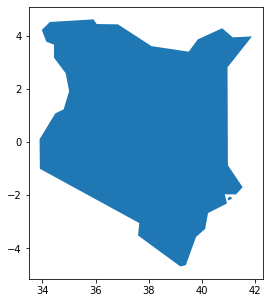


= Importing KEN 7 =


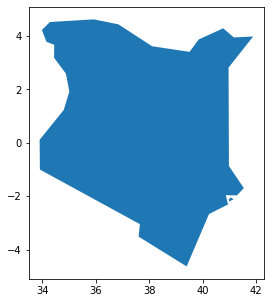


= Importing KEN 8 =


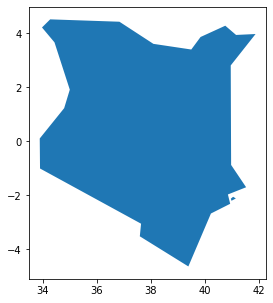


= Importing KEN 9 =


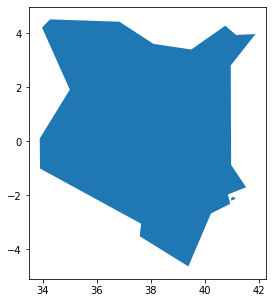


= Importing KGZ 4 =


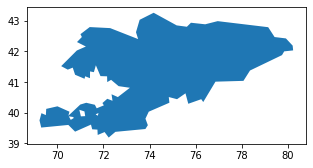


= Importing KGZ 5 =


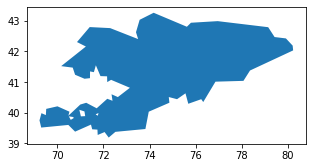


= Importing KGZ 6 =


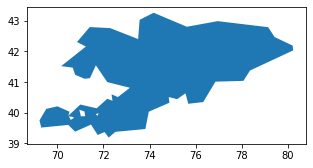


= Importing KGZ 7 =


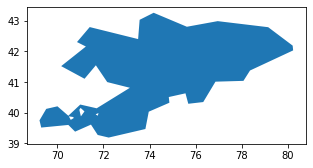


= Importing KGZ 8 =


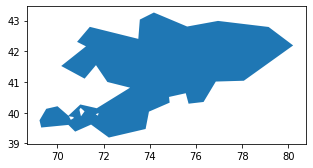


= Importing KGZ 9 =


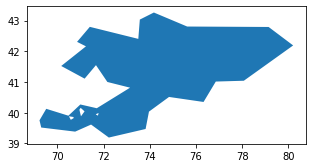


= Importing KHM 4 =


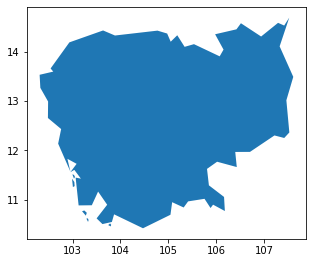


= Importing KHM 5 =


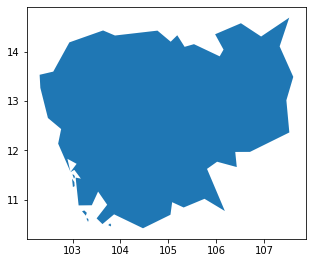


= Importing KHM 6 =


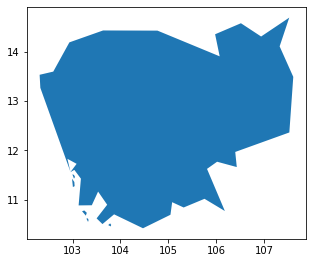


= Importing KHM 7 =


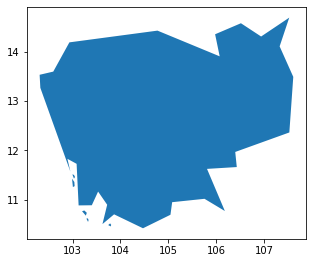


= Importing KHM 8 =


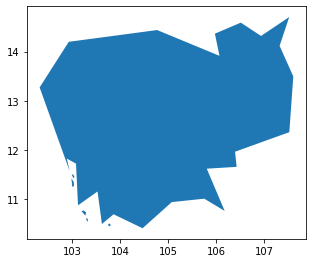


= Importing KHM 9 =


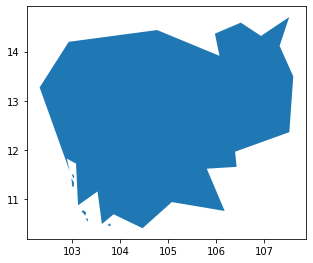


= Importing KIR 4 =


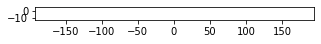


= Importing KIR 5 =


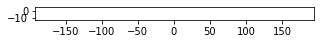


= Importing KIR 6 =


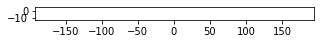


= Importing KIR 7 =


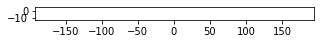


= Importing KIR 8 =


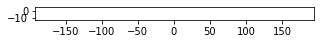


= Importing KIR 9 =


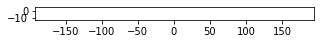


= Importing KNA 4 =


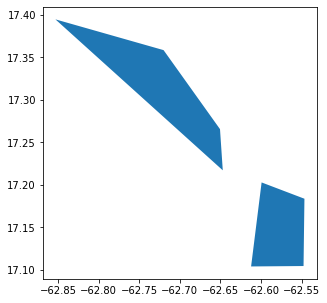


= Importing KNA 5 =


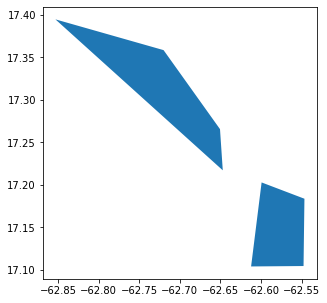


= Importing KNA 6 =


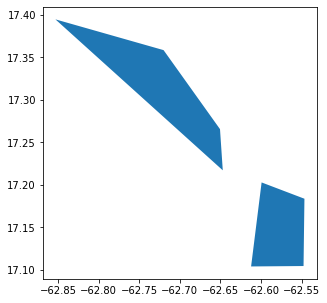


= Importing KNA 7 =


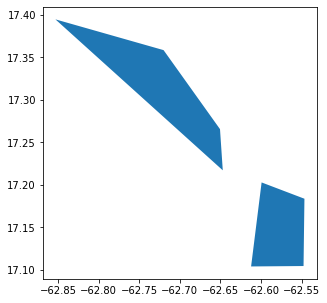


= Importing KNA 8 =


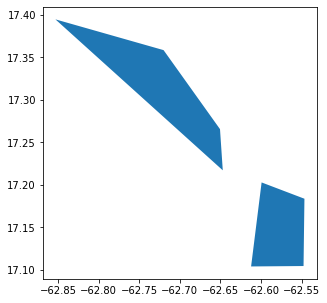


= Importing KNA 9 =


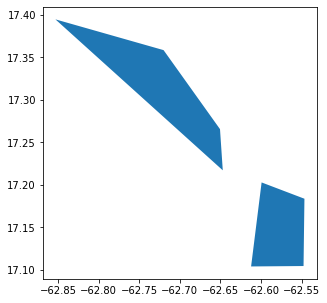


= Importing KOR 4 =


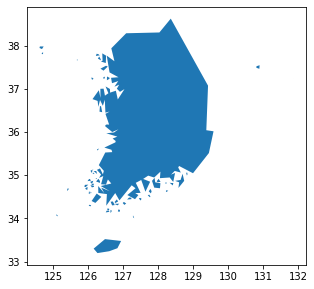


= Importing KOR 5 =


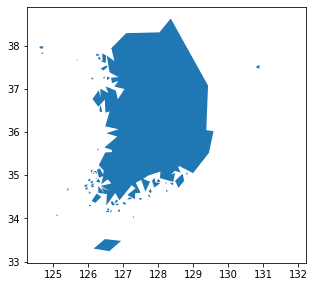


= Importing KOR 6 =


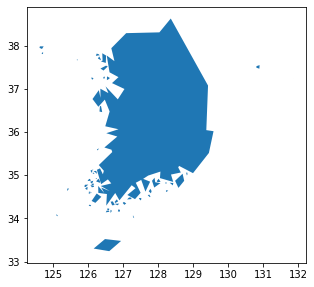


= Importing KOR 7 =


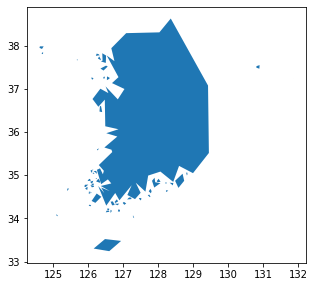


= Importing KOR 8 =


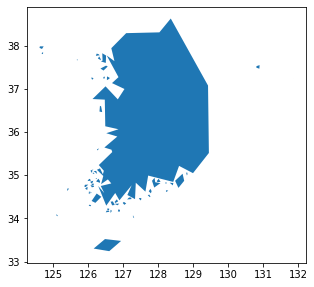


= Importing KOR 9 =


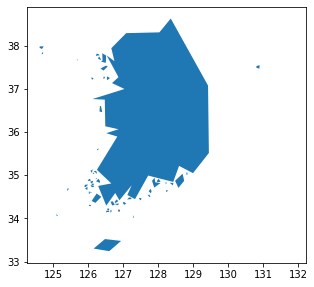


= Importing KWT 4 =


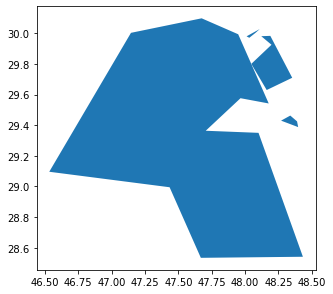


= Importing KWT 5 =


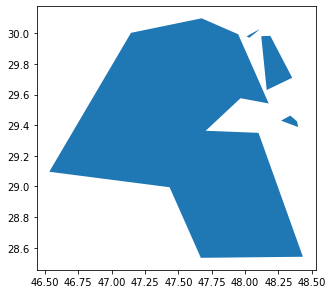


= Importing KWT 6 =


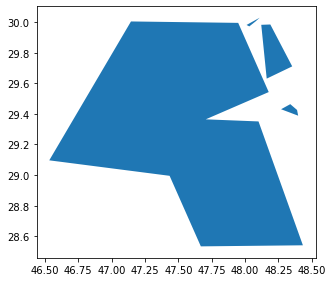


= Importing KWT 7 =


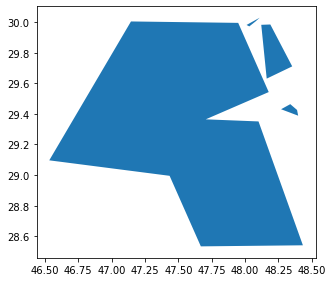


= Importing KWT 8 =


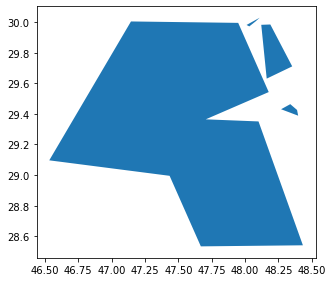


= Importing KWT 9 =


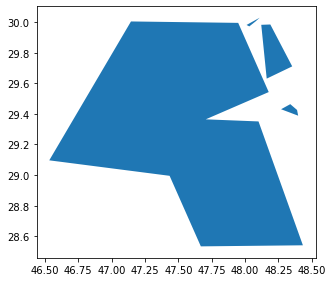


= Importing LAO 4 =


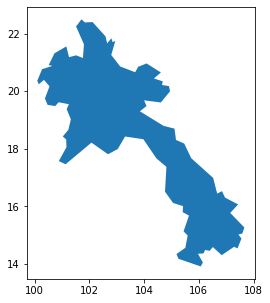


= Importing LAO 5 =


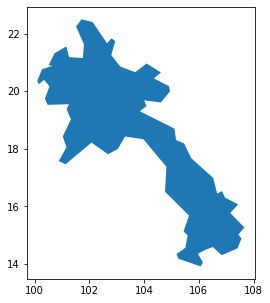


= Importing LAO 6 =


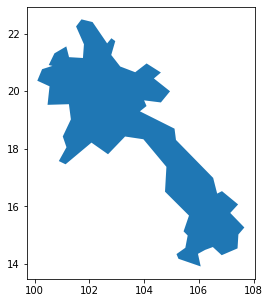


= Importing LAO 7 =


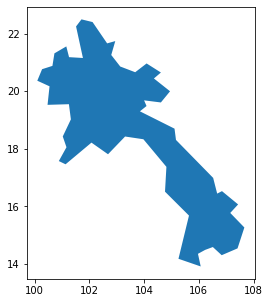


= Importing LAO 8 =


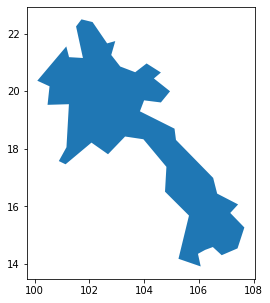


= Importing LAO 9 =


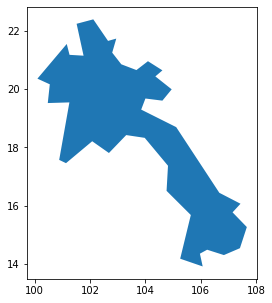


= Importing LBN 4 =


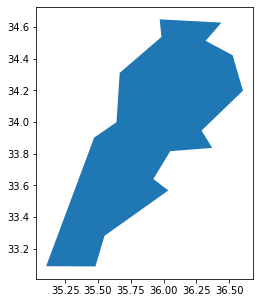


= Importing LBN 5 =


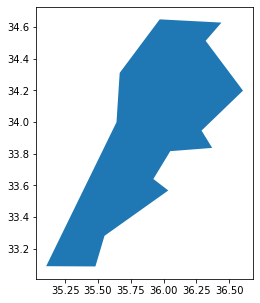


= Importing LBN 6 =


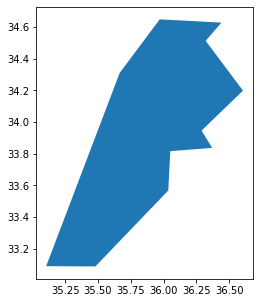


= Importing LBN 7 =


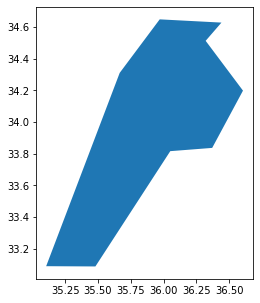


= Importing LBN 8 =


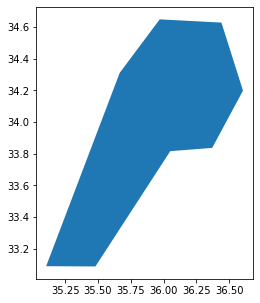


= Importing LBN 9 =


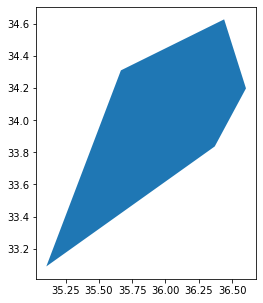


= Importing LBR 4 =


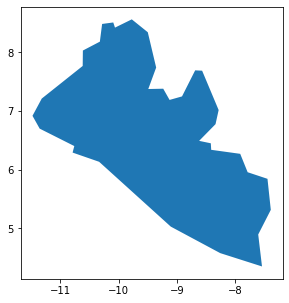


= Importing LBR 5 =


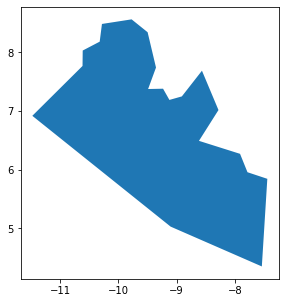


= Importing LBR 6 =


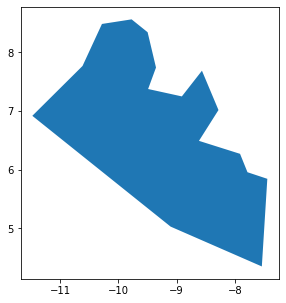


= Importing LBR 7 =


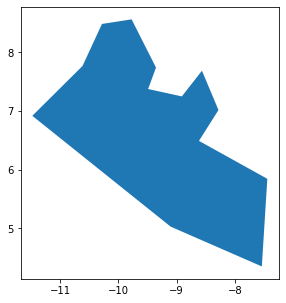


= Importing LBR 8 =


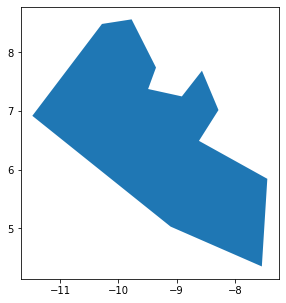


= Importing LBR 9 =


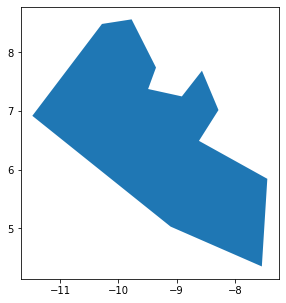


= Importing LBY 4 =


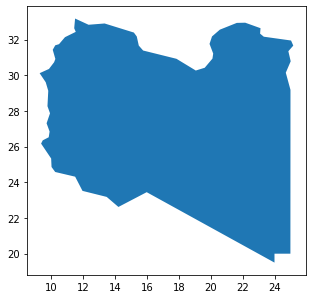


= Importing LBY 5 =


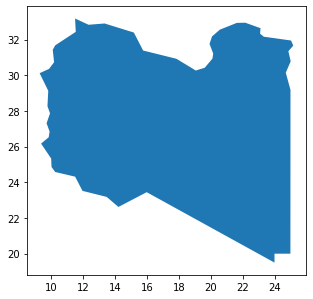


= Importing LBY 6 =


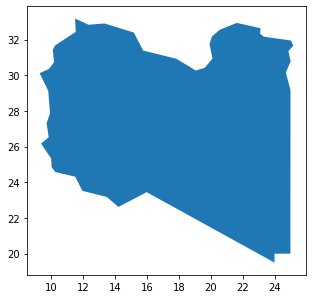


= Importing LBY 7 =


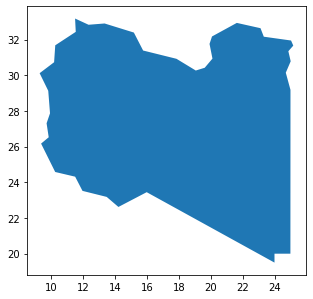


= Importing LBY 8 =


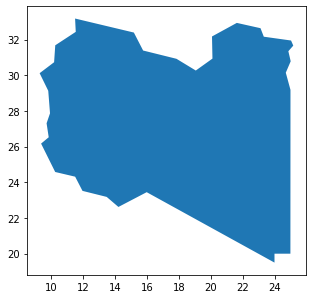


= Importing LBY 9 =


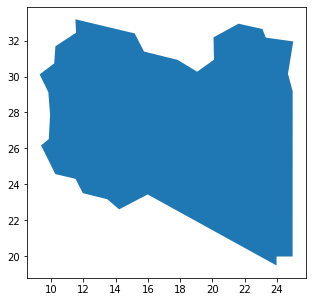


= Importing LCA 4 =


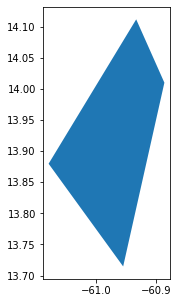


= Importing LCA 5 =


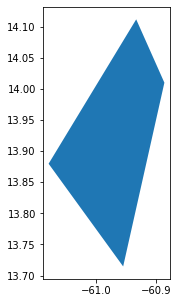


= Importing LCA 6 =


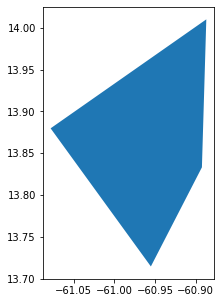


= Importing LCA 7 =


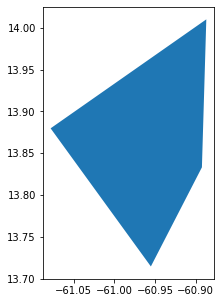


= Importing LCA 8 =


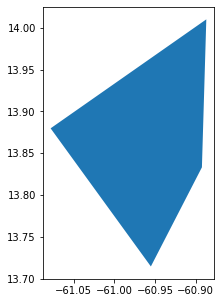


= Importing LCA 9 =


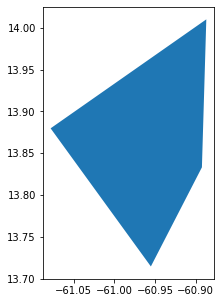


= Importing LIE 4 =


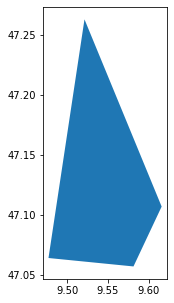


= Importing LIE 5 =


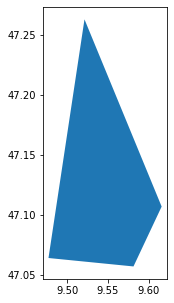


= Importing LIE 6 =


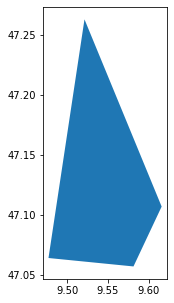


= Importing LIE 7 =


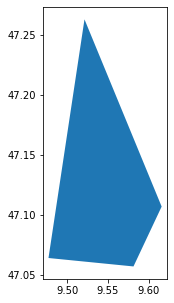


= Importing LIE 8 =


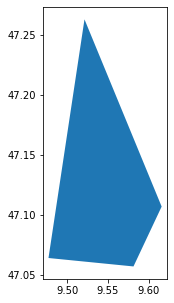


= Importing LIE 9 =


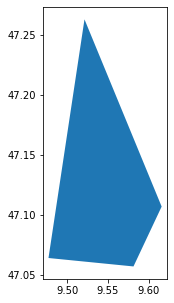


= Importing LKA 4 =


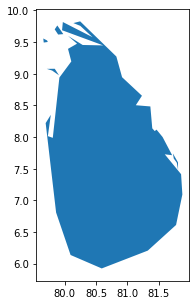


= Importing LKA 5 =


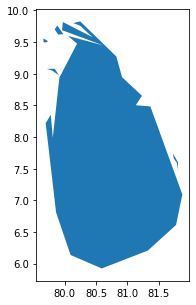


= Importing LKA 6 =


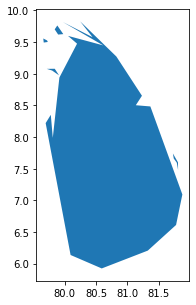


= Importing LKA 7 =


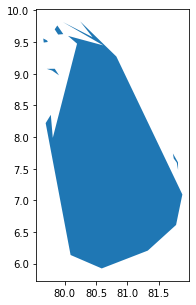


= Importing LKA 8 =


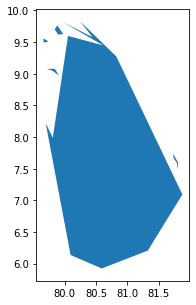


= Importing LKA 9 =


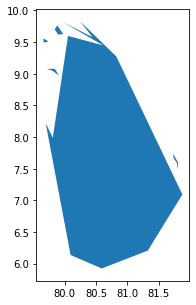


= Importing LSO 4 =


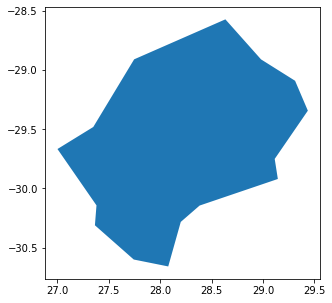


= Importing LSO 5 =


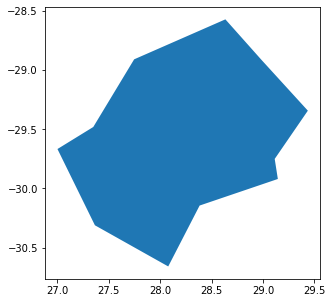


= Importing LSO 6 =


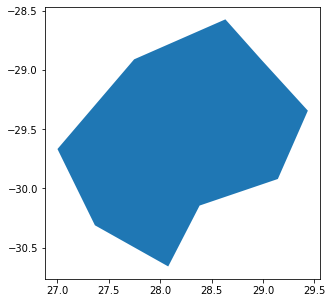


= Importing LSO 7 =


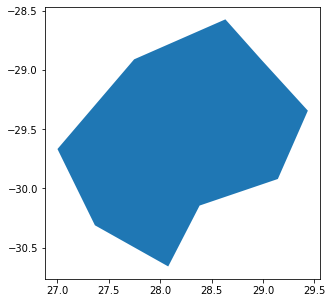


= Importing LSO 8 =


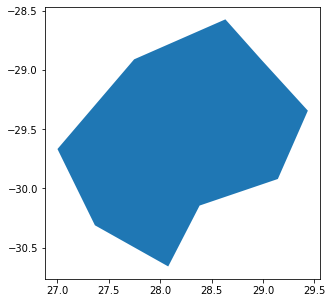


= Importing LSO 9 =


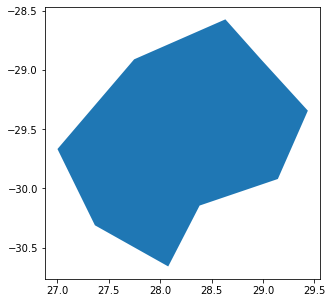


= Importing LTU 4 =


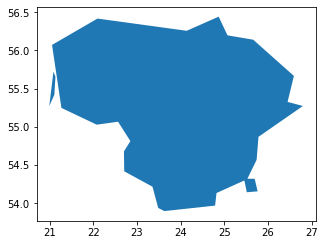


= Importing LTU 5 =


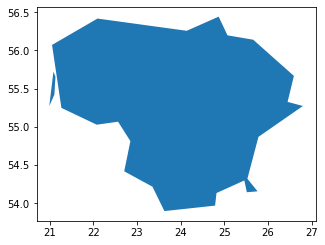


= Importing LTU 6 =


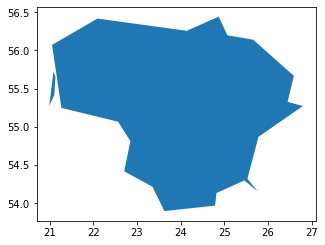


= Importing LTU 7 =


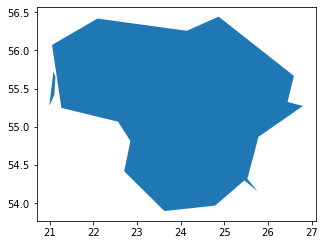


= Importing LTU 8 =


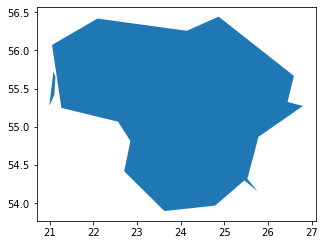


= Importing LTU 9 =


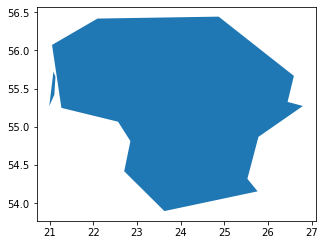


= Importing LUX 4 =


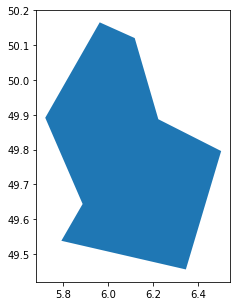


= Importing LUX 5 =


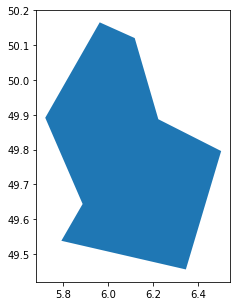


= Importing LUX 6 =


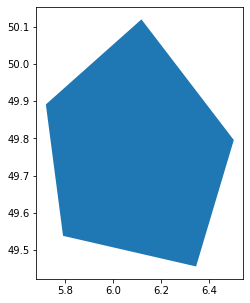


= Importing LUX 7 =


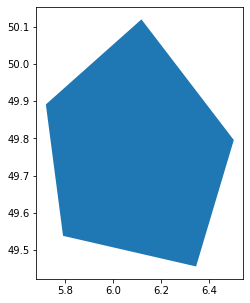


= Importing LUX 8 =


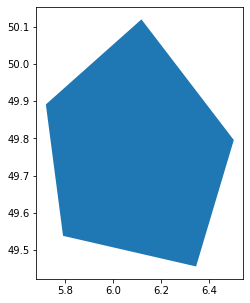


= Importing LUX 9 =


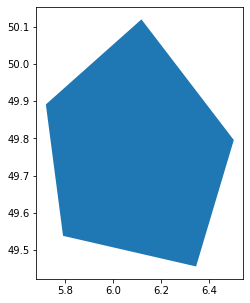


= Importing LVA 4 =


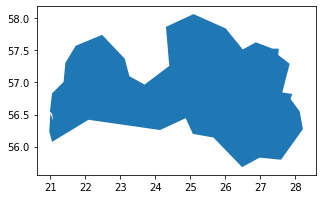


= Importing LVA 5 =


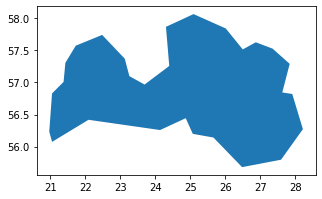


= Importing LVA 6 =


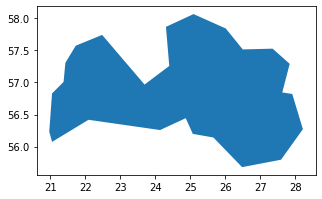


= Importing LVA 7 =


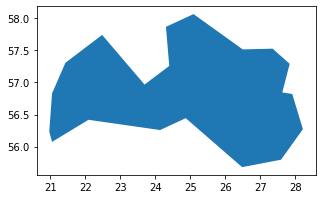


= Importing LVA 8 =


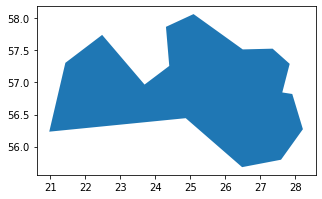


= Importing LVA 9 =


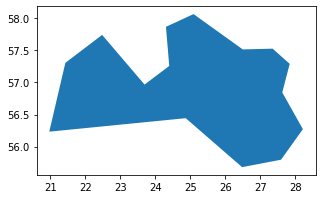


= Importing MAC 4 =


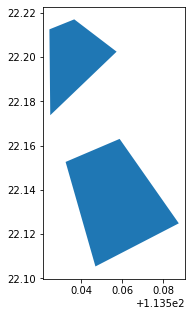


= Importing MAC 5 =


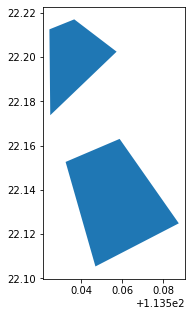


= Importing MAC 6 =


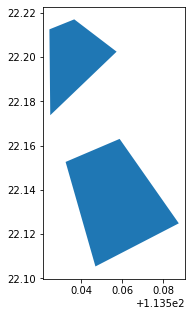


= Importing MAC 7 =


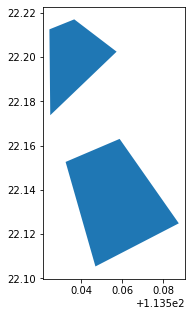


= Importing MAC 8 =


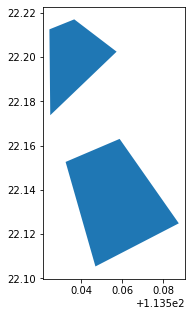


= Importing MAC 9 =


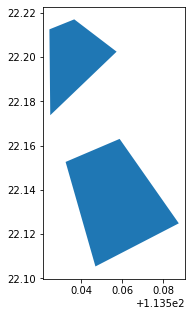


= Importing MAF 4 =


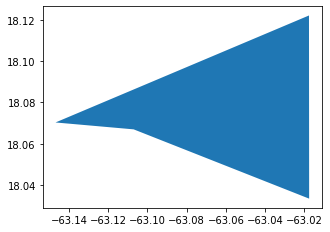


= Importing MAF 5 =


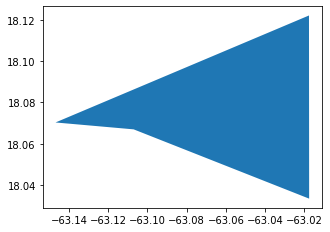


= Importing MAF 6 =


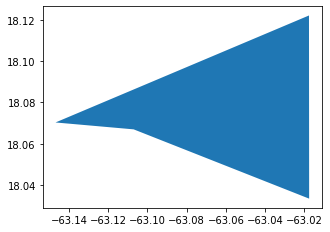


= Importing MAF 7 =


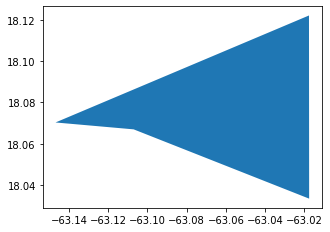


= Importing MAF 8 =


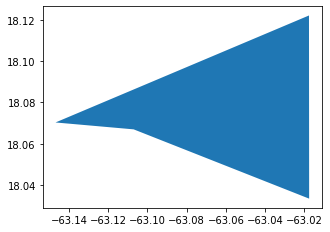


= Importing MAF 9 =


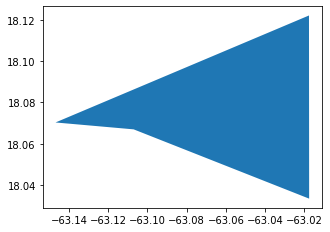


= Importing MAR 4 =


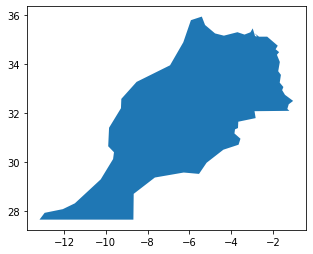


= Importing MAR 5 =


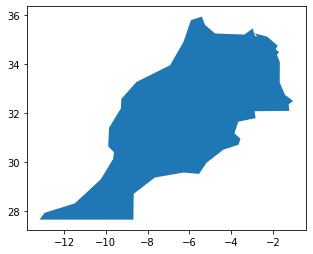


= Importing MAR 6 =


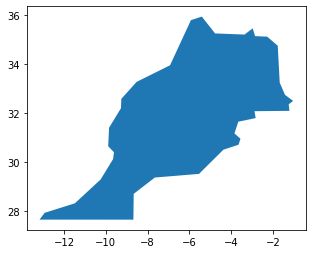


= Importing MAR 7 =


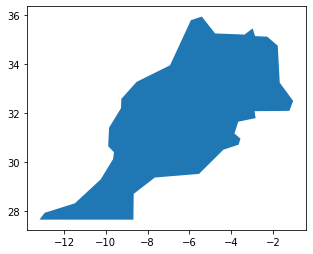


= Importing MAR 8 =


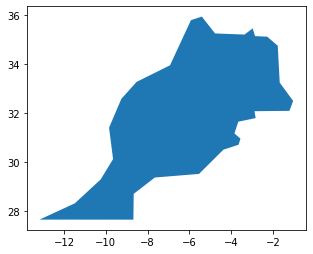


= Importing MAR 9 =


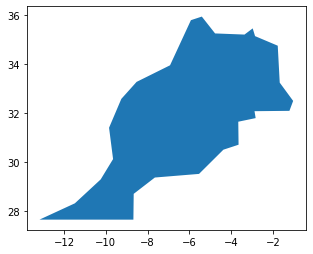


= Importing MCO 4 =


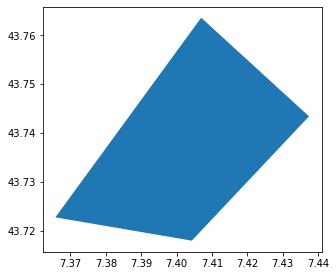


= Importing MCO 5 =


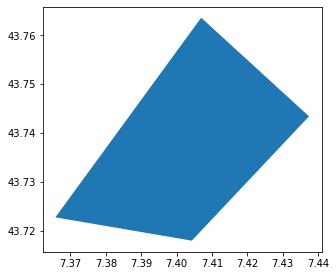


= Importing MCO 6 =


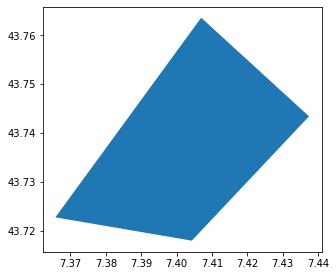


= Importing MCO 7 =


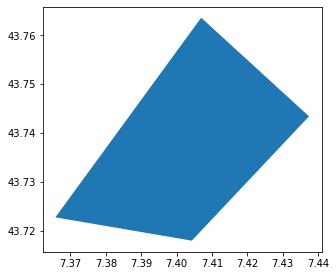


= Importing MCO 8 =


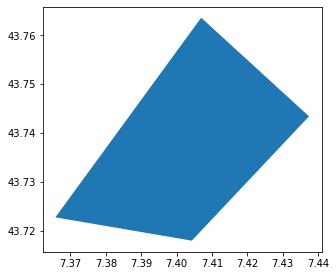


= Importing MCO 9 =


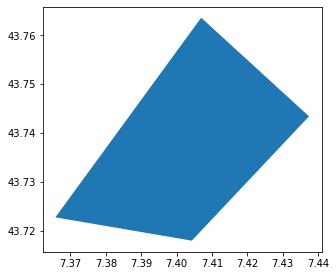


= Importing MDA 4 =


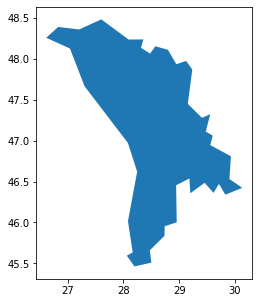


= Importing MDA 5 =


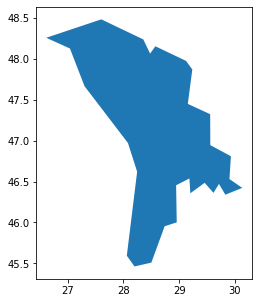


= Importing MDA 6 =


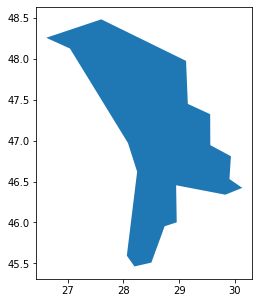


= Importing MDA 7 =


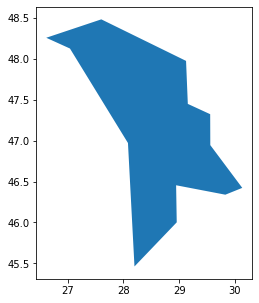


= Importing MDA 8 =


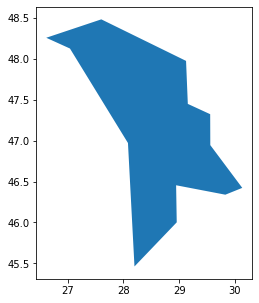


= Importing MDA 9 =


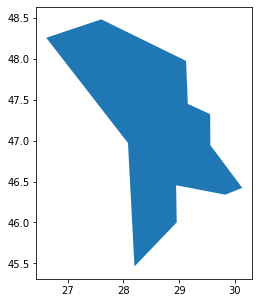


= Importing MDG 4 =


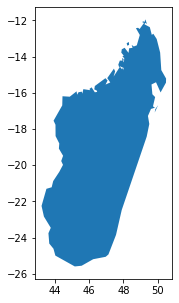


= Importing MDG 5 =


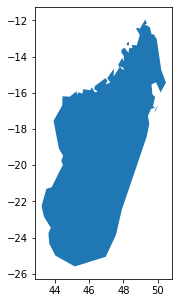


= Importing MDG 6 =


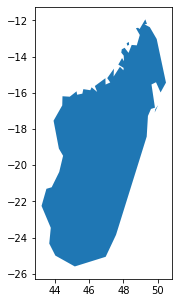


= Importing MDG 7 =


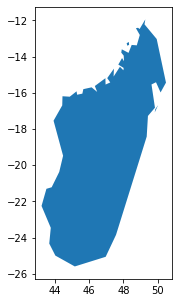


= Importing MDG 8 =


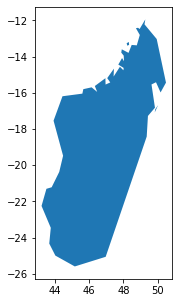


= Importing MDG 9 =


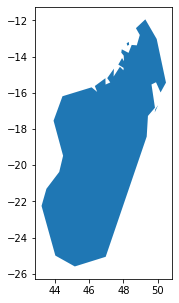


= Importing MDV 4 =


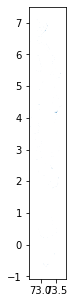


= Importing MDV 5 =


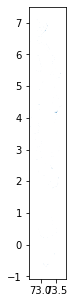


= Importing MDV 6 =


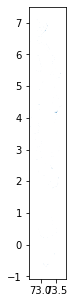


= Importing MDV 7 =


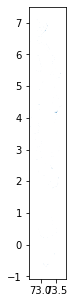


= Importing MDV 8 =


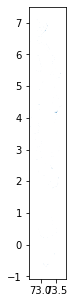


= Importing MDV 9 =


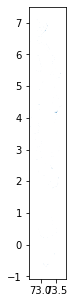


= Importing MEX 4 =


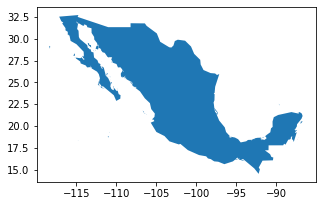


= Importing MEX 5 =


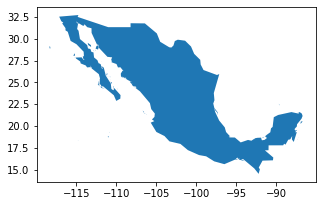


= Importing MEX 6 =


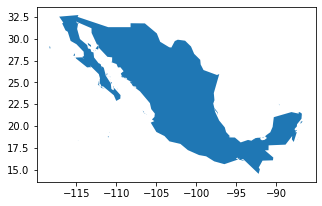


= Importing MEX 7 =


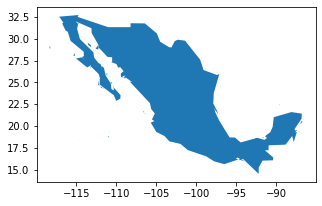


= Importing MEX 8 =


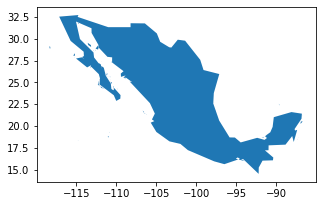


= Importing MEX 9 =


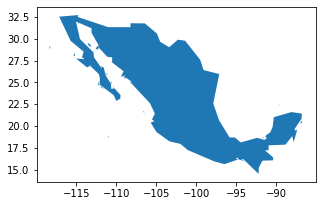


= Importing MHL 4 =


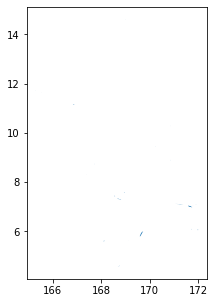


= Importing MHL 5 =


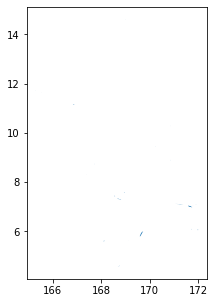


= Importing MHL 6 =


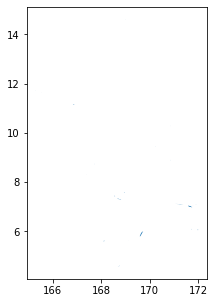


= Importing MHL 7 =


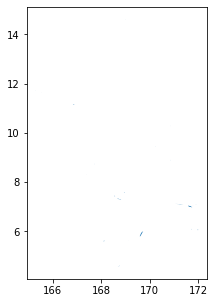


= Importing MHL 8 =


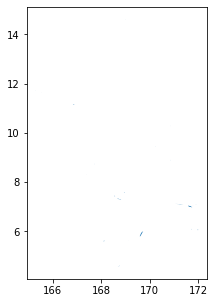


= Importing MHL 9 =


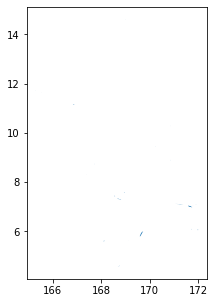


= Importing MKD 4 =


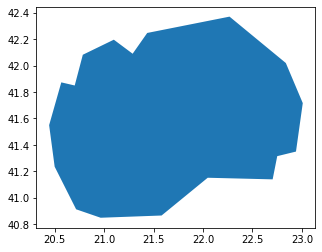


= Importing MKD 5 =


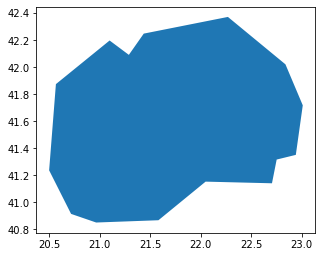


= Importing MKD 6 =


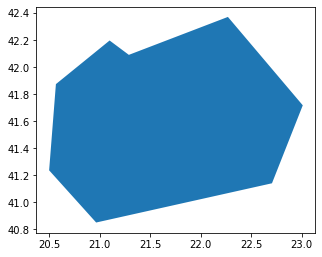


= Importing MKD 7 =


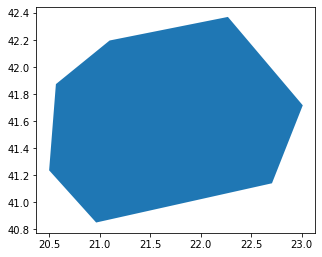


= Importing MKD 8 =


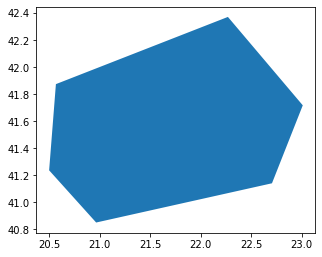


= Importing MKD 9 =


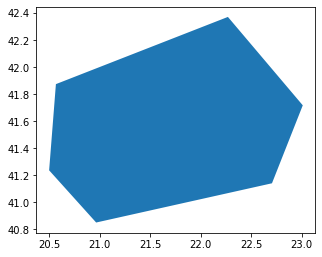


= Importing MLI 4 =


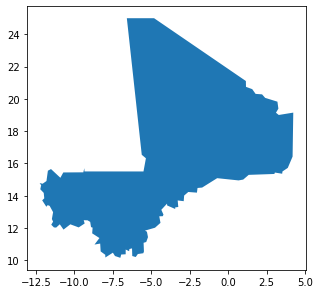


= Importing MLI 5 =


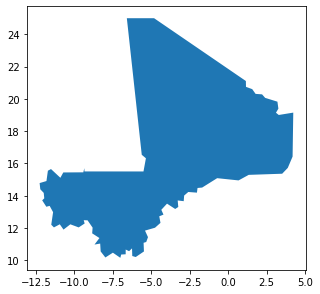


= Importing MLI 6 =


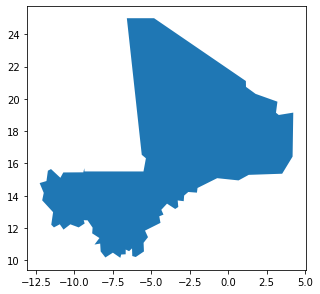


= Importing MLI 7 =


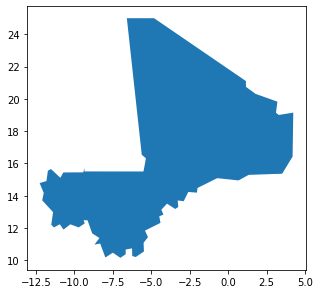


= Importing MLI 8 =


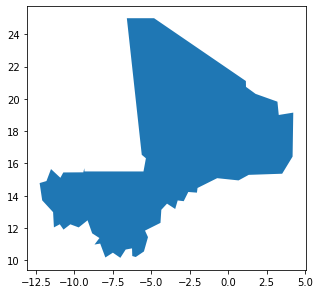


= Importing MLI 9 =


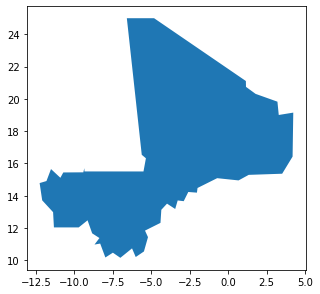


= Importing MLT 4 =


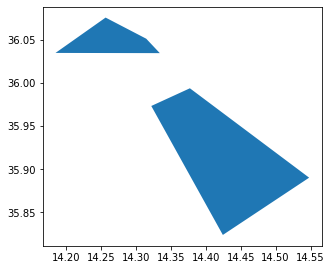


= Importing MLT 5 =


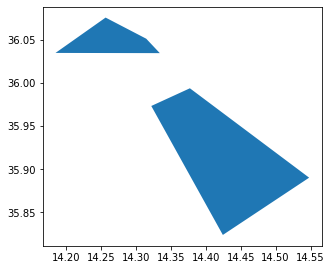


= Importing MLT 6 =


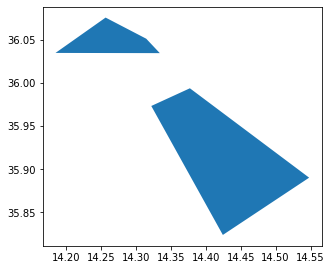


= Importing MLT 7 =


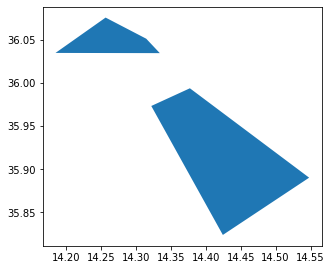


= Importing MLT 8 =


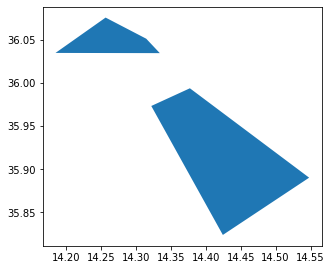


= Importing MLT 9 =


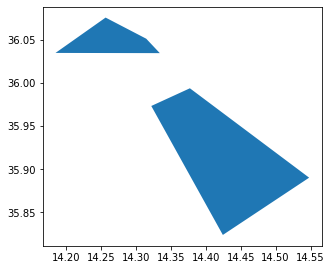


= Importing MMR 4 =


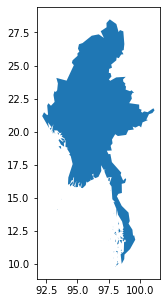


= Importing MMR 5 =


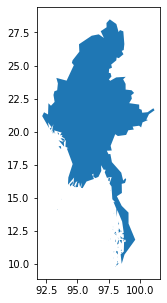


= Importing MMR 6 =


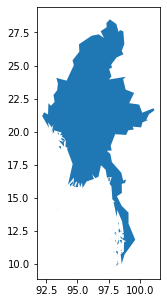


= Importing MMR 7 =


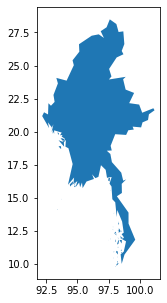


= Importing MMR 8 =


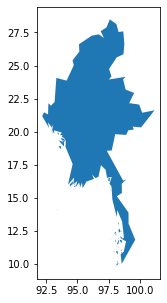


= Importing MMR 9 =


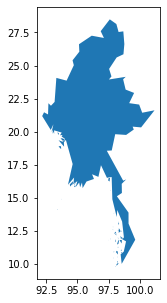


= Importing MNE 4 =


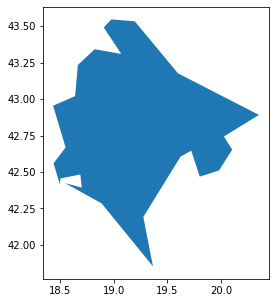


= Importing MNE 5 =


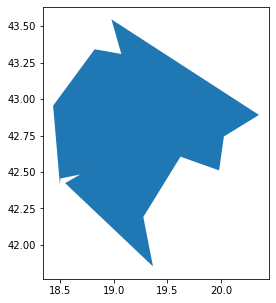


= Importing MNE 6 =


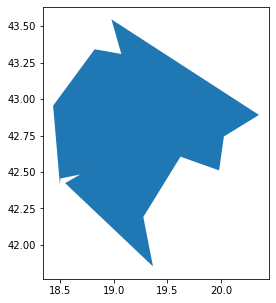


= Importing MNE 7 =


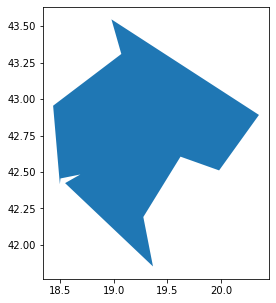


= Importing MNE 8 =


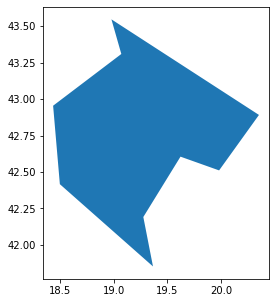


= Importing MNE 9 =


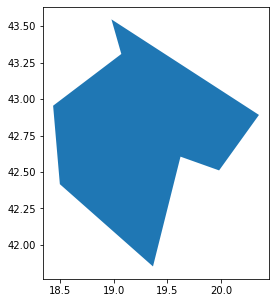


= Importing MNG 4 =


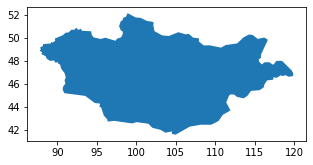


= Importing MNG 5 =


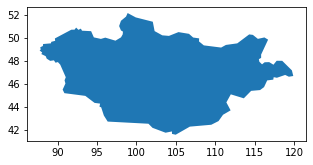


= Importing MNG 6 =


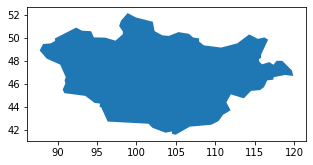


= Importing MNG 7 =


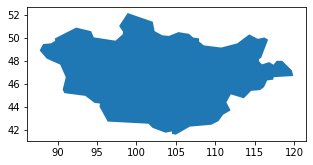


= Importing MNG 8 =


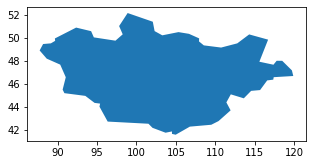


= Importing MNG 9 =


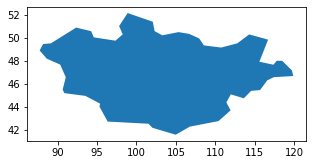


= Importing MNP 4 =


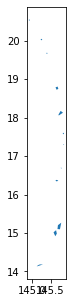


= Importing MNP 5 =


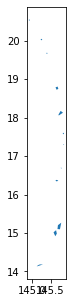


= Importing MNP 6 =


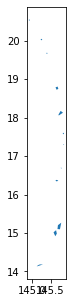


= Importing MNP 7 =


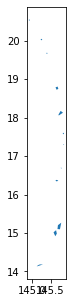


= Importing MNP 8 =


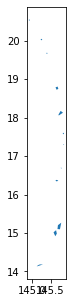


= Importing MNP 9 =


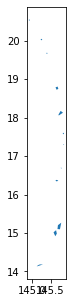


= Importing MOZ 4 =


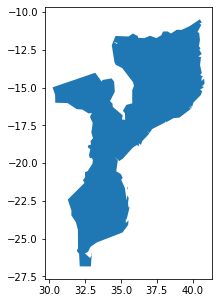


= Importing MOZ 5 =


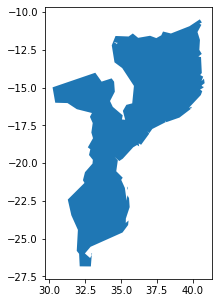


= Importing MOZ 6 =


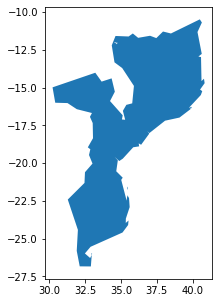


= Importing MOZ 7 =


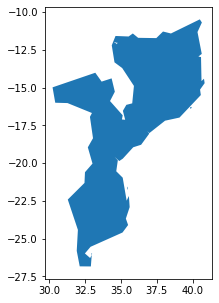


= Importing MOZ 8 =


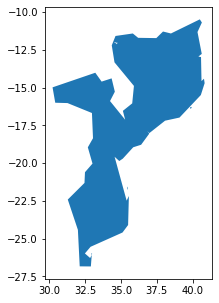


= Importing MOZ 9 =


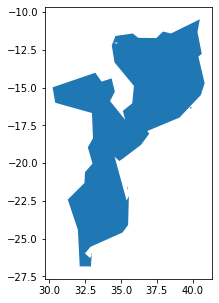


= Importing MRT 4 =


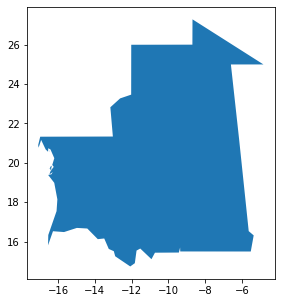


= Importing MRT 5 =


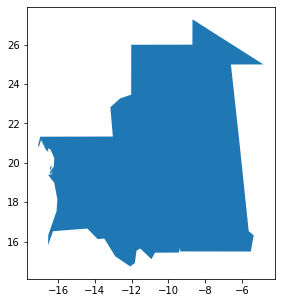


= Importing MRT 6 =


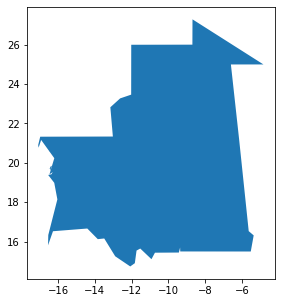


= Importing MRT 7 =


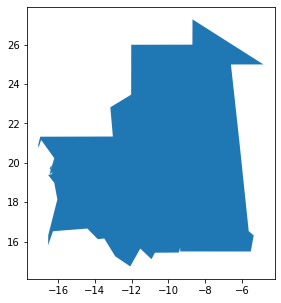


= Importing MRT 8 =


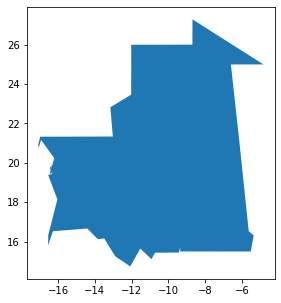


= Importing MRT 9 =


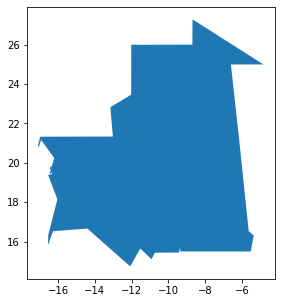


= Importing MSR 4 =


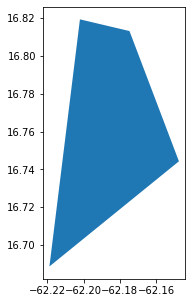


= Importing MSR 5 =


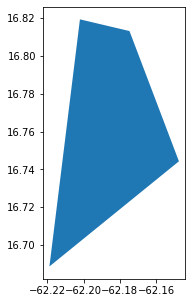


= Importing MSR 6 =


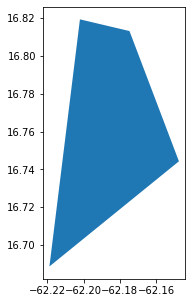


= Importing MSR 7 =


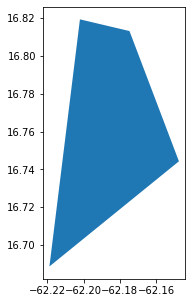


= Importing MSR 8 =


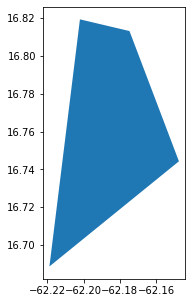


= Importing MSR 9 =


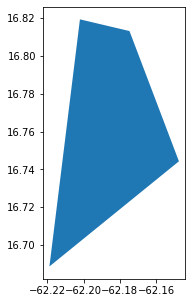


= Importing MUS 4 =


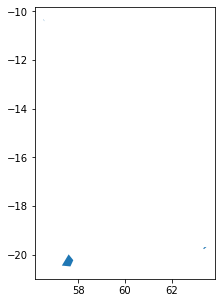


= Importing MUS 5 =


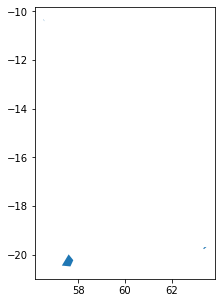


= Importing MUS 6 =


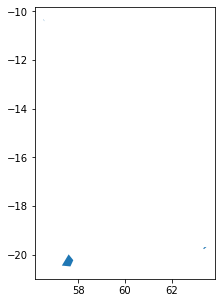


= Importing MUS 7 =


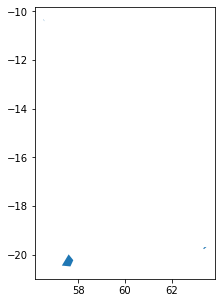


= Importing MUS 8 =


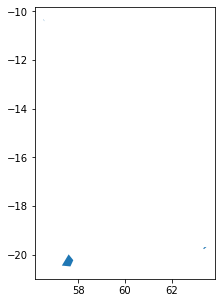


= Importing MUS 9 =


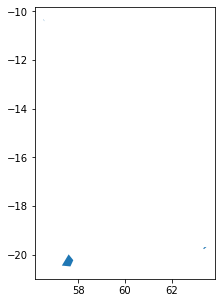


= Importing MWI 4 =


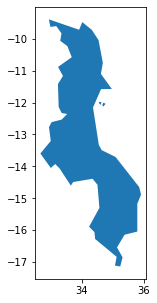


= Importing MWI 5 =


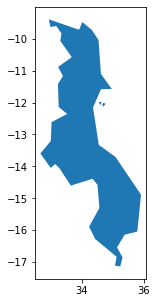


= Importing MWI 6 =


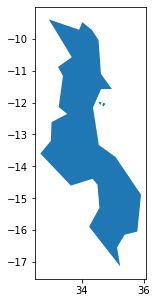


= Importing MWI 7 =


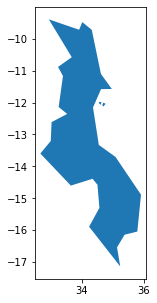


= Importing MWI 8 =


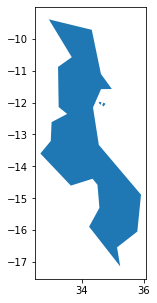


= Importing MWI 9 =


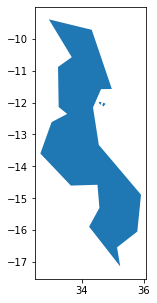


= Importing MYS 4 =


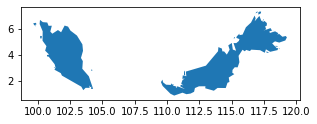


= Importing MYS 5 =


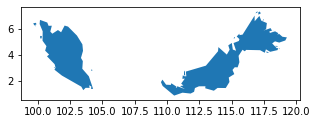


= Importing MYS 6 =


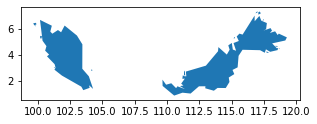


= Importing MYS 7 =


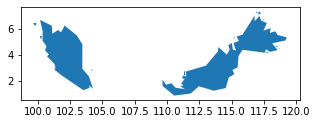


= Importing MYS 8 =


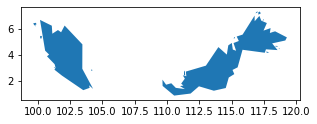


= Importing MYS 9 =


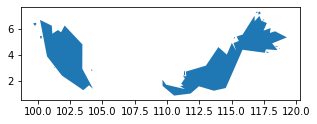


= Importing NAM 4 =


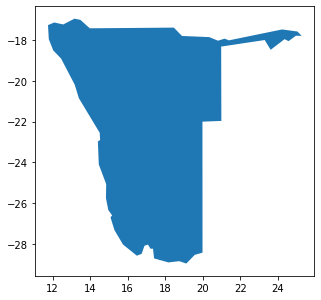


= Importing NAM 5 =


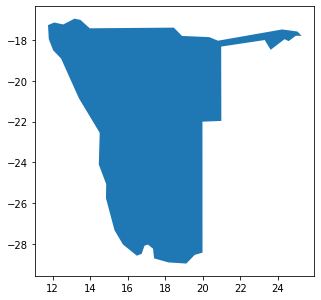


= Importing NAM 6 =


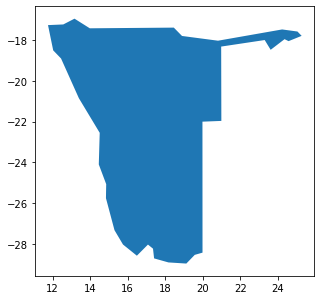


= Importing NAM 7 =


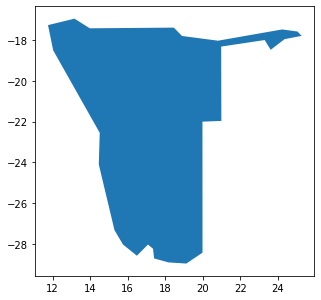


= Importing NAM 8 =


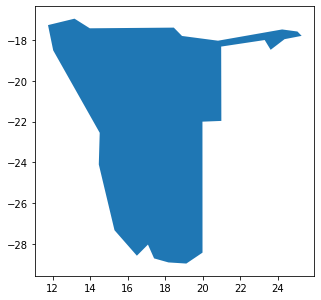


= Importing NAM 9 =


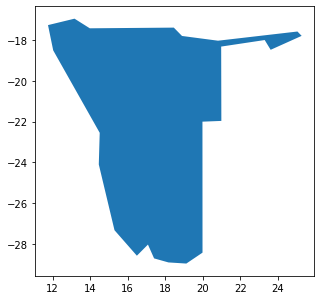


= Importing NCL 4 =


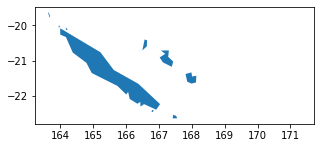


= Importing NCL 5 =


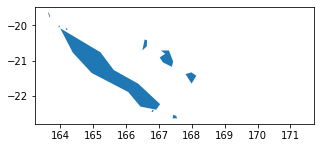


= Importing NCL 6 =


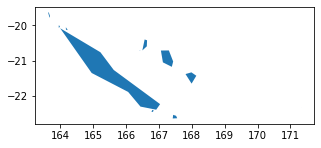


= Importing NCL 7 =


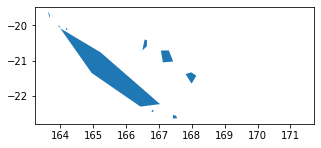


= Importing NCL 8 =


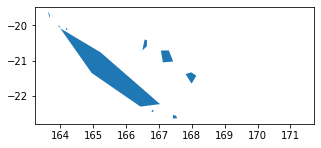


= Importing NCL 9 =


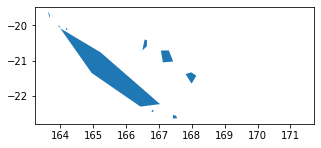


= Importing NER 4 =


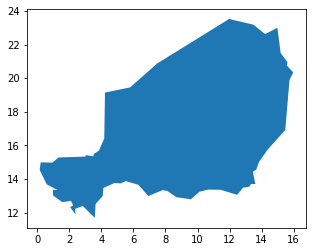


= Importing NER 5 =


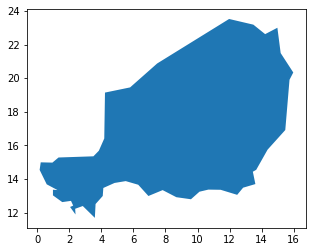


= Importing NER 6 =


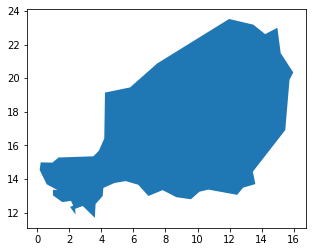


= Importing NER 7 =


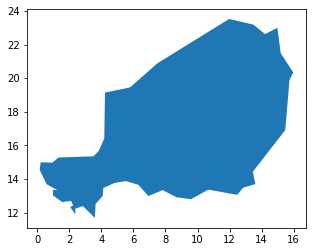


= Importing NER 8 =


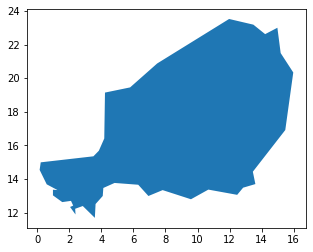


= Importing NER 9 =


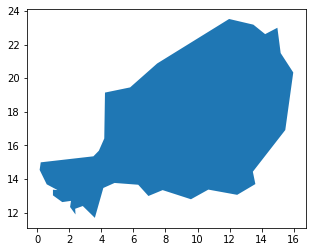


= Importing NFK 4 =


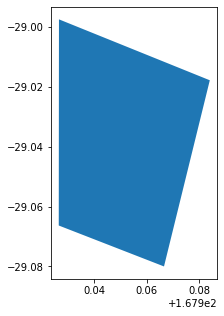


= Importing NFK 5 =


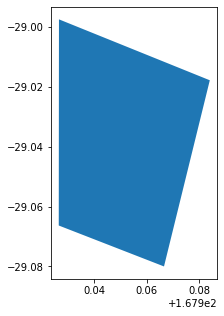


= Importing NFK 6 =


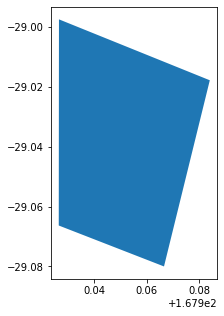


= Importing NFK 7 =


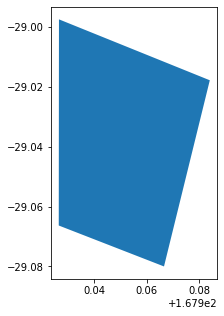


= Importing NFK 8 =


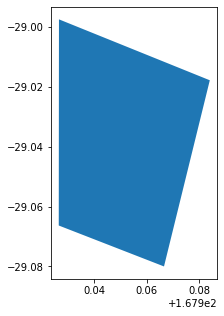


= Importing NFK 9 =


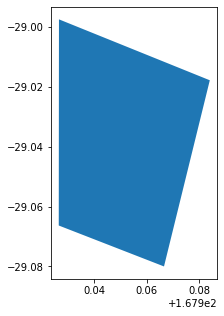


= Importing NGA 4 =


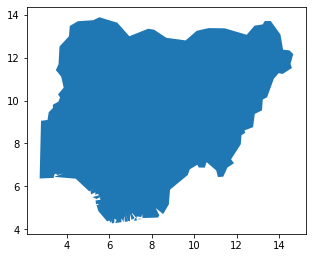


= Importing NGA 5 =


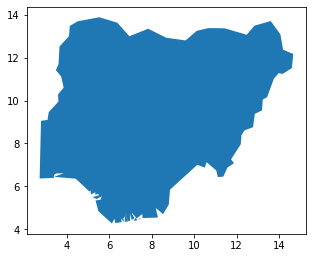


= Importing NGA 6 =


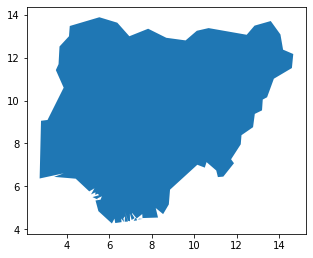


= Importing NGA 7 =


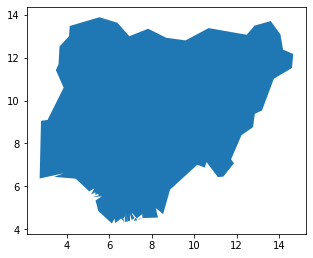


= Importing NGA 8 =


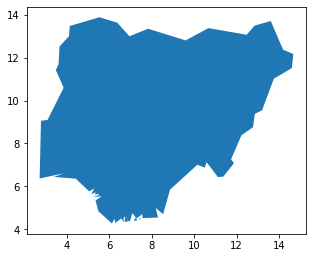


= Importing NGA 9 =


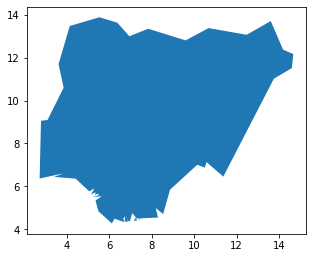


= Importing NIC 4 =


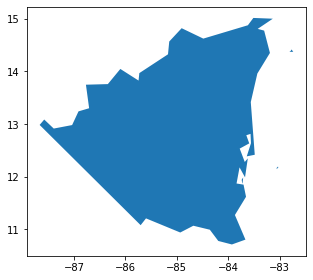


= Importing NIC 5 =


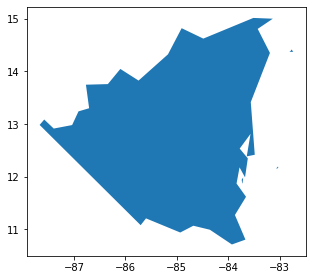


= Importing NIC 6 =


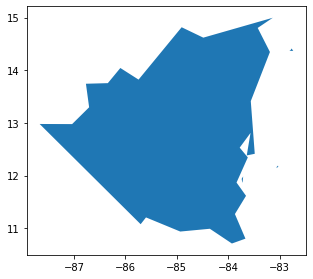


= Importing NIC 7 =


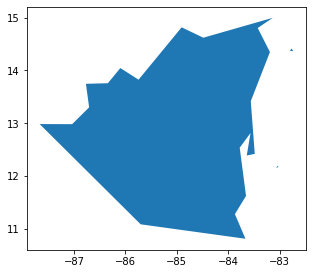


= Importing NIC 8 =


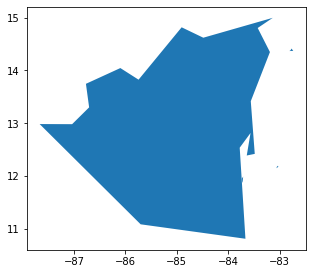


= Importing NIC 9 =


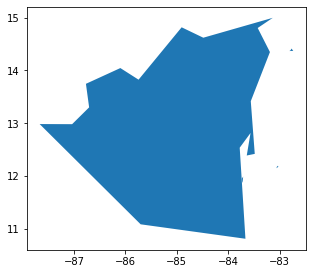


= Importing NIU 4 =


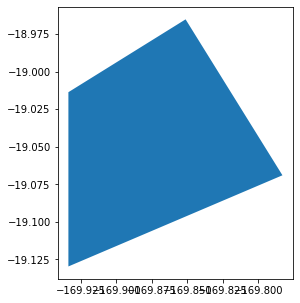


= Importing NIU 5 =


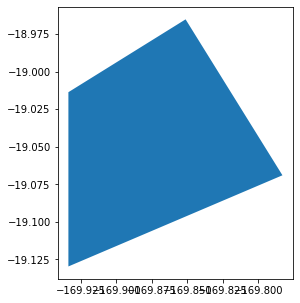


= Importing NIU 6 =


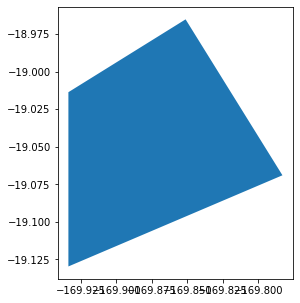


= Importing NIU 7 =


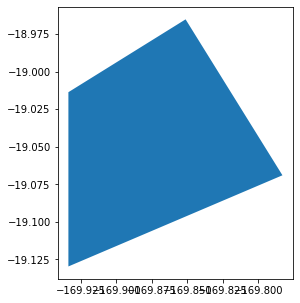


= Importing NIU 8 =


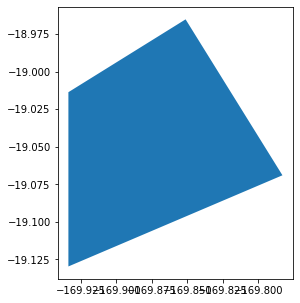


= Importing NIU 9 =


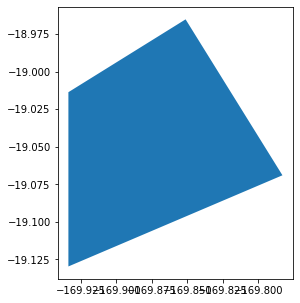


= Importing NLD 4 =


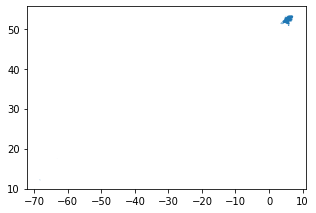


= Importing NLD 5 =


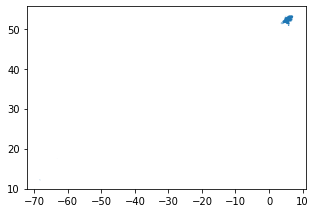


= Importing NLD 6 =


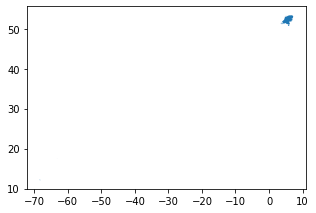


= Importing NLD 7 =


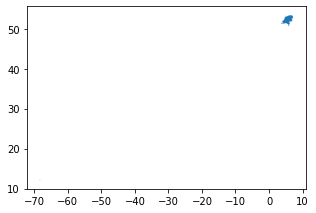


= Importing NLD 8 =


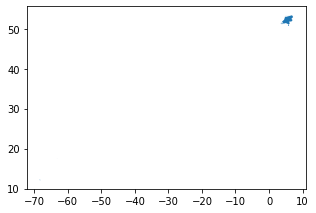


= Importing NLD 9 =


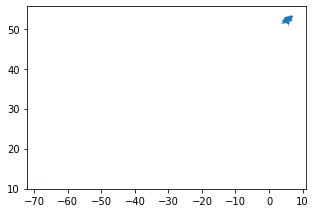


= Importing NOR 4 =


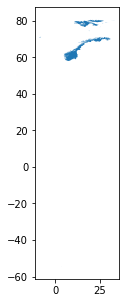


= Importing NOR 5 =


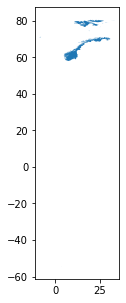


= Importing NOR 6 =


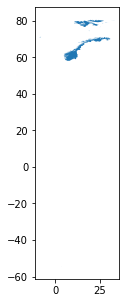


= Importing NOR 7 =


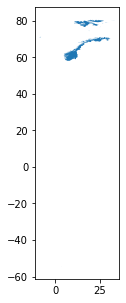


= Importing NOR 8 =


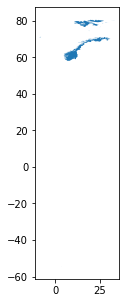


= Importing NOR 9 =


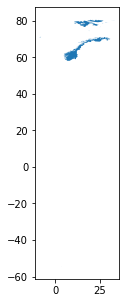


= Importing NPL 4 =


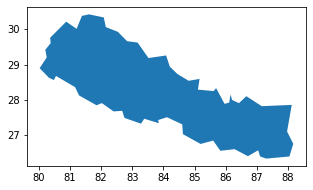


= Importing NPL 5 =


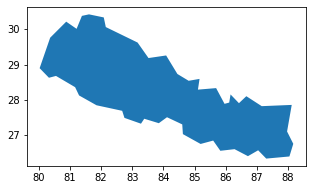


= Importing NPL 6 =


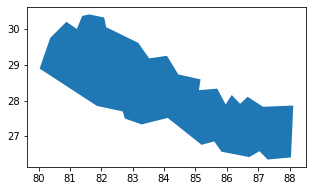


= Importing NPL 7 =


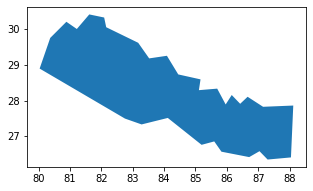


= Importing NPL 8 =


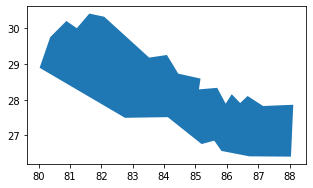


= Importing NPL 9 =


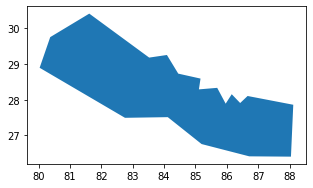


= Importing NRU 4 =


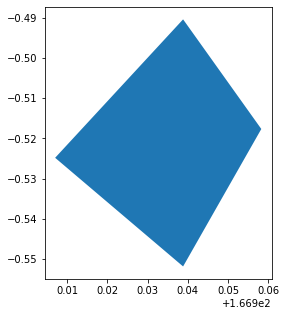


= Importing NRU 5 =


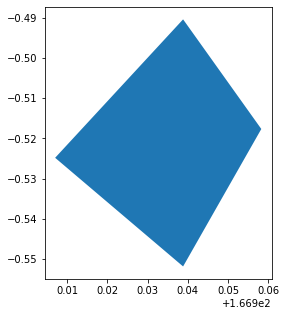


= Importing NRU 6 =


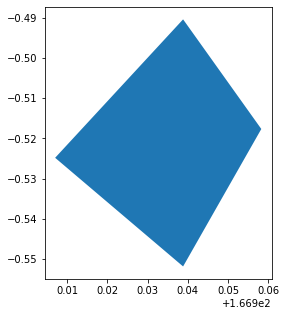


= Importing NRU 7 =


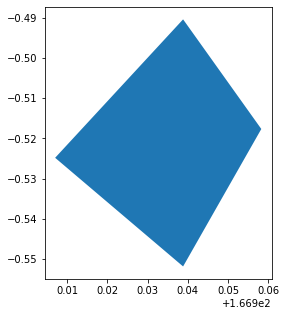


= Importing NRU 8 =


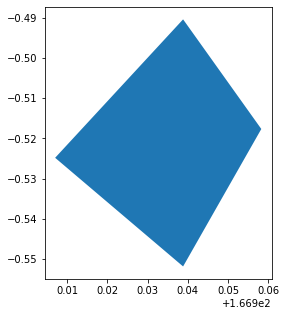


= Importing NRU 9 =


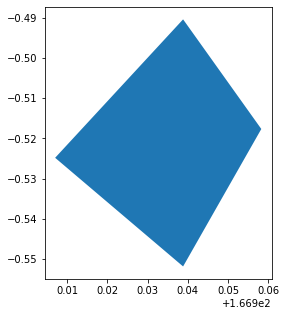


= Importing NZL 4 =


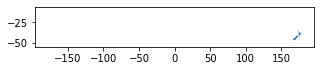


= Importing NZL 5 =


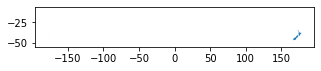


= Importing NZL 6 =


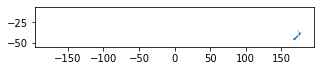


= Importing NZL 7 =


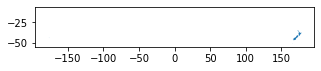


= Importing NZL 8 =


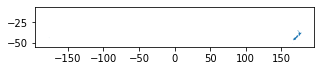


= Importing NZL 9 =


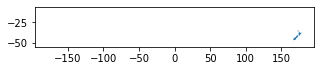


= Importing OMN 4 =


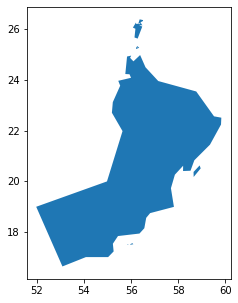


= Importing OMN 5 =


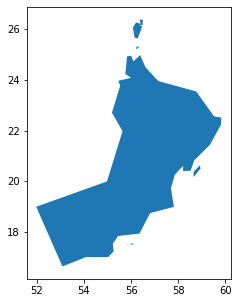


= Importing OMN 6 =


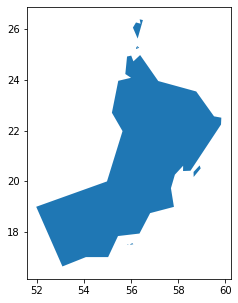


= Importing OMN 7 =


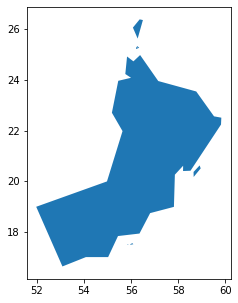


= Importing OMN 8 =


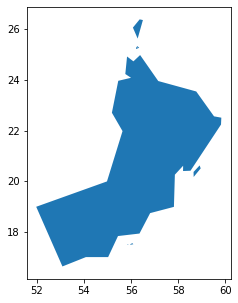


= Importing OMN 9 =


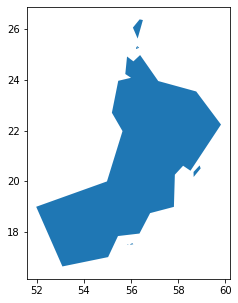


= Importing PAK 4 =


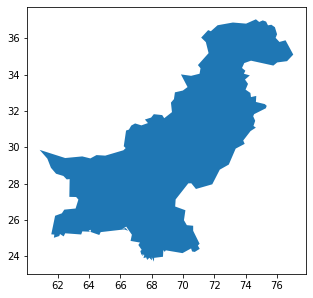


= Importing PAK 5 =


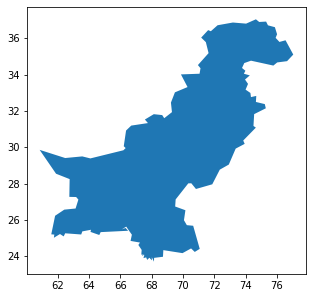


= Importing PAK 6 =


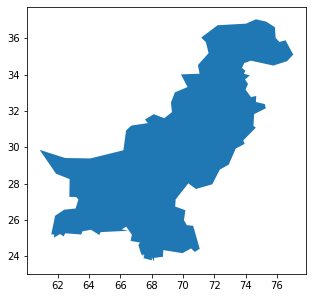


= Importing PAK 7 =


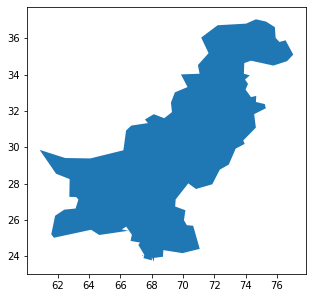


= Importing PAK 8 =


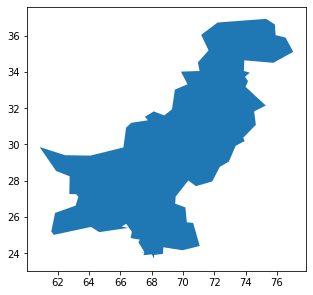


= Importing PAK 9 =


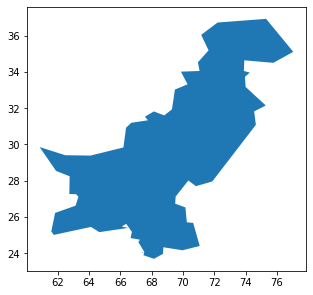


= Importing PAN 4 =


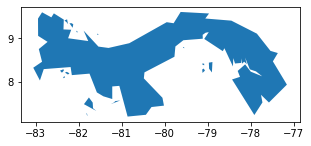


= Importing PAN 5 =


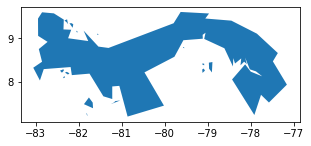


= Importing PAN 6 =


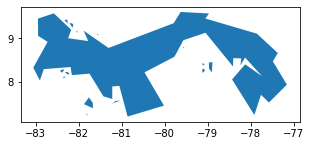


= Importing PAN 7 =


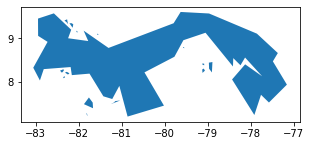


= Importing PAN 8 =


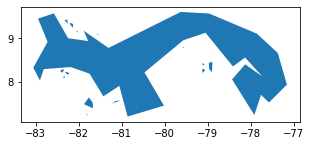


= Importing PAN 9 =


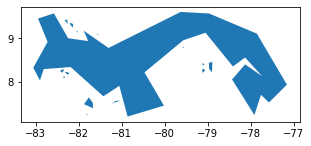


= Importing PCN 4 =


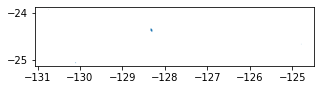


= Importing PCN 5 =


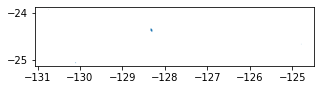


= Importing PCN 6 =


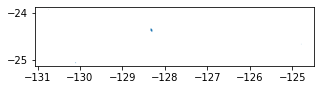


= Importing PCN 7 =


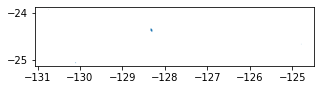


= Importing PCN 8 =


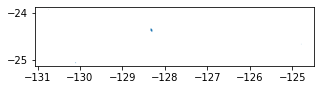


= Importing PCN 9 =


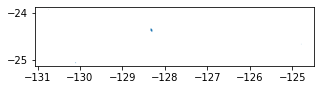


= Importing PER 4 =


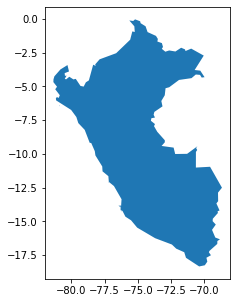


= Importing PER 5 =


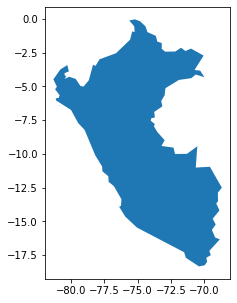


= Importing PER 6 =


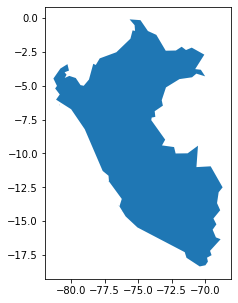


= Importing PER 7 =


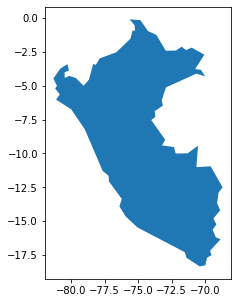


= Importing PER 8 =


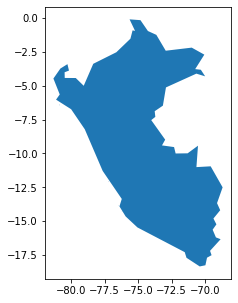


= Importing PER 9 =


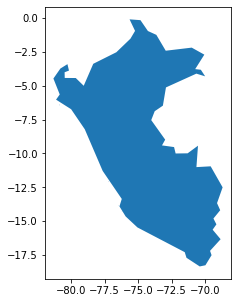


= Importing PHL 4 =


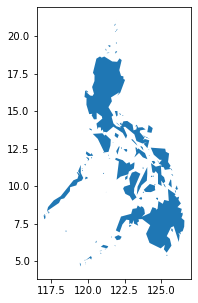


= Importing PHL 5 =


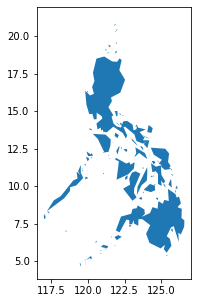


= Importing PHL 6 =


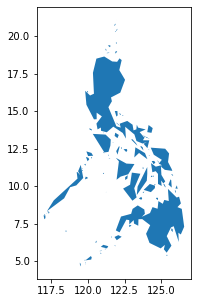


= Importing PHL 7 =


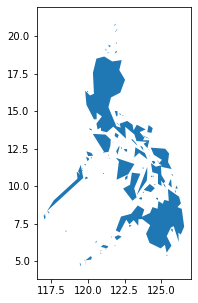


= Importing PHL 8 =


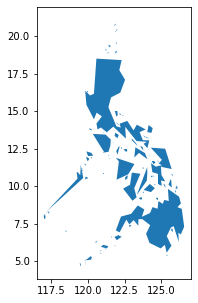


= Importing PHL 9 =


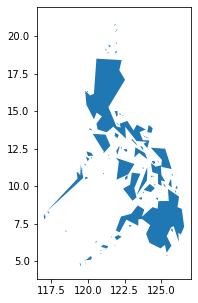


= Importing PLW 4 =


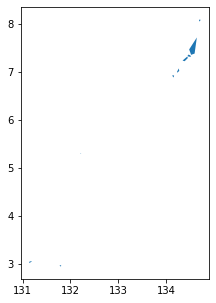


= Importing PLW 5 =


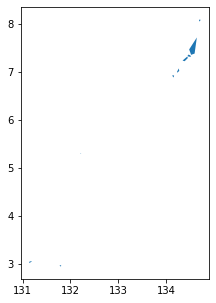


= Importing PLW 6 =


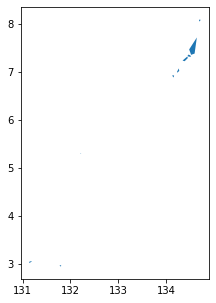


= Importing PLW 7 =


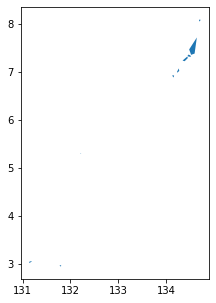


= Importing PLW 8 =


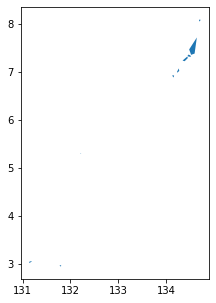


= Importing PLW 9 =


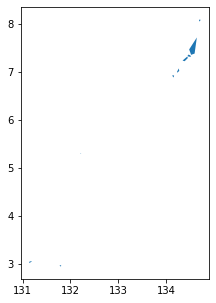


= Importing PNG 4 =


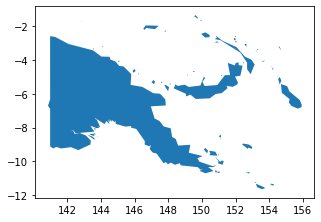


= Importing PNG 5 =


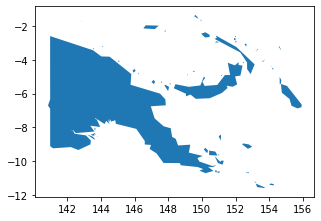


= Importing PNG 6 =


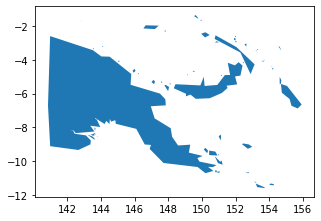


= Importing PNG 7 =


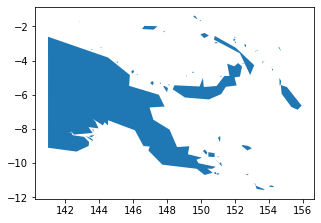


= Importing PNG 8 =


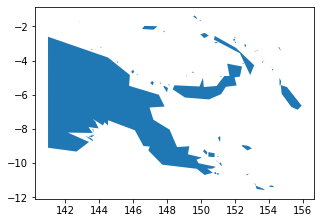


= Importing PNG 9 =


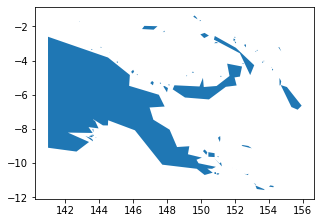


= Importing POL 4 =


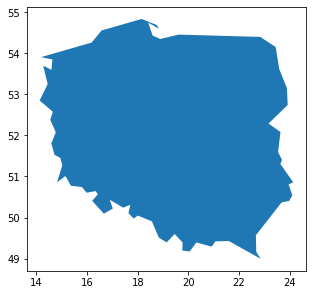


= Importing POL 5 =


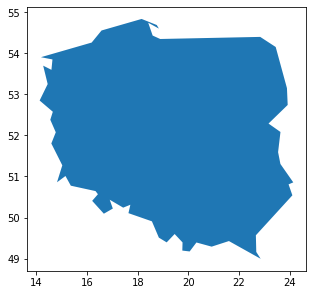


= Importing POL 6 =


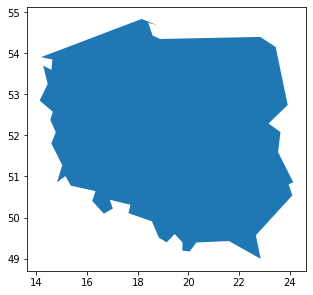


= Importing POL 7 =


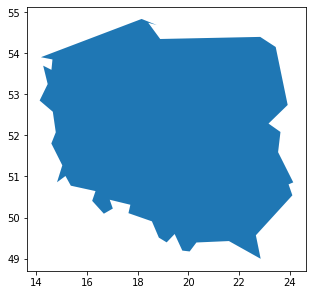


= Importing POL 8 =


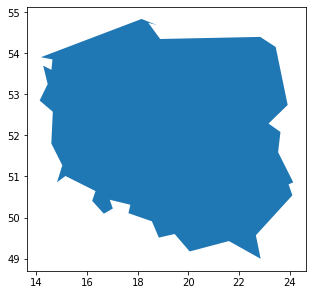


= Importing POL 9 =


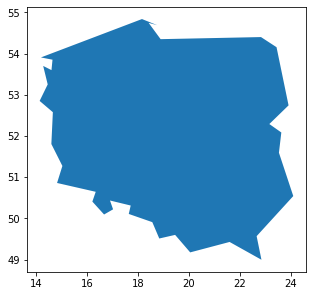


= Importing PRI 4 =


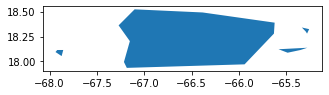


= Importing PRI 5 =


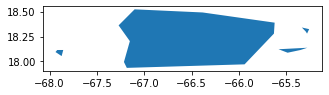


= Importing PRI 6 =


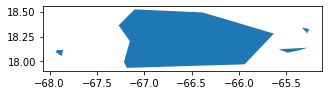


= Importing PRI 7 =


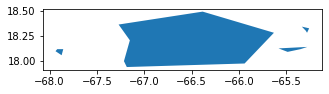


= Importing PRI 8 =


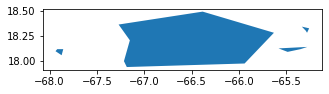


= Importing PRI 9 =


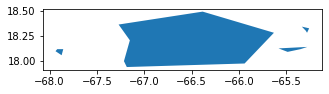


= Importing PRK 4 =


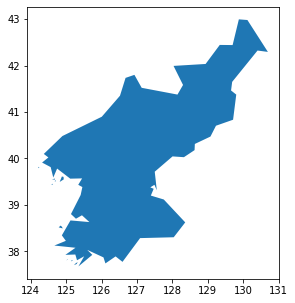


= Importing PRK 5 =


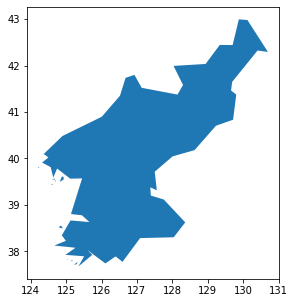


= Importing PRK 6 =


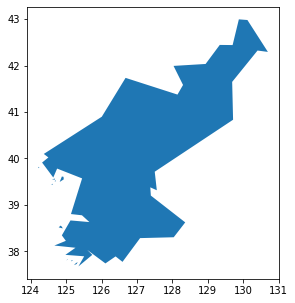


= Importing PRK 7 =


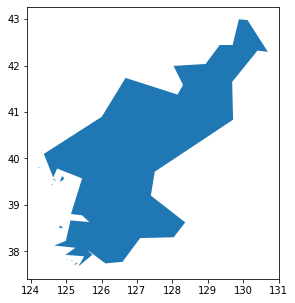


= Importing PRK 8 =


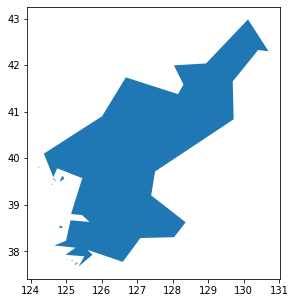


= Importing PRK 9 =


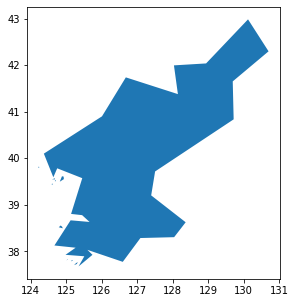


= Importing PRT 4 =


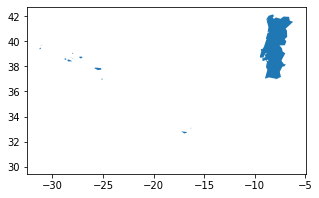


= Importing PRT 5 =


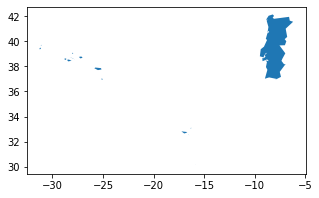


= Importing PRT 6 =


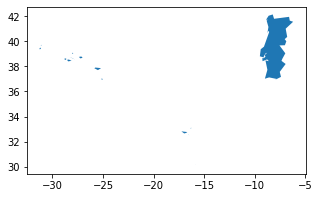


= Importing PRT 7 =


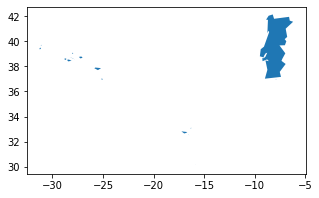


= Importing PRT 8 =


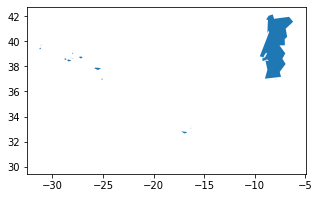


= Importing PRT 9 =


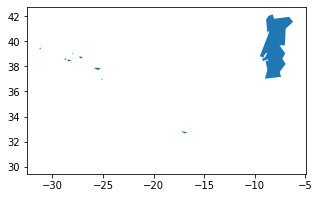


= Importing PRY 4 =


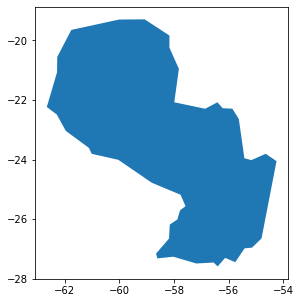


= Importing PRY 5 =


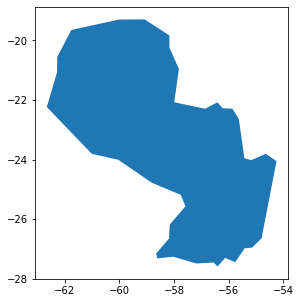


= Importing PRY 6 =


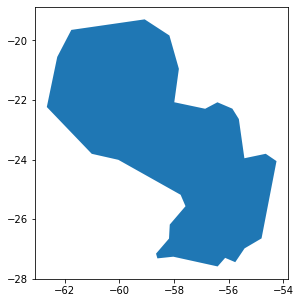


= Importing PRY 7 =


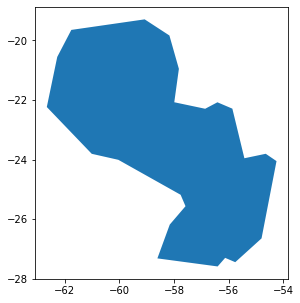


= Importing PRY 8 =


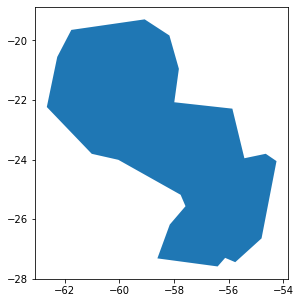


= Importing PRY 9 =


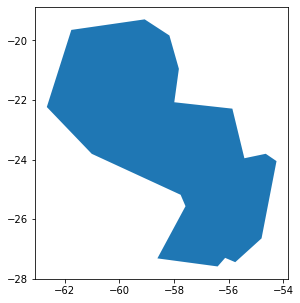


= Importing PSE 4 =


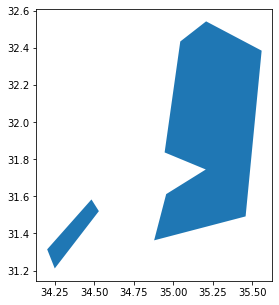


= Importing PSE 5 =


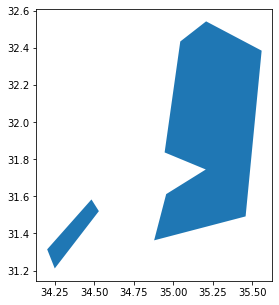


= Importing PSE 6 =


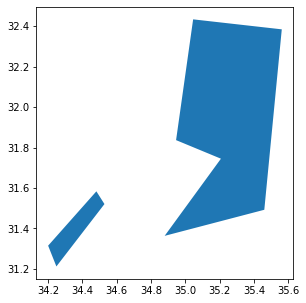


= Importing PSE 7 =


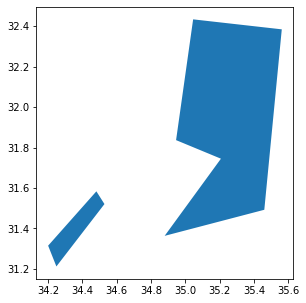


= Importing PSE 8 =


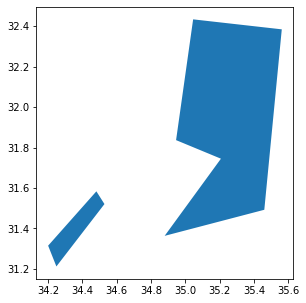


= Importing PSE 9 =


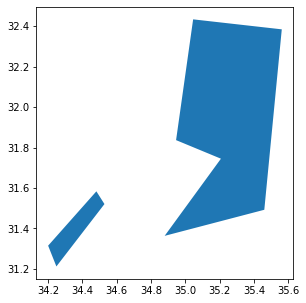


= Importing PYF 4 =


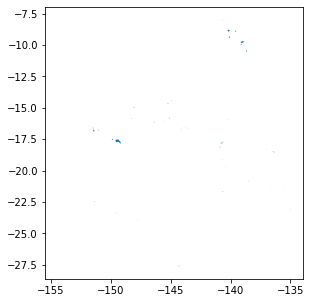


= Importing PYF 5 =


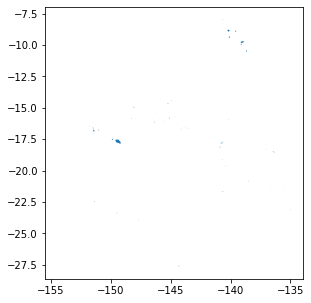


= Importing PYF 6 =


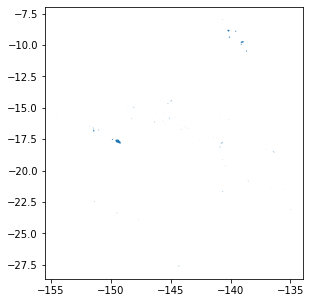


= Importing PYF 7 =


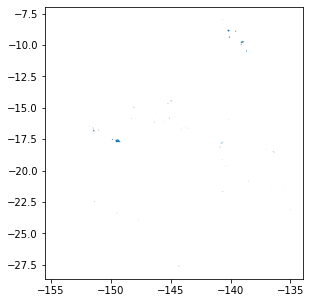


= Importing PYF 8 =


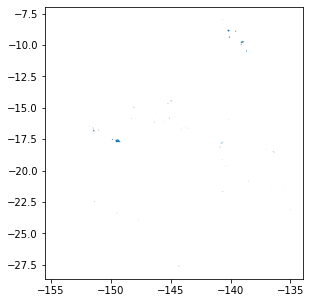


= Importing PYF 9 =


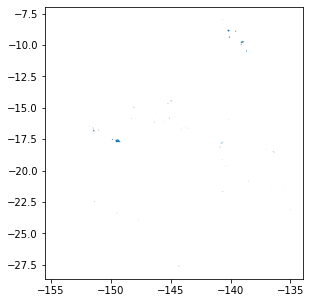


= Importing QAT 4 =


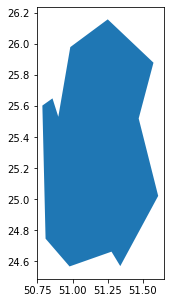


= Importing QAT 5 =


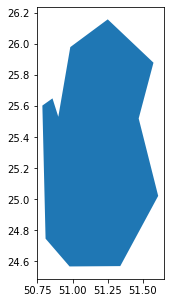


= Importing QAT 6 =


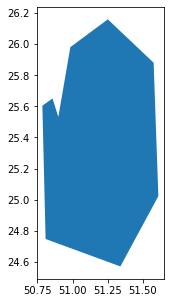


= Importing QAT 7 =


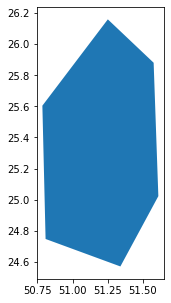


= Importing QAT 8 =


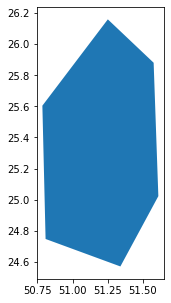


= Importing QAT 9 =


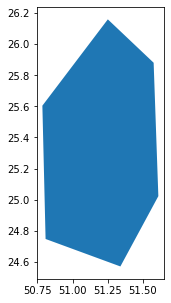


= Importing ROU 4 =


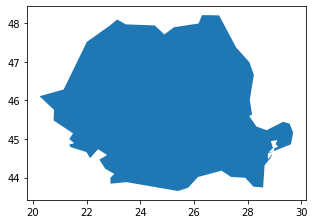


= Importing ROU 5 =


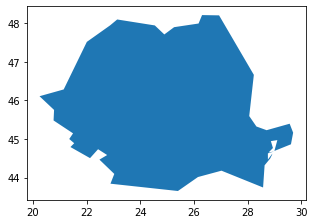


= Importing ROU 6 =


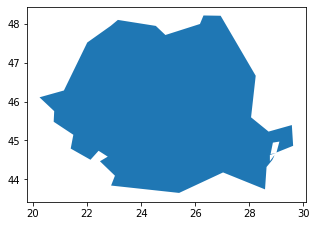


= Importing ROU 7 =


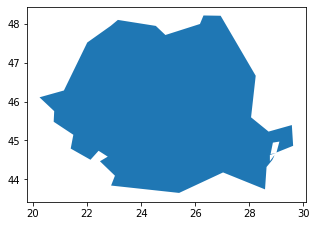


= Importing ROU 8 =


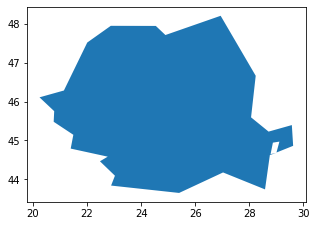


= Importing ROU 9 =


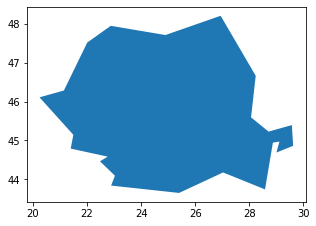


= Importing RUS 4 =


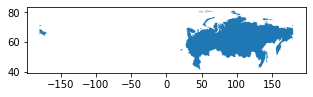


= Importing RUS 5 =


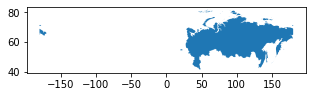


= Importing RUS 6 =


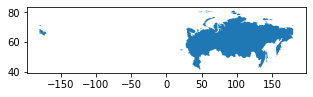


= Importing RUS 7 =


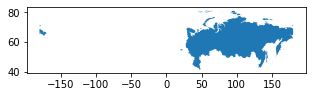


= Importing RUS 8 =


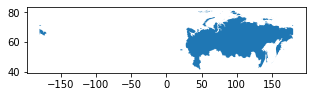


= Importing RUS 9 =


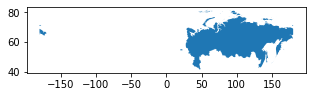


= Importing RWA 4 =


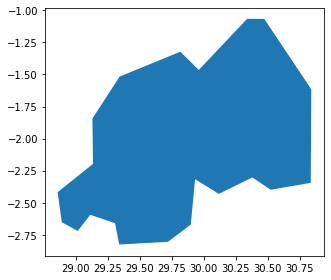


= Importing RWA 5 =


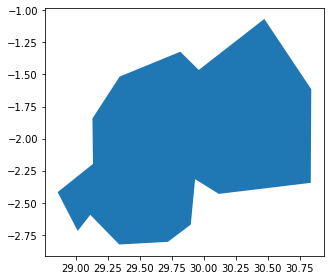


= Importing RWA 6 =


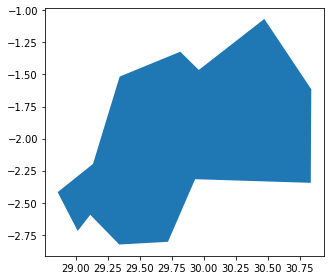


= Importing RWA 7 =


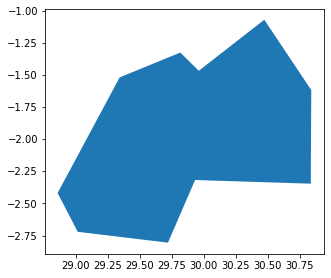


= Importing RWA 8 =


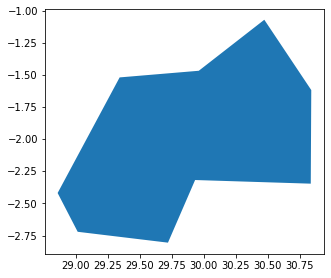


= Importing RWA 9 =


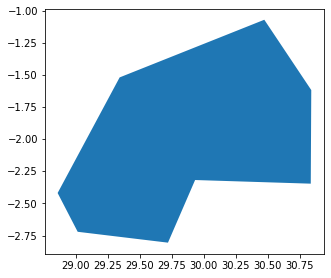


= Importing SAU 4 =


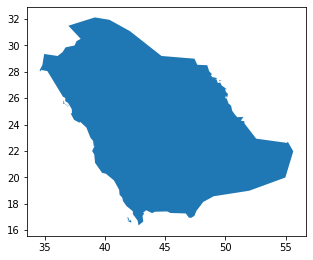


= Importing SAU 5 =


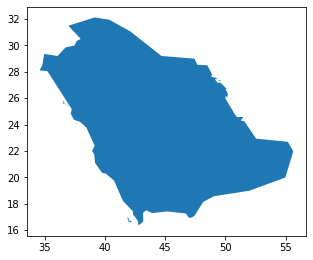


= Importing SAU 6 =


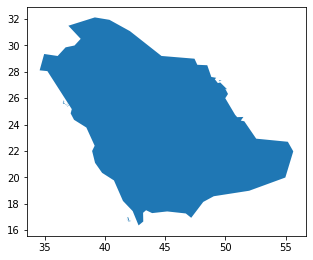


= Importing SAU 7 =


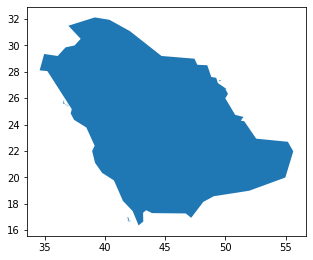


= Importing SAU 8 =


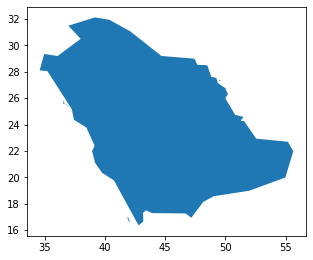


= Importing SAU 9 =


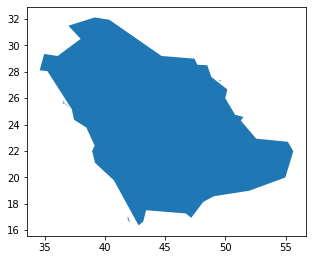


= Importing SDN 4 =


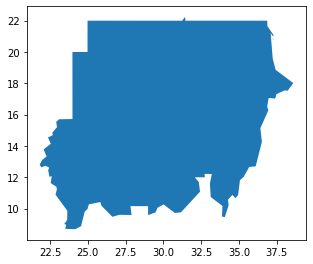


= Importing SDN 5 =


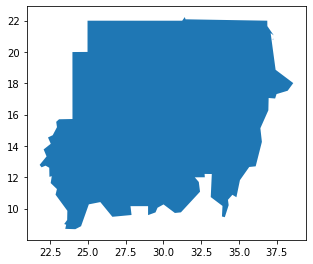


= Importing SDN 6 =


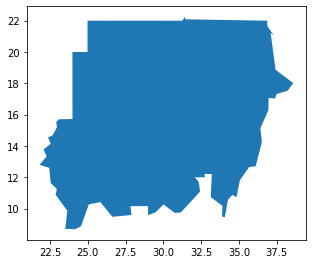


= Importing SDN 7 =


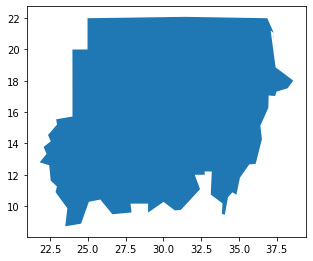


= Importing SDN 8 =


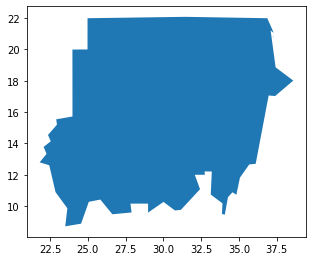


= Importing SDN 9 =


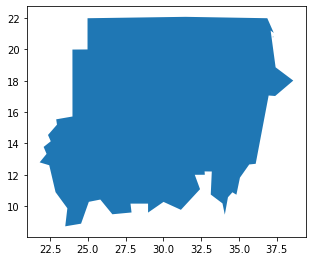


= Importing SEN 4 =


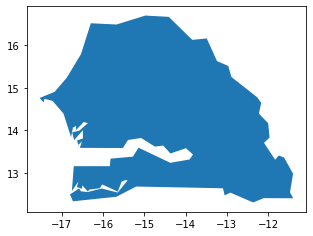


= Importing SEN 5 =


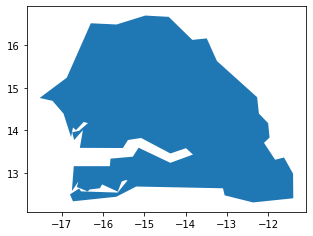


= Importing SEN 6 =


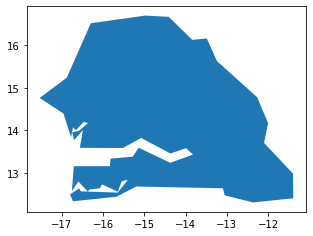


= Importing SEN 7 =


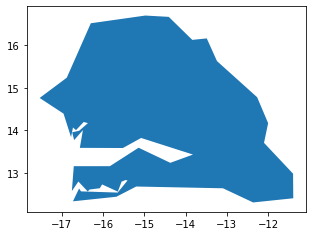


= Importing SEN 8 =


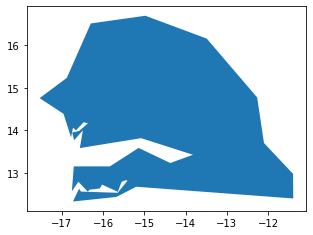


= Importing SEN 9 =


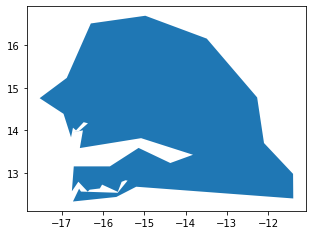


= Importing SGP 4 =


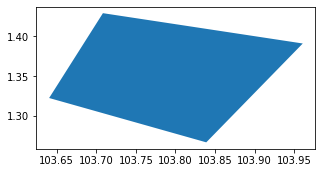


= Importing SGP 5 =


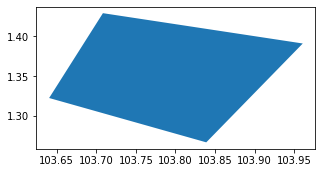


= Importing SGP 6 =


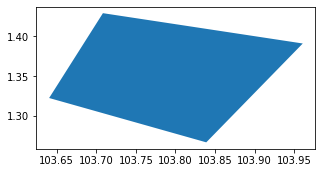


= Importing SGP 7 =


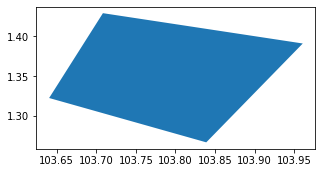


= Importing SGP 8 =


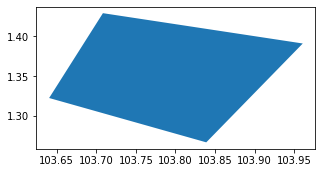


= Importing SGP 9 =


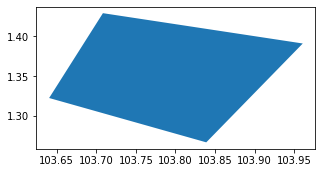


= Importing SGS 4 =


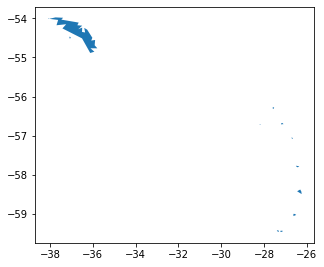


= Importing SGS 5 =


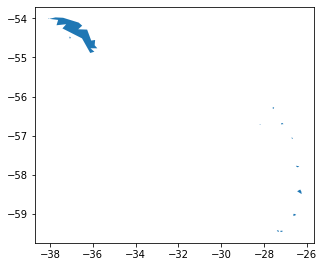


= Importing SGS 6 =


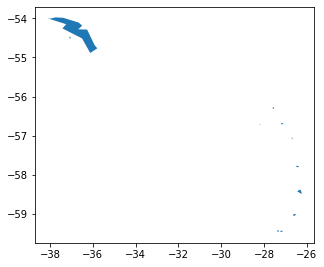


= Importing SGS 7 =


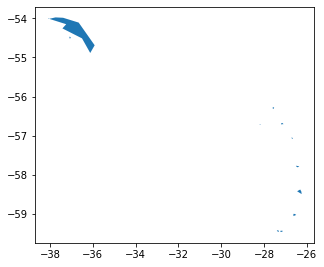


= Importing SGS 8 =


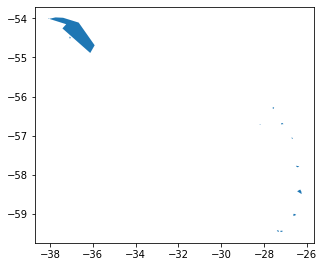


= Importing SGS 9 =


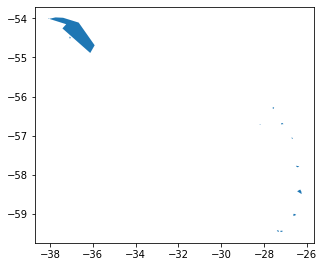


= Importing SHN 4 =


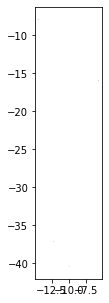


= Importing SHN 5 =


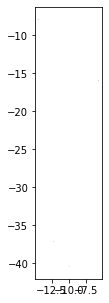


= Importing SHN 6 =


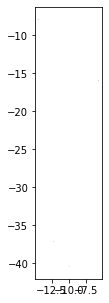


= Importing SHN 7 =


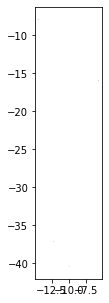


= Importing SHN 8 =


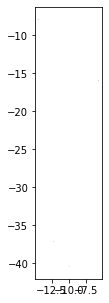


= Importing SHN 9 =


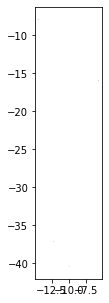


= Importing SLB 4 =


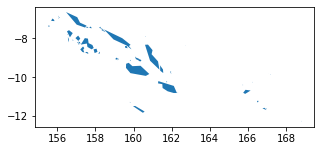


= Importing SLB 5 =


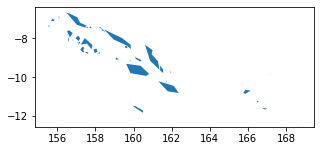


= Importing SLB 6 =


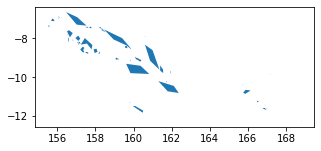


= Importing SLB 7 =


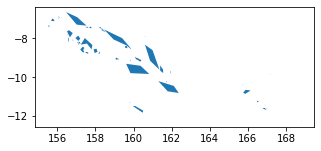


= Importing SLB 8 =


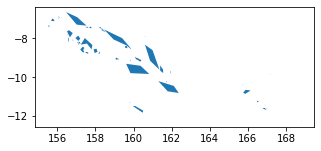


= Importing SLB 9 =


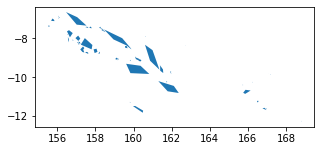


= Importing SLE 4 =


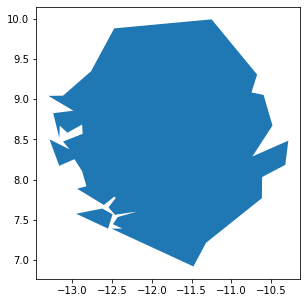


= Importing SLE 5 =


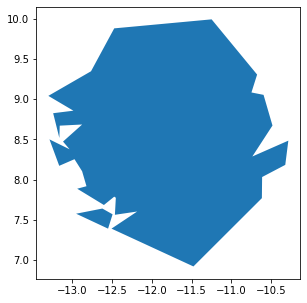


= Importing SLE 6 =


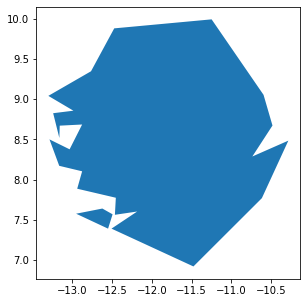


= Importing SLE 7 =


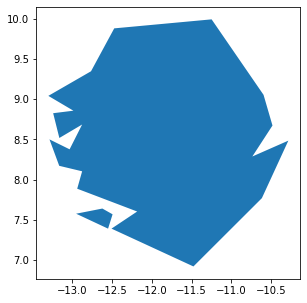


= Importing SLE 8 =


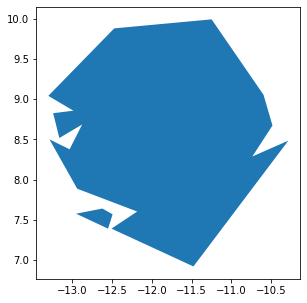


= Importing SLE 9 =


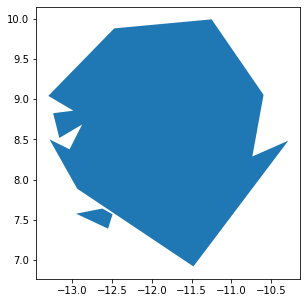


= Importing SLV 4 =


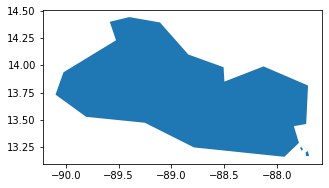


= Importing SLV 5 =


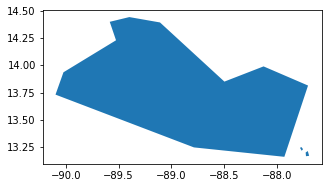


= Importing SLV 6 =


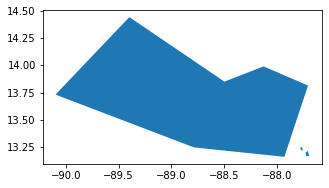


= Importing SLV 7 =


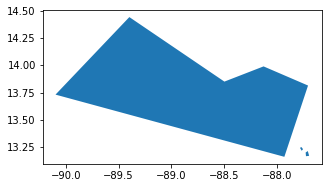


= Importing SLV 8 =


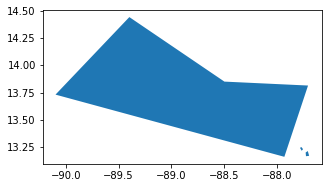


= Importing SLV 9 =


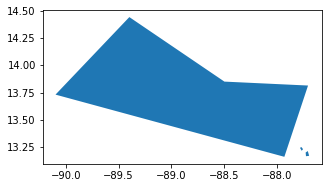


= Importing SMR 4 =


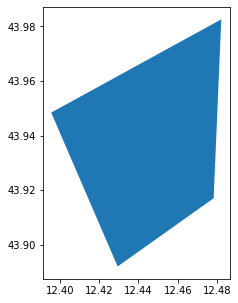


= Importing SMR 5 =


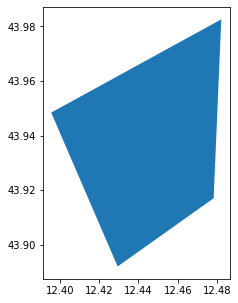


= Importing SMR 6 =


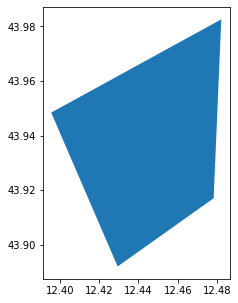


= Importing SMR 7 =


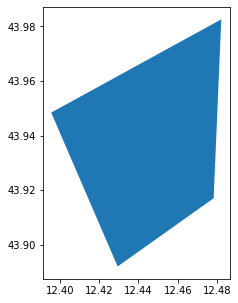


= Importing SMR 8 =


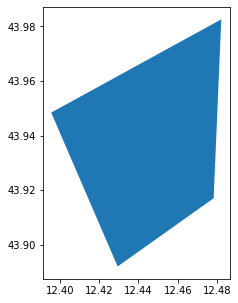


= Importing SMR 9 =


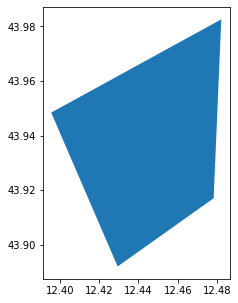


= Importing SOM 4 =


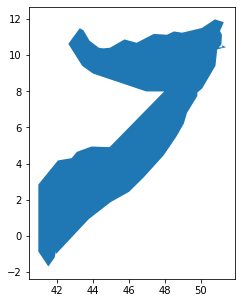


= Importing SOM 5 =


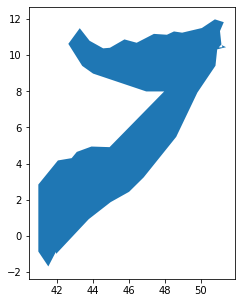


= Importing SOM 6 =


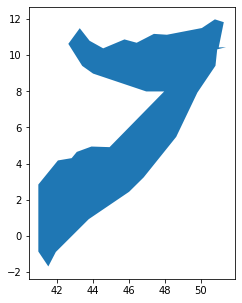


= Importing SOM 7 =


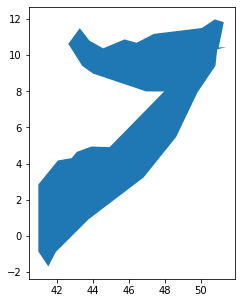


= Importing SOM 8 =


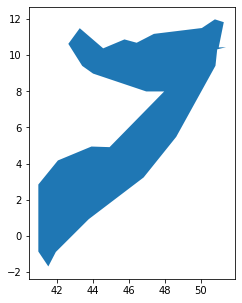


= Importing SOM 9 =


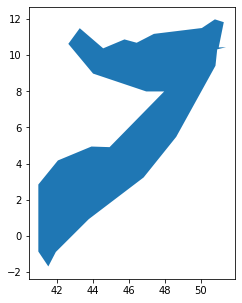


= Importing SPM 4 =


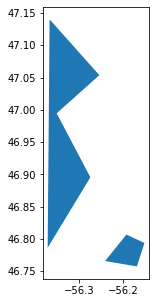


= Importing SPM 5 =


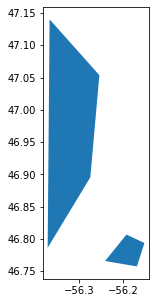


= Importing SPM 6 =


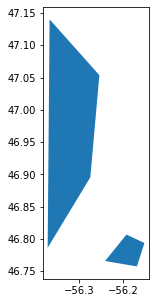


= Importing SPM 7 =


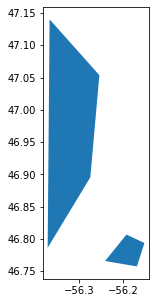


= Importing SPM 8 =


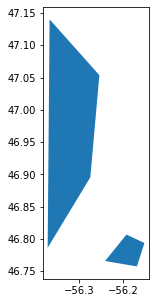


= Importing SPM 9 =


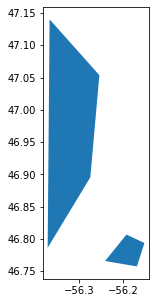


= Importing SRB 4 =


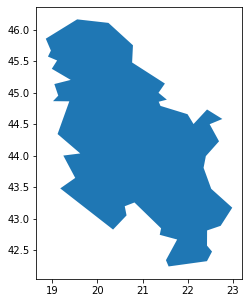


= Importing SRB 5 =


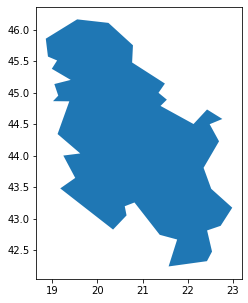


= Importing SRB 6 =


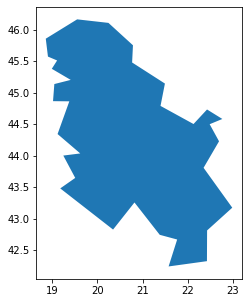


= Importing SRB 7 =


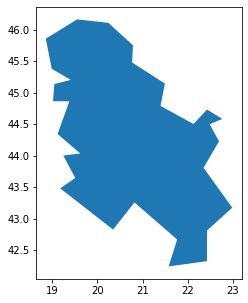


= Importing SRB 8 =


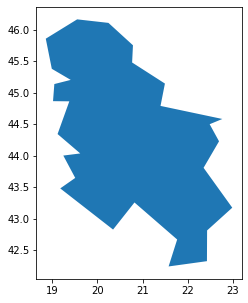


= Importing SRB 9 =


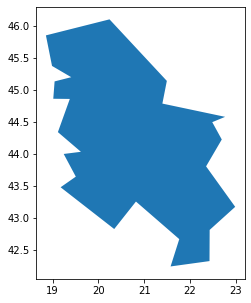


= Importing SSD 4 =


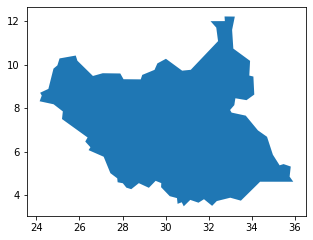


= Importing SSD 5 =


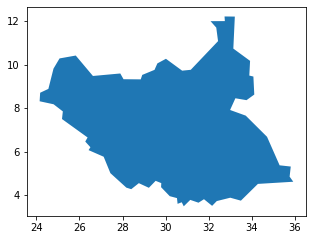


= Importing SSD 6 =


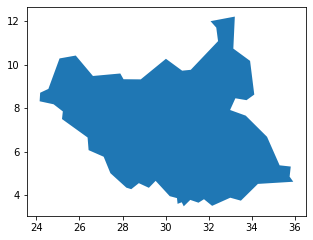


= Importing SSD 7 =


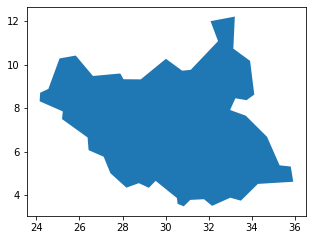


= Importing SSD 8 =


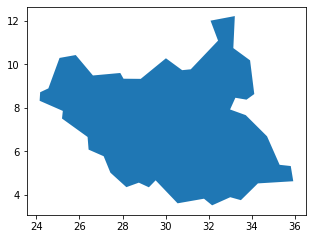


= Importing SSD 9 =


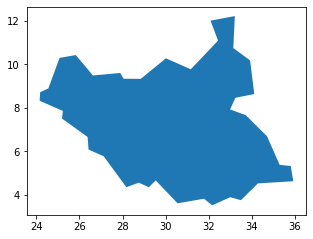


= Importing STP 4 =


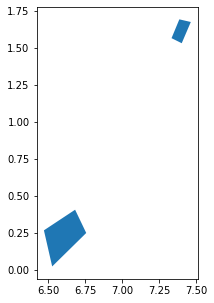


= Importing STP 5 =


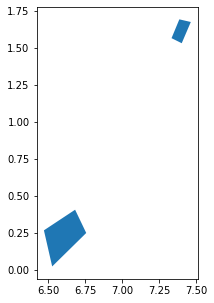


= Importing STP 6 =


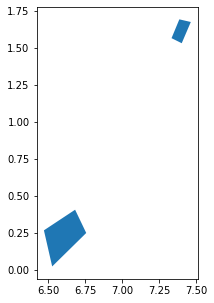


= Importing STP 7 =


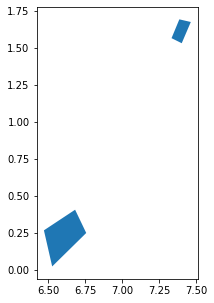


= Importing STP 8 =


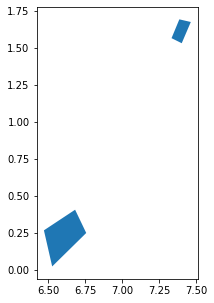


= Importing STP 9 =


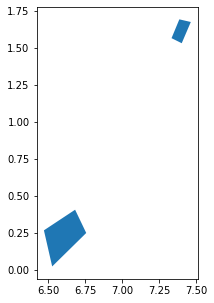


= Importing SUR 4 =


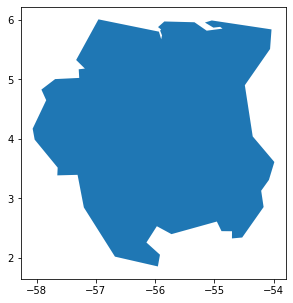


= Importing SUR 5 =


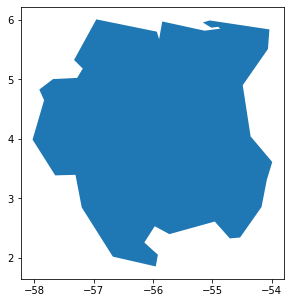


= Importing SUR 6 =


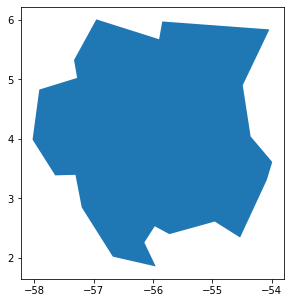


= Importing SUR 7 =


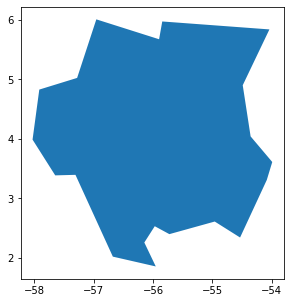


= Importing SUR 8 =


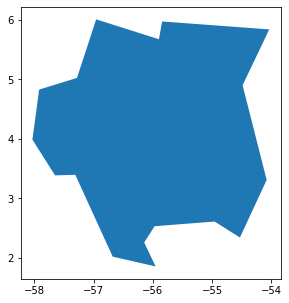


= Importing SUR 9 =


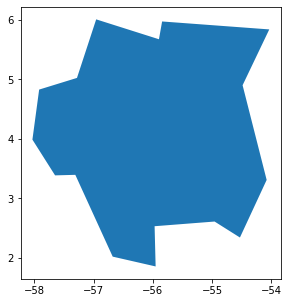


= Importing SVK 4 =


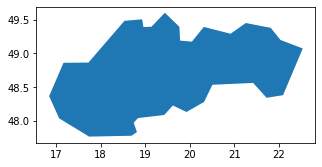


= Importing SVK 5 =


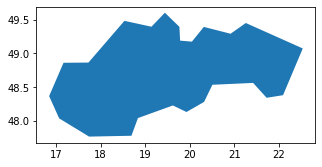


= Importing SVK 6 =


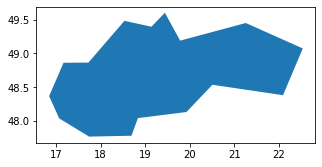


= Importing SVK 7 =


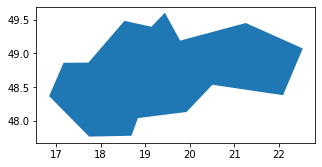


= Importing SVK 8 =


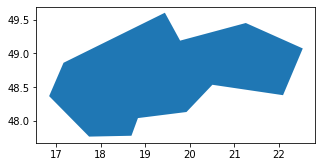


= Importing SVK 9 =


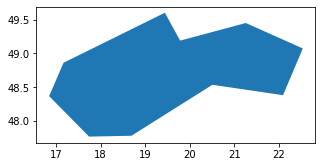


= Importing SVN 4 =


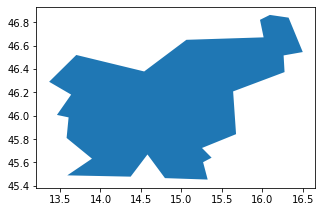


= Importing SVN 5 =


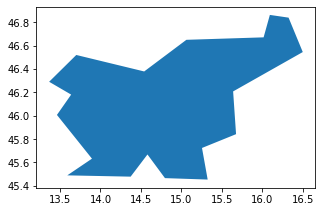


= Importing SVN 6 =


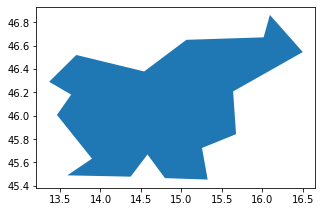


= Importing SVN 7 =


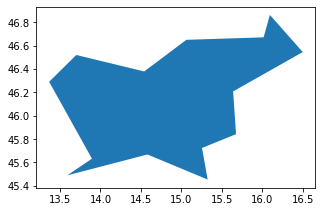


= Importing SVN 8 =


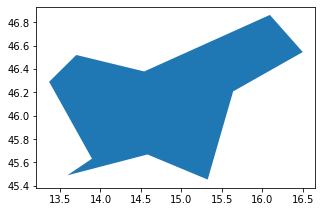


= Importing SVN 9 =


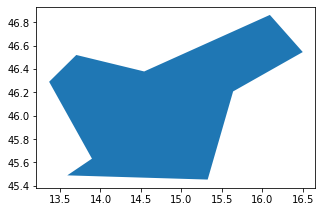


= Importing SWE 4 =


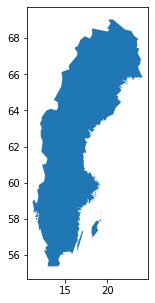


= Importing SWE 5 =


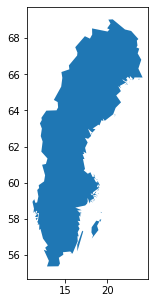


= Importing SWE 6 =


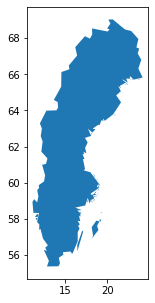


= Importing SWE 7 =


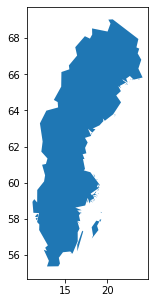


= Importing SWE 8 =


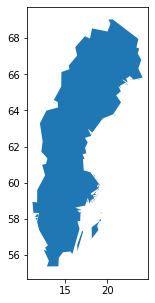


= Importing SWE 9 =


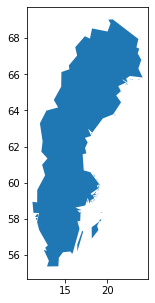


= Importing SWZ 4 =


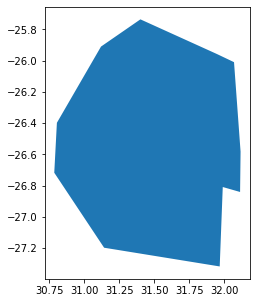


= Importing SWZ 5 =


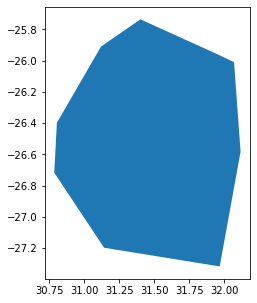


= Importing SWZ 6 =


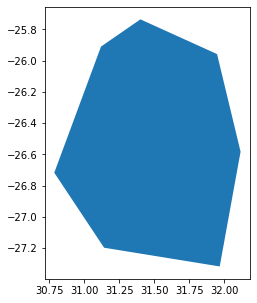


= Importing SWZ 7 =


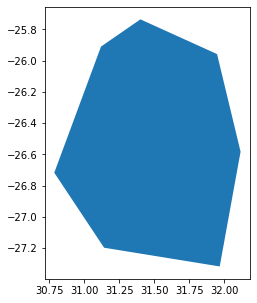


= Importing SWZ 8 =


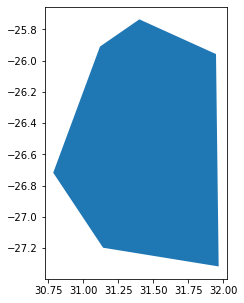


= Importing SWZ 9 =


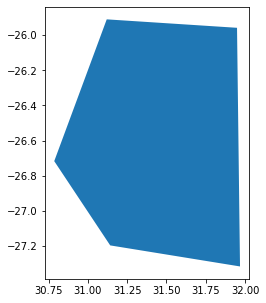


= Importing SXM 4 =


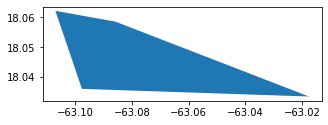


= Importing SXM 5 =


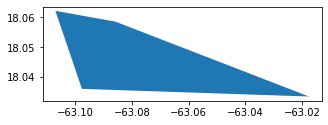


= Importing SXM 6 =


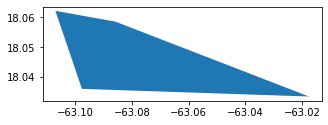


= Importing SXM 7 =


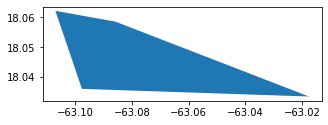


= Importing SXM 8 =


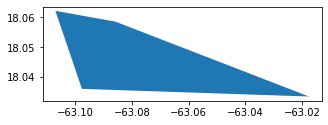


= Importing SXM 9 =


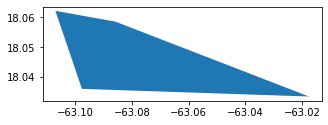


= Importing SYC 4 =


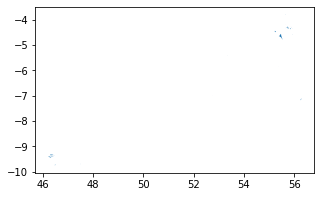


= Importing SYC 5 =


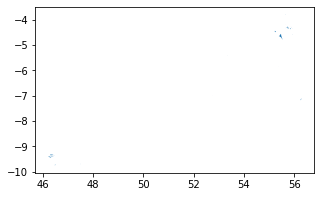


= Importing SYC 6 =


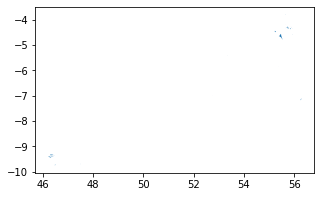


= Importing SYC 7 =


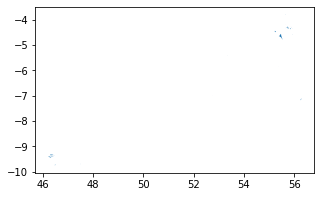


= Importing SYC 8 =


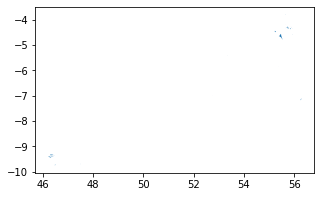


= Importing SYC 9 =


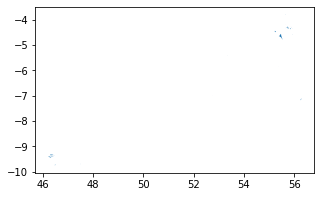


= Importing SYR 4 =


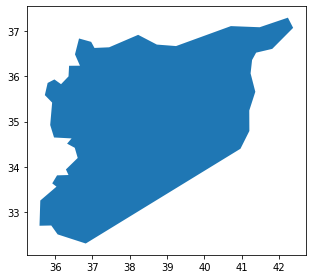


= Importing SYR 5 =


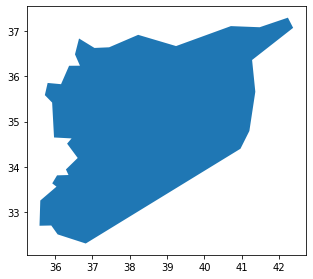


= Importing SYR 6 =


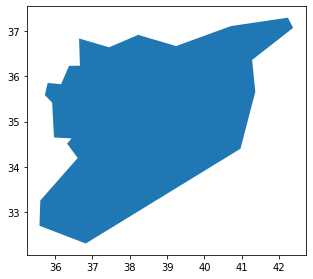


= Importing SYR 7 =


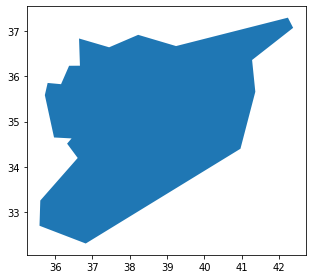


= Importing SYR 8 =


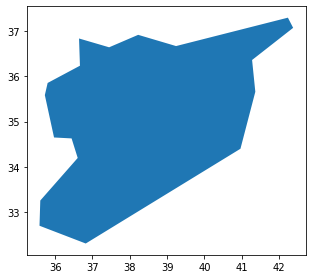


= Importing SYR 9 =


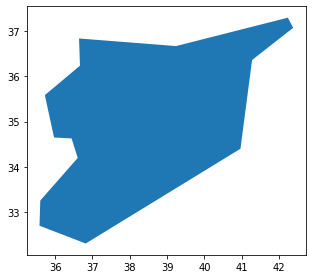


= Importing TCA 4 =


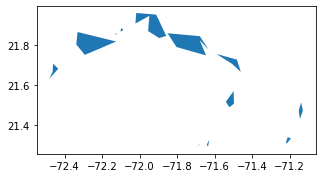


= Importing TCA 5 =


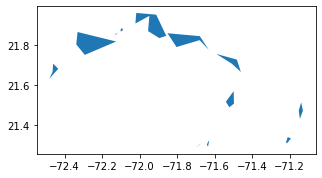


= Importing TCA 6 =


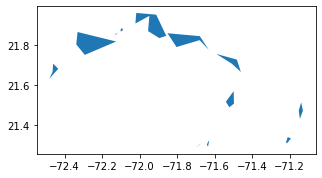


= Importing TCA 7 =


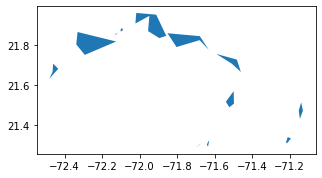


= Importing TCA 8 =


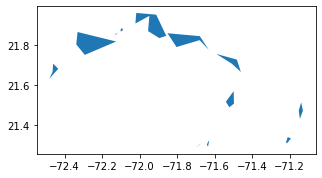


= Importing TCA 9 =


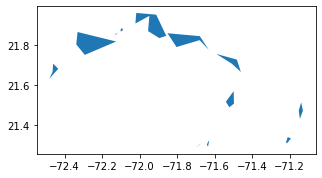


= Importing TCD 4 =


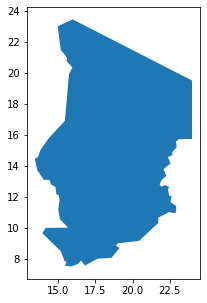


= Importing TCD 5 =


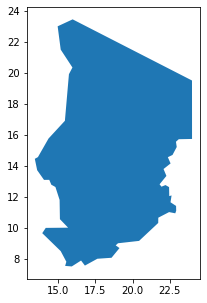


= Importing TCD 6 =


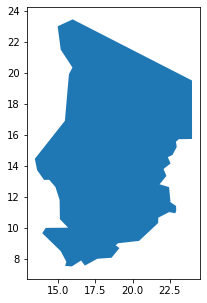


= Importing TCD 7 =


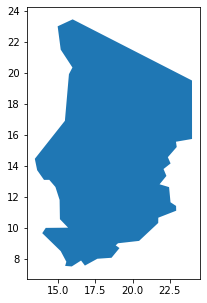


= Importing TCD 8 =


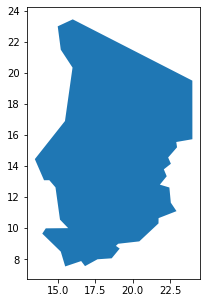


= Importing TCD 9 =


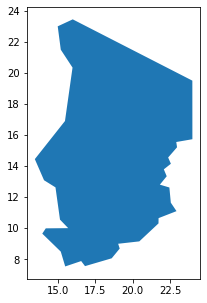


= Importing TGO 4 =


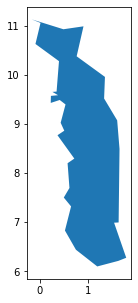


= Importing TGO 5 =


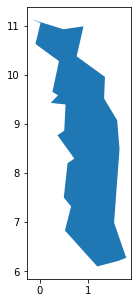


= Importing TGO 6 =


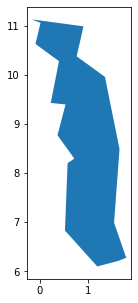


= Importing TGO 7 =


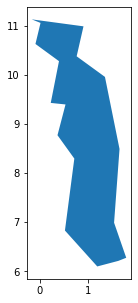


= Importing TGO 8 =


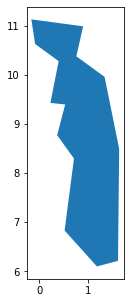


= Importing TGO 9 =


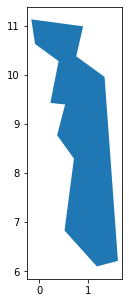


= Importing THA 4 =


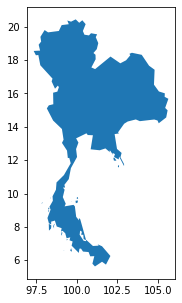


= Importing THA 5 =


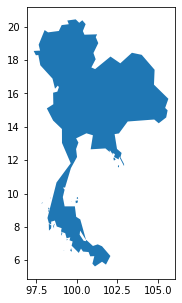


= Importing THA 6 =


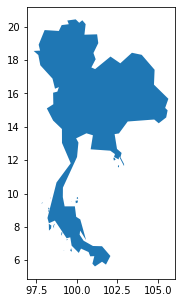


= Importing THA 7 =


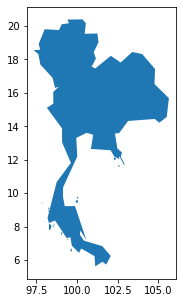


= Importing THA 8 =


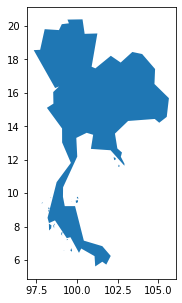


= Importing THA 9 =


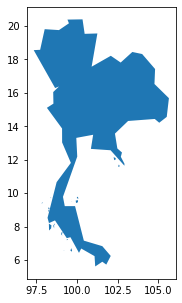


= Importing TJK 4 =


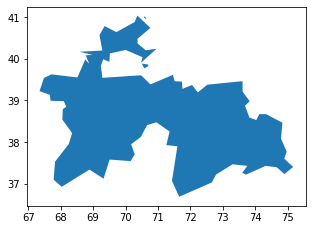


= Importing TJK 5 =


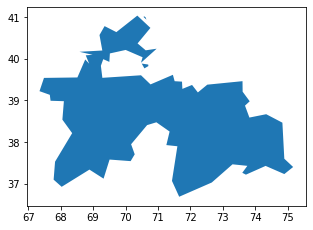


= Importing TJK 6 =


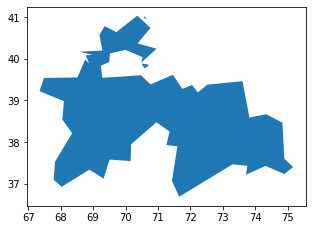


= Importing TJK 7 =


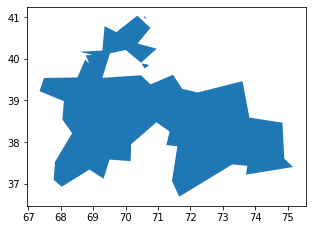


= Importing TJK 8 =


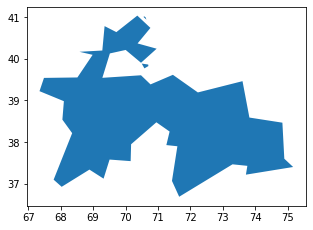


= Importing TJK 9 =


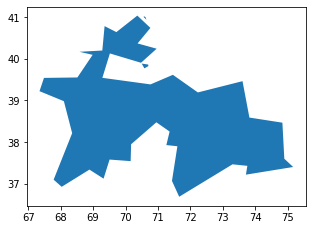


= Importing TKL 4 =


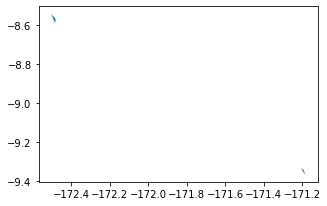


= Importing TKL 5 =


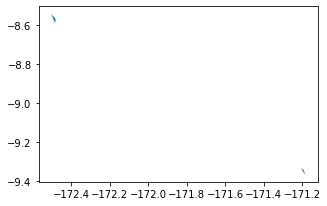


= Importing TKL 6 =


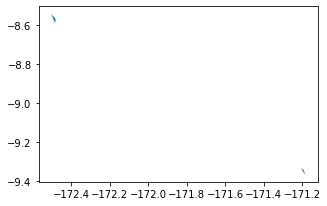


= Importing TKL 7 =


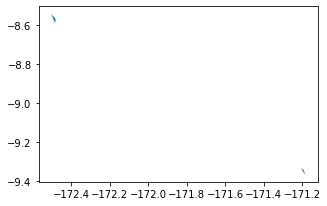


= Importing TKL 8 =


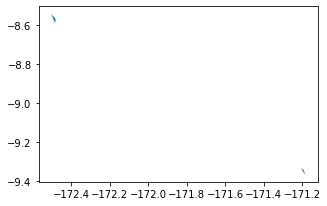


= Importing TKL 9 =


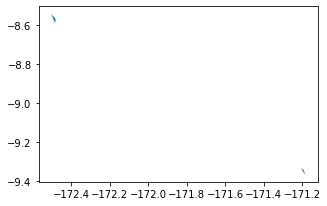


= Importing TKM 4 =


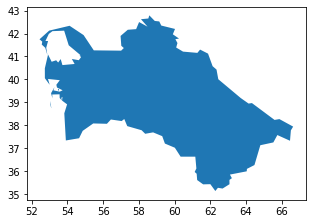


= Importing TKM 5 =


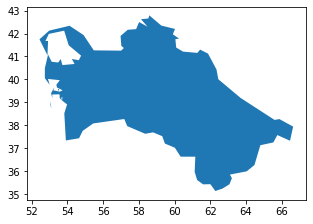


= Importing TKM 6 =


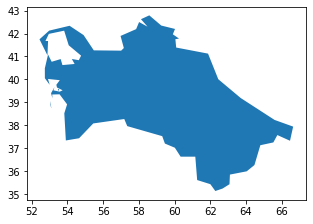


= Importing TKM 7 =


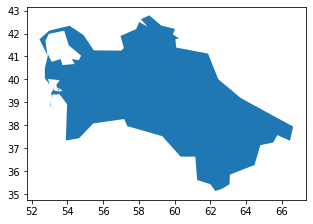


= Importing TKM 8 =


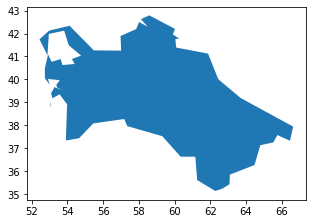


= Importing TKM 9 =


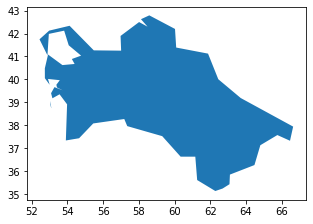


= Importing TLS 4 =


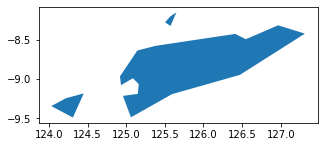


= Importing TLS 5 =


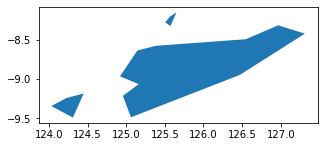


= Importing TLS 6 =


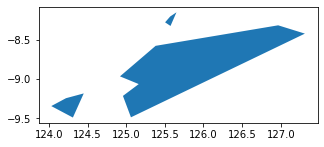


= Importing TLS 7 =


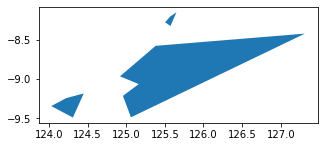


= Importing TLS 8 =


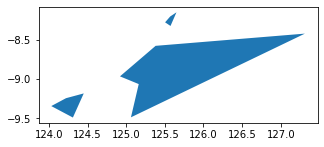


= Importing TLS 9 =


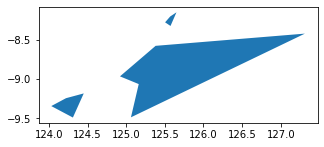


= Importing TON 4 =


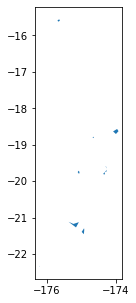


= Importing TON 5 =


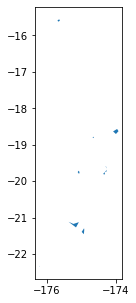


= Importing TON 6 =


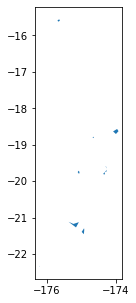


= Importing TON 7 =


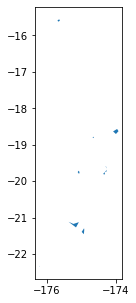


= Importing TON 8 =


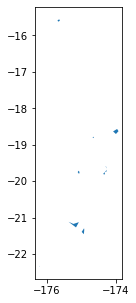


= Importing TON 9 =


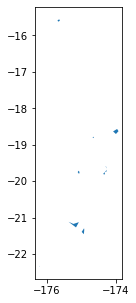


= Importing TTO 4 =


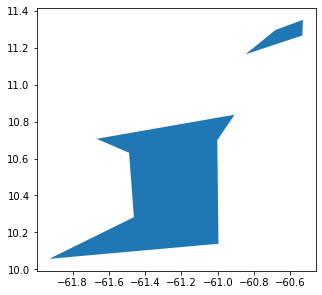


= Importing TTO 5 =


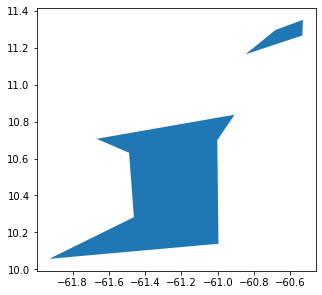


= Importing TTO 6 =


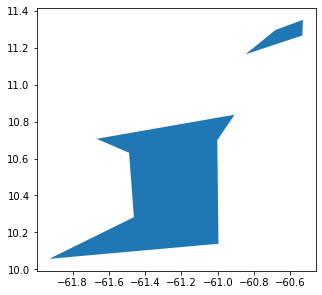


= Importing TTO 7 =


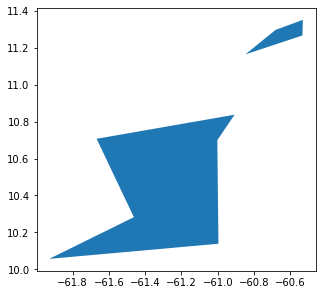


= Importing TTO 8 =


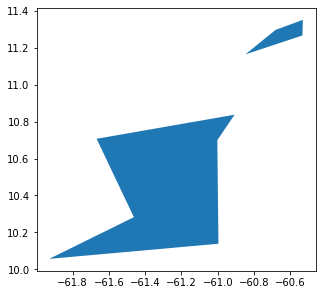


= Importing TTO 9 =


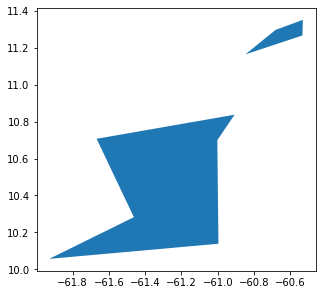


= Importing TUN 4 =


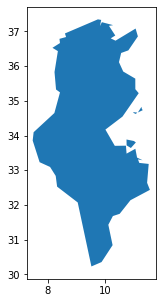


= Importing TUN 5 =


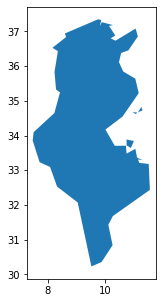


= Importing TUN 6 =


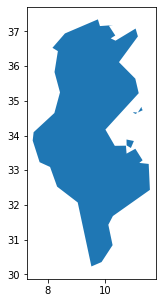


= Importing TUN 7 =


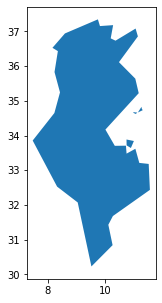


= Importing TUN 8 =


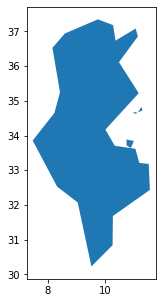


= Importing TUN 9 =


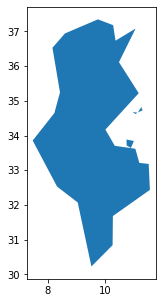


= Importing TUR 4 =


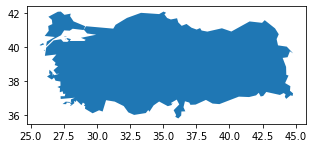


= Importing TUR 5 =


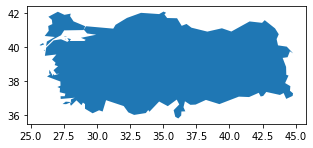


= Importing TUR 6 =


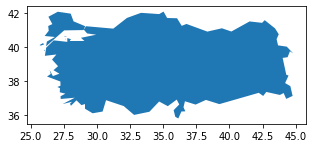


= Importing TUR 7 =


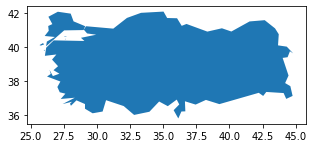


= Importing TUR 8 =


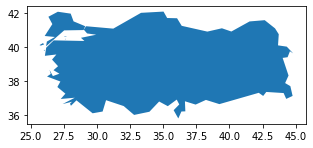


= Importing TUR 9 =


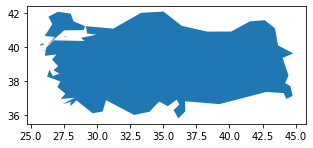


= Importing TUV 4 =


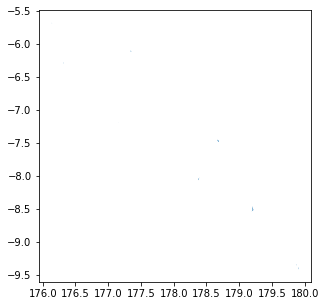


= Importing TUV 5 =


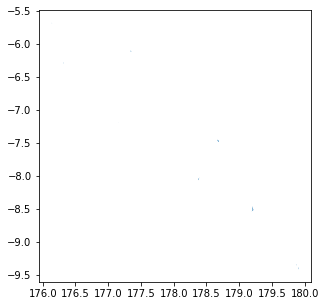


= Importing TUV 6 =


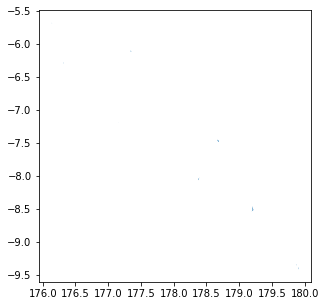


= Importing TUV 7 =


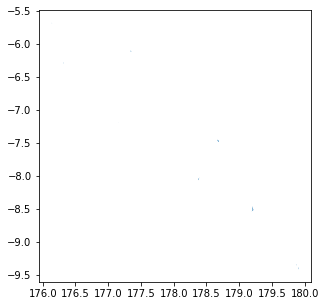


= Importing TUV 8 =


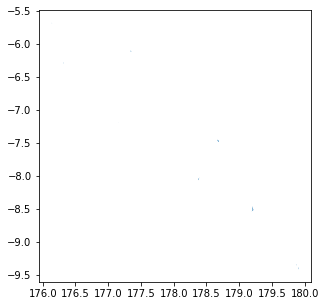


= Importing TUV 9 =


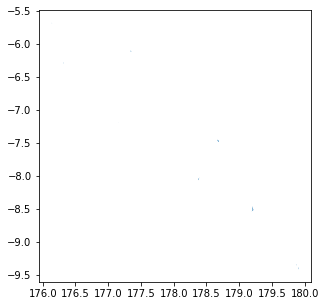


= Importing TZA 4 =


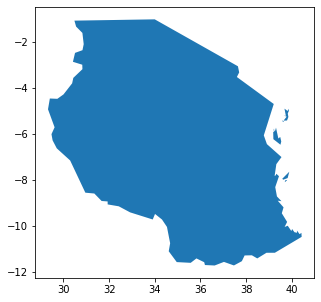


= Importing TZA 5 =


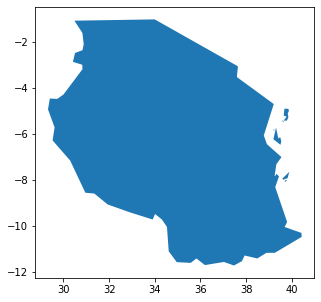


= Importing TZA 6 =


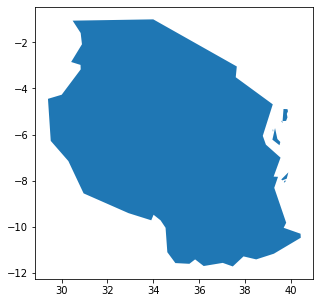


= Importing TZA 7 =


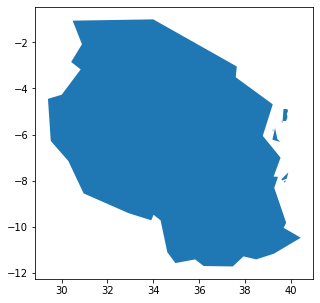


= Importing TZA 8 =


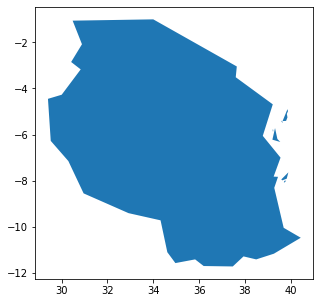


= Importing TZA 9 =


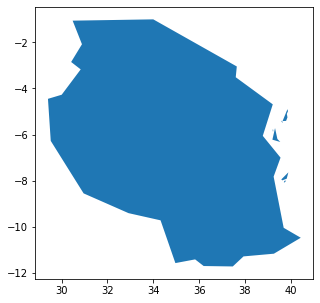


= Importing UGA 4 =


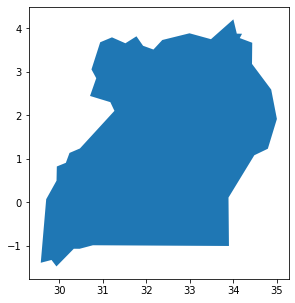


= Importing UGA 5 =


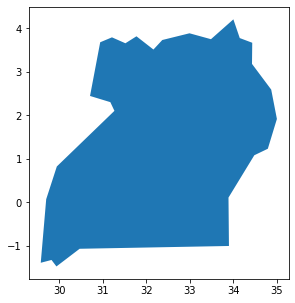


= Importing UGA 6 =


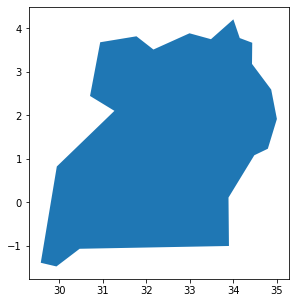


= Importing UGA 7 =


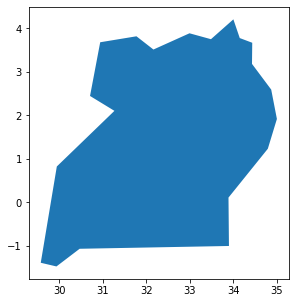


= Importing UGA 8 =


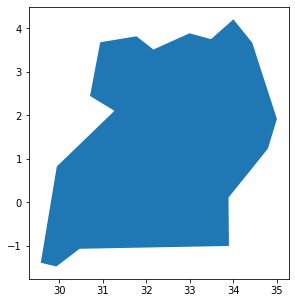


= Importing UGA 9 =


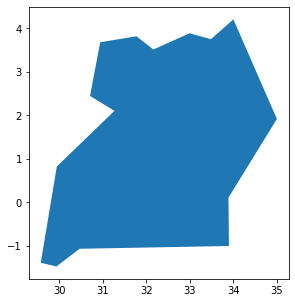


= Importing UKR 4 =


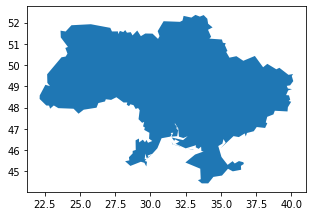


= Importing UKR 5 =


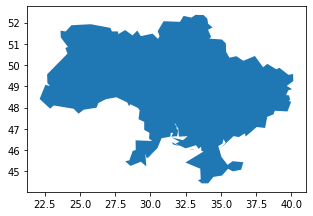


= Importing UKR 6 =


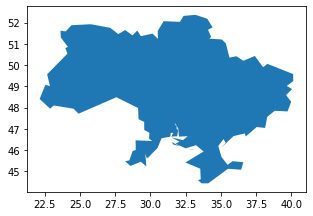


= Importing UKR 7 =


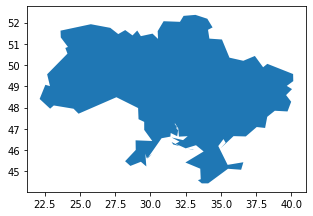


= Importing UKR 8 =


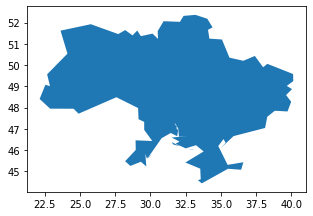


= Importing UKR 9 =


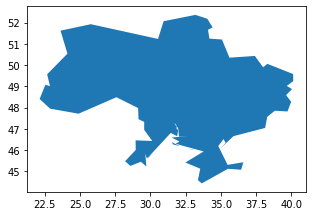


= Importing UMI 4 =


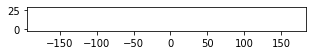


= Importing UMI 5 =


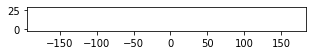


= Importing UMI 6 =


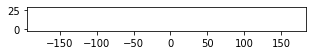


= Importing UMI 7 =


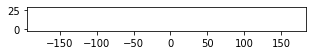


= Importing UMI 8 =


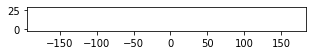


= Importing UMI 9 =


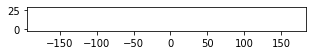


= Importing URY 4 =


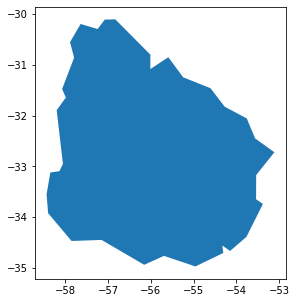


= Importing URY 5 =


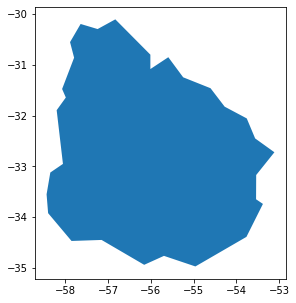


= Importing URY 6 =


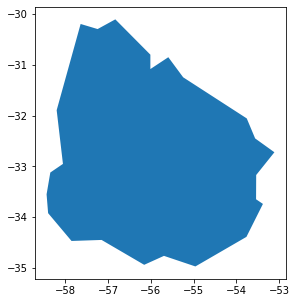


= Importing URY 7 =


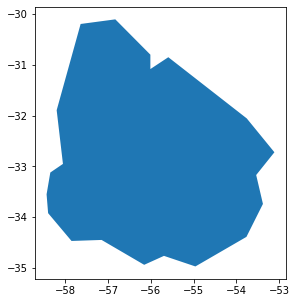


= Importing URY 8 =


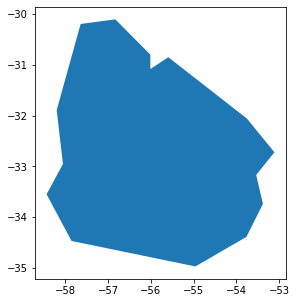


= Importing URY 9 =


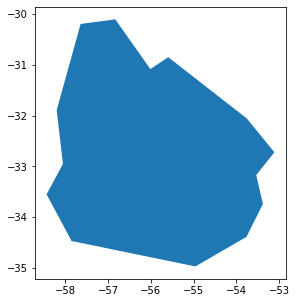


= Importing USA 4 =


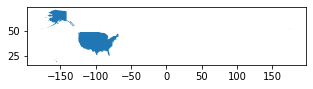


= Importing USA 5 =


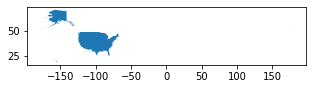


= Importing USA 6 =


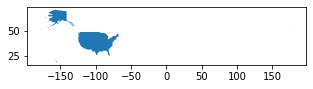


= Importing USA 7 =


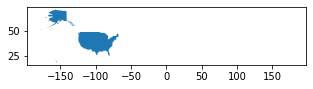


= Importing USA 8 =


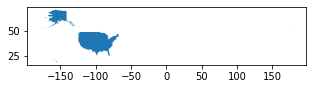


= Importing USA 9 =


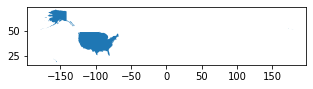


= Importing UZB 4 =


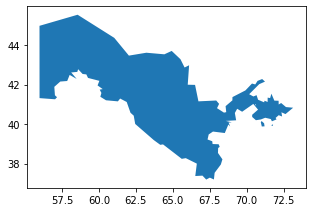


= Importing UZB 5 =


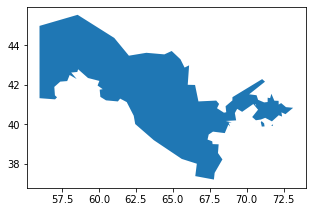


= Importing UZB 6 =


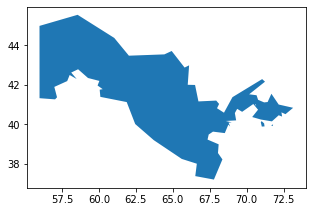


= Importing UZB 7 =


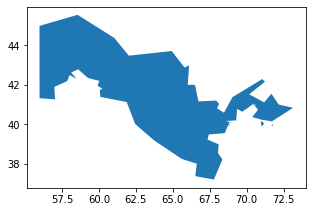


= Importing UZB 8 =


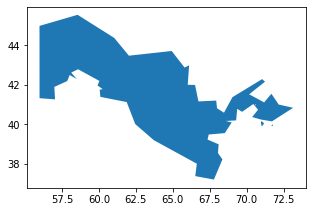


= Importing UZB 9 =


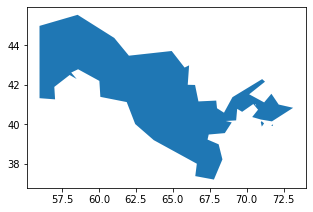


= Importing VAT 4 =


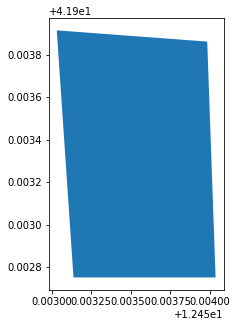


= Importing VAT 5 =


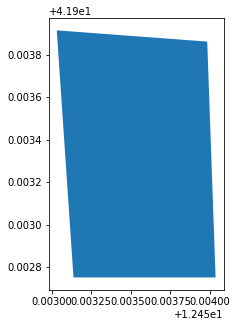


= Importing VAT 6 =


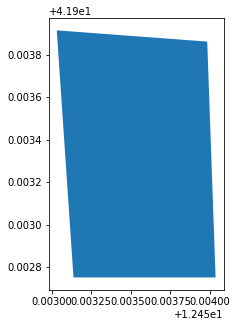


= Importing VAT 7 =


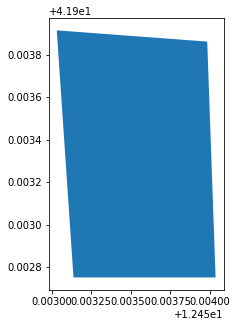


= Importing VAT 8 =


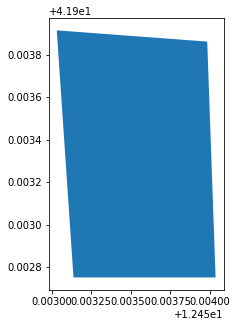


= Importing VAT 9 =


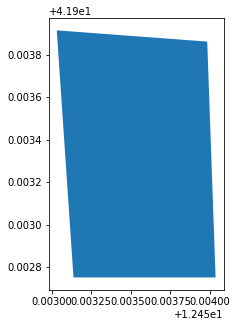


= Importing VCT 4 =


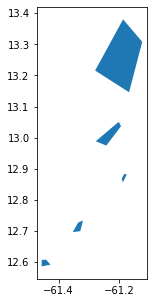


= Importing VCT 5 =


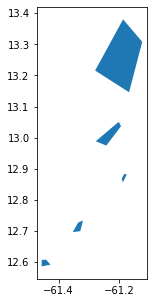


= Importing VCT 6 =


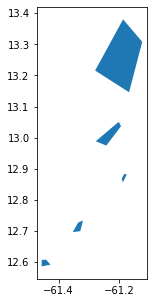


= Importing VCT 7 =


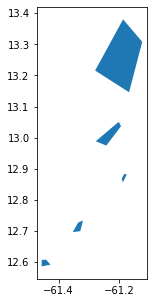


= Importing VCT 8 =


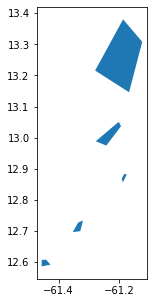


= Importing VCT 9 =


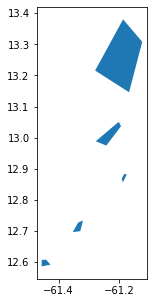


= Importing VEN 4 =


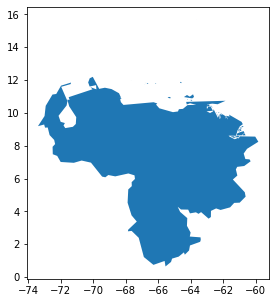


= Importing VEN 5 =


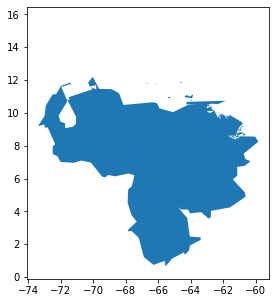


= Importing VEN 6 =


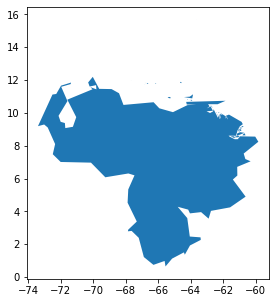


= Importing VEN 7 =


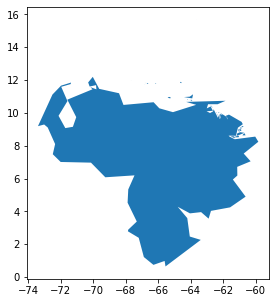


= Importing VEN 8 =


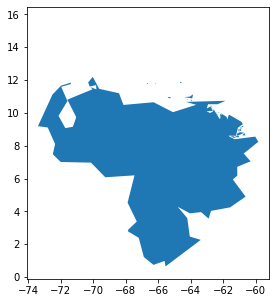


= Importing VEN 9 =


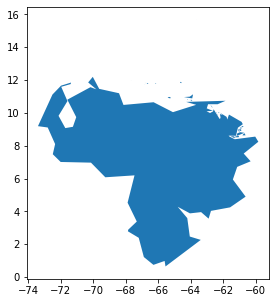


= Importing VGB 4 =


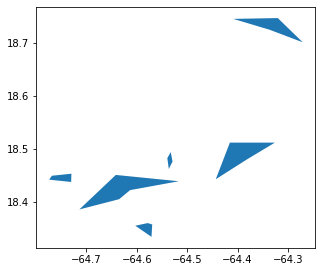


= Importing VGB 5 =


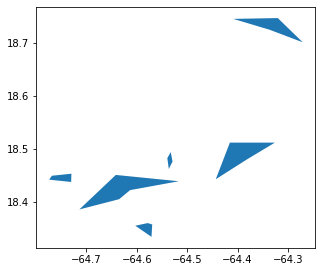


= Importing VGB 6 =


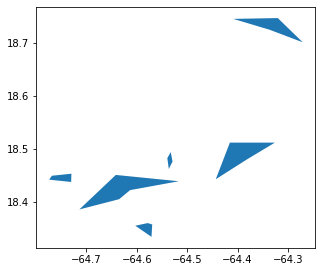


= Importing VGB 7 =


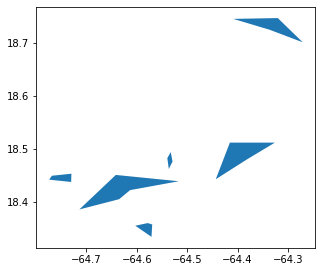


= Importing VGB 8 =


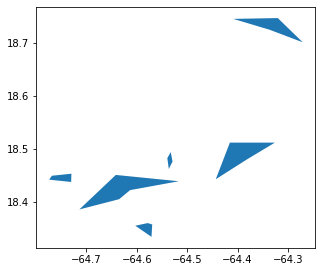


= Importing VGB 9 =


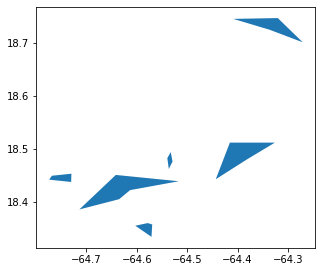


= Importing VIR 4 =


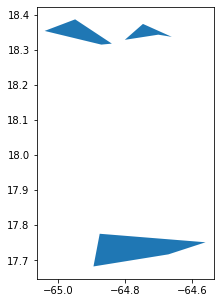


= Importing VIR 5 =


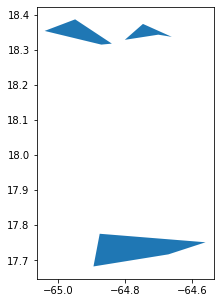


= Importing VIR 6 =


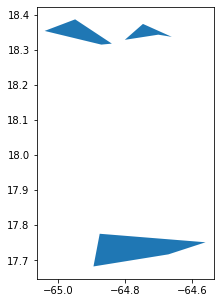


= Importing VIR 7 =


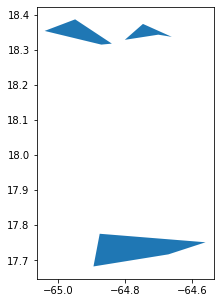


= Importing VIR 8 =


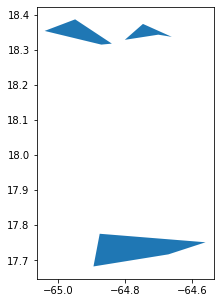


= Importing VIR 9 =


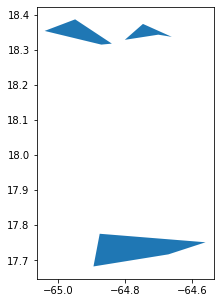


= Importing VNM 4 =


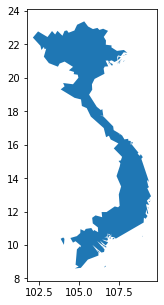


= Importing VNM 5 =


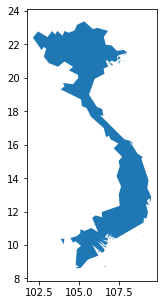


= Importing VNM 6 =


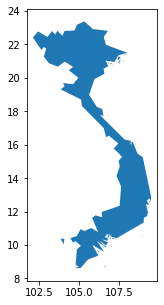


= Importing VNM 7 =


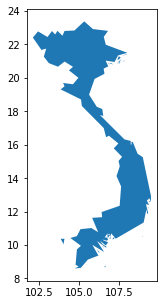


= Importing VNM 8 =


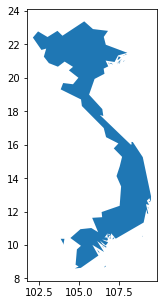


= Importing VNM 9 =


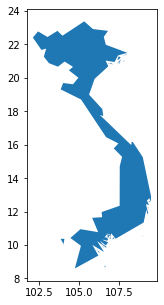


= Importing VUT 4 =


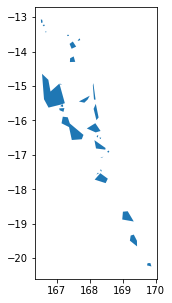


= Importing VUT 5 =


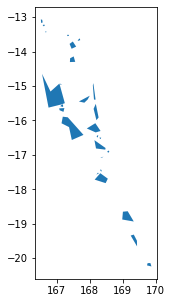


= Importing VUT 6 =


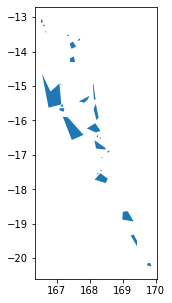


= Importing VUT 7 =


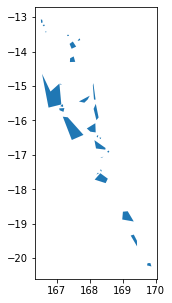


= Importing VUT 8 =


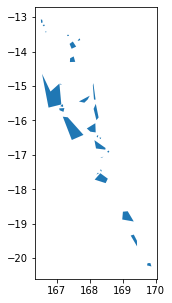


= Importing VUT 9 =


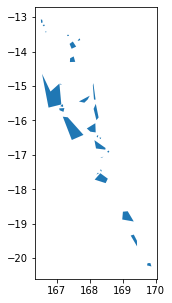


= Importing WLF 4 =


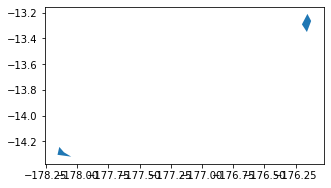


= Importing WLF 5 =


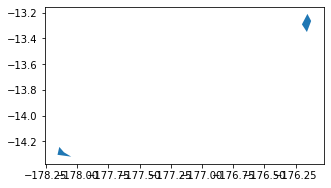


= Importing WLF 6 =


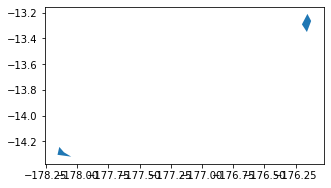


= Importing WLF 7 =


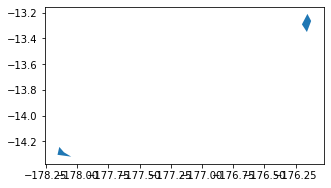


= Importing WLF 8 =


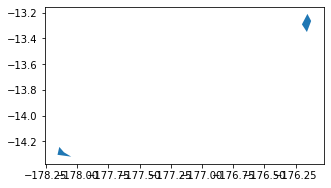


= Importing WLF 9 =


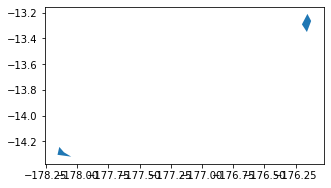


= Importing WSM 4 =


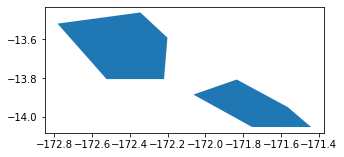


= Importing WSM 5 =


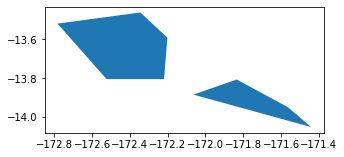


= Importing WSM 6 =


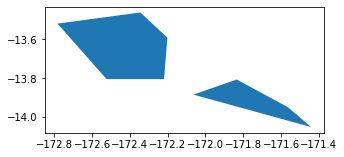


= Importing WSM 7 =


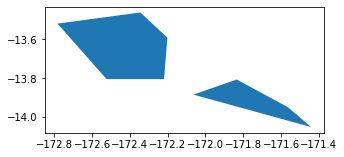


= Importing WSM 8 =


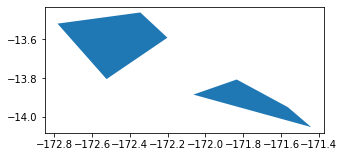


= Importing WSM 9 =


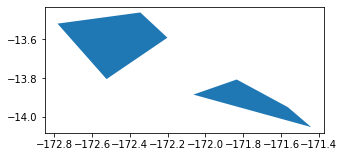


= Importing YEM 4 =


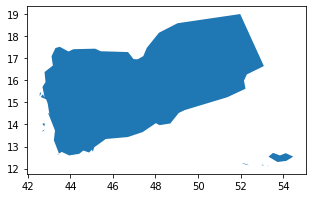


= Importing YEM 5 =


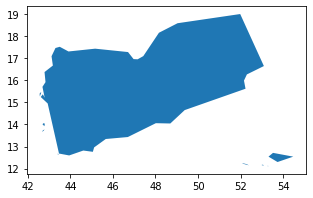


= Importing YEM 6 =


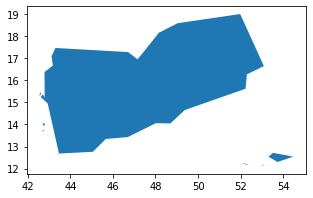


= Importing YEM 7 =


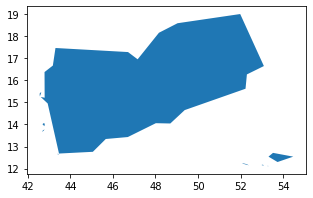


= Importing YEM 8 =


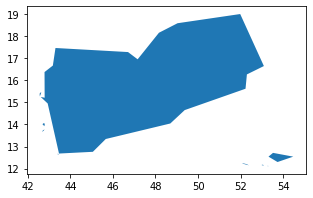


= Importing YEM 9 =


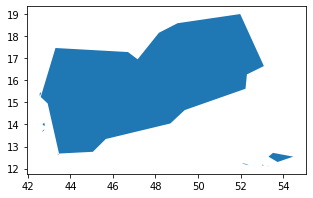


= Importing ZAF 4 =


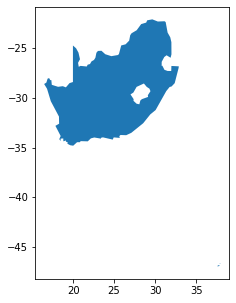


= Importing ZAF 5 =


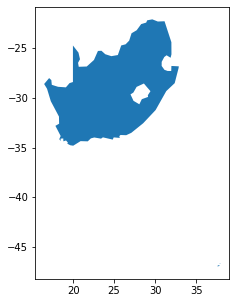


= Importing ZAF 6 =


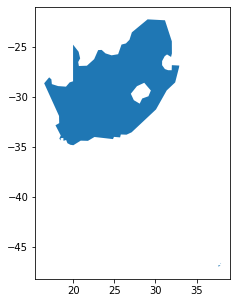


= Importing ZAF 7 =


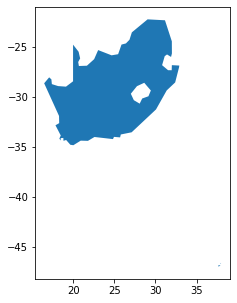


= Importing ZAF 8 =


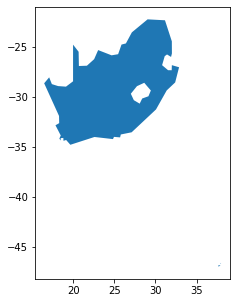


= Importing ZAF 9 =


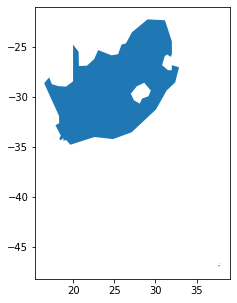


= Importing ZMB 4 =


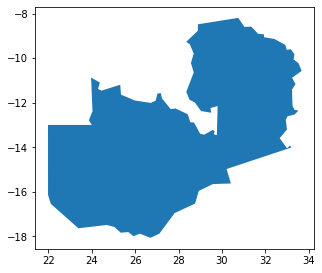


= Importing ZMB 5 =


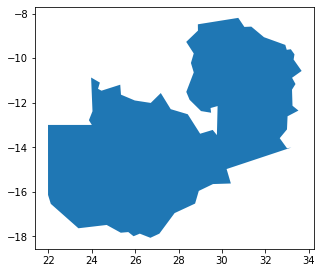


= Importing ZMB 6 =


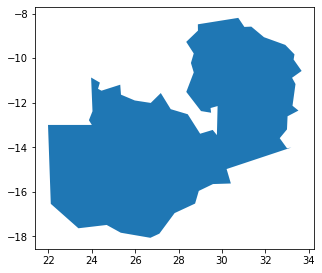


= Importing ZMB 7 =


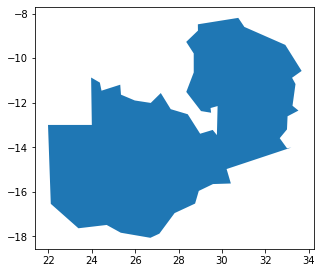


= Importing ZMB 8 =


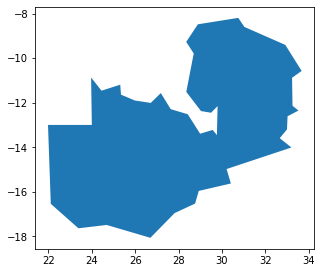


= Importing ZMB 9 =


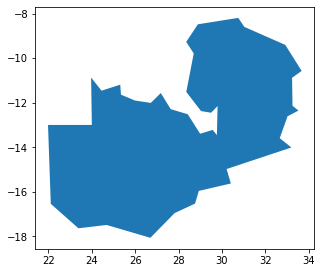


= Importing ZWE 4 =


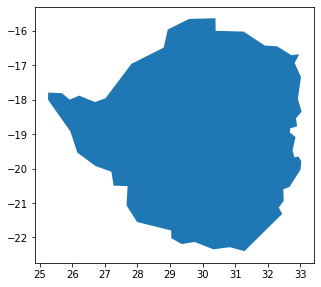


= Importing ZWE 5 =


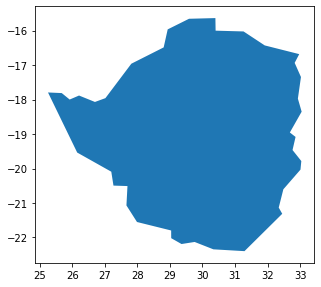


= Importing ZWE 6 =


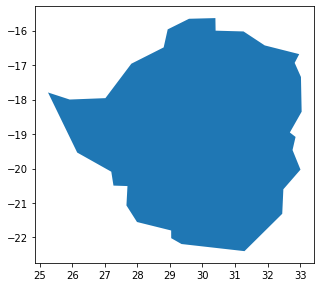


= Importing ZWE 7 =


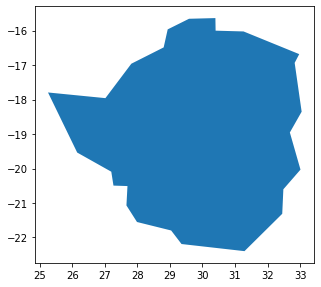


= Importing ZWE 8 =


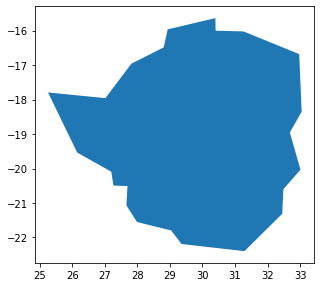


= Importing ZWE 9 =


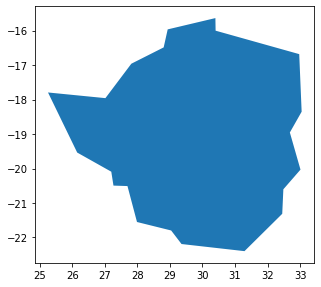

In [66]:
EPS_LEVEL_MAP = {0.01: 1, 0.03: 2, 0.05: 3, 0.075: 4, 0.1: 5, 0.125: 6, 0.15: 7, 0.175: 8, 0.2: 9} # from https://github.com/datacommonsorg/data/blob/master/scripts/us_census/geojsons_low_res/generate_mcf.py

for fpath in sorted(glob.glob(f'{EXPORT_PATH}/*_0.geojson')):
  country_code = country_code_from_fpath(fpath)
  in_dc = is_dc_country(country_code)
  if not in_dc:
    continue
  for tolerance, dp_level in EPS_LEVEL_MAP.items():
    country_data = gpd.read_file(fpath).simplify(tolerance)
    export_country_feature(country_code, country_data, dp_level)

Tolerance=0.075	DP-level=4


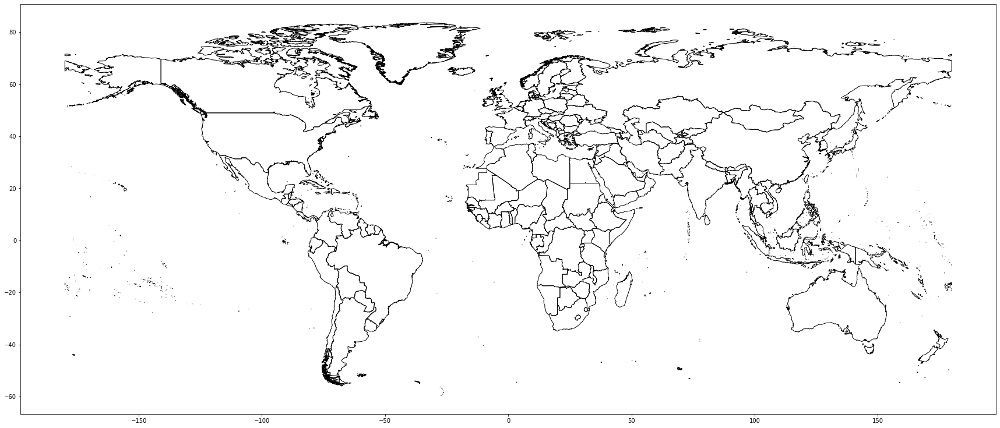

Tolerance=0.1	DP-level=5


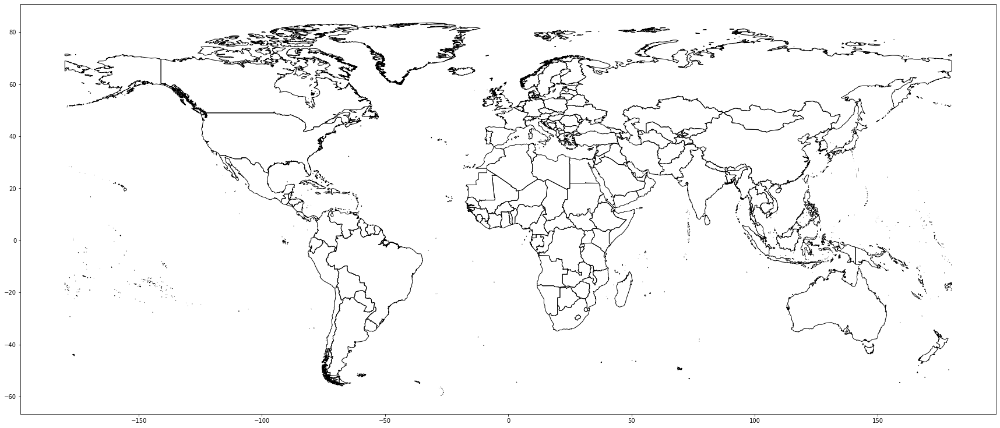

Tolerance=0.125	DP-level=6


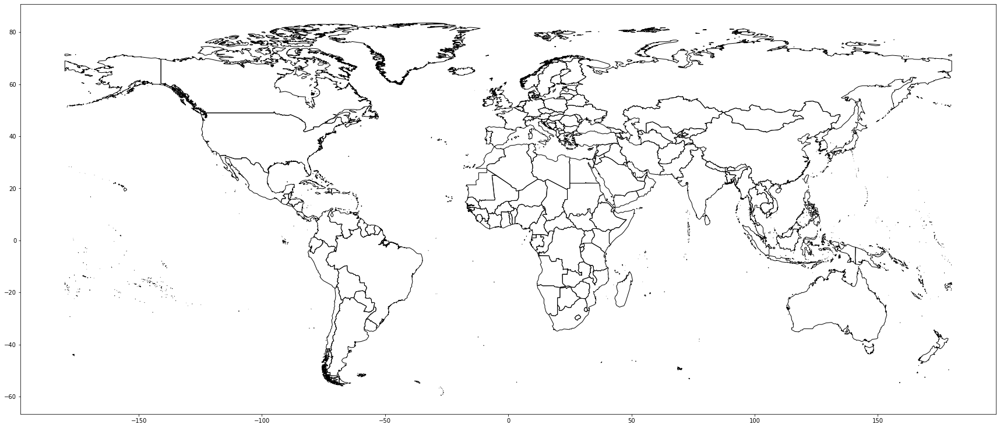

Tolerance=0.15	DP-level=7


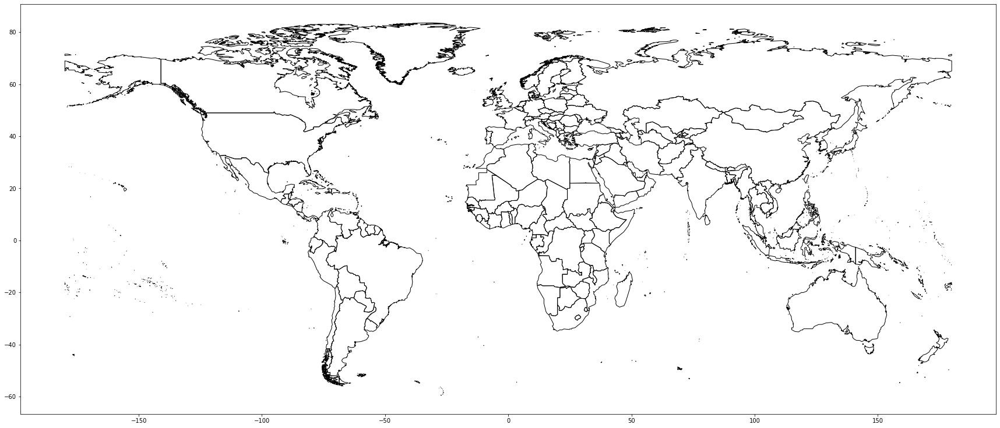

Tolerance=0.175	DP-level=8


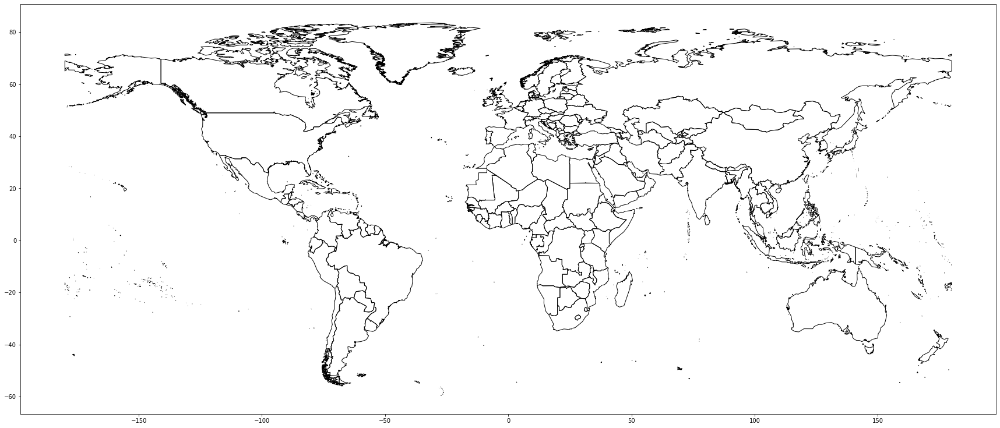

Tolerance=0.2	DP-level=9


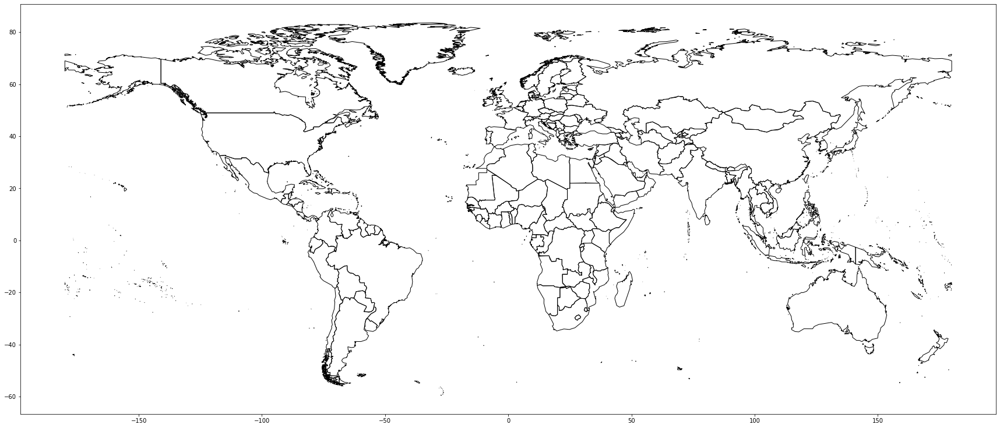

In [67]:
#@title Assembling world map from individual simplified geojson files

for tolerance, dp_level in EPS_LEVEL_MAP.items():
  print(f'Tolerance={tolerance}\tDP-level={dp_level}')
  fig, ax = plt.subplots(figsize = (30,30)) 
  for fpath in sorted(glob.glob(f'{EXPORT_PATH}/*_{dp_level}.geojson')):
    country_code = country_code_from_fpath(fpath)
    exported_countries.add(country_code)
    in_dc = is_dc_country(country_code)
    if not in_dc:
      continue
    gpd.read_file(fpath).geometry.boundary.plot(color=None, edgecolor='k', linewidth=1, ax=ax)
  plt.show()

In [30]:
#@title Testing the output of an individual geojson
#@markdown Note that all the features / data from the data source are removed

with open(f'{EXPORT_PATH}/ABW_1.geojson') as f:
  # geostr = f.read()
  geostr = json.load(f)
  # Note: the double use of json.dumps automatically escapes all
  # inner quotes, and encloses the entire string in quotes.
  print(json.dumps(json.dumps(geostr)))

"{\"type\": \"FeatureCollection\", \"crs\": {\"type\": \"name\", \"properties\": {\"name\": \"urn:ogc:def:crs:OGC:1.3:CRS84\"}}, \"features\": [{\"type\": \"Feature\", \"properties\": {}, \"geometry\": {\"type\": \"Polygon\", \"coordinates\": [[[-69.99693762886847, 12.57758209763574], [-70.04873613166711, 12.632147528385758], [-70.06110592419901, 12.62539297140853], [-70.04873613166711, 12.583726303626065], [-70.05809485639247, 12.537176825250356], [-69.92467200420958, 12.447211004884025], [-69.94513912696908, 12.440375067355546], [-69.9305313787201, 12.425970770035065], [-69.88809160064682, 12.417669988878913], [-69.8801977204484, 12.453558660903525], [-69.92467200420958, 12.519232488788361], [-69.99693762886847, 12.57758209763574]]]}}]}"


In [68]:
!gsutil -m cp -r {EXPORT_PATH} {GCS_BUCKET}/country_geojson

Copying file:///tmp/exports/PCN_6.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/ABW_1.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/ZWE_9.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/IOT_1.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/SPM_6.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/KEN_9.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/LUX_8.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/NLD_2.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/AUS_6.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/SEN_4.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/KEN_5.geojson [Content-Type=application/octet-stream]...
Copying file:///tmp/exports/CRI_6.geojson [Content-Type=applicati

**Output the MCF**
---



In [69]:
MCF_OUT_FOLDER = '/tmp/mcfs'
!mkdir -p {MCF_OUT_FOLDER}

MCF_PATH = '/{MCF_OUT_FOLDER}/countries.dp{dp_level}.mcfgeojson.mcf'
MCF_FORMAT_STR = "\n".join([
    "Node: dcid:country/{country_code}",
    "typeOf: dcs:Country",
    "{prop}: {coords_str}", "\n"
])
def prop_for_dp_level(dp_level):
  if dp_level == 0:
    return "geoJsonCoordinates"
  return f"geoJsonCoordinatesDP{dp_level}"

# for dp_level in range(0, 4):
for dp_level in range(4, 10):
  mcf_path = MCF_PATH.format(MCF_OUT_FOLDER=MCF_OUT_FOLDER, dp_level=dp_level)
  with open(mcf_path, 'w') as mcf_fp:
    for fpath in sorted(glob.glob(f'{EXPORT_PATH}/*_{dp_level}.geojson')):
      country_code = country_code_from_fpath(fpath)
      if not is_dc_country(country_code):
        print(f"Skipping MCF for {country_code}")
        continue
      assert is_dc_country(country_code), country_code
      with open(fpath) as geo_fp:
        geostr = json.load(geo_fp)
        mcf_fp.write(
            MCF_FORMAT_STR.format(country_code=country_code,
                                  prop=prop_for_dp_level(dp_level),
                                  coords_str=json.dumps(json.dumps(geostr)))
        )

!gsutil -m cp -r {MCF_OUT_FOLDER} {GCS_BUCKET}/mcfs

Copying file:///tmp/mcfs/countries.dp1.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp4.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp5.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp9.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp0.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp2.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp3.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp8.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp7.mcfgeojson.mcf [Content-Type=application/octet-stream]...
Copying file:///tmp/mcfs/countries.dp6.mcfgeojson.mcf [Content-Type=application/octet-stream]...
- [10/10 files][ 43.6 MiB/ 43.